In [1]:
import json
import re
import os
from textblob import TextBlob
import pandas as pd

# scegli 2019 o 2021

In [2]:
anno = input("Scegli l'anno dei dati da analizzare [2019/2021] :\n")

Scegli l'anno dei dati da analizzare [2019/2021] :
2021


# OPEN dataset_2021 e 2019
Creato json: dataset_2021 e 2019 da colab attraverso il gitclone
key: nome.txt; valore: id tweet 

In [77]:
with open('C:/Users/solel/Desktop/dataset_'+anno+'.json', 'r') as fp:
    df_anno= json.load(fp)

# Accesso all'account Twitter per estrarre i text tweet

In [ ]:
import tweepy

consumer_key = ''
consumer_secret = ''
access_token = ''
access_token_secret = ''

# authorization of consumer key and consumer secret 
auth = tweepy.OAuthHandler(consumer_key, consumer_secret) 
  
# set access to user's access key and access secret  
auth.set_access_token(access_token, access_token_secret)

#api = tweepy.API(auth)
api = tweepy.API(auth, wait_on_rate_limit=True, wait_on_rate_limit_notify=True)

In [ ]:
#GET ALl TEXT:
def GetTweet(value):
    try:
        status = api.get_status(value, tweet_mode="extended")
        try:
            return status.retweeted_status.full_text
        except AttributeError:  # Not a Retweet
            return status.full_text
    except:
        return "ERROR"

In [ ]:
#CREA JSON PER OGNI CHIAVE DEL DATASET: KEY->ID, VALORE->TESTO TWEET
for txt in df_anno:
    id_text={}
    for i in df_anno.get(txt):
        check= GetTweet(i)
        if (check!='ERROR'):
            id_text[i]= GetTweet(i)

    with open('C:/Users/solel/Desktop/'+anno+'_TWEET/'+ txt +'.json', 'w') as fp:
        json.dump(id_text,fp)

# RIMUOVI URL

In [3]:
def remove_url(txt):
    return " ".join(re.sub("([^0-9A-Za-z \t])|(\w+:\/\/\S+)", "", txt).split())

In [4]:
tweet={}
path = 'C:/Users/solel/Desktop/'+anno+'_TWEET/'
for j in os.listdir(path):
    with open(path+j,'r') as js:
        text = json.load(js)
        for t in text:
            tweet[t]=text.get(t)

In [5]:
tweet_clean={}
for i, text in tweet.items():
    text_new = remove_url(text)
    tweet_clean[i]=text_new

In [6]:
with open('tweet_clean'+anno+'.json', 'w') as f:
        json.dump(tweet_clean, f)

In [13]:
print(len(tweet_clean))

35397


# Calcola polarità del sentiment 

In [7]:
#2021/2019
polarità=[]
sentiment_objects = [TextBlob(tweet) for tweet in tweet_clean.values()]
for o in sentiment_objects:
    print(o +':    ')
    polarità.append(o.polarity)
    print(o.polarity)

The most costly thing we can do is nothing We need to pass POTUS American Rescue Plan and get direct relief to those who need it most Now:    
0.275
Oh wow I see that the big bad predatorpedo defense network at Lincoln Project is springing into action:    
-0.12499999999999997
Schoen met with Jeffrey Epstein in the last days of his life and agreed to lead Epsteins legal team He has also advanced the theory that Epstein was murdered:    
0.20000000000000004
Congress and the Department of Justice must investigate this immediately The invasion of the Capitol on January 6 is looking more and more like an inside jobTrump Defense Secretary Disarmed DC National Guard Before Capitol Riot:    
0.5
Joe Biden has been President for one Scaramucci and nobody has quit or been fired yet:    
0.0
This is so honorable:    
0.0
Lets take back our party Adam Kinzinger launches PAC to challenge Trump wing of GOP:    
0.0
MeidasTouch Nancy Pelosi face swapped with Mike Pence because everyone is a secret m

0.2
joshk What happened to the Muller Report Everyone of the REPUBLICANS that continue to justify the hateful and criminal behavior of Trump and his allies need to be removed from your seats permanently Especially Mitch McConnell PERIOD:    
-0.2
America was energy independent for the first time in 70 years and Joe Biden erased that in his first week:    
0.16666666666666666
SCOOP Stop The Steal organizer bragged about a phone call with people from the White House weeks before the insurrection In the same video Ali Alexander also appeared to advocate for violence against lawmakers:    
0.0
BidenLied:    
0.0
MukulAgarwal66 Trump out Biden in China gets embolden:    
0.0
shannonrwatts lorenaforsenate MomsDemand 410 Bernie supporters voted for trump in the general must be bc theyre all sexists whod vote for male candidates and it cant have anything to do with class She gets to hide in the suburbs from the cops and take hardline anti gun stances She wants more cops and less guns:    
0.11

0.7
In fairness Joe Biden cant remember where he is most of the time how the hell is he going to know where 20 million vaccine doses went:    
0.5
Isnt it interesting that Donald Trumps attorneys have abandoned him because they refuse to promote his election fraud defense but Republicans in Congress still promote the canard:    
0.5
AoDespair CraigWinstonN1 Alot like him Out of ignorance amp prejudice voted fpr Trump liking ehat he was saying even though all aspects of his behaviour of his record exposed the utter insincerity of his purported blue collar advocacy That said Trump was for many a cathartic fuck you to deceitful dems:    
0.024999999999999994
Now that the Biden admin is making these reports public we can see what we already suspected Read the reportSCs dark Covid winter has arrived and henrymcmaster is still ignoring the facts Expand MedicaidMandate MasksSave livesNow:    
-0.075
GOP senators accept Bidens White House invite to discuss COVID19 relief:    
0.0
Meanwhile som

0.25
NEW PHOTOS of Thor Odinson and StarLord in Thor Love and Thundervia Daily Mail:    
0.21212121212121213
SisterUrsuline S3XWITHSATAN milkmyoats unnaturalvegan Im not racist I think Kyle Rittenhouse deserves a knee to his neck too So does Trump Jr and that NRA lady Its not racism its SPECIESISM Hell remember when that dentist killed Cecil I know who spray painted his FL house not me:    
-0.2
The 5th guy from the top left just said he was going to save the republican party from Trump:    
0.25
FOX:    
0.0
So Rs want Biden to drastically scale back economic relief in the name of bipartisanship Their offer is insultingly inadequate and their claims that using reconciliation would poison the well are rich given how they rammed through the 2017 tax cut But theres more 1:    
0.01499999999999999
77 days in which Donald Trump tried to end constitutional democracy in the United States of America documented here:    
0.0
Whats the motto for Trumps legal defense Not it:    
0.2
Pratt Holdin

Climate scam momentum update Since Jan 30 the White House Ali Zaidi Explains President Bidens Actions On Climate video has earned only 665 likes and 9400 dislikes:    
0.0
El Gobierno de Biden advierte a los inmigrantes ilegales que se aproximan a la frontera que no pueden ingresar en EEUU:    
0.0
jkenney Before the election you told Albertans you wouldnt touch healthcare Now we are in the middle of a pandemic and have worst healthcare than the day you came into power:    
-0.5
JoeBiden Please cancel the H2B program We have thousands of displaced pipeline workers and incredible unemployment rates in the USA Not to mention guest workers could bring in new mutations of COVID19 God bless you POTUS and God Bless America:    
0.5181818181818182
SenTedCruz Trump never got his day in court Fking weaselsSenTedCruz accuses POTUS45 of spouting overheated rhetoric about the election amp failing to present evidence of voter fraudJanuary 6th was a terrorist attack on the US CapitalVIDEO:    
0.0
G

0.0
IM REALLY CONCERNEDIm concerned about the 80 Million people who voted for Joe BidenWhy are they quiet Why are they not excited like we were when President Trump won in 2016 We Celebrate for 4years FISHY RIGHT BidenLied LincolnProjectDogecoinarmy:    
0.07455357142857143
What polices did the BidenHarris administration roll out today to commemorate day 1 of Black History MonthWhere are all the people who peer pressured and brow beat Black Americans into supporting BidenBlackHistoryMonth2021:    
-0.027777777777777773
besteeves IBleedBlue2021 FasterBunny Girl parrots cant read and thats what Greene is a parrot hell no she doesnt know what that means and neither do the majority of the MAGA people:    
0.0
Awoooof How pawesome is this Our dad POTUS is wearing pupper pattern socks today POTUSDogSocks credit KateBennettDC amp Jordanfabian:    
0.0
Bidens first days in office were way better than I expectedI went through the presidents 40plus executive orders on climate criminal justice ra

-0.16666666666666666
This is heartbreaking And they want to move on Expel Ted Cruz Expel Josh Hawley Convict Trump:    
0.0
You are the real sower of disinformation Ive read more pages of records than you apparently as you seemed to have ignored over 1000 affidavits addressing widespread voter issues:    
0.25
Mitch McConnell Trump Tricked Me Into Backing His Coup:    
0.0
LampCabello Quem Karol conkaPara Lauren o trump:    
0.0
Pumping my absurdity bags:    
0.0
Desperate finds desperate at the bottom Thats what Marjorie Green getting a phone call from Trump is about Two angry mentally impaired people who constantly lie and try to hurt innocent people She will be out of government soon just like he is:    
-0.21428571428571427
This is what Republicans in the Senate want you to forget NEVER FORGET These are Trump Terrorists Call them by their name JoeNBC TheRecountWhy are GOP Senators so afraid to hold 45 accountable:    
-0.6
La Casa Blanca baraja cortarle a Trump el acceso a los info

0.0
CheriJacobus NicolleDWallace Trumps been doing business with mobsters both foreign and domestic since the 80s Couldnt get a gambling license in Las Vegas or Australia but got elected President History will not be kind to the GOP:    
0.15833333333333333
Pezhman1379 POTUS VP USCIS USAdarFarsi StateDept SecBlinken WhiteHouse ckuck SpeakerPelosi SenSchumer SenSanders SenWarren IlhanMNChrisVanHollenJimKaneMediaChrisMurphyCTSenatorCarperbrianschatzmazieforhawaiiSenatorCardinamyklobucharSenCortezMastoSenatorHassanSenGillibrandPattyMurraycecmunozSenatorHashmimuslimban:    
0.0
Trump Meets With McCarthy Agrees to Help GOP Take Back the House in 2022:    
0.0
GoodPennsylvania official at center of Trump election concerns resigns via nypost:    
-0.1
BLM has been completely ignored by Biden and Harris They played them for fools:    
0.1
Hi glamonthehill Why did you delete these proTrump tweets:    
0.0
Last week Friday I met with these two lovely sisters at a restaurant in ajahI noticed the 

via NYTimes Trumps legacy Trumps corruption:    
0.0
This time we will have witnesses Especially of the preplanning of the events of the insurrection and a complete picture of the plan amp all those involved in ANY way No we wont allow the truth to be suppressed SeditionMustHaveConsequences:    
0.05
SenTedCruz You had all of 2020 when you controlled the Senate agenda and could have focused on those things Lyin You didnt You rushed through a Supreme Court justice instead We can do all these things and hold Trump accountable for his incitement of the insurrection you supported:    
0.0
Semion Mogilvich is the most powerful mobsterRU in the world One of his lawyers Schoen will now represent trump at his impeachment trial Nothing to see here:    
0.4
RepJimBanks LACaldwellDC The tragedy of the pandemic which Trumps ego avarice and quest for power exacerbated Millions are suffering because people like you did nothing to stop him Now we have a huge mess to clean up Get off the Trump wagon I

If McConnell was fooled its because he wanted to be fooledAlmost all the Republican and conservative enablers of Trump wanted to be fooled But if you want to be fooled youre not really a fool Youre a coconspirator:    
-0.1
This IS a bipartisan agenda:    
0.0
OPENING THE BORDERAnother day in office another 3 executive orders none of which are focused on American people Hey JoeBiden gt When will Americans count:    
0.0
kelsed2020 IngrahamAngle Meanwhile Biden supremacists Vs Blm supremacists:    
0.0
Biden es tan ilegtimo como Maduro Ambos recurrieron al fraude y a la complicidad de traidores No hay diferencia Punto:    
0.0
In an 80 page brief Dems argue Trumps incitement of insurrection meets that standard for conviction on impeachment charges amp disqualification from holding office in the future His conduct endangered the foundation of our government:    
0.0
Queen of country told TODAY in an interview that Trumps admin tried to give her the nations highest civilian honor Presiden

0.0
This is hugely important thread for Americans to read It reads like an indictment of our society in a court of human interest It cannot amp will not sustain Societies throughout history have collapsed when too many slave for the benefit of the few aoc paulkrugman ewarren:    
0.175
The resulting demographic panic led directly to the Capitol assault It wasnt hard for Trump to call his militants to action on January 6th Hed been priming them to go to war if he wasnt declared the winner of the election vote count or even Electoral College be damned:    
-0.030555555555555558
And Briansicknick would be alive today but for Donald J Trumps abuse of his presidential powers to foment a violent attack on the Capitol on January 6So would many of the 420000 victims of his criminal mishandling of Covid19 May all their memories be a blessing:    
-0.15000000000000002
Trumps legal team argues Senate cant convict him his speech protected by 1st Amendment:    
0.2
In fairness you cant expect Trump

0.1
Keep it up MAGA Country Weve reached 95000 Lets get to 100000 to help me defend my seat from the DC Swamp StandWithMTG:    
0.0
President Biden while signing immigration executive orders Im not making new law Im eliminating bad policy:    
-0.28181818181818175
Jared Kushner and Ivanka Trump Were Selfless Public Servants They Made as Much as 120 Million Last Year SmartNews:    
0.06666666666666667
Families belong together Period:    
0.0
Jordan is admitting Trump and the Republicans planned the insurrection That means Trumps roleup speech was just part of the plan:    
0.0
Hypocrite John Cornyn hammered for highlighting alleged Hunter Biden nepotism Youre gonna be really upset when you learn about Ivanka:    
0.05
GovRonDeSantis accused the tech giants of clear viewpoint discrimination highlighting the censorship of Donald Trump and the removal of Parler from the internet and Apple and Googlecontrolled app stores LibertarianBlue 10:    
0.10000000000000002
In Bidens America Last adm

-0.04
gaijingirl2004 Yahoo Left is right 1400 is 2000 Biden is progressive Bernie is white privilege for wearing normal clothes handmade mittensIts only February not even a mth into Bidens term and 2021 is already backwards I mean at least TeenVogue recognized how real BernieSanders looks:    
0.002901785714285718
One surprising possible outcome for Trumps impeachment trial via PalmerReport:    
0.35
donaldsangel You are not alone There are more for Pres Trump than against him the election was rigged and stolen crooked politicians certified a thief and gangster:    
0.25
Why hasnt a single journalist asked Jen Psaki if Joe Biden knows Tony Bobulinski:    
-0.07142857142857142
Farmers FarmersProtest USA India KamalaHarris MeenaHarris:    
0.0
In Bidens America Last administration this shouldnt be a surprise:    
0.0
If I were running Trumps impeachment defense 15 minutes of it would just consist of a recitation of recent inflammatory statements from AOC Maxine Waters Bernie Sanders Ted 

And THATS a President PresidentBiden:    
0.0
It was a special night A great moment in my career thanks for sharing the memory Jonathan:    
0.4523809523809524
Senate Dems were sworn in 13 days ago to retake majority amp still do not control committees because Mitch McConnell continues to filibuster to keep filibuster so that 41 GOP senators representing 21 of country can block Biden agenda supported by 70 of Americans:    
0.0
No Republicans voted for Bidens rescue package because hey people might waste it on food rent staying alive or something dumb like that:    
-0.15833333333333333
HarrisBacked Bail Fund Freed Rioter Twice Hes Now Charged With 3 New Felonies The Daily Caller:    
0.06818181818181818
If you vote to acquit Trump in the impeachment trial youre voting for copkillersBut you knew that:    
0.0
If you vote to acquit Trump in the impeachment trial youre voting for copkillersBut you knew that:    
0.0
UniversPleyades JuanManSantos POTUS WhiteHouse JoeBiden StateDept USAenE

NeuSummits txsguy09 My brother is a true believer in all things Trump My sister amp I both as left as can be It is the way we have always been cant help it really Raised by two loving parents one a conservative Republican the other a liberal Dem:    
0.205
The professional victim class of the dumbest family in the USA Lawyer up bevis:    
0.012499999999999997
Democrats Say Trump Singularly Responsible for Jan 6 Insurrection in Impeachment Brief:    
0.1
In October 2020 Yale was sued by the US after a 2year Civil Rights investigation revealed longstanding and ongoing racebased discriminationCNN Contributor AshaRangappa deleted records showing Yales racismThe Biden DOJ just dismissed the case without explanation:    
0.0
Biden Takes Heat For Killing Trumps OpioidTreatment Prescription Plan Praised By Doctors:    
0.0
The officer we are honoring today was killed because Donald Trump refused to concede spread lies about our election and called for an insurrection on Jan 6th aided and abett

Nueva era de la poltica migratoria de EEUULas rdenes ejecutivas del presidente Joe Biden buscan acabar con la separacin de familias restaurar el sistema de asilo e impulsar una estrategia regional para abordar las causas de la emigracin hacia el norte dwnoticias ps:    
0.0
I strongly support my colleague Matt Gaetz doing this:    
0.4333333333333333
If only there were a way to actually do this legally:    
0.06666666666666667
Wheres the judge to refuse the dismissal:    
0.0
Bill Barrs daughter worked at Treasury to protect Trumps tax returns and loans at Deutsche BankRudy Giulianis son got 363000 to be WH sports liaison with no experienceIvanka Trump and Jared Kushner used the WH as 500 million bonanzaIt was never about Hunter Biden:    
0.0
AllegianceTL I guess well never know Trump taking it made the left lose their collective minds per the usual:    
-0.125
Officer Sicknick would be a live today if Donald Trump would have just conceded the election:    
0.13636363636363635
GOP Rep

0.25
:    
0.0
House Republicans needed a vote to figure out if Liz Cheney should be punished for voting to impeach Trump but Marjorie Taylor Greene suggested Pelosi should be assassinated and they decided that was fine by acclamation:    
0.4166666666666667
Imagine the situation in the GOP when inside the caucus they have to vote secretly because they cant take the risk of identifying as someone who sides with Liz Cheney over the freakazoid wing of the party:    
-0.4
House Republicans needed a vote to figure out if Liz Cheney should be punished for voting to impeach Trump but Marjorie Taylor Greene suggested Pelosi should be assassinated and they decided that was fine by acclamation:    
0.4166666666666667
senrobportman Is MTG now the head of the GOPFirst the GOP supported a seriallying narcissistic psychopath Trumpnow theyre catering to an obnoxious Qanonconspiracy nut living in an alternate reality amp clearly off her medsGood luck with that steaming hot pile of:    
0.116666666666

0.2333333333333333
When Hillary Clinton called half of Trump supporters a basket of deplorables she was being kind:    
0.21666666666666667
Im so tired of people saying Republicans are acting out of fear of Trump That is such a white privilege statement THEY AGREE WITH TRUMP THEY WERE EXTREME BEFORE TRUMP READ HISTORY:    
-0.10500000000000001
Can some smart folks out there tell us why the Senate dont use a secret ballot for impeachment:    
-0.09285714285714287
Elections DO matter:    
0.0
This is the latest manipulative take on the rightThey are manipulating the fact that most people dont know the layout the Capitol complexWe were all on the Capitol complex the attack wasnt just on the domeThe bombs Trump supporters planted surrounded our offices too:    
0.2333333333333333
Matt Gaetz said theyd have enough votes to boot Liz Cheney NOPEMatt Gaetz also said hed resign from Congress to defend trumpI hope he does BOTHShould turn out well:    
0.0
I wouldnt agree to this but the proper t

-0.012727272727272731
I am retweeting this and Im also reposting this Thank you Matt 4 posting it in the first place It is a very important post amp the more people that see it the better:    
0.4425
As Black History Month begins today we remember and honor those who have come before and we work to build a brighter future for all who follow in their steps Our ongoing charge is to build a more just and inclusive America:    
0.11111111111111112
jamieson xtrixcyclex Biden is getting so much done Its as if his meetings dont have to start with everyone first stroking his ego Sir its such an honor:    
0.15
Toda solidariedade a equipe e famlias que dependem do Tera Livre Os dois canais foram excludos do YouTubeO dia 3 de Novembro 2020 ainda ecoa sobre os conservadores Desde Trump at a pessoa mais comum todos esto na mira da censura:    
0.0
Il faut dire que trump a t le President le plus engag sur le trafic sexuel denfants Regarder et faite tourn Merci:    
0.0
Donald Trump I never watched 

0.0
LindseyGrahamSC SandraSmithFox johnrobertsFox mtgreenee RepLizCheney RESIGN:    
0.0
TheLeoTerrell Leo Can you talk to Donald Trump Sometimes he believes people he shouldnt Im hoping he keeps General Flynnn at his side always He can protect him by telling the truth about good allies vs hangerson:    
0.375
:    
0.0
First it was lies about who had won Then it became lies about the ability of states to overturn the will of the voters Finally it morphed into the biggest and most dangerous liethat Pence and Congress could themselves declare Trump the winner:    
0.037500000000000006
doveris Joelle Paul16820650 RobbieScrivene1 JoeParky krzysiek881988 njbennett Kelly96968695 Sinistro2010 kgal1298 miyaya93 imfry tvdh3 SocLibBidenism adoreyouclouds JHeminge JoeBiden You are going to be embarrassedSo what was the population 100 years ago You see Alice the bigger the population the more deaths you getBut you have a good graph It shows population adjusted And on your graph it shows the lowes

0.0
Tonight the House took an important step toward passing a COVID relief package and getting help to Americans who need it most Im grateful for SpeakerPelosis continued leadership as we work to get this pandemic under control and build our economy back better:    
0.35
ShawnMichael13 WAWBYRS Pinkcloud15 KCChampDon evaunit92 POTUS Biden doesnt have full legislative control:    
0.35
They voted by secret ballot Of course they did Theyve been privately criticizing Trump for five years Cowards:    
-0.2
He can call it CryPillow:    
0.0
The United States Navy sent a guidedmissile destroyer through the Taiwan Strait on Thursday the first time a US warship has gone through the waterway that separates China and Taiwan during the Biden administration:    
0.25
I tried my 14 day free trial of President Biden and Id like to cancel my 4year subscription Its just not goin to work for me Or America:    
0.4
Hey Joe why your at it cancel CHILD Support:    
0.0
In his first remarks on foreign affai

-0.21250000000000002
America needs to hold the Chinese Communist Party accountableYet Team Biden has decided to embrace China:    
0.0
Trump lawyers It is denied that President Trump intended to interfere with the counting of Electoral votes Trump:    
0.0
Power move on Trump by the House Impeachment Managers Hes a big talker Lets see if hes willing to do it under oath If notpow Immediate adverse inference amp everlasting shame Ill be joining cnn to discuss later today:    
-0.0625
BREAKING Cruz blocks vote on Biden Commerce secretary nominee over Huawei concerns:    
0.0
Im assuming Upton is retiring at this point:    
0.0
Breaking President Trumps Response to Democratic Congressman Jamie Raskin:    
0.0
4F Rebelda 4FRebeldaYDignidadMippcivzla VTVcanal8:    
0.0
Who else would like to circle back to the Trump Administration right nowYES YES YES:    
0.14285714285714285
Really good news the devastation wrought by the Trump administration on Americas public broadcasters is going to be r

0.175
The Republican party needs to get its head and its ass wired together or Trump WILL take a giant shit on them:    
-0.1
The only time Trump refuses to speak is under oath:    
0.0
DonaldJTrumpJr Do you notice your responses keep getting smaller and smaller just like the occupancy at trump properties Bye Felicia:    
0.0
the President Trump and wasted tax payer dollars in a concocted Special Counsel investigation Rhinos in the Republican Party caved to them every time:    
0.07857142857142857
You must be careful with those old men who sit as representatives of Africans in that African Union They shut down the internet they use police to kill civilians they rig elections they take bad loans from China Not all of them stand with and for the people:    
-0.17111111111111107
My partner had to stop going to school because she could no longer afford it But she still wracked up a lot of student debt in the process Forgiving student debt would change her life:    
0.0
ChuckCallesto GOP ar

0.2
djoscar208 mtgreenee Republican Traitors Right on timeBiden won in a landslide Keep crying though:    
0.042857142857142844
Crosscolin88 In the early 1980s when the left realised they could not win an election the unions and far left devised a scheme of infiltration into all public sector jobs especially targeting education and academia This has now come to fruition The result the mess we are in:    
-0.046875
BREAKING REPORT 64 percent of GOP VOTERS say they would join a NEW PARTY led by TrumpTHOUGHTS:    
0.13636363636363635
January 6 2021:    
0.0
Good morning We are still voting in the Senate And KamalaHarris has just arrived in the chamber to help us advance COVID relief:    
0.7
Ice Cube says Biden administration has reached out to him TheHill via shareaholic:    
0.0
We all knew that Hillary Clinton had more guts than trumpTODAY the chickenshit confirmed it by refusing to testify:    
0.45
Someone on Tiktok posted a video of Trump in Florida this weekend They say he was hand

0.0
CathyNotToday AngryStaffer Would have been different if it were a secret ballot as Cheneys was These folks are still scared to step out of line:    
-0.2
Trump lawyers It is denied that President Trump intended to interfere with the counting of Electoral votes Trump:    
0.0
Senate passes budget resolution letting Democrats move forward with President Bidens 19 trillion covid relief bill wo worrying about a Republican filibuster The bill likely will include 1400 stimulus checks and expanded pandemic unemployment aid:    
0.0
so capital occupied by military election stolerr fortified secret plainclothes police mass censorship centralized control of the mediaand you think TRUMP was the fascist lol:    
0.10000000000000002
:    
0.0
We need to act fastPresident Biden and Democrats move to speed up process to pass Covid relief package:    
0.0
GreggJarrett Maybe theyll pay Biden a visit:    
0.0
Interesting seeing Fox Propaganda suddenly care about traveling during a pandemic when a fu

0.13636363636363635
Biden is president The coast is clear It is okay to criticize voting machines againYou cant make this stuff up:    
0.3
Trump is using a Fake Presidential Seal and signing as President Donald J Trump Shouldnt this be illegal:    
-0.5
Sen Tom Cottons amendment establishing a point of order against increasing the number of justices on the Supreme Court failed on a 5050 vote Democrats are keeping their options open They said the amendment was not germane and want Biden commission on court reform to finish:    
-0.25
Biden to CBS on Trump What value is giving him an intelligence briefing What impact does he have at all other than the fact he might slip and say something:    
-0.125
ah yes larry summers who famously helped steer the obama administration to a robust recovery and midterm success in 2010:    
0.4
SO MUCH FOR UNITY Biden Poised to Sign 19T CoVID Package Says Ditching Republicans Easy Choice:    
0.31666666666666665
Habeis visto el articulo de ElenaBerberana

FLOTUS I am a Junior student of NSHS I researched that returning to school poses a risk of secondary transmission of the virus because students neglect to dispose of discarded masks I hope my research will be helpful for a safe life:    
0.1
Evangelist Franklin Graham says its time for Christians to stand up against President Bidens ungodly proposals and executive ordersWe dont accept this wicked agenda that they are proposing We stand in opposition to it but we will stand on Gods truth:    
0.0
Hunters new art career the WH Briefing Room JasonMillerinDC Bidens new immigration orders what a weekStellar panel on christinabobbs WeeklyBriefing join us in the discussionSaturdaySunday OANN 2pm EST:    
0.13636363636363635
Inside a Trump propaganda video that may have helped incite the Capitol rioters:    
-0.1
TheRickyDavila A reminder that Louis DeJoy isnt indicted or fired for destroying the USPS to help an attempted coup by means of election fraud and election tampering President JoeBide

0.8
Yet the results vastly differ West side swung 20 for Trump East side made no sizable swing:    
0.0
:    
0.0
TRUMPS SENIOR COUNSEL The Senate Should Immediately Reject The Article Of Impeachment As Unconstitutional:    
0.0
This is INSANE amp INTOLERANTVanJones68 is one of the kindest people When few put politics aside he did in partnering w the Trump admin on criminal justice reformBut apparently he cant take a picture w RealCandaceO More of Van less of this:    
-0.2027777777777778
ADvin21 Exactement Anne a arrive et a maintenant:    
0.0
Biden believes Trump should not have access to intelligence briefings:    
0.0
President Jeon:    
0.0
If conservative Senate Dems institute a lower income threshold in the next round of checks that could potentially mean the first round of checks under Trump help more people than the first round under BidenDo we want to do that No Then lets stop playing amp just help people:    
0.010937500000000003
2 BHK will surely get a house in USA:    
0.

0.043181818181818175
thebeach345 Interesting but this was also pushed by every medicalscientific org globally at the time Trump was promoting this Therefore could we determine that Trump was merely supporting our medical professionals:    
0.1875
Pennsylvania Lt Gov JohnFetterman joins AliVelshi to discuss his potential bid to flip the open seat of retiring GOP Senator Pat Toomey and the baseless vile unAmerican efforts by his states GOP lawmakers to restrict voting after Trumps loss:    
0.0
Un autntico PATRIOTA TRUMP redujo su fortuna A LA MITAD y DON su sueldo para SERVIR a su PAS:    
0.0
The budget resolution the Senate passed today puts us on a path to finally raise the minimum wage to 15 an hour It is a moral imperative in the richest country in the world that no one is forced to live on a starvation wage and the American Rescue Plan will get it done:    
-0.03272727272727274
This is Rep Hakeem Jeffries RepJeffries drags Utahs new Trumpsupporting Black Republican BurgessOwens fo

SenTomCotton Death to American Democracy All Hail Trump:    
0.0
RosanneR429 BCOOL333 Hannity is losing his mind that Biden went to Delaware Hes busy blaming the unemployment on Biden too claiming Biden has been in office longer than he has Waiting for him to get the Lou Dobbs treatment:    
0.1
KelbreGriff mtgreenee JoeBiden And Anderson Cooper doesnt eat babies:    
0.0
Simply incredible all that Biden has done to address the environment in the early days of his administration:    
0.5
Our food system is broken While big ag corporations grow and see greater profits family farms are disappearing and healthy food is increasingly expensive and even hard to find in many communities Its time for a change and I cant wait to get to work:    
0.044047619047619044
Its happeningthe cover blown on the multibillion dollar alliance to beat Trump Tune in IngrahamAngle 10pET FoxNews JesseKellyDC MattWalshBlog senatormelendez Rep Andrew Clyde RaymondArroyo:    
0.0
The posttrump era is so fucking we

0.04166666666666668
BernieSanders forrespect and permanently:    
0.0
Ya dont say:    
0.0
Classified intelligence briefings for a former President are a privilege not a right Same with a taxpayerprovided 200Kyr pension 1 millionyr office expenses travel expenses etc Trump tried to destroy American democracy He deserves nothing:    
-0.06857142857142857
satuiida Kamala uutinen otan osaa kkikuolema erityisesti nuoren tuntuu ksittmttmlt ja epoikeudenmukaiselta Tarvitset kenties itse tukea ja ehk joudut itse olemaan tukena Voimia ja viisautta niihin Vkisin mutta onneksi elm kiskoo eteenpin valoa kohti:    
0.0
ksorbs Im sure if Jesus was walking the earth hed be making fun of Hunter Bidens addiction and Joe Bidens speech impedimentFuck you Kevin Sorbo Christian my ass:    
0.26666666666666666
Are we just gonna ignore the fact that Biden admitted to putting together the biggest most inclusive voter fraud organization in history and then Time Magazine confirms it 2 weeks after the election:

-0.05
Why would we want to impeach and convict Donald Trump a president who is now out of office Because it must be made clear that no president now or in the future can lead an insurrection against the government he or she is sworn to protect:    
0.05000000000000001
literally hacked DCFS the government agency oh and jack Twitter more bad news The state YOU let these doxxershackers target is Indiana the home state of Mike Pence our former Vice President You think you want to act urgently now Thats the state they decided to sign me:    
-0.06666666666666661
So Wall St Journal has an article asking if Catholic social teaching can unite AmericaComplete with image of Biden Pope Church and US CapitolSame global media will defame any show of Hindu faith in India:    
0.011111111111111112
Only in India Trump is a Hero amp Greta is a villain:    
0.0
:    
0.0
The Wyoming GOP censured Liz Cheney to prove theyre OK with cancel culture when you try to cancel insurrectionist trump:    
0.5
Georg

-0.8
If GOP senators think its unconstitutional to try Trump since hes out of office then a future POTUS is free to commit sedition or incite insurrection so long as they leave office before a senate impeachment trial is held Open season on interference with the transfer of power:    
0.08750000000000001
Republicans calling Democrats unpatriotic is overIts overThe Republican Partywhich is now a party that coddles seditionists insurrectionists and supporters of a domestic terror movementis now at least a halfcentury from playing its usual patriotism card again:    
-0.18333333333333335
great way to lose the house and senate in 2022:    
0.8
Confirmed that the military is coercing teachers who worked at the voting booths to sign statements claiming electoral fraud a reliable source told me The sources relative whos a teacher is also forced into hiding because of this WhatsHappeningInMyanmar MyanmarCoup:    
0.0
Communists are stupid Thats why they are communists:    
-0.7999999999999999


Trump never got enough credit for telling the hard truths:    
-0.14583333333333334
If you were a Senator would you vote to convict trump Me Yes Hes guilty:    
-0.5
Or lie about it misunderstand it minimize it exaggerate it blurt it weaponize it Trump does not deserve the courtesy of intel briefings that he barely cared about when in office:    
0.05
COMUNICADO El gobierno de sebastianpinera busca adquirir 16 misiles Standard Missile2 SM2 Block IIIA y equipos de comunicacin por un monto total de 150 millones de dlares Sera la primeras ventas de armas en la administracin POTUS Fuente dtsamil:    
0.0
Texas pastors are referring to Kamala Harris as a Jezebel even in their church sermonsCalling a Black woman Jezebel is a racist trope It has roots in slavery and the perceived sexual promiscuity of Black women compared to white women:    
0.04166666666666668
US President Joe Biden sends warmest regards to New Zealand in Waitangi message:    
0.13636363636363635
Donald Trump being Donald Tr

0.12878787878787878
Right on scheduleEngineered flooding in IndiaPopulation relocationFlash flooding caused by GlacierYeah rightNot a natural disaster deliberately causedDam breach or Govt ordering flood gates openEngineered Drought amp Famine to followThats why Kamala was installed qanon:    
0.19285714285714284
Another example of the trump familys believe that everything is at their free disposal:    
0.4
CNNs jaketapper If there is no accountability and no attempt by the Republican Party to stop these insane lies that have taken root in their party This is not going to be the end of MAGA terrorism this will only be the beginning CNNSOTU:    
-0.5
FaceTheNation margbrennan LindseyGraham Graham Trump didnt do it Trump is the GOP just needs an image makeover:    
0.0
SenRonJohnson So the cults invasion of the Capitol was Pelosis fault eh You really need to seek professional help whack job Youre so far off the rails its pathetic Or are you just doing the bidding of your masters Trump an

0.275
AbiyAhmedAli is starving millions of Tigrayans One man should not hold the power over millions to decide if they should eat or not Let humanity stand with Tigray and help save our families in dire need of humanitarian aid AllowAccessToTigray TigrayGenocide POTUS UN:    
0.0
Here is the original Revolver News study since vindicated by multiple subsequent studies Trump tweeted it Tucker did a whole segment on itWay ahead of the curve:    
0.14375
Trump will rot in prison for his taxes like the organized crime boss he is:    
0.0
Louis DeJoy wrecked the US Postal Service to try to rig the election for Donald Trump He failed But the mail is still broken and hes still in charge of it Fire DeJoy:    
-0.45
americasghost1 TboonekittensG mtgreenee Look you are obviously still enraged people can have different opinions I dont like this administration I was like everyone else in 2016 scratching my head I chose Trump over Hilary period This New Democrat party does not align with my values a

WASHINGTON AP US officials Biden administration moves to rejoin UN Human Rights Council in another reversal of Trump foreign policies:    
-0.0625
Our POTUS JoeBiden quietly attended church this morningHe didnt mean tweet He didnt golf He didnt gaslightWhat a change:    
-0.15625
In Arizona 36400 NONcitizens voted Bidens margin of victory was 10000:    
0.0
game over congrats to MAGA brady on 7:    
-0.4
Guess who was the bestest boy while mom FLOTUS amp dad POTUS taped the SuperBowl televised message I was Look at me I didnt make a sound amp I kept smiling the whole time because I pawpprove 100 purrcent of what my pawsome parents said to the nation MegHays46:    
0.30000000000000004
And just over a week after GOPLeader trekked to Mar a Lago LizCheney flatly says Trump does not have a role as the leader of our party going forwardandWe should not be embracing the former president:    
-0.0125
Trump will spend his remaining yrs defending himself against lawsuitscrim charges There will be

0.0
La Derecha Diario Xi Jinping hroe liberal y capitalista que revivi a China del comunismo:    
0.0
what is joe biden and kamala harris plans to finally make justin timberlake pay for his crimes against janet jackson and britney spears:    
0.0
BidenHarris we know what you did and were pissed Not my President or VP:    
0.0
Oui et lIrak a des armes de destructions massives On connait frrot:    
0.0
lindsey graham trying to find his way out of trumps ass:    
0.0
CheriJacobus David Bossie head of Citizens United hired McGahn to spearhead a lawsuitto block disclosure of its donorsDavidBossie CitizensUnited amp Don McGahn JonesDay on stage with Trump night he won electionHouseJudiciary reissued McGahn subpoena:    
0.0
Incredible how a fluff piece about LAs First Lady Amy Wakeland makes a solid argument for why MayorOfLAs administration is intrinsically corrupt First of all she called the cops on protestors 80 times This isnt innocent This endangers lives:    
0.18571428571428572
Adv Fr

0.8333333333333334
Aunque la NFL no anunci la participacin Gorman hasta despus de su actuacin estrella en la inauguracin de Biden la poeta ha dicho que la invitacin lleg antes:    
0.0
Biden combatter per i diritti Lgbtqi in tutti i Paesi in cui lomofobia leggeWashington torna a influire positivamente sul resto del mondo per vivere in pace sicurezza e prosperit E per proteggere i diritti umani Di FLepore76:    
0.0
La farsa de las vacunas Mxico no tiene vacunas porque el gobierno no las pag Prefiere pagar Dos Bocas Tren Maya Pemex El Presidente anda por el mundo mendigando vacunas Trump Biden Putin Trump y Putin si Biden no Regaladas no pagadas Mientras tanto mexicanos mueren:    
0.0
Medyann Halleri AydnlkDnya ABDnin in Rusya ve Trkiyeyi durduramayacan grdAvrupallar Bidene nasl karlk verecekAlev Cokunun unuttuu ikili grme:    
0.0
BidenInaugural DrBiden JoeBiden:    
0.0
JoeBiden baci Silvio:    
0.0
Past president and multiple Paul Harris Fellow Elsa Venter who has been involved with

bamfsoul ToadHall POTUS Desantis is an asshat and a Trumplican a meeting with him would have done zero to change his shitty response to the pandemic Biden has been saying the same thing since it started Trump made it political and thats why florida is doing what they are doing:    
0.0
Trump supporters At the end of the Super Bowl look at the scoreboard The team with the most points won:    
0.41666666666666663
Secretary of State Antony Blinken announced this morning that the US will reengage with the United Nations Human Rights Council marking another reversal of Trump administration policy:    
0.0
You can see why Andrew Neil thinks conservatives are underrepresented in the UK given we only have the Sun the Express Daily Mail Telegraph Times UnHerd ConservativeHome LBC talkRADIO IEA ASI CPS Taxpayers Alliance and an 80seatmajority Tory government:    
0.0
So the next mystical TrumpQAnon prophecy date is March 4 His DC hotel is charging 2x normal rates 1080night for a room on that dat

-0.009595959595959616
President JoeBiden and I are committed to a rulesbased international order We look forward to consolidating our strategic partnership to further peace and security in the IndoPacific region and beyond POTUS:    
0.0
Brian Sicknick was the Officer who was killed during The Insurrection on 162021 by Trump supporters He was beaten to death Officer Sicknick voted for Trump Donald Trump did NOT attend his funeral Joe Biden did:    
-0.2
so for four years we couldnt prosecute Trump because he was president and now we have to let him get away with it because hes no longer president holy fucking shit this is some industrialstrength bullshit and Im not having any of it:    
-0.2
Heres Joe Biden talking about how we must reopen schools:    
0.0
We keep him busyInteresting phrasing:    
0.0
We need 5000 people to respond to this tweet with SaveAmericaLets show our representatives that were watching:    
0.0
Did you know the 19th Amendment gave women the right to vote If some

0.3111111111111111
Any Senator saying trumps trial is unconstitutional is an accomplice who sure as hell shouldnt be in the Senate:    
0.5
Due to H4EADdelays WA resident Manisha had to shutdown her essential small business since 6 months which provided critical support for frontline healthcare workersIn light of POTUS VP EO we request AliMayorkas to take swift action to ResolveH4EADdelays amp SaveH4EAD:    
0.02083333333333334
SaveAmerica Convict Trump Pass it on:    
0.0
DamianHamill RONCOULTER ScottAdamsSays JackPosobiec Funny the people I speak to and some were die hard Trumper believe that Jan 6th broke the camels back n they want to see Trump sanctioned n those at 6 Jan prosecutedIm a Republican n I want Trump n the as holes prosecuted as wellThere will bo NO Party of Trump:    
-0.013888888888888895
Yall cheering for Tom Brady like he aint have a maga hat in his locker:    
0.0
On the eve of his impeachment trial Donald Trumps lawyers deny he encouraged the Jan 6 violence at the

0.43333333333333335
Ni a los Testigos de Jehov han tirado ustedes la puerta como Biden a su socio confiable:    
0.0
PaulOutsider girlsreallyrule Outrageous Where is No one is above the law President Biden needs pass new amendment laws to fix the loophole:    
-0.2878787878787879
Federal investigations that Trump is underFBIUSAODCDOJEDVASDNYEDNYNDCA:    
0.0
Georgias Sec of State office has opened an investigation into fmr President Trumps Jan 2 phone call with Sec Raffensperger where Trump urged him to overturn the states election results:    
-0.1
thehill There is no link between trump and intelligenceso no surprise:    
0.0
BuddyWinston Trumps charged Secret Service more than 11 millionBedminster last spring Trumps club charged the Secret Service more than 21800 to rent a cottage amp rooms while it was closed Trump didnt visit the club But Ivanka Trump amp her family once:    
0.01666666666666666
in arguing it was unconstitutional to impeach a former POTUS they ignored DJT was in of

0.0
Trump said Fight and fight like hell SIXTEEN TIMES on 1621 in the speech that incited this domestic terrorist event:    
0.0
JasonMillerinDC WashTimes Isnt this your boy:    
0.0
Issacha94118166 wiguy45 tkthekitsune SmokeyStafford wrathof44454681 SlsStudios wisemanryder PalmDebbie HeathenWombat Wolfpak561 willsworldview hesanaughtyboy FullMetalJa AndrewRChapman CandySmith74 ADamnedsmith PG13ScottWatson fearingaid zalphaprime smug2bme fixedintime Mwforhr SDarkmore maloj AhScience SplinterSimba DocSnoe WmManry Transconductor1 SariellaEternal yourmomspants1 zebubbl th1rt3enTM Quiptography 1pckt Wilkyway71 jackiebarbosa EdwardwongY VincePopArt SBuddie1877 BabeTruth2 Freewillburnya ADraeros AvicWins Jordan17910 Allison23829042 Cleisthenes5 JohnKrahn2 greg2467535753 kesterlowers Biden is President simples And he has done more for the USA in three weeks than trump did in 4 years:    
0.5
Ortega y Murillo son DICTADORES rompieron el orden constitucional confiscaron medios de comunicacin or

0.3
:    
0.0
Such an idiot:    
-0.4
edokeefe So about a third of a third of Americans will still follow Trump to Hell Got it StopTheStupid:    
0.0
mazdaki Senate elections should be open Ballot:    
0.0
The UN has warned 23m children in Ethiopias northern Tigray region are cut off from humanitarian assistance KamalaHarris LindaTG JeffZients jakejsullivan ABlinken take action now to protect innocent children BidenTakeAction TigrayGenocide:    
0.3
Remember when Trump did this and it was the end of democracy in the United States:    
0.0
Tomorrow the second impeachment trial of Donald J Trump will commenceThere must be truth and accountability following the despicable attack on January 6th:    
0.0
Bannon said this on his podcast the day before Trumps violent attempted coup All hell is going to break loose tomorrowSo many people said Man if I was in revolution I would be in Washington Well this is your time in history:    
-0.12564102564102564
Hes guilty He should be convicted:    
-0

-0.8
This video is brutalHow can you vote to acquit Trump after watching thisConvictAndDisqualifyTrump:    
0.0
Republican Senators decided they need to fight for trump because thats what the mob in the video said to do:    
0.0
If you missed it heres the full video that the House managers showed at the start of Trumps impeachment trial:    
0.35
Insurrectionist Jenny Cudd stands indicted of 5 crimes including Obstructing a Congressional Proceeding a 20year felony Yet Trump Judge McFadden said she can go to Mexico for a teambuildingwork retreat Just weeks ago her team violently tried to overthrow the government:    
-0.8
Never forget The Trump mob in their own words:    
0.6
Imagine having a trial where the judge had already voted to convict the defendant Thats what happens in banana republics third world dictatorships and now the United States Senate SAD:    
-0.25
Is this Senate Impeachment video exhibit serious They cut the part where Trump said peacefully and patriotically make you

0.0
myfinewords Trump offered 10000 NG troops before the 16 event but it was denied Like this whole thing stinks Theres plenty of evidence out there The FBI needs to release all their information security camera footage everything:    
-0.19999999999999998
whoops:    
0.0
I thought Biden was going to drop Medicare age to 60 When is that happening:    
0.0
Cernovich Maybe because before Trump came along no one including you two stood up to the swamp like he has:    
0.0
There cannot be a January exception to the Constitution A president must be held accountable for every day in officeWe will show with overwhelming evidence that Donald Trump incited a deadly insurrection at the US CapitolThe Senate must convict:    
0.15
PressSec GavinNewsom POTUS:    
0.0
The absolutely best punishment for Trump so far is he is seething at his lawyers Republicans who d9nt fear him and Democrats and he he is being held accountable and he has been silenced for his actions He is going absolutely insane and

0.2619047619047619
StevenBeschloss Its a key MAGA tool to be able to refute facts science intelligence and anything that interferes with their opinions and views Its Putins cult:    
0.25
21 GOP senators want President Biden to reconsider revoking his predecessors Executive Order telling federal agencies to publish guidance on how they interpret and apply Regulations:    
0.0
BenSasse You need to read this article bc your cluelessI know this as I see youre enjoying the democrats cheering you on Theyre cheering for you to failDuhGOP Beware The Republican Party Did Not Carry 74000000 Votes Donal Trump Did:    
0.5
ArlenWms When no one wants to work for you the quality of your law team leaves much to be desired This should lead to some laughs and further embarrassment for Trump:    
0.13333333333333333
It is strange beyond doubt that suddenly all people on the D platform folded then lined up dutifully behind Biden Really odd how Kamala wout delicates gets to VP amp out of them all had lin

0.13636363636363635
Lol Not a good way to kick things off:    
0.22500000000000003
That time the lawyer Donald Trump just added to his impeachment defense team referred to Trump as a fing crook:    
0.0
TRUMP 216 HMV TRUMP:    
0.0
In the years to come America may be facing not simply an imperial presidency but an imperialdisaster presidencyTomDispatch Biden:    
0.0
Trump TrumpImpeachmentTrial UrduNews:    
0.0
TwitterSafety Irony just Trumped to death Jack of all Master of none:    
0.0
Georgia Investigating Trumps Find the Votes Phone Call:    
0.0
Annadel72323904 BridgesSeller MSNBC nealkatyal Hopefully they will turn their angerrage toward tRump and minions one day soon bc they sure were SUCKER PUNCHED by tRump:    
0.1
On a scale of 1 to 10 how sick are you of the Democrats wasting money on hating President Donald J Trump:    
-0.7142857142857143
Is it possible Trumps lawyers actually want him to be arrested so maybe they can get off the case:    
0.0
Trumps lawyer is giving the 

-0.3333333333333333
Team Trump sent talking points for Republican Senators to use today How is that impartial:    
0.0
Democrats tried to remove Trump from office before he even got there Now they want to remove him after hes already leftIts very clearthey hate Trump more than they love America:    
0.09999999999999998
Theres one line from President Trumps speech that the Democrats left out of their video todayPeacefully and patriotically make your voices heard:    
0.0
Back to Abnormal Trump halted Nord Stream 2 a Russian pipeline and green lighted the XL pipeline an AmericanCanadian project that put thousands of Americans to work Under Biden Nord Stream 2 resumes while he shuts down the XL:    
-0.0888888888888889
:    
0.0
A 61 approval rating and people somehow think they can pretend the election was stolen:    
0.0
This is what we dodged by voting Trump out and taking back the Senate The Republicans can still trybut their attempts will be fruitless:    
0.0
Sen Bill Cassidy RLA te

nycsouthpaw This is based on Official vs Personal accounts Trump insisted his was official so his tweets could be official communications Aides can also partially control official accountsmarcorubio is a personal account his official account is SenRubioPress:    
-0.03333333333333333
In 1859the first 2 Americans ever executed for treason were abolitionists John Brown amp Aaron Stevens for an insurrection to free slaves162 years laterGOP wants to acquit Trump for his insurrection to overthrow US GovtWhats the common theme in bothProtect white supremacy:    
0.11000000000000001
JohnCornyn Did you not care a whit about Mike Pence:    
0.0
Anyway would be great if starwars and Disney would FireGinaCarano for being a transphobic racist antisemitic conspiracy theorist who spreads dangerous misinformation and supports the insurrection that Trump incited and is getting impeached overDo you condone her views:    
0.10000000000000003
GreenesLlama 7blacklabs mtgreenee ericswalwell Wheres the sour

0.0
Republican SenatorsThe evidence is overwhelmingAnd you know itThe whole country has seen itDo you think only Trump supporters voteThe last election should inform you otherwiseThe next election certainly will:    
0.08285714285714285
Republicans should be defending men like Officer Eugene Goodman not Donald Trump:    
0.0
HoustonChron Please please write a headline that conveys the correct info Thats only teachers who already qualify under phase 1A or 1B and are already on the Harris county waitlist:    
0.0
ejmalrai Dallas4Bernie JoeBiden FRANCE24 Neera Tanden enters the chat:    
0.0
PreetBharara Preet can this info be used for criminal charges against trump:    
-0.4
Romney just told Hill reporters he didnt know it was Office Goodman who who diverted him from the mob but I look forward to thanking him when I next see himI was very fortunate indeed that Officer Goodman was there to get me in the right direction per CraigCaplan:    
0.26857142857142857
Look how easy it is for me to

0.0
Ill never get over the fact that women are so despised by so many Americans that for president they chose Trumpa dullwitted incompetent criminal racistover Hillary a brilliant accomplished woman who had spent 40yrs as a dedicated civil servantTHATS how we got here:    
0.03571428571428571
Trump couldnt sign insurrection act because the premeditated RNC racial provocations failed What forced trump to bunker:    
-0.4
Defense How can we know Trumps words actually led to the violenceDems Heres a guy with a bullhorn reading out the presidents tweet as they storm the Capitol:    
0.0
BREAKING Twitter announces that Trumps ban is permanent even if he runs for president in 2024:    
0.0
I cant help thinking do photographs from the WH photographer exist of Trump between 14pm on Jan 6 If so can the House managers subpoena the National Archives for them:    
0.0
Oh my you think this is a legal fight This is a giant PR fight of Democrat TV vs Trump This is 000 a legal argumentDisgrace to our 

0.2583333333333333
This is your daily reminder that Eric Swalwell was a close associate of and reportedly had an affair with a Chinese Communist Party spyAnd hes arguing that Donald Trump is a threat to the republic:    
0.0
Mike Lees own spokesman confirmed the call Lee is now denying:    
0.5
Impossible to believe that as the Secret Service was evacuating Pence Trump wasnt informed:    
-0.5333333333333333
stagefright Rocinonte wisteriawitch BBCWorld Real poll Even tho its been proven dominion machines were connected to the Web with thousands of hackers changing votes Again why is Biden not demanding an audit to prove his innocence Hes desperately ignoring it with the help of corrupt Big tech and media:    
-0.22499999999999998
America remember the traitors LindseyGrahamSC you are a particularly vile type of weasel Looking forward to watching your trial impeachment GOPComplicitTraitors TheDemCoalition SenSchumer VoteThemAllOut TeamPelosiLeaderMcConnell GOPHypocrisy:    
0.16666666666

-0.07904761904761905
NEW Trump posted a tweet Pence for lacking the courage to overturn the election for him enraging his Jan 6 mob even further just minutes after learning that his VPs life was in danger:    
0.06818181818181818
Lets see the shoot up at GOP Baseball practiceLets see Schumer threatening 2 SC JusticesLets see Maxine Lets see HarrisLets see summer riots still going on:    
0.0
PamKeithFL Betterw05759703 I understand Its bizarre and unprecedentedThe entire jury and the impeachment managers are also victimsFounding Fathers anticipated a lot They were so focused on establishing something enduring able to withstand all threats They did not anticipate an authoritarian POTUS:    
0.3
It was a grift How did people not know this:    
0.0
With Trump gone Iran is now producing Uranium metal for a nuclear weapons core and 20 enriched uraniumBiden is doing nothing but urging to reenter the JCPOA for the sake of diplomacyBut the Dems and the media think the most important thing is th

-0.11041666666666666
And Ill bet Biden not once asked Xi for help with getting reelected:    
-0.5
thehill Has she been on the Planet the last 4 years And where was she Jan 6th The Republicans wouldnt invite Trump to the coaciousEventually the Trump train will come to a hault:    
0.0
Raise your hand if you think the House Democratic impeachment managers are doing a great job of making the case against Trump:    
0.8
Joaquin Castro Tells A Shaken Senate That Trump Left Them For Dead:    
-0.1
Lets get this straight The insurrection was Trumps Vengeance for everyone disposing of his crooked corrupt criminal twice impeached ex president They claim is were plans before Trump He came up with that plan:    
-0.175
USPoliticalRantDumbasses RepublicanSenatorsHahaha DevinNunes making up charges is small dick energy saying bullshit yall will be pressured to impeach Biden come 2022 I guess yall fine with President Kamala Harris which I am sure Biden would be cool with it:    
0.25416666666666665

-0.8
First they came for Donald Trump and you said nothing Then they came for all conservatives and you said nothing Then they came for America and you said nothing They will come for you and no one no one will be left to protect your rights:    
0.125
If Trump does run again and if he does incite another mob in the future blood will be on the hands of every Republican Senator who votes for acquittal:    
0.0
LindseyGrahamSC YOU AND THE REST OF THE GOP ARE SPINELESS COWARDS WHO WOULD PIMP OUT THEIR OWN DAUGHTERS IF TRUMP TOLD THEM TO:    
0.6
Can we circle back to when DonaldTrump was president:    
0.0
FBIKansasCity Now find out which members of congress helped Trump plan the attack on the Capitol and arrest them ALL:    
-0.05
This whole article dances around the simple fact Biden isnt following the science Instead we get tortured avoidances like loosening definitions Politics and logistics Its complicated:    
-0.075
How do you incite a riot that was already going to happen Pipe bom

0.0
As people lay dead and injured our Capitol desecrated Trump tweeted at 601 pmThese are the things and events that happen when a sacred landslide election victory is so unceremoniously amp viciously stripped awayTrump was knowing willful and remorseless:    
-0.6
Cuomo aide tells NY Democrats administration hid nursing home data to keep it from Trump DOJ Report:    
0.0
NGDGUP cbs11jack CBSDFW SenTedCruz A first year law student knows what Trump did was not protected by free speech Cruz is nothing but a gutless coward:    
0.325
BREAKING Weve now purchased enough vaccine supply to vaccinate all Americans President Biden says after announcing the purchase of 200M more coronavirus vaccines 100M Moderna 100M PfizerWere now on track to have enough supply for 300M Americans by the end of July:    
0.16666666666666666
Trump took the whole jury of your peers thing to new levelsCC LindseyGrahamSC tedcruz SenMikeLee:    
0.16818181818181818
Senate Republicans humiliated after Trumps bumbling

0.125
There is no question Donald Trump is the worst president in American historyHe will be remembered as a mass murdering fascist traitor who fanned the flames of racism sparked a cold Civil War trampled the Constitution ruined our economy amp incited a failed insurrection:    
-0.525
tedcruz ConvictAndDisqualify ConvictAndDisqualifyTrump ConvictTrumpSaveAmerica ForThePeople ConvictTrump stopthecon ClearAndPresentDanger TraitorTrump NeverForgetJanuary6th JoeBiden VP BarackObama CNN MSNBC maddow DeadlineWH MorningJoe:    
0.0
kyledcheney Yamiche Hmmm Tuberville was getting a lot of attention from Trump and Giuliani Im thinking he was their inside man and maybe just a useful dupe:    
0.3
The Biden administrations continued push for Assanges extradition is bad news for journalism by James Risen:    
-0.6999999999999998
HindutvaInc People in Delhi are literate They know the difference between a localelection and a national one Thats why they voted BJP for the LS But if youre not going s

0.0
Note to businessesI plan on boycotting any company that donates to senator who votes to acquit trump for his violent insurrectionI am not alonePass it on:    
-0.8
The UN Myanmar Representative DOES NOT represent the voices of Myanmar people AT ALL Shame on him for lying and covering up the real situation happening in MyanmarUNHumanRights hrw UN UNinMyanmar POTUS RapporteurUn WhatsHappeningInMyanmar:    
0.2
Myanmar United Election Commission members were arrested and detained by the military in every night They might force them to admit the nonexistance voter fraud WhatsHappeningInMyanmar Feb12Coup SaveMyanmar HearOurVoicesOfMyanmar:    
-0.1
President Bidens actions are catastrophic for energy states like ours that rely on revenue from fossil fuels Losing that revenue is devastating and our students futures are at stake Wyoming schools receive nearly 740 million from oil and gas revenues each year:    
-0.45
The first lady of the Philippines and Queen Sirikit of Thailand:    
0.2

Stephanie Ruhle asked a very good question this morning Exactly what are Republicans so afraid of ImpeachmentTrial:    
0.18666666666666665
Overnight the First Ladys surprise Valentine messages to the country were installed on the north lawn of the White House for the weekend Happy Valentines Americafrom FLOTUS:    
0.35000000000000003
We creep closer to the plain truth inch by inch I wonder if it will ever become perfectly clear to the media at large how bloodthirsty Mr Trump is:    
-0.09999999999999999
ChrisMurphyCT Pence was one of Trumps most loyal servants A reasonable person would think Pence would reevaluate his loyalties Apparently not He seems to be willing to recede into the shadows Its a fascinating study of human weakness:    
0.27976190476190477
Otro puntazo de la AdmBiden para los americanosTras el abuso de las farmacuticas en el costo de las medicinas Pdte Trump renegoci el precio de algunos medicamentos entre esos la insulinaDicho decreto fue disuelto por Biden la caja

0.0625
I oh my Lord:    
0.0
Kamala Harris should be impeached She encouraged violence during last summer riots She supported a criminal bail fund:    
-0.2
The Biden administration has been a whirlwind disaster so its tough to keep track of all the terrible things already announced but lets not forget that one of Bidens first acts was to reverse a Trump policy that lowered insulin prices:    
-0.3796296296296296
check out PeterHamby and GoodLuckAmericas piece on Meena Harris the show is consistently one of the best out there I also got my first Snap cameo to chat about it all:    
0.5
We will never concede Trump rallies supporters with false claims he w via YouTube just a reminder he incited an insurrection Watch for yourself:    
-0.4000000000000001
This is one of the fight quotes from January 6th that the Trump legal team says is obviously inoffensive metaphorical speech if you get to see the full context:    
0.1375
Trumps lawyer falsely says the first two messages Trump tweeted af

0.0
O governador da Flrida Ron DeSantis republicano est trabalhando numa lei para multar em 100 mil dlares por dia as Big Techs que censurarem conservadores que moram na Flrida Se o establishment achou que bastava derrubar Trump para vencer ele caiu do cavalo:    
0.0
Trump lawyer refusing to answer question about whether Trump won the election and whether Trump was perpetuating a lie that the election was stolen from him Speaks volumes:    
0.0
kathrynw5 And yet GOPLeader voluntarily handcuffs himself to Trump for 4 more years:    
0.5
Nice try tedcruz coaching your personal injury lawyer for Herr Trump to lie as poorly as you lie:    
0.06666666666666665
Cant really state this enough TRUMP WAS PRESIDENT NOT A FORMER PRESIDENT WHEN HE WAS IMPEACHED:    
0.06666666666666667
SteveDaines You helped put this officer in harms way Steve by parroting trumps lies:    
0.0
Why cant Trump be prosecuted for his role in the Capitol attack in a real court of law The impeachment process is entirely

0.5
LindseyGrahamSC Its hard to believe that trump voters including your constituents are ok with what happened on January 6th and hard to believe they dont know Trump incited the riots against the Capitol and Mike Pence in particular and didnt try to stop them:    
0.020833333333333322
remember when Joe Biden was like im not watching the trial i have more important things to focus on and we were like sure sure and then he secured 200 million doses of the vaccine and now were like oh shit ok maybe he wasnt watching the trial:    
0.3666666666666667
Breaking WaPo The Fulton County DA plans to scrutinize Lindsey Grahams phone call with Georgia Secretary of State Raffensperger as part of her criminal investigation into whether Trump or his allies broke Georgia laws while trying to reverse his defeat:    
-0.4
So is Ted Cruz officially part of Trumps legal team now They will probably be paid the same amount:    
0.1
LeaderMcConnell The former POTUS incited supporters to threaten to kill my

0.35595238095238096
Brilliant:    
0.9
TMZ dr jill biden can t perform cpr or give cojona shot:    
0.0
A lot of Republicans are really angry tonight but not at Democrats Trumps lawyers appear to have crossed a line with some folks:    
-0.5
This Trump legal team presentation is such a breath of fresh air in the midst of all the Democrats gaslighting propaganda and baseless accusations Its almost like living in a sane country for a while:    
0.1
House Republican Jaime Herrera Beutler confirms that McCarthy shouted at Trump to call off his insurrectionists and says to the GOP tonight If you have something to add here now would be the time:    
0.0
POTUS Please POTUS look into the issues Nigeria is facing today Lekkitollgate EndSARS Nigeria:    
0.0
SnarkySpanky Now I know you are the one that is actually talking about JoeBiden Biden is the one who LIED CHEATED AND RIGGED THIS ELECTION:    
0.0
GOP Rep Jaime Herrera Beutler confirms the McCarthyTrump conversation adds To the patriots wh

The Biden administration is now suggesting we dont have the data for whether inperson learning is better than virtual learning The CDC has stressed for months that safely reopening schools is extremely important for our kids Joe Biden should listen:    
0.4666666666666666
This is unacceptable Trump may have left office but his Postmaster General is still wreaking havoc even after the Congress just provided the Post Office with an additional 10 billion He must be replaced:    
0.02500000000000001
DrEricDing Dejoy shouldnt have been allowed to become Postmaster General while holding gt30 mil in mailprocessing co stockEven before 1st class mail change package delivery slowed to a crawl JoeBiden POTUS KamalaHarris VP DrBiden SenateDems HouseDemocrats:    
0.05000000000000002
hes trying to DeSantis has another idea:    
0.0
NYT Fulton County District Attorney Fani Willis has opened a criminal investigation into efforts by the Trump camp to overturn the former presidents loss in Georgia In a

0.0
Trumps defense is so ill prepared they were caught off guard to Dems calling witnesses For a trial Theyre fricking amateur hour lol Perfect for trump:    
0.2625
mkraju Good luck POTUS in uniting the country After all that evidence Trump will be acquitted I knew he would be but impeachment simply doesnt work:    
0.35
Raskin It was suggested by defense counsel that Donald Trumps conduct during the attack as described in Rep Beutlers statement is somehow not part of the constitutional offense for which former Pres Trump has been changed I want to reject that falsehood and fallacy:    
0.0
Trumps trial will now overlap with the criminal trials of at least some of the people who attacked the Capitol There will be new mountains of courtroom evidence from the mouths of the people who did the violence that they did it for Trump:    
-0.18787878787878787
Republican Sen Ron Johnson visibly upset at the prospect that Trump might now be convicted as his defense unravels just jabbed his finge

so what was the point of all this:    
0.0
Donald Trump est sur le point dtre le premier prsident avoir t acquitt deux fois dans des procs en impeachment Allluia:    
0.0
Its time to impeach Biden:    
0.0
Gente d pra ver as lgrimas dos jornazistas pingando na tela do celular ao noticiar a absolvio do tio Trump:    
0.0
The families of the five people who lost loved ones at the Capitol on 16 need to civil sue the fuck out of Donald Trump:    
0.14999999999999997
Trump is my President:    
0.0
Thank goodness the second attempt to impeach Trump is overDemocrat hypocrisy is all too evident and BLM will not stop their mob ruleThe Donald can now fight again:    
0.125
The mere fact Republicans like House Minority Leader Kevin McCarthy were trying to call Trump during the riot shows even they knew whose fault it was:    
-0.5
thenannystate2 Origsmartassam Enjoy life under Biden Princess:    
0.4
Trump statement makes clear hes not going away Our historic patriotic and beautiful movement to M

0.3333333333333333
Dems fail againTrump acquitted Now we work overtime to primary the seven Republicans less Toomey who votes guilty:    
-0.19166666666666665
:    
0.0
polqc LPLaPresse JdeMontreal RadioCanadaInfo Le GOP est Trump ce que les journalistes du Qubec sont la CAQ:    
0.0
MAGA Aussie conservative Christian Defender of Western values Truth Justice and freedom No socialism the gateway to communism and slavery:    
0.0
Trump Impeachment donaldtrump:    
0.0
This is called gaslighting:    
0.0
A majority in both houses of Congress voted to impeach remove Donald Trump He was acquitted bc many Republican Senators were complicit in Trumps treasonous insurrectionBig Lie Trump is guilty and must be held criminally accountable TrumpIsGuilty GOPCowards:    
-0.13333333333333333
CONFIRMED A source close to House Managers tells me that David Schoen was not telling the truth when he said Trumps lawyers had not been given the new video evidence of the Capitol attack That person says trial

0.325
JUNTA STARTS VIOLENCE WhatsHappeningInMyanmar Feb14Coup:    
0.0
President JoeBiden and I are committed to a rulesbased international order We look forward to consolidating our strategic partnership to further peace and security in the IndoPacific region and beyond POTUS:    
0.0
POTUS UNHumanRights BBCWorld WhatsHappeningInMaynmar SaveMyanmar:    
0.0
scottjshapiro Hes neither noble nor ever acts in good faith He lies cheats steals and is a dirty underhanded slimeball out for power amp control Cares not for ppl hes supposed 2 b working for Hes a lot like selfcentered trump:    
0.23333333333333328
If the press had brains theyd be raking McConnell over the coals for delaying and then saying it is too late LOOK what he just confessed to on the floor Trumps guilt He let him off cause HE prevented a trial before Trump left THATs about as reprehensible as it gets:    
-0.15
Opinion Trump left them to die 43 Senate Republicans still licked his boots The Washington Postlt great piece: 

0.0
I dont know who needs to hear this but Trump ordered 10000 National Guard troops for Jan 6 and the Pentagon refused:    
0.0
America is celebrating President Trump:    
0.0
Trump foi absolvido que venha 2024 Lgrimas liberais jorrando:    
0.0
Regular folks in the US cant survive another Trump Admin but thats exactly what were gonna get come 2025:    
0.125
TPLF prepared detailed plans to undertake an armed rebellion to unseat the Federal government as a continuation of the violent conflicts it financed and implemented in the past three years across Ethiopia TPLFisTheCause DrAbiyisCleaningTheTPLFmess YohannesAbraham JoeBiden:    
-0.21666666666666667
Well said Jar Jar me so rest my case:    
0.0
Do you want Trump back as President YES YES YES:    
0.0
Trump 2024:    
0.0
if course he is the whole Biden crime family is:    
0.2
BeschlossDC The damage is done our democracy is very fragile and Trump is still a very powerful criminal element with an Army of radical racist fascists armed

-0.2
POTUS JoeBiden:    
0.0
Fire him How in the hell has he not yet been indicted FireLouisDeJoy:    
0.0
Twitters Trump ban is permanent even if he runs for office again:    
0.0
BruceFeiler Lmao How many media got rich off of Trump They cant kick the drug that easily:    
0.47708333333333336
If Joe Biden gives every illegal alien amnesty can anyone explain to me why 100000000 illegals would not arrive by the end of his first term:    
-0.16666666666666666
NJCarr12 TheBabylonBee And Trump should handily reward whoever convinced him to hire actual defense attorneys rather than politicians like Giuliani to defend him The contrast was stark between van der Veen and people who no longer or never practiced law in court:    
0.13333333333333333
Ahora que se acab el circo del juicio a Trump no tienen ms cortinas de humo para tapar los desastres que est haciendo Biden:    
0.0
Wait for the formal dissociation by aunty From everything Im hearing Meena is turning out to be an A grade pain in n

0.21805555555555556
Giving up is not even a question Thank you Maxine:    
0.0
Fady2287 NohaRadwan2021 SecBlinken POTUS AILANational DASimmigration DV2021 DV2020:    
0.0
It is unfathomable how Mitch McConnell can deliver such an embarrassing soliloquy explaining his vote for acquittal on impeachmentAt the same time he is making a very strong case amp is providing explicit language for the criminal indictment of Donald J Trump for sedition:    
0.04083333333333333
If you cant get 10 Republican votes to convict Trump for inciting a deadly insurrection in the damn Capitol you arent going to get 10 Republican votes for much of anything worth doing and you should get rid of the filibuster immediately:    
0.09999999999999999
McConnell Throws Trump Under Bus After Acquittal:    
0.0
Huge congrats to Josh Hawley and Ted Cruz who got themselves a primary challenger in Trump in 2024Great going boysHonorable mention goes to Marco:    
0.4
What:    
0.0
Secret Service Allowed Him to Drive Joe Bi

Chasten PeteButtigieg Great picture The dog lol:    
0.8
Why wont they LEAVE Trump alone:    
0.0
With 75 of Republican voters and 30 of Democratic voters telling us there was serious 2020 election fraud the real disgrace is on the WSJ mgmt for its lack of actual battleground state investigative reporting on the topic There are over 1000 affidavits Start there:    
-0.04444444444444443
Joe likes when Kamala cackles on his cock:    
0.0
ksorbs I challenge you to provide evidence of Biden calling the TRAVEL BAN xenophobic He called Trumps policies as a whole xenophobic and he was not even aware of the travel ban at that moment The truth will win eventually and your movement will crumble:    
0.4166666666666667
Incredible interview Watch all of it:    
0.9
Louisiana Republican Party Unanimously Censures Sen Cassidy After Vote to Convict Trump via epochtimes:    
0.0
aubink1964 wdunlap McKaylaRoseJ AndreaAndreaH1 MikePence 3 Why do you think many CEOs would not support Trump Bc he is again

0.0
Navarro slams Pence over refusal to block certification of Bidens Electoral College victory OANN:    
0.0
Trumps impeachment lawyer steals coasters from the Senate chamber:    
0.0
This isnt being talked about enough but THE IMPEACHMENT MANAGERS TRIED TO FRAME PRESIDENT TRUMP BY DOCTORING EVIDENCE That is a HUGE deal and needs to be taken seriously:    
0.022222222222222254
El Senador Richard Burr admiti abiertamente que viol la Constitucin al votar para acusar a Trump El senador de Carolina del Norte es parte de los 7 infames que votaron para condenar al Presidente Republicano:    
0.0
How does Nikki Haley think she can get elected POTUS without the support of 75 million Trump voters:    
0.0
The best way to stop Trump from coming back would be actually governing and making ordinary peoples lives materially better:    
0.25
Max Boot:    
0.0
If covid is so horrendous why did Joe Biden just authorized 25000 migrants to enter our country from Mexico on foot:    
0.0
Can we stop putt

0.8
Congress could authorize the attorney general to bring an action to enforce Section 3 against Trump before the US Court of Appeals for the DC Circuit or a 3judge federal district court panel and allow for immediate expedited appeal to SCOTUS:    
0.07500000000000001
Dear world dont ignore the voice of Myanmar RapporteurUn YourAnonCentral POTUS UNHumanRights freyacole WE ARE NOT SAFE WhatsHappeningInMyanmarFeb15Coup:    
-0.25
Lindsey Graham Trump Remains GOPs Most Potent Force Newsmax via Newsmax:    
0.5
D Trump ofreci desplegar 10000 soldados de la GN para proteger el Capitolio el da 6 de Enero pero fue rechazada por Pelosi y la alcaldesa de WashingtonEl FBI confirma que el ataque al Capitolio fue planificado antes de que Trump llamara a la Movilizacin el da 601:    
0.0
Home of Trump impeachment lawyer vandalized as trial ended Just The News:    
0.0
Please help POTUS WhatsHappeningInMyanmar Feb15Coup:    
0.0
According to President Bidens Proclamation we hope POTUS and VP to or

0.15833333333333333
This is what Im talking about Must BoycottTrumpBrand A few sticking points Lara Trump has never held elective office doesnt live in North Carolina and has been implicated in a campaign finance complaint involving a shell company via HuffPostPol:    
-0.19090909090909092
Could this be any more tone deaf 21293 dead many dying alone suicides opioid use mental illness up elective surgeries fatally delayed businesses bankrupted millions unemployed massive debt and Trudeaus former top advisor by Liberal standards channels his inner Trump:    
0.15000000000000002
RepLizCheney YOU CAN POST ALL THE RIGHT THINGS WE AS REPUBLICANS WANT TO HEAR BUT WE WILL NEVER FORGET YOUR COWERDLY ACTIONS ROLLING OVER ON TRUMP WHO HAS BEEN OUR BEST PRESIDENT SINCE REAGAN I cant wait until you voted out and I will talk about it every day until election on my platforms:    
0.6428571428571428
RicVaDude I knowbut what makes you think he wouldnt have been just like Ted And he sold Cuba out to the

0.35000000000000003
Dont take our word for itListen to the words coming out of the community Cohesion is what we need Cohesion around a shared set of principles that transcend race color religion gender sexual orientation and whatever other categories they use to divide us:    
0.1875
Happy Presidents Day Donald J Trump:    
0.8
Why does Andrea Mitchell keep referring to Trump as the President Hello lady Hes not:    
0.0
Many socalled progressives here criticizing JoeBiden for not solving ClimateChange in the past 3 weeks amp very few of those same people defending his Interior nominee from gop Senators Go ahead comrades call RepDebHaaland a neoliberal corporatist i dare you:    
-0.0025000000000000022
BREAKING President Trump just drove by the HUGE West Palm Beach Presidents Day rally in a motorcade:    
0.4000000000000001
Trumps Census Bid To Omit Undocumented Immigrants Had Ties To FAIR NPR These right wingers are anything but FAIR:    
0.5619047619047618
We need Consular Services i

0.30000000000000004
BREAKING Joe Biden goes to bed at night No Adderal raging He likes to light fires in the Oval Office fireplace Sometimes Champ amp Major lay in front of the fire His staff meetings start at 8AM amp he doesnt watch TV Security briefings get readThere you are all caught up:    
0.23125
Why would JoeBiden negate the agreement that President Donald J Trump put in place that drastically reduces the price of insulin and makes it unaffordable for struggling Americans during a pandemic:    
0.0
NANCY PELOSI TEMPER TANTRUM I cant stop laughing at Nancy Pelosi throwing a hissy fit She would like for people on Twitter to stop Retweeting this clip of her having an outburst because Trump was not convicted presidentsday2021 PresidentsDaytrump TrumpAcquitted:    
0.4
GOP Rep Adam Kinzingers relatives called him a disappointment to us and to God in a scathing letter over his criticism of Trump ADAM IS A HERO:    
-0.6
Millions of families are struggling We need COVID relief NOW:   

-0.19999999999999998
THIS AGAIN Kamala Harris Claims Biden Admin Had to Start from Scratch on Vaccination Plan:    
0.0
SebGorka JackPosobiec VICE Waiting for kamala Harris to help bail him out:    
0.0
WERENOTMOVINGONFROMTRUMP:    
0.0
Joe Biden has been president for 26 days and he hasnt played golf even ONCE:    
0.0
tonycenteio robreiner If Trump is a failure billions would also like to be failures:    
-0.3166666666666667
Incendie dans la zone de manuvre du nord de Fuji larme Trump commence larrestation massive des tats profonds japonais North Fuji maneuver zone fire Trump army begins mass arrest of Japanese deep states:    
-0.0125
Misinformation series Trumps former acting director of national intelligence Richard Grenell who was quotetweeted by Donald Trump Jr who was quotetweeted by Sen Ted Cruz and thenactor Kevin Sorbo did his own false tweet and went the most viral of all of them:    
0.13999999999999999
Not only did our own Justice Department set up President Trump during 

-0.033333333333333326
MorningJoe WE ARE NOT INTERESTED IN HEARING ABOUT TRUMP OR THE REPUBLICAN PARTY ANY MORE GIVE IT A REST FOR A COUPLE OF YEARS PLEASEWere done:    
0.1875
kylegriffin1 AZ censured Doug Ducey a loyal trump supporter just for certifying the election The GOP has become an authoritarian party and cult of personality:    
0.3333333333333333
On this Presidents Day I promise you as your president my whole soul is in the work ahead of us And if we do it together as one nation we will not fail America never has:    
0.225
BrunoRetailleau La fraude biden donne des ides le coup du pnf ne marchera pas ternellement:    
0.0
GOP Senator Richard Burr response after the NC GOP censured him over his vote to convict Trump It is truly a sad day for NC Republicans My partys leadership has chosen loyalty to one man over the core principles of the Republican Party and the founders of our great nation:    
0.15000000000000002
There must be an immediate bipartisan investigation into the C

0.0875
Just dont take 3 yrs to finish the probe:    
0.0
NEW President Biden to extend mortgage relief ban on home foreclosures through June via usatoday:    
0.13636363636363635
Trump on wind turbines Its got a lot of problems Associated Press Hes exaggerating the downsidesTexas No hes not:    
0.0
BREAKVice President Kamala Harris now appears to be fielding calls with world leaders while Biden plays Mario Kart at Camp DavidThis is not satire:    
0.0
Heres the full text of the section of the Ku Klux Klan Act 42 USC 19851 that Thompson is invoking to sue Trump:    
0.35
This is quite the story ashtonpittman dropped last night:    
0.0
What about censuring the North Carolina GOP:    
0.0
Lindastillwater OPCGhost HorribleBenny POTUS Your grid is set up for cold weather the Texas grid just wasnt Sad to see whats happening:    
-0.55
FlyntCharlie Zeebatser69 POTUS Who let it spread then Donald Trump:    
0.0
Its long past time to BringRealityHome POTUS:    
-0.15
Story with more to come A

malih66158037 SecBlinken StateDept POTUS VP USCIS USADarFarsi ashleytabaddor DrBiden Diversity Visas DV2017 DV2018 DV2019 DV2020 Denied Under Cruel Travel BanWe all wait to REOPEN our casesmuslimbanPOTUSVPUSCISUSAdarFarsiStateDeptSecBlinkenWhitehouseCkucknealkatyalOmarJadwatcyrusmehta NIACouncilALCUadcNILCDVloterry:    
-1.0
Hey friends Here are 1 the TeamJustice letter to all 50 state amp DC attorneys general demanding Trump be investigated for avoidable COVID deaths amp 2 the link to sign the letter Hope youll join the fight for justice Because JusticeMatters:    
0.05000000000000002
We knew she would take over but this is even faster than expected:    
-0.1
Has a single state GOP party said it was not a good idea for Donald Trump to lie about the election to send a whippedup crowd full of white supremacists neoNazis amp Christian insurrections to the Capitol or to do nothing to stop the violence there:    
-0.01428571428571428
Donald Trump apparently just fired Rudy Giuliani via Pal

0.0
AdamParkhomenko SGuirma Trump transitioned Holy SHIT:    
-0.2
FYI Joe can do NO WRONG and we look silly for pointing this out guys:    
-0.125
State leaders dont get to say that they didnt see this coming Energy experts and State House Dems among others were warning of this for years Abbott chose to ignore the facts the science and the tough decisions and now Texans will once again pay the price 44:    
-0.3888888888888889
Hacker claims to have stolen files from law firm tied to Trump WSJ TheHill TheHill:    
-0.2
And MARY TRUMPAnd The fraud suit against ACNAnd I am about to go distracted Luckily Mary and I and the people hurt by ACN all are represented by the illustrious and wily kaplanrobbie and JoshuaMatz8:    
0.3333333333333333
Joe Biden just called white supremacists demented:    
0.0
POTUS We are DV2021 amp DV2020 Support and SaveDiversityVisa Stop the proclamation plz PP10014 POTUSWhiteHouse VP CassSunstein andersoncooper CNN:    
0.0
ADixieGirl President Trump will be ree

0.375
You accused her of voter fraud Just come out and see peopleCDM CivilDisobedienceMovement Feb17coup WhatsHappeningInMyanmar:    
0.0
What Republican Senators refused to do the NAACP and Mississippi Congressman Bennie Thompson will Donald Trump and his White Supremacist allies will be held accountable for their violent attack to overturn the will of the people:    
-0.4
Instead of spending billions on 30 second tv ads Democrats must invest in 12 months a year grassroots organizing around the principles of economic social racial and environmental justice If we build a political movement from the ground on up we cannot lose:    
0.058333333333333334
Machines commandes via Biden sous le haut patronage de Kamala Harris Aprs la future victoire fte LGBTQI racise llyse avec pour gayer davantage prt de djellabas et de barbes fournies pour les islamophiles kebabophiles:    
0.0
So basically what we have learned this week is that Joe Biden is expressing interest in making little fires in the

0.49523809523809526
This you axios Busted:    
0.0
I remember when former President Donald Trump said wind turbines would not work in bad weather Time and time again he is proven correct:    
-0.3499999999999999
Trump Plaza Hotel and Casino being demolished just like his Presidency was:    
0.0
missrubyjean ronrevere1 ananavarro CNN JoeBiden Trump hasnt been in politics for 47 yrs so how does that work in your mind Your hate is destroying America one EO at a time The fuck is wrong with you people HATE IS POWERFUL:    
-0.4000000000000001
Dear TexasRemember that this epic failure isnt happening because of BidenHarrisAdministration its happening because of Republicans remember that when you vote:    
-0.10833333333333335
Answer me this Joe steals the election then signs 41 exec orders US soldiers are sent to middle east the US pipelines are closed 100 thousands with no jobs Texas is going on 4th day no power now US personal are dead due to bombings in middle east all he does is plays vid

-0.20000000000000004
It is silly and irresponsible to expect BidenHarris to fix in four weeks what Trump took four years to obliterateIts remarkable how much has been doneBidenHarris and WH deserve our appreciation as they work extremely hard to put out a massive fire lit by Trump:    
0.03166666666666666
meenaharris MEENA HARRIS IS CORRUPT AND PROMOTING TERRORISM IN INDIA SHAME ON MEENA HARRIS HOW MUCH MONEY HAS BEEN GIVEN TO MEENA HARRIS BY KHALISTANI TERRORISTSI REGRET VOTING FOR YOUR AUNT KAMALA HARRIS:    
-0.15
sharkyrae Whats conservative about telling people how theyre supposed to act Nothing They have alot of nerve when they worship CreepyTrump Creepy Trump MeidasTouch:    
-0.5
kylegriffin1 Well keep it up NAACP Donald Trump Rudy Giuliani the Proud Boys and Oath Keepers are responsible:    
0.5
The Democrats who were angry that Trump had a muslim travel ban sure are silent about Biden supporting actual muslim genocide:    
0.05
JudgeKPGeorge texasdemocrats JulianCastro Joaqui

0.0
Never forget how a very decent man named Donald J Trump responded to the sudden death of Ruth Bader Ginsburg a political opponent and ideological enemy Pure class and grace The Left does not have this in them Take notes:    
0.08619047619047619
In a viral moment last night Joe Biden told an eightyearold girl at a CNN town hall that kids rarely contract or transmit the coronavirus But the science says otherwise yet the media recklessly let Biden get away with spreading misinformation:    
0.15
latimes EliStokols FBI should arrest Trump for this Come on man:    
-0.05
By the end of July we will have enough doses to vaccinate every American:    
0.0
Why isnt the DC media writing about Biden vs Psaki on school openings Hello this is a huge issue for everyone outside of DC Open our schools Get it together:    
0.13333333333333336
FoxNews further dividing the nation by allowing Trump to repeat the lie post insurrection that he won the election and no one corrected him on itAccountability

Biden admin will spend 16B to expand Covid19 testing and sequencing POLITICO:    
0.0
Not Joe Biden saying students who attend elite colleges dont deserve to get their debt cancelled because theyre rich Whos gonna tell him that 1 rich people dont have debt and 2 its extremely classist and racist to assume that only rich people can get into elite schools:    
0.2
Keep an eye on the radicals in the Biden administration who are warping US counterterrorism policy into a domestic political weapon against mainstream conservatives and others who disagree with the current truth bhweingarten:    
0.0
Liberals have lost their minds Biden lied and downplayed the threat of COVID and basically admitted that he had no plan Just because he was more polite about it than Trump doesnt mean that he is compassionate and empathic BlueMAGA BidenTownhall:    
0.09375
Please send Supplies generators gas water food Austin San Antonio Rio Grande Valley corpus Christi Its been 4 days No help in site Thank you Ro

0.7
Rolling Papers amp filters in the mail every month SIGN UP NOW Keep The Good Times Rollinhemp cannabisculture cannabisnews cannabisindustry crowdfunding weed cannabis tobacco weedmaps marijuanaCannabis CBDLife hempjewelry:    
0.7
RantingMonkey jaketapper No didnt say thatBiden inherited this problem just like all presidents inherit problems from the admin before them been going on since this country started and will continue to do soIt is what it is:    
0.0
The former jewel in the crown of Donald Trumps bankrupted Atlantic City casino empire was demolished Wednesday with 3000 sticks of dynamite:    
0.0
OPININ Yang Wei Tras conversacin de JoeBiden con XiJinping el medio estatal Xinhua proclam que la llamada envi seales positivas Pero que seales no fueron fuertesEl PCCh ya ha actuado pero AdministracinBiden no parece movilizarse:    
0.0
Storytime with BDD Rush Limbaugh DIES trump Plaza Casino implodes Texas freezes Greg Abbott sucksALSO more fun from The Liddleest President strea

-0.11458333333333331
tedcruz and JohnCornyn this is a question that your constituents deserve an answer to You cant hide out Your neglect of your state resulted in a predictable crisis of your making:    
-0.2
RepPressley:    
0.0
With the Texas governor taking a page out of Trumps book and lying about the cause of the crisis there maybe its time to start asking if we can make it illegal for top government officials to knowingly lie to the public about certain things:    
0.05357142857142857
For those without heat in Texas there are warming shelters throughout the state See map at link below or call 211 for assistance If you have a medical device that requires power call 911 Texas twitter please add additional resources to this thread:    
0.0
Ted Cruz being scared to hold Trump accountable for staging a bloody coup but feeling that its perfectly fine to fly to Cancun on vacation as his state is freezing to death says all you need to know about the GOP:    
0.1388888888888889
Thune has

-1.0
I want all the Republicans to treat Joe Biden with the same respect Democrats treated President Trump:    
0.0
jasoninthehouse Biden cares more for illegal immigrants than American citizens IWillNotComply:    
0.0
So Capitol Police called me today to come in for an interview They were pretty cryptic on what it was about but it turns out they have two ongoing investigations that I was witness to one the potential assault of an officer by a Member of Congress the other Andy Harris:    
0.041666666666666664
This money was appropriated under the Trump administrationPutting this on Biden is utterly ridiculous:    
-0.3333333333333333
DiamondandSilk Any state and local funding can be used What makes them think Trump wants to be at Arlington Such drama queens 2002 around corner Make sure your election pricess is secureread:    
0.175
We like Presidents who throw lifelines not towelsThank you JoeBiden:    
0.0
President Trump is the best:    
1.0
Congressional Democrats introduced an immi

0.04545454545454545
svdate gtconway3d Call it what it isTrump is looking for cash to support his need for cash He can call it what ever he wants to fool his followers but all the smart folks know that he is using his supporters as his own personal ATM:    
0.25357142857142856
lol:    
0.8
Joe Biden played Mario Kart instead of sending you 2000 like he promised but tell me more about how evil Ted Cruz is:    
-0.25
maybe Ted Cruz went to Cancun to look for 11780 Trump votes:    
0.0
Biden is here to Make China Great Again:    
0.8
Has Beijing Biden even mentioned or visited Texas to help anyone:    
0.0
Senator BetoORourke is doing what a Texas Senator is supposed to do in a time like this:    
0.0
DailyCaller tedcruz Trump is gone voted out by the people of this country including me Next should be this sorry excuse of a senator When times get tough he packs up for Cancun I feel sorry for his daughters that he threw them under the bus Now theyre gonna be seen as privileged individuals: 

0.3333333333333333
REPORT A Georgia senate subcommittee has voted to end atwill absentee voting If it passes Georgians will need an excuse and a valid ID in order vote cast an absentee ballot AJC:    
-0.05
WE NEED JUSTICEWhatsHappeningInMyanmarFeb19CoupRapporteurUn UNHumanRights YourAnonCentral freyacole:    
0.0
BillKristol BetoORourke AOC tedcruz JohnCornyn and liberals supported their efforts Why Because being a republican means only caring about yourself:    
0.0
Please help H4 visa holders as they are waiting for their EADs extensions for months lot of them had lost their jobs driving license They cannot support their families in this difficult times due to USCIS processing delays Please help H4EADdelays POTUS VP AliMayorkas:    
-0.3125
Joe really pulled the better things arent possible lever today:    
0.2333333333333333
My dear old friend sonatdistills has a wonderful oped in the washingtonpost today about the need to deescalate Trumps trade war with Europe in order to help wh

0.0
Wear a maskSocially distanceWash your hands Your actions matter:    
0.0
marwilliamson letterandnumb People never learn:    
0.0
WEbinar onArbitration as an effective mode of dispute resolutionRegister NowContact917978960438Email ashutoshmakupnpcindiagovinDate26th February 2021 Time 400 PM to 500 PMFeeRs 300inclusive of GSTnpcindia npcwebinar:    
0.6
BFriedmanDC And what a foreign concept President Biden didnt demand loyalty or a favor from the Republican Governor of Texas before provided federal emergency aid:    
-0.125
Because 3 of these justices were installed to PROTECT Donald And then theres Clarence Thomas whos wife is an active RW political hack amp deeply connected to Donalds Jan6th Capitol insurgency Biden MUST restack the SCOTUS now:    
-0.044444444444444446
WTF R they talking about needing 2 send vaccines 2 other countries when there R still MILLIONS of Americans who still have NOT been vaccinated What happened 2 AmericaFirst Oh yeah that was Trumps policy Biden puts 

Senator BetoORourke is doing what a Texas Senator is supposed to do in a time like this:    
0.0
CW racist imageryOn January 25 2021 JOHNNYROTTEN5 posted a meme depicting President Biden with an exaggerated bucktoothed grin cartoonish slit eyes and a Fu Manchu moustache against the backdrop of a PRC flag The text read Introducing Our 46th President Sum Dum Fuk:    
-0.5
Republican leaders in Georgia stood up to Trump when he sought to overturn presidential election but that hasnt stopped Republicans in the legislature from introducing bill after bill to limit voting options after Georgia turned blue amp Black voters showed up in record numbers:    
-0.08333333333333333
Michael E Mann on The New Climate War and Bidens Greening of America Interview with Juan Cole via jricole:    
0.13636363636363635
Trump tried to zero out the arts JoeBiden has an opportunity to be the champion of all of Americas creative industries at a crucial moment Here are some excellent ideas about how to do thatfr

0.25
This country fucking sucks man:    
-0.3
A few days ago JoeBiden when asked about Communist China said culturally there are different norms These arent norms This is genocide and blatant and disgusting human rights abuses:    
-0.26666666666666666
Biden calls a lid at 8am on a Thursday while one of the largest states in the union could use some emergency management but lets all talk about Ted Cruz You people are full of crap:    
-0.22500000000000003
cpelaezw Que hiciste con tu foto de trump Jajajaja pobre dablo derrotado:    
0.0
Has Junior been playin in the snow again:    
0.0
seanhannity Dont forget he also donated the most money 1M to Trumps inaugural committee and failed to register as a foreign agent:    
-0.041666666666666664
TrishForTrump 001Mellie Biden is Brain Dead Stupid amp LazyWhy would you Expect Leadership from Those Two Clowns in DC who couldnt run a Hot Dog Stand The Biden Administration is not interested in Running America Only Destroying it through WOKENESS:  

Them student loans not getting paid back regardless if Biden forgive me or not chile I forgave myself for taking them out already:    
0.0
OANN Texas didnt vote for Biden He should go to Portland and look at the damage and carnage there:    
0.0
taliasucksss tedcruz There was nothing anyone could do Everything off If power off in the whole city then the power off in the governor office too Thats why Im saying it doesnt make sense If anything blame biden for not providing aid:    
0.2
MonicaP20644195 CDCgov CDCDirector WHO NIHDirector HHSASH MichiganHHS MIRepublicans BridgeMichigan smh SkyNews KatiePavlich KimStrassel TuckerCarlson bostonherald chicagotribune TweetMichigan WNDU GovWhitmer CDCGlobal NIH BillGates:    
0.0
BREAKING President Biden gets heckled during Munich address:    
0.0
ABCs broadcast LIVE Our ABC News team has the latest on the coronavirus pandemic after Pres Biden tours a COVID19 vaccine manufacturing site in Michigan:    
0.3181818181818182
londonsgirl POTUS Prayer

AJDelgado13 aliciasadowski6 Closest I heard anything about dogs with Trump was he died like a dog amp I moved on her like a bitch:    
0.0
WTF Nexmaxs Greg Kelly is now attacking POTUS German Shepard Champ for being dirty and unlike a presidential dogSeriouslyI would be willing to bet Champ is cleaner than Greg Kelly and most of the people who appear on his showWhat a loser:    
-0.07000000000000002
Now shit in another bag and scream on camera that Biden was playing Mario Kart as Luigi:    
-0.2
Bidens Secretary of Defense just rewarded a 285M defense contract to a company he owns over 1m of stock inBut sure lets talk about Ted Cruz going to Cancun:    
0.5
Biden Balks At 50000 Student Loan Debt ForgivenessProposal:    
0.0
NEW the Manhattan DAs Office has subpoenaed a New York City property tax agency as part of a criminal investigation into the former guys organization:    
-0.03181818181818183
Alicats4freedom sandrella61 JacklineOwiny KJTorrance You mean more fake than Melania towar

-0.6
TRUMP TERRORISTS DENIED BAILJudge deems that radicalized base voters present a clear and present danger to other Americans lies gop propaganda extremismradicalized jihadist terror:    
-0.15416666666666667
tedcruz BetoORourke is helping Texans Youre a mouth peace doing nothing GFY ResignTedCruz:    
0.0
Joe Biden advierte de que la democracia est en peligro en EEUU y EuropaMejor dicho a ver si os lo de nuevo ingenuos europeos y os involucro en mi particular pugna contra China y Rusia para que EEUU siga siendo la nica superpotencia dominante:    
0.16666666666666666
WhatsHappeningInMyanmar Myintkyina SaveMyammar RapporteurUn POTUS UNHumanRights UN 10DowningStreet theACIJ:    
0.0
newscomauHQ dollyybird Trumps foreign legion on the march So glad they werent around when Salk developed his vaccine:    
0.15833333333333333
False Please see my pinned thread for the lesbian context you are missing AmendTheEqualityAct:    
-0.30000000000000004
When the President isnt a corrupt money laund

Morning America Joe Biden has dementia Thats my Tweet:    
0.0
POTUS VP:    
0.0
This is NOT INTERNAL AFFAIRS This is NOT CIVIL WAR This is terrorizing against peaceful and UNARMED anticoup protesters by fully armed junta of several terrorists WE NEED SERIOUS ACTION TO SAVE US UN POTUS RapporteurUn hrw UNHRC WhatsHappeningInMyanmar Feb20Coup:    
0.0033333333333333383
This is NOT INTERNAL AFFAIRS This is NOT CIVIL WAR This is terrorizing against peaceful and UNARMED anticoup protesters by fully armed junta of several terrorists WE NEED SERIOUS ACTION TO SAVE US UN POTUS RapporteurUn hrw UNHRC WhatsHappeningInMyanmar Feb20Coup:    
0.0033333333333333383
Happeningnow Yadanarbon Harbour mandalay Myanmar Police used such nails with slingshot to shoot at innocent protesters You can clearly see the pain and fear that us citizens have to face daily Hear our voice freyacole POTUS Feb20Coup WhatsHappeningInMyanmar:    
0.15
Oath Keeper leader who attacked the Capitol responded to Trumps tweet f

0.2
If President Trump forced thousands to die in nursing homes hed be impeached a third time But Andrew Cuomo Hes a Democrat:    
-0.15000000000000002
Thank you POTUS:    
0.0
cayateeza TRUMP:    
0.0
joncoopertweets Ron wants to remove vote by mail We want to remove Ron Who are you with If its us please chip in here:    
0.2
Between Biden having an old German Shepherd and nominating people who were smart enough to get paid for their advice when they were private citizens I dont know how he possibly survives this scandalfilled term He shoulda just hired his kids:    
0.05238095238095238
POTUS UNHumanRights RapporteurUn antonioguterres freyacole bbcburmese They point a girl with the gun at nightThis makes no senseWe are so unsafeWhatsHappeningInMyanmar:    
0.0
Hi LindseyGrahamSC How come you never talk about the issues facing your state South Carolina You sure do spend a lot of time sticking your nose into Georgias elections the southwestern states borders and telling Black Americans 

0.25
I would have commented on the FaceTheNation interview w JeromeAdamsMD but they turned off their comments Adams lied about Trump and backed the administrations misinformation campaign including dismissing masks He should NOT be getting airtime covid19 FTN:    
0.0
Bidens motorcade stopped near the Watergate in DC per MarioDParker is visiting his close friend Senator Bob Dole White House statement says The Republican has lung cancer and his treatment starts Monday:    
0.05
Leaked Memo Shows GOP Leadership Whipping Opposition To 1400 Relief Bill:    
0.0
HOUSTON tenants please see this regarding eviction:    
0.0
biden are you ok youve barely touched your campaign promises:    
0.275
maggieNYT trump a crooked businessman who took office with russian interference lied about it acted like a putin asset lost reelection contested it as asked to by russia in 2016 incited insurrection is now ruling the GOP in exile just as putin would want and they love it apparently:    
0.1375
Well the 

I think hes doing a good job I was a Warren supporter and wanted her to win I accepted the consensus of the majority and I think POTUS will be a consequential President in the vein of FDR:    
0.75
KenRothPOTUSTostevinMBBCWorldDKAmbMyanmarRonanLeeNDBurmafreyacoleRapporteurUnpoppymcpYourAnonCentralDominicRaabUNHRCEUMyanmarSTOP TERRORISMWhatsHappeningInMyamarFeb21Coup:    
0.0
amyklobuchar Just say something positive and leave the stupid political crap out of it For Christ sake you are a US Senator:    
-0.34318181818181814
nawphawehhtar KyawYeAungTun1 Shwe Pyi Thar YangonAbout over 11 00pmWhatsHappeningInMyanmarFeb20Coup freyacole BBCWorld POTUS antonioguterres RapporteurUn UNHRC TostevinM KenRoth POTUS ukinmyanmar USEmbassyBurma ICJorgTW Gunshot amp Dead amp Blood amp Violence:    
-0.2
Aprs un oeil en moins maintenant il lui manque une couille:    
0.1
CNN Ohio GOP Rep Anthony Gonzalez history will judge you well for putting Democracy over party Keep your chin up and ignore the GQP wh

-0.3499999999999999
BREAKING President Trump will speak at CPAC We are proud to be an official broadcast sponsor this year and look forward to livestreaming full coverage:    
0.575
NickMalyon1 The Great Resetto create a new World first you must destroy what already exists and then Build Back Better:    
0.24772727272727277
Trump is guilty of pandemicide History will show the former US president was staggeringly negligent during the pandemics deadly third wave By LaurieGarrett:    
-0.16666666666666666
Team India to Planet Process Sangam Raas Yatra KT MissionSunKnowledgeTransferDTPs or SOPs Hari Charit ManasReverse KT JanamKaramBhoomi Liberia SRT eRaas to LIVE RaasGo LIVE Global Operations LIVETenure Yugo se Yugo takSalary amp S:    
0.0909090909090909
Im Kampf um die Vorherrschaft Biden zeigt lachend die Zhne RT DE:    
0.0
We need UN protection while we are terrorised by Junta MilitaryPls we call for helprequest call for R2P as soon as possible Unless needs history repeat like in 198

0.0
KamalaHarris portrays herself as the quintessential historical victim of racism and sexism What she doesnt want you to know is shes descended from a Jamaican slaveowner who owned five plantations and over 200 slaves VP:    
-0.037500000000000006
BidenCheatedAndGotCaught:    
0.0
So how are Texas Trump supporters going to spin how horrible AOC is for raising 32 million dollars:    
-1.0
Bidens 1st month was about erasing the mark of former guy 10TV:    
0.0
Central Park Ice Skating Rinks Close Sunday As NYC Severs Ties With Trump Organization:    
0.0
For Mexican ambassador who survived Trump Washington was last stop The Washington Post:    
0.0
I dont care about Biden Im worried about the communists who control himand our country:    
0.0
Im starting to freak out a little bit about all of this blatant voter suppression PASS THE JOHN LEWIS VOTING RIGHTS ACT POTUS please help put the last nail in the coffin of suppression and racism at the ballot box Colorado does it right vote by ma

0.0
The Manhattan District Attorneys Office has subpoenaed a NYC property tax agency as part of a criminal investigation into Trumps company suggesting prosecutors are examining Trumps efforts to reduce his commercial realestate taxes for possible fraud:    
-0.13333333333333333
This is my country ProTrump Miami doctor charged with hate crime for attacking Hispanic man:    
-0.8
Conspiracy by itself is not a crime It has to be a conspiracy to 1 commit some underlying offense or 2 defraud the federal government Telling however to describe Capitol riot participants as Trump allies:    
0.0
Trump may be gone but Trumpism isnt It may be too late for the GOP to clean house amp by perpetuating the big lie which people like Scalise know is a lie they continue the damage being done to the future of the republic:    
0.016666666666666677
HansonCadyn shoos4u IAmAPaidBot POTUS Neither Trump nor Biden have anything to do with changing insulin prices:    
0.0
How many dead bodies need to take Milit

:    
0.0
The Ethiopian Federal army and militia of the Amhara region restored law and order in Tigray They protected civilians in Mai Kadra It could have been death in the thousands Survivors spoke Justice4MaiKadra UnityForEthiopia UNHumanRights EUinEthiopia KarenBassTweets:    
0.0
Donald Trump moved out of the White House and right into liberals minds:    
0.14285714285714285
Missing football on Sunday We fixed that Join TheFantasyPT MattOkada amp JonHelmkamp as the guys break down Najee Harris Is he the RB1 in this classLink:    
-0.0851851851851852
The Democrats made the rules Im just playing by them 100000 deaths in Joe Bidens first month where is the CNN death count take her Where is the main stream media questioning each and every decisionWatch and retweet my thoughts:    
0.20833333333333331
staceyabrams hope your fat Ass is in Prison now:    
0.0
ProTip The best way to battle Trumps influence is arrest him and put him in jail for any one of the thousand crimes he committed wh

0.0
Waduh gawat desaku di jarah ama joe Biden ibuuu ibuuu amanin makanan nya:    
0.0
The ordinary daily acts of a responsible leader shouldnt choke me up like they do but here we are:    
-0.016666666666666663
191484533 MrAndyNgo AntifaTerrorists:    
0.0
ThatScottFord JoeBiden But abt 6 million ppl voted cough cough for the other guyI still have that bridge available for sale:    
0.1375
In one year the Trump family took more trips that required Secret Service protection than the Obama family took in seven:    
0.04999999999999999
nikkifried POTUS Biden is no friend to the left keep that in mind:    
0.0
And lastly explain why USCIS official practice test for US citizenship still indicates trump as the president of the US as the correct answer It is very suspicious and this needs to be addressed This undermines the US democracy and not a good representation DHSgov DHSOIG:    
-0.04999999999999999
I have a pretty good idea why the FBI cant find the guy who planted the bombs:    
0.475

-0.5
BreakingNews Biden speaks Unity is back Were coming together old young older oldfolks and bring our country back and restore our environmental I was there I saw the badand were bringing our unity to unify the weatherman Heres the deal I got this:    
0.07333333333333333
Dems prepare for partyline House vote on Bidens pandemic aid bill PoliticoThe House is on track to pass President Joe Bidens 19 trillion coronavirus relief package by the end of this week:    
0.0
DUDE read the Constitution You are way out of your leagueJoeBiden:    
0.0
BURMA REVOLUTION How many dead bodies needed for the UN to take action against the military coupusairforce USNavy USMC UNHumanRights USArmy IntlCrimCourt POTUS WhatsHappeningInMyanmar BurmaGeneralStrike:    
0.07500000000000001
Get on with it In the name of God go:    
0.0
CubaStudyGroup JoeGarcia CNNOppmann My husband and I have been separated for 5 years in a process that is 2 years at most There are no special dates we have not been able to enjo

-0.012499999999999997
If you are a BAME member please do sign up for a ballot by completing the Equalities Monitoring Form belowIts vital that you do this to be involved in these elections:    
0.1
Joe Biden Chuck Schumer and Nancy Pelosi hide behind walls and fences for their personal and professional lives but they are purposefully ensuring that American communities are left open to a surge of illegal aliens and drug human and sex traffickers:    
-0.1
The most funniest manager in the history of sport The trump of the prem:    
0.5
El ex mandatario insiste en no reconocer la victoria de Joe Biden:    
0.0
CPACCPAC 2021ACUJCU:    
0.0
Susan Collins statement on Neera Tanden is beyond absurd For four years Collins barely made a peep over the most hateful egregious and violent remarks by Trump and his supporters The idea that she would position herself as a moral arbiter regarding tweets is preposterous:    
-0.15
This SHOULD be shocking but it just isnt anymore which is so sad It doesn

0.13
This was just a delay tactic by Trumps team He delayed past the election but the delay is over and time is catching up to Trump:    
0.175
111DaysOfGenocide TigrayGenocideTigrayCantWait StopWarOnTigray AllowAccessToTigray TekezeDam:    
0.0
With the Supreme Court decision today denying Trumps efforts to stop the NY investigation it will kick into high gearHe faces very serious peril there amp on every sideWe explained:    
-0.13666666666666666
Another day and still no plan from the Biden administration on how to get the Keystone workers whose livelihoods he destroyed back to work Biden is abandoning workers:    
0.0
Excellent How a Law Created to Target the Mob Could Take Down Trump VICE:    
0.4222222222222222
UFCFightHub POTUS You can visit him in jail soon:    
-0.1
Expert on Trumps real legacy A mental health pandemic that rages unabated:    
0.05
The title should read America has gone backwards under Joe leadership away from energy independence and job growth America Is Back 

0.175
Today is worse for Trump than losin the 2020 election:    
-0.4
Expert Warns Biden Has Launched FourProng Attack Against Second Amendment Advises How To Respond:    
0.0
How else agrees there should be no portrait of Traitor Trump in the White House:    
0.0
President Trump 75 million voters and I continue to support you GodBlessAmerica GodBlessPresidentTrump:    
0.0
Reporter 1252021 Biden suspended a Trump Administration executive order that was aimed at keeping foreign countries specifically China from interfering in the US Power grid why did he do that:    
-0.125
Tune in as President Biden makes an announcement related to small businesses:    
-0.125
America is quickly waking up and realizing they should have reelected Trump:    
0.3333333333333333
Over the next year or so the world is going to learn just how much of Donald Trumps entire story including his wealth is a complete and total lie:    
0.06000000000000001
Women are not opting out of the work forceThey are being pu

0.0
Trump says this is a witch hunt I think they found the witch:    
0.0
Joe Biden embodies Compassion:    
0.0
DNC SpeakerPelosi SenSchumer POTUS JoeBiden VP15 per hr min wage NOWPoverty cant wait another 3 years for 15 per hrWaiting 3 yrs to raise the min wage to 15 while prices continue increases just keeps people as slaves in 3 yearsyou working for workers or NOT:    
0.0
Biden tells Americans who have lost loved ones to Covid19 he understands the pain theyre going through Youre gonna be ok:    
0.6
Pleased the Supreme Court understands The Election Was Not StolenSCOTUS:    
0.5
If I interpret Trump correctly he is saying those ungrateful cowards on the SC are part of the witch hunt I made them who they are and they turn on me This is so unfairDemVoice1Fam46:    
0.0
Duh there was a whole article about that and their sad dating lives:    
-0.19999999999999998
Biden administration is publicly fighting way harder to get Tanden confirmed than a 15 minimum wage or 2000 checks lmfao we

0.0
Obsessed with Duke Ellington one man is determined to illuminate the jazz composers stunning output The Washington Post DukeEllingtonDC jazz dc music blackhistory:    
0.0
HillaryClinton Please explain how that by eliminate the Electoral vote make US Presidental elections would be fair being that only Ten states will be need to elect a US President if the Electoral College vote is eliminated:    
0.375
BRO SEND THE STIMMYS:    
0.0
McConnells decision to condemn Trump after voting for his acquittal wasnt just an act of cowardice Historian:    
0.0
Jen Psaki President Biden will order flags lowered to half staff for 5 days in memory of the 500000 American lives lost to COVID19:    
-0.08333333333333333
Meghan McCain is calling for President Biden to fire Dr Fauci Im calling for ABC to fire Meghan McCain:    
0.0
Im a straight white male who loves God America Family President Trump Conservatism and working outSome people HATE me for all of these things because Im a legitimate threat 

0.05833333333333333
RAM1:    
0.0
TimONeill49 SocialTwerker Iamwhoismoses Not that they mentioned Biden in the tweet but he has had 4 decades in office 8 years as VP months of watching disaster unfold to prepare a plan of action Man the amount of grace you people are willing to give to crusty old men is gross:    
0.11249999999999999
Why are you shielding Biden who puts lids on the White House more than any President in history And he hasnt even been there longAbc CNN MSNBCCBSNews WE ALL REMEMBER YOUR REACTION ABOUT EVERY LITTLE THING TRUMP DIDWHY ARE YOU PROTECTING BIDEN What are yall hiding:    
0.10416666666666667
The Supreme Court paved the way for a New York City prosecutor to obtain Donald Trumps tax returns and other financial records as part of a criminal investigation a blow to his quest to conceal details of his finances:    
-0.09715909090909092
mtracey So Trump was fascist but since he was democratically removed from office we turned DC into a militarized zone laws are pass

Bidens AG nominee has stated that crossing illegally into the US is not a crime:    
-0.5
The OP here is not one that I personally would make I would anticipate that people would say BILLS TAKE TIME and in some ways they are correct But Biden could have done a lot with executive order that hes chosen not to do and it matters:    
0.0
Bobi Wine ends legal fight to overturn Ugandas Jan 14 election he says was stolen Says court is in President Musevenis pocket and wont give justice Opposition accuse Supreme Court judges of hobnobbing with the president in State House visits:    
0.2
BethPMeier RichardHaass CindibiseniusOr Damn So your husband was okay with all of the terrible shit Republicans did over those years until Trump What principles drove that:    
-0.2333333333333333
Trump touted his donation of his 400000 salary But he made 16 billion from his own business interests while president Thats not public service:    
0.3
FACTCHECK The polarization of DOJ did not come from President Ob

0.24375
:    
0.0
Biden HHS Pick Advocates Sex Changes for Kids:    
0.0
Listen to what Bidens HHS secretary believes This is unreal Tag your representatives Make sure they see thisDr Levines confirmation hearing is THURSDAY Read more:    
0.5
MICHAEL FLYNNS BROTHER WAS THE ONE IN THE PENTAGON WHO STALLED ON SENDING THE NATIONAL GUARD TO THE CAPITOL HES A TRUMP NUTLICKER TOO HE LIED AND SAID IT WASNT A PART OF THE PLAN:    
0.0
So correct me if im wrong barneslaw or RekietaMedia But arent the many many many MANY legal attacks on Trump from the powers that be violations of the 8th amendment:    
0.2833333333333333
Thats a lot of candles for somebody that owe me 2000:    
0.0
Register for our vaccine waitlist at or 8329278787:    
0.0
Officials with ties to Biden have reportedly been meeting with Iran to undermine Trump:    
0.0
Day 23 of military coup in MyanmarOppression Injustice Crimes Against Humanity Several Violations of Human Rights and series of Inhuman Acts by the Military POTU

0.25
Viendo que Biden junto a su esposa visitar Texas Muy bien no es lo mismo que te lo cuenten el desastre a verlo de cerca Incluso impacto econmico en hogares con recibos de luz alto Y fallecido por no contar con kit de emergencia:    
0.0
Its Time to Impeach Andrew Cuomo Opinion rontkim:    
0.0
Awww whats the matter Rick ScottIs the National Guards presence in DC spoiling your little white pride Trump cult worshipping armys next insurrectionFck off:    
0.053125000000000006
blaireerskine Wow Megan McCain is putting Joe Biden in a real jam here Should he trust Dr Fauci and his 50 years of unparalleled medical experience or should he trust the musings of an heiress with an art history degree who thinks shes the princess of ArizonaDecisions decisions:    
0.10000000000000002
As our hearing concludes I want to make one thing clear provocateurs did not storm the Capitol They were not fake Trump protestors The mood on January 6th was not festive That is disinformation:    
0.175000000000

0.06818181818181818
JoeBiden Hes smiling:    
0.0
TheRickyDavila TheBlueDjin Juxtaposing the 19 trillion with Trumps irresponsible tax cuts doesnt make it right Throwing money at this wont help someone has to pay for it Dems need to be the party of fiscal responsibility since GOP no longer is:    
0.2857142857142857
This WIwolf season is not so much a hunting season as it is a killing season No justification none was given for what was the legitimate purpose other than killing wolves Shame on Wisconsin POTUS USFWS WDNR GovEvers this is a BRUTAL slaughter Over quota already ESA:    
-0.26666666666666666
Thats a lot of candles for somebody that owe me 2000:    
0.0
:    
0.0
US death toll passes 500000 and the UK toll per capita is even worseTrump and Johnson you get what you vote for:    
0.0
More legal trouble for Trump who will finally have to answer for his predatory approach to womenIts hard to victim blame when over 20 women have accused youTrumpisGuilty ONEV1 DemVoice1:    
0.0222

-0.03571428571428571
We the People DEMAND to see Joe Biden and his family taxes and all financial records:    
0.0
:    
0.0
I have a rather unique perspective on this as one of the few people who have talked to Durhams lead investigatorI concur with LeeSmithDC 100 Even the timing on October 19th 2020 tells us exactly what the duplicitous agenda really was LINK below:    
0.15625
Atletttt HawleyMO Given that Bidens handling of the coronavirus thus far is simply continuing Trumps handling of the coronavirus:    
0.05
POTUS JustinTrudeau Joe looks like he thinks hes at a damn childs Tea Party Biden BidenRemorse:    
0.0
186122334:    
0.0
Biden literally just livestreamed his conversation with Justin Trudeau and no one covered it:    
0.0
Just a reminder that less than two months before the January 6th insurrection Trump inexplicably replaced pentagon officials with his own loyalists the same loyalists who did NOT respond after Capitol police begged them to send the National guard:    
-

HM Shri AmitShah is speaking at the inauguration ceremony of the worlds largest cricket stadium in Motera Ahmedabad:    
0.0
45 coming up on FoxNews with KatiePavlich shortly tune inFlashback Tiger receiving the Presidential Medal of Freedom at the White House on May 6 2019 A great day Wishing TigerWoods a quick and speedy recovery:    
0.2833333333333333
The war in Yemen has shown the world the devastating amp evermultiplying consequences of drone technology The USA MUST stop this tragedy from being duplicated in Tigray TigrayGenocide SanctionEthiopia StateDept POTUS SecBlinken VP WorldBank:    
-1.0
I just signed a theactionnet petition Sign the petition Urge Biden to deliver on promises to immigrant communities Sign here:    
0.0
Michael Kovrig and Michael Spavor have been charged on suspicion of endangering Chinas national security Chinas judicial sovereignty brooks no interference Chinese FM said after JoeBiden said US is committed to release of the two detained Canadians:    
0.0

0.25
Biden REVERSED Trumps crackdown on sex offenders and trafficking REVERSED IT How does one justify that Dems liberals that voted for him anyone how does one justify that:    
0.0
:    
0.0
For people defending Biden FDR passed over 3000 executive orders Thats what you do when you want to transform things Biden doesnt want to do that:    
0.0
Small businesses need relief but many were muscled out of the way by big companies last year Thats why starting today were opening an exclusive 14day loan application period for businesses and nonprofits with fewer than 20 employeesLearn more:    
0.125
Great news:    
0.8
You dont have to keep justifying Biden You dont have to measure Biden against Trump anymore You can measure him against what we all deserve:    
0.0
TheJuanWilliams thehill watch Juan and see what hypocrite you are:    
0.0
JoeBiden HouseDemocrats GOP BanTrophyHunting Imports Give Giraffes Protections Under the EndangeredSpeciesAct Giraffe Population isDown 40 partially due t

-0.6999999999999998
Reminder that Trump said COVID was under control a year ago:    
0.0
Who else is ready to watch President Donald Trump speak live again:    
0.16818181818181818
Soft terminology used in legal talk to describe in bed with connected people One Sleeper cell killer is still missing from the NYC TwinTower 911 2001 terrorist attack by 19 killers of the Islamic extremist group alQaeda Obama claimed the head of alQaeda amp left a mess:    
-0.01499999999999999
there it is:    
0.0
Imgenes de 2017 que no han visto la luz hasta hoy Dana Rohrabacher congresista republicano estara ofreciendo el perdn presidencial a Julian Assange a cambio de decir que los rusos no ayudaron a Trump laSextaClave83 en directo:    
0.0
You doing photoshoot flexes every week Where is my damn check Joseph:    
0.0
If Congress passes the For the People Act every president would be required to disclose their tax returns Lets pass it and never allow such an abuse of transparency again:    
0.0
Lets go: 

-0.16666666666666666
When I met with Prime Minister JustinTrudeau in 2016 I said the world needed more leaders like him A lot has changed since then but my sentiment remains the same I cant wait to see what we accomplish in the years ahead:    
0.25
ChPONSARD Michel78118339 chireillevlm Mais cest TRUMP qui a t rlu le 3 dcembreMoi jattends son retour au plus tard en avril Biden a t le pion des dmocratesmondialistes cest ltat profond qui la fait lire avec ses machines ces fraudeurs tentent lutilisation en France suivre:    
0.0
This is not okay never has been okay never will be okay no matter the administration or party:    
0.25
Linda ThomasGreenfield has just been sworn in as US Ambassador to the United Nations by Vice President Harris:    
0.0
Biden and His Enablers Kowtow to Iranian Attacks on American Facilities and the Media Covers For Him:    
0.0
Lets go:    
0.0
BMarchetich When was Biden ever for the union movement I think that was BernieAnyway the corruption is a dense weave a

0.0
TrumpDeSantis 2024 Lets freakin go:    
0.0
erikhalvorsen18 cmcshane12 JoJoFromJerz JimJordan Well see thats where this all comes crashing down Trump passed off an admission of sexual assault as locker room talk so all Gym ever witnessed was an impassioned locker room speech that by necessity included unwanted sexual contact perpetrated upon those under his charge:    
0.2814814814814815
Want to see an example of the pure insanity of Bidens 19 trillion stimulus bill The 350 billion going to states will be proportioned by your states unemployment rate Meaning NY with 8 unemployment would get 50 billion of the 350B Ruin your state amp be rewarded:    
0.21428571428571427
The Republican Partys capacity for hypocrisy has no limits And not just during the four years of Trump Always:    
0.0
I miss Donald Trump:    
0.0
Hows that families belong together working for ya under Biden No more kids in cages now its kids in restrictive metal containers with bars:    
-0.25
A man that means bus

:    
0.0
Biden cybernames USPS cyberboard of cybergovernors nominees as Democrats put cyberpressure on DeJoy:    
0.0
A simple nautangi for cheap publicity and media attention Begum Making public a fool by this drama during election seasonWe never forget the October circular banning Durga Visarjan on Muharram day by this arrogant BegumJai Shree RamVande Mataram:    
0.13333333333333333
BJP4Bengal has launched LokkhoSonarBangla campaign to crowdsource ideas for manifestoSend in your suggestionsWebsite Mail aspirationslokkhosonarbanglacomCallWhatsAppSMS 9727294294Suggestions 30000 boxes or 294 LED vans across the state:    
0.0
:    
0.0
Literally in his last hours in office the night before the inauguration Donald Trump rescinded the ethics rules that might have banned something this corrupt outright:    
-0.25
It is Thursday February 25 2021 040002 Joe Biden has not freed the kids in cages:    
0.0
It is Thursday February 25 2021 040002 The Trump corporate tax giveaways still stand:  

BREAKING President Biden is expected to sign an executive order today that will kick off a 100day review of the semiconductor shortage affecting PS5 and Xbox Series X:    
-0.1
ArtPedd kathleenbelew loisbeckett guardian RealAlexJones Im sure you will twist facts and the truth to fit your narrative I dont know if Andy Ngo has deleted the tweet but that is a fact the guy is a stochasticterrorist and is a grifter that is trying to make money out of MAGAHave a good day:    
0.5333333333333333
astradisastra Which is a shame to be honest with you I am really disappointed given it was Biden himself who helped create the conditions that led to the current state of the federal student loan debt crisis:    
-0.05000000000000001
Lets go:    
0.0
They could have immediately recognized Biden as the winner not let the Big Lie fester They could have declined to object to any electoral votes They could have voted to impeach convict and disqualify the disgraced insurrectionist in chief:    
0.0
The res

Joe Biden retira prohibicin a migrantes impuesta por Trump:    
0.0
I dont know why Biden is afraid to give a SOTU speech It could be very simple The state of the union is great We successfully stole the election and were well on our way to communism Thank you:    
0.23750000000000002
Protesters protested against a ward administrator appointed by a Junta Police and soldiers stormed and beat the elderly and womenJoeBiden KenRothUNHumanRights RapporteurUnfreyacole TostevinM antonioguterresWhatIsHappeningInMyanmarFightForDemocracyFeb25Coup:    
0.0
IATA works on issuing new updated and correct info after POTUS ended PP10014 NoBan DV2020 dv2020visaholders:    
0.13636363636363635
StaceyN14311166 BonginoReport RandPaul Im from pa amp yes it did people were pissed here I think thats one of reasons joe xi Biden picked her the other is he got to check another box we better win the next two elections or we are done as a country:    
0.29375
Chairman PPP BBhuttoZardari s media talk after meet wi

0.0
Its time Racism in America has gotten way worse since trump Its time for white Americans to swallow their pride and grow up your not superior never were and never will be Were all equal some of us just take a little longer to figure that out:    
-0.1875
wait a minutethis is the same detention center that Kamala Harris was at when she did this:    
-0.05
So farJoe Bidens cabinet nominees have been unable to answerWhether men belong in female sportsWhether they support sex change surgeries for minorsWhether illegal border crossing should remain a federal crimeWhether they will support partialbirth abortionDangerous:    
-0.3333333333333333
Now that Trump is relegated to the sidelines Tucker Carlson has got to be the biggest Piece of Shit that we still have to hear about on a regular basis:    
-0.1
This imposter needs to remove his tushy from leader of the free worlds chair JoeBiden DrBiden:    
0.4
Good day SO Followers Followings RTs MTs Thank you for Following caring amp sharing 

0.0
Killing people abroad is more important to POTUS than giving people a living wage We wont pay em kill em:    
0.45
El premio Nobel viendo como Biden bombardea pases:    
0.0
Check out the latest DailySabah article cowritten by our CEO GiorgioCafiero amp intern ConnorBryantMT Now that MBS no longer has Trump in the White Housewe could witness some strengthening of MoscowRiyadh relations albeit with real limitations:    
0.2333333333333333
Rand Paul just confronted Bidens transgender nominee for Assistant HHS Secretary over genital mutilation:    
0.0
WHERE IS JOE SEND THIS TO JoeBiden I have a message for himHe said Blacks and Hispanics dont know how to get online and use the InternetHE THINK WE ARE ALL IGNORANT President Trump would have been called a racist for saying this Raise your hand if you agree:    
0.0
A 15 minimum wage passed in Florida with 61 of the vote in 2020 Biden got just 48 of the vote in the same Florida election:    
0.0
Joe Biden bombed Syria tonight Heres his 

0.21666666666666667
NY DA Cy Vance Investigating Steve Bannon for State Crimes Trumps Pardon Cant Help Him Now In fact according to US Supreme Court precedent heres how Bannons decision to accept Trumps pardon may come back to bite him JusticeMatters via YouTube:    
0.0
A Biden le han mandado que firme 42 rdenes ejecutivas y le han dicho que la industria armamentstica que lo apoy en el pucherazo quiere seguir facturando Hoy sabemos que bombardear Siria El establishment lo premiar con un Nobel de la Paz y mucho amor en los medios de masas:    
0.0
When Trump launched the first US airstrikes in Syria in 2017 it was giant headlines Biden just did the same thing last night and its barely news:    
0.06
Joe Senil Biden otra vez bombardeando Siria no pierde el tiempo tiene que esforzarse mucho si quiere acercarse al nivel blico del Nobel de la Paz Barack ObamaY el malo era Trump no:    
0.0
Too late:    
-0.3
A golden statue of Trump is as good a summary of CPAC as one could possibly make: 

President Biden wants to know what we would cut from his costly corrupt and liberal COVID packageI have a few ideas:    
-0.16666666666666666
Only a moron would oppose President Trump in 2024Everyone knows he is going to win in a landslide because of how badly BidenHarrisRice screw everything upThats why Nancy did everything she could to stop him from running again:    
-0.17499999999999996
Faye45929942 serenapatriot CNN Can you show me film of any of these sexual assaults I have shown you Biden at work You need to listen to the Access Hollywood tape again Trump says nothing of the sort Locker room talk is not proof of sexual assault Biden is on film fondling kids:    
0.5
Biden is again bombing Syria continuing the US dirty on Syria a decade after Obama started it and after Trump prolonged it as well3 US presidents over 10 years have waged war on SyriaAlso note the vague phrase Iranianbacked could mean a variety of different forces:    
-0.353125
Los tuits de Trump estn cargados de od

I condemn your blatant transphobia So now what:    
-0.5
Idol worship isnt conservative RestoreOurGOP:    
0.0
Hej Expressen Jag tnkte bara kolla om ni har tnkt skriva ngot om att USA bombade Syrien fr ngra timmar senNr Trump skrev en tweet s rapporterade ni om det redan innan han hade hunnit publicera den:    
0.0
ChrissiBGood CassandraRules ExactlyDemocrats were to the right wing of Trump on warAnd the media lied about Assad using chemical weapons And they still ignore the 0PCW coverupRussian bounties was a lie People need to stop listening to the media and the intelligence community that lie to us continuously:    
0.2857142857142857
Truth WAKE UP LIBERALS YOU CANT BE THIS STUPID:    
-0.7999999999999999
ME WHERE THE FUCK IS MY 2000 DOLLARSTHEM ITS ONLY BEEN 37 DAYS GIVE HIM TIMEJOE BIDEN IM GOING TO NUKE SYRIA JACK:    
-0.2
I want to make something clear Biden bombing foreign countries isnt wrong because hes spending money on wars instead of giving stimulus checks to Americans Its

-0.65
We didnt flip Georgia Blue for Biden to air strike Syria We flipped Georgia Blue for our 2000 Stimulus Checks:    
0.0
El prncipe heredero saud aprob el asesinato de Jamal Khashoggi segn un informe desclasificado de EEUULos reyes de Espaa lo seguirn llamando hermano:    
0.0
KwikTrip Only 10000 But you gave so much more to Trump and Ron Johnson:    
0.25
Joe biden y kamala harris bombardeando al medio oriente:    
0.0
Trump endorses Max Miller over GOP Ohio Rep Anthony Gonzalez who voted for impeachment Our Hashtag 2020 FWN freeworldnews today:    
0.0
President Joe Biden making his boldest moves to date in asserting American leadership on the world stage launching airstrikes against Iranianlinked fighters in Syria and today issuing the once classified report about the brutal murder of Jamal Khashoggi NicolleDWallace:    
-0.4375
ProjectLincoln And Trump is still breaking his own agreement by living there He agreed long ago not to:    
0.27499999999999997
If Trump had done this d

# TOPICS

In [8]:
polarità=[]
tweet_pol={}

for tweet in tweet_clean.values():
    sentiment=TextBlob(tweet)
    print(tweet)
    print(sentiment.polarity)
    print('\n')
    pol= sentiment.polarity
    polarità.append(pol)
    tweet_pol[tweet]=pol
    

The most costly thing we can do is nothing We need to pass POTUS American Rescue Plan and get direct relief to those who need it most Now
0.275


Oh wow I see that the big bad predatorpedo defense network at Lincoln Project is springing into action
-0.12499999999999997


Schoen met with Jeffrey Epstein in the last days of his life and agreed to lead Epsteins legal team He has also advanced the theory that Epstein was murdered
0.20000000000000004


Congress and the Department of Justice must investigate this immediately The invasion of the Capitol on January 6 is looking more and more like an inside jobTrump Defense Secretary Disarmed DC National Guard Before Capitol Riot
0.5


Joe Biden has been President for one Scaramucci and nobody has quit or been fired yet
0.0


This is so honorable
0.0


Lets take back our party Adam Kinzinger launches PAC to challenge Trump wing of GOP
0.0


MeidasTouch Nancy Pelosi face swapped with Mike Pence because everyone is a secret muslim
-0.4


Trump wi

0.1875


THIS While keeping kids at home and parents having trouble looking over them when they have jobs is a huge issue schools are not safe at all Some teachers still only wear face shields without masks please dont encourage schools to fully reopen
-0.012499999999999983


Recuprate pronto Maga DinastaTigre TigresFemenil
0.0


GOP Rep Kinzinger to start new PAC to challenge partys Trump supporters
0.13636363636363635


If JoeBiden can extend tax filing that would be dope
0.0


Biden is failing on COVID by the standards he set as a candidate via nypost
0.0


Remember when Biden said executive orders were for dictatorsThat was funny
0.25


At this point Trump could walk into the Senate pee on every Republican there and theyd still exonerate him
0.0


The DominionVotingSystems are going to be used in London for the vote to cast a new LondonMayor Isnt anyone worried that SadiqKhan will have the machines rigged in his favourThere must be a campaign to stop it going on StopTheSteal2021 Lo

0.0


CongratsOr as we in the space laser community say mazel tovRep Kinzinger RIllhas launched a political action committee to challenge the former presidents wing of the GOP caucus and stand up against a leadership team still aligned with him
0.03333333333333333


alexsalvinews OANN I guess JoeBiden POTUS will just ignore this Hell it is probably part of his game plan considering they still have walls which I thought didnt work and thousands of troops in Washington
-0.4


If McConnell only had a way to prevent Trump from holdin future office
0.0


Thread
0.0


This is an image that reflects how much more presidential Biden is than Trump was I only noticed it because I was surprised to see the mics there at all
0.19999999999999998


BWAAAAAAHAHHAHAHAHHAHAHAAAAAAA LET LOOSE THE FLOOD GATES OF DOOM ON THE MOBSTER WITH NO ATTORNEYS BWAAAAAAHAHAHAHAHAA
-0.07692307692307693


Lpez Obrador busc el favor de Biden para la obtencin de vacunas Biden le respondi que no era el momento porque su p

0.07714285714285714


President Trump is one of the most popular Presidents in US HistoryThe man had one of the top cable television shows EVER before becoming PresidentHe is in dozens of rap songsPresident Trump is an American Icon
0.41000000000000003


The return of the United States to WHO amp ParisAgreement the prospect of early talks on the future of the JCPoA on POTUS Joe Bidens first day in office all this points to a new kind of cooperation Foreign Minister HeikoMaas
0.16022727272727275


The BidenHarris Administrations done more good over the last week than Trump and Pence did in 4 years
0.39999999999999997


Only a complete idiot believes Joe Biden received 81 million votes
-0.23333333333333336


They wear a TShirt that saysI Survived Being Trumps Lawyer
0.0



0.0


GOP Rep Kinzinger to start new PAC to challenge partys Trump supporters
0.13636363636363635


Just in case you had any remaining questions about Trump being a Mobster check out his new attorneys client list Hope 

Spineless robportman failed to answer any real questions on CNNs State of the Union todayThen he said the Republican party is in good shapeReallyYou lost the HouseThe White House The SenateYoure 03 under Trump How is that good shape
0.21999999999999997


oh my god64
0.0


I guarantee you this is the best thing youll see on television tonight Downfall The Last Days of President Trump on 4corners
0.5


HELLOOOEKEKLE
0.0


AOOOO
0.0


Hunter Biden Email Reportedly Names Kamala Harris Others as Key Contacts for Joint Venture With China Energy Co
0.0


Harris Reed via InstagramHappy birthday to the kindest soul I know HarryStyles Couldnt have done it without your support from day one
0.0


PoliticalGeeker OmoBabanlaScam ProudSocialist JoeBiden TheDemocrats When 12 million renters are behind 6000 on rentutilities even the 2600 isnt even HALF of what they need to get out of debt amp stay in their homesIm sorry you keep making bullshit excuses when their starting point was insufficient amp the

0.09375


GM JoeBorelliNYC Cuomo did not fool anyone in the pressmedia That industry is filled with political hacks who were glad to parade Cuomo around as a hero while bashing Trump as a loser for following Fauci who the same media held up as a hero
0.10833333333333334


So Rs want Biden to drastically scale back economic relief in the name of bipartisanship Their offer is insultingly inadequate and their claims that using reconciliation would poison the well are rich given how they rammed through the 2017 tax cut But theres more 1
0.01499999999999999


Its been 15 weeks into the Biden Administration
0.0


After Trump the crisis White America at the historical crossroads
0.0


AS IF they will ever be comically critical of the Democrat Socialists in The White House
0.0


If youre positively aghast at President Biden signing all these Executive Orders please fucking tell me which fucking one of them it is youre fucking against
-0.6


Biden acepta negociar con senadores republicanos un p

0.12222222222222219


JoeBiden and Democrats support opening the borders but closing restaurants and businesses They wanna help illegals and not Americans families Earning a weekly wage is more sustaining than a periodic stimulus check I just dont understand Democrats anymore
0.5


Awful news to wake up to of Myanmars coup A friend who lives in Yangon texted me saying that the generals were likely emboldened by Trumps playbook as they used false claims of widespread election fraud as a pretext to seize power
-0.46666666666666673


Trump didnt see Harriet Tubman as a hero He was wrong and the 20 bill will say so the Editorial Board writes
-0.5


Dozens of Republicans in former President George W Bushs administration are leaving the party dismayed by the failure of many elected Republicans to disown Trump after his false claims of election fraud sparked a deadly storming of the US Capitol
-0.08333333333333336


BrooksRandall7 PoorlyAgedStuff Trump definitely did exacerbate it though
0.0


0.0


NikkiHaley No You arent distracting us from what Trump did
0.0


POTUS Dont get astonishedIts simple The Iranians need the sanctions like a patient that acquiesce to the bitter medicines struggling to remove the bacilli from their bodytolerating an evanescent time to live freelyIraniansDebateWithBidenBidenBypassTheMullahsTalkToUs
0.012121212121212116


The Republican Party has a fundamental decision to make Will it be a conservative party functioning within a democratic society Or will it be an authoritarian party built upon the Big Lie conspiracy theories and violence It cannot be both
0.0


5 These questions are confronting the Biden administration RN in Uganda Russia Burma Venezuela and China to name a few pressing cases Bidens admin will reverse the prior admins love for dictators but will have to navigate these kinds of practicalethical challenges
0.09999999999999999


Trumps NEW RepublicQAnonParty
0.13636363636363635


Quote from Bernie BigQuote from NYT He thinks it must i

0.0


edokeefe asks Psaki about Pres Bidens talks with GOP senators on COVID relief as they push a 618B plan to counter his 19T proposalHes happy to hear from them but he also feels strongly about the need to make sure the size of the package meets this moment she says
0.5777777777777778


MSNBC condemns violence but urges drone strike on President Trump OANN
0.0


When you successfully execute a pincer maneuver on Joe Manchin with Kamala Harris from the left and Jim Justice from the right
0.3452380952380952


During the first impeachment trial we tried to make it as clear as possible that if we do not hold this president accountable he will do it again He is habitual offender Rep Demings says ahead of former President Trumps second impeachment trial
0.07


There was a lot of debate whether Donald Trump could be criminally charged while president Donald Trump isnt president anymore
-0.4


Trumps 23T tax cut did nothing to improve the economy amp that was BEFORE the crash caused by the 

0.17142857142857146


Today I received the COVID19 vaccineTo the scientists and researchers who worked tirelessly to make this possible thank you We owe you an awful lotAnd to the American people know there is nothing to worry about When the vaccine is available I urge you to take it
-0.15


StaceyAbrams NobelPrizeNominee Trumps gonna be SO angry
-0.5


laurend99162413 Annakhait President Trump was interviewed in Florida recently I am unsure of the clip but he said Were going to do something just not right now Hopefully that will make you feel better
0.11904761904761905


AndrewYang Before becoming the Glue Guys we named our podcast The Patroons an homage to Phil Jacksons CBA team in Albany and the nickname for the Dutch settlers who landed on ManhattanThe name did not take off
0.45


Canceling student loan debt would immediately put money in the pockets of millions of Americans It would help dig our economy out of this crisis And we dont have to wait for Congress the BidenHarris admin

0.2


Bush Biden Kerry Hillary amp Steny conspired to push the biggest lie of the 21st century the Iraq War costing our country trillions of dollars and thousands of livesNow theyre showered with adoration by Fake News reporters who used to be antiwarHouse of Hypocrites
-0.25


Jen Psaki on Trumps ban from Twitter I cant say we miss him on Twitter
0.0


Unbelievable I read Joe Bidens friendadviser set to pick federal judges was accused of physically assaulting children and walking around nude in front of them
-0.125


Como Ley de la Industria Elctrica y Ley del Banco de Mxico evidencian la visin regresivaatvica de lopezobrador pondr al pas en conflicto con Biden el TMEC el mundo y el futuro Mxico no avanzar retroceder Mi artculo en ForeignAffairs
0.0


Anyone else finding it extremely ironic that Biden has issue with whats going on in Myanmar Could it be the Obama Clinton Soros Smartmatic tied connections over there Or the massive human trafficking issue over there tied to that governm



Police station under assault clear insurrection Biden could end this with one phone call
0.10000000000000002


Rupar during Trump vs Rupar during Biden
0.0


Joe Biden is trying to make the US presidency great again
0.8


red bottoms to match the red maga hat its perfect lt3
0.3333333333333333


In one generation the GOP has morphed from conservative Reagan to corporate Bush 1 and 2 to fascist Trump In denying the outcome of an election it no longer has a legitimate role in a democracy
0.0


Also Republicans might take the House in 22 just by drawing themselves new gerrymanders during redistricting Dems can end partisan gerrymandering by passing the For The People Act But not without eliminating the filibuster
0.13636363636363635


kaitlancollins Impeachment should have made that decision easy Regardless of conviction by the Senate inciting sedition pretty much canceled out any consideration of access to intelligence briefings To put it simply Trump cant be trusted In the words of Re


AZGop youre morons Family Feud Over Trumps Backing Insurrectionist w David Gosar via YouTube
-0.8


SenSchumer SpeakerPelosi VP POTUS recurring monthly payments needed
0.0


Every member of the ProjectLincoln including myself has condemned John Weaver why cant MAGA condemn Trump for his association with Jeffrey Epstein
0.0


Can the Senate hurry up and convict Trump so there doesnt need to be a debate if President Biden should revoke his security clearance
0.0


What an idiot He is a dumb ass to think video wont be presented as evidence
-0.5875


Kenneth T Cuccinelli a homeland security official in the Trump administration is accused of acting without legal authority to sabotage President Bidens ability to manage Immigration and Customs Enforcement
0.1


When Lindsey Graham is telling America that we dont need witnesses at Trumps second impeachment trial because we all know what happened its the clearest signal yet that we have no idea what really happened we need witnesses and itll t

0.0


My President My First Lady
0.25


VarmaJk POTUS JoeBiden Chairman Sniffer thanks you for your service
0.2


Dolly Parton turned down an offer to receive the Presidential Medal of Freedom twice during the Donald Trump administration
-0.15555555555555559


Its ironic that Trump never wanted to read the intelligence reports as POTUS The only interest he would have today in intelligence would be to share them with Russia or Mar a Lago guests He continues to be a national security risk and should not receive briefings
0.1


You mean like Trump
-0.3125


Following a sudden exodus of lawyers who had been working on Donald Trumps defense for his Feb 9 impeachment trial the former president announced his new team Theyre not new to controversy
0.013636363636363636


chrislhayes And how bout that southern district of New York What ever happened to them Are they still gonna hit Trump with subpoenas and shit
-0.02121212121212122


When Lindsey Graham is telling America that we dont need witne

0.04545454545454545


The picture that emerges in the new Federal Election Commission reportsis of Mr Trump mounting a furious public relations effort to spread the lie and keep generating money from it rather than making a sustained legal push to try to support his conspiracy theories
0.11212121212121212


mtgreenee realDonaldTrump Ohh so youre using your initials now stop trying to make it happen lame ass
-0.5


KCRG Hell Dictator Biden has already put more people out of Jobs in his first few days of office All while making China and Russia richer Not to mention his millionaire donors
0.18333333333333335


AbbortSlang its either 24 or 32 Id bet against 28 just cause if BidenKamala wins in 24 dems wont have the incumbency advantage in 28but maybe shifting demographics will prove me wrong lol
0.20000000000000004


RealTina40 He cant be trusted
0.0


This deserves a closer look dont you think
0.0


Wait so Donald Trump brings peace to the Middle East and blm is nominated for the Nobel p


DonaldJTrumpJr stuartpstevens I cant wait to see what your remarks are when Trump take the house next month
0.0


I will take Donald Trump and mtgreenee over Mitch McConnell and Kevin McCarthy any day of the week and its not even close
0.0


I left the Republican Party almost exactly one year ago Someone asked me that day why I left I said Because the GOP no longer supports democracy It embraces fascism It believes in conspiracies And its a cult I dont want to belong to a cultThat answer still holds
0.08333333333333333


Estce que Biden est sorti de la Maison Blanche depuis son intronisation
0.0


Biden promised to put displaced fossil fuel workers to work sealing off the estimated one million leaking oil and gas wells
0.0


SaveMyanmar SaveBurma RejecttheMilitaryWewantdemocracyWeNeedJusticeHelpusMyanmarcoupNLDGovernmentOnlyMyanmarMilitarycoupOurLeaderAungSanSUUKYI
0.0


Calvin Harris was really in his bag back in 2014
0.1


bridgettyh igorbobic LindseyGrahamSC This is what Im thinkin

ELTIEMPO Ahhh pero si lo dice Biden no es populismo pero ac alguien propone algo parecido y es tildado de comunista ac lo civilizado es darle la plata a los Bancos
0.0


A college student today asked me what these past few yrs taught me1 Put your country first Even if it costs you your seat in Congress Even if it costs you your syndicated radio show Country before party2 Own your mistakes amp say youre sorry3 Black lives do matter
0.04666666666666666


Melania Trump will auch knftig die Initiative Be Best leiten Es war ihre VorzeigeKampagne whrend der USPrsidentschaft ihres Mannes DonaldTrump
1.0


BREAKING NEWSSpeakerPelosi and SenSchumer just filed a budget resolution to instruct Congressional Committees to construct legislation to enact President Bidens 19 trillion American Rescue Plan
0.0


Inauguration of Modi Camp in Cbe South A C along with our National Womens Wing president Smt VanathiBJP akkaThis camp which is the brainchild of akka aims to tackle the last mile problem amp fac

-0.009595959595959616


As compared to the bigger lie that youre a Republican Dont cast stones Mitt the guy who believed the Russian Collusion hoax Was it because of deepseated hate for Trump Or because you lazy and didnt do any due diligence Or are you simply incompetent
-0.25416666666666665


VerisimilarNews 13 New poll shows that crazy story hasnt really affected Trumps approval ratings which remain low but high among Republicans
-0.020727272727272723


quem Karol Conkpara Dylan Obrien o Trump
0.0


The headline and the story dont match upThe WH briefing is not a pop quiz its an opportunity for reporters to get substantive answers to their questions Why would they be against the WH staff trying to ensure that happened
0.0


sfnativekelly BroadwayNelson SawyerHackett kimberlymackoy AOC tedcruz Rs are a bunch of fing cowards traitors and seditious POS like trump
0.0


ericswalwell was sleeping with a Chinese spy and he still sits on the House Intelligence CommitteeWhere is the outrage

0.0


KrazyKris kurteichenwald Including their own sick selfish desires trump gave them permission to be out and loud
-0.1285714285714286


Donald Trump could be long removed from the face of the earth and Lindsey Graham will still live in mortal fear of whatever information he had on himWhat a sad miserable way to live your lifeAnd oh BTW please bring in the FBILady G
-0.2554545454545455


True Crime Roundup And Donald Trumps Murders
0.35


LindseyGrahamSC never wants witnesses Witnesses would prove him wrong Witness would implicate his lover Trump
-0.3


PAYATTENTIONTOTHIS
0.0


TheEvilDrSteve mjoseph0077 Please Burisma Ukraine China Dems are so corrupt its not funnyJoeBiden destroying America in one week
-0.35


BenerotEmpire americangodsus Its selective tho no consequences to Joe Biden for the televised sexual assault allegation
0.5


Bechis Tempo Minzolini Giornale Valentini Foglio parlano di mail di Casalino ai Tg per oscurare Italia Viva di fatto oscurata in primis al Tg1 Casali

JAJAJAJ ese wey te amo
0.0


one thing about the comments they are NOT ON YOUR SIDE
0.0


Trumps defence is going to be that he has a constitutional right to incite an insurrection Seriously
-0.023809523809523808


From the Impeachment Managers Brief It is impossible to imagine the events of January 6 occurring without President Trump creating a powder keg striking a match and then seeking personal advantage from the ensuing havoc
-0.04166666666666666


RepKinzinger If Donald Trump still has access to Intelligence Briefingsthe argument that Impeaching him is unconstitutional DOES NOT HOLD UP Trump committed Crimes against America He incited an Insurrection Intimidated was seditious abused his power and is a national security risk
0.0


Im still adjusting to a POTUS who when he speaks speaks about the country and not himselfIts nice
0.6


DebbieSVA RichardGrenell He was an Ambassador so yes he had to be confirmed by the Senate In September 2017 President Donald Trump nominated Grenell a

President Biden just signed three executive actions aimed at reversing Trumps immigration policiesOne of the orders will create a task force to reunite migrant families separated at the border
0.0


AndrewYang you the man
0.0


Read this to understand how batshit crazy Sidney Powell is and also for the extent to which Flynn is a traitor absolutely intent on the overthrow of the election process
-0.19999999999999998


DrEricDing AndrewYang Get Trumps cocktail now Mainly supplemental oxygen Dexamethasone Remdesivir and monoclonal antibodies Additional Vitamin D Zinc Famotidine Aspirin and Melatonin
0.16666666666666666


In other words POTUS is DisinfectingDonald
-0.125


Ron DeSantis 2024
0.0


Newsmax just cancelled its Trumps Big Lie programning live on a segment with Mike Lindell about deplatforming then they cancelled himYou cant make this stuff up
0.06818181818181818


POTUS JoeBiden I voted for you specifically to write as many EOs as needed to get rid of the stench and malfeasance

0.0


Vote them all out
0.0


ATRChannel randomwalks unian UKRINFORM EspresoTV poroshenko prmua krymrealii aarussian CongressmanRaja ZelenskyyUa JoeBiden
0.0


Biden signs three immigration orders in latest move to reverse key Trump policies
0.25


Unaccompanied migrant children But where are their parents
0.0


Remember when Donald Trump wanted to fire one Obama holdover he was accused of bribing Ukraine and impeached
0.0


President Trumps responsibility for the events of January 6 is unmistakable
0.0


Missed this but it is notableBiden is cutting off two controversial pilot programs that sought to quickly deport Mexican and Central American asylumseekers at the southern border PACR amp HARP The DHS IG found all kinds of issues with these programs
0.040476190476190485


POTUS Yes you did
0.0


American terrorists attempting to kill a police officer on their way to kill the Vice President Speaker of the House and congress destroy the Capitol and democracy all while on the orders of t

0.13636363636363635


jkcarnah realMikeLindell realDonaldTrump Funnier every day
0.0


Emails to sign impeachment for trump lo I will sign to impeach sleepy joe now
0.0


Ron DeSantis has blood on his hands
0.0


YouTube is saying my uncut footage showing the crowd reacting and chanting for example fight for Trump during his J6 speech ahead of the insurgency was removed for not presenting a counterview to the president
-0.5


Retweet if you agree the GOP has doubled down and gone full on in the PartyOfTrump
0.0972222222222222


Republicans demanding that accountability is divisive and that we must move on from the attack on our country without recourse are taking a page from the playbooks of abusersIts sadly unsurprising After 4 years of fealty to Trump it seems many GOP have turned into him
0.0


DailyCaller Wow Heres Biden literally admitting that the Obama admin put the kids in cages
0.1


Keep it up MAGA Country Weve reached 95000 Lets get to 100000 to help me defend my seat from t

0.0


I cant overstate just how incredibly stupid Trumps trial brief is They argue that a person must hold office to be impeached apparently ignoring the fact that Donald Trump was impeached while in office
-0.24999999999999997


CDCNo Longer Constrained By TrumpIssues Order That Makes Not Wearing A Mask On Public Transportation A Federal CrimeA Federal CrimeCDC is now the legislative and executive branches combined drafting then signing bills into law
0.0


The power to impeach provides for two decisions impeachment and conviction resulting in removal and then disqualification from holding officeBoth were understood to serve the purpose of public accountability for egregious abuses of public office
0.0


PaulRieckhoff JoeBiden Paul Please wake up to reality Joe Biden is a sick sick mentally unstable man who had an affair with Jill Biden when she was a nanny to his children SOME NANNY
-0.5095238095238096


cmclymer Reminder this man was murdered by Trump people He would not be dead oth

0.0


imagine just IMAGINE iran showing off like that near the US east coast
0.1


mtgreenee When did Trump take over your twitter Lol
0.8


Honestly as a multiple rape survivor FCK every single liberal tweeting MeToo after kneejerk accusing ReadeAlexandra of lying about Biden raping her because she bounced a check once Go FCK yourselves hypocrites
-0.03571428571428571


linda72135856 Acyn Biden executive orders is to help the American people Trump executives orders were to hurt the poor and to erase everything that Obama did
-0.2


Para ms consejos
0.0


POTUS
0.0


Jimmy Kimmel warns Melania that Marjorie Taylor Greene is coming for Trump
0.0


Respected Oromo Leaders are either jailed or executed Respected Tigrayan leaders are either jailed or executed Those in prison are now on a hunger strikeOromoYellowMovementWeAllArePrisonersHenceTheYellowSecBlinken Haavisto JosepBorrellF KamalaHarris
0.0


MorningsMaria WebsterRuss MariaBartiromo Biden doesnt have a thought of his own He incohe



Before I go Lin Wood isnt crazyEpstein didnt kill himselfMarjorie Greene isnt a racist Brandon Straka isnt a terroristTrump is still MY President
0.0


Biden just fired all 10 of Trumps appointees on the Federal Service Impasses Panel Trump had stacked the panel with antilabor activists who rewrote union contracts to undermine collective bargaining and strip protections from workers Now all his holdovers are gone
0.0


marcorubio But at least youve stopped with the riddiculous bible quotes Maybe convict Trump and show that nobody is above the law would be a start Republicans stalled COVID relief and they created the immigration problems too Why not think before you tweet
-0.15


New push to rename Donald Trump state park amid complaints
0.13636363636363635


In the UK the British government is appointing a majorTory party donor to a top position at the BBC and the exeditor of the disgusting Daily Mail to head OftedOh and a new TV channel will be run by an exMurdoch henchmanIve never 

0.0


NEW The Biden admin is reopening an overflow facility in Texas for unaccompanied migrant children apprehended at the USMexico border It comes amid an increase in apprehensions reduced capacity limits at other facilities due to Covid19
-0.03787878787878788


If Donald Trump hadnt lied about a stolen election Brian Sicknick would still be alive
0.1



0.0


ContentThief3 detroitnews Just gonna leave this hereI know facts hurt But yeah keep watching CNN and MSNBC They dont lie at all
0.0


BIDEN was SELECTED not ELECTED
0.0


Pres Bidens war on oil amp gas is immeasurably foolish Itll gut Louisiana amp other states like a fish Heres Pres Bidens new energy policy Lets dont produce our own oil Lets buy our oil from countries who hate us so theyll have to buy weapons to try to kill us
-0.04715909090909093


REVEALED Biden Advisers Deep Ties to Chinese Communist Party Military and Propaganda
-0.05


of all the gay men joe biden couldve picked to be transportation secretary he picked the

Honble Governor is concerned to know about the health of Padmashri Kamala Pujari and wishes for her speedy recovery
0.0


JimJordan Of course Jim Jordan doesnt think Trump did anything wrongThis is like asking the getaway driver if the crook should be punished
0.0


You know how members of the Senate could respect Officer Brian Sicknick CONVICT TRUMP
0.0


Congressional Staff Pleads With Senate To Convict Donald Trump
0.0


Soylu Boazii nv gzaltna alnanlarn 79u DHKPCTKPML terr rgt yesiDemekki yar Amerikal bu ococuklarBiden Kldarolu bu iin neresinde PolisiminyanindayimDevletiminYanindayim
0.0


CNN Biden administration putting kids in cagesTragically as a result of the promise of amnesty more unaccompanied children are being put into the custody of human traffickers and facing horrific abuse
-0.16666666666666666


And here we have PressSec slamming Bernie and Trump supporters
0.0


JohnOCo93465870 NYDailyNews It was reported from numerous real news sources that the FBI under the Trump a

0.225


Lindell held his own and Newsmax host stomped off Mike is a patriot Use the code TRUMP2020 at and show your support
0.6


Mike Lindell is a true patriot who stood with President Trump until the very end of his Presidency amp hes still standing by him todayBecause of that Big Tech deleted him Lets show him we have his backGo to amp use code PRAY45 for up to 66 off
0.18333333333333335


Did You Know Kevin Carroll the sick freak who wants to go after Trump supporters like al Qaeda is a Lincoln Project official
-0.2571428571428571


tsmartens Yep you put into words pretty much my exact process during the election and feelings on his followers Last night confirmed I made the right decision even if on paper I likely align with him on most policy positions
0.24081632653061225


Do Nothing Republicans need to Impeach her NOW
0.0


Sen Chuck Schumer Joe Biden is totally on board with using reconciliation
0.0


Itll take everything weve got to reach the Biden Administrations critical cli

0.5


narendramodi What happened to Ab Ki Baar Trump Sarkar Didnt you Campaign for your friend and subvert our foreign policy You even wasted 100 crores of public money on Namaste Trump when Corona was upon us
-0.10833333333333334


Ultimate destination via any route taken will lead toBiden democrats funded by XiJinping
0.0


PM spoke out about the assault on the Capitol as did many other leaders of democraciesThe parallel to that would be if a world leader spoke of the assault on the historic Red Fort from where PMs address the nationPM wasnt supporting violence then and no one should now
0.10416666666666667


Liberals Federally will blame Mulroney and Harper expecting us to ignore over 17 years of Liberal leadership Liberals Provincially will blame Harris and Ford expecting us to ignore 15 years of Liberal rule Never trusting the Cons or Liberals or voting anything but NDP ONDP
0.0


Officer Sicknick would be a live today if Donald Trump would have just conceded the election
0.136363

0.016666666666666663


Former President Trump mentioned Ruby Freeman in his phone call where he tried to find 11000 votesHe had placed the blame of his lost election on a Black woman who worked at a polling place because 4chan decided she rigged it based on nothing
-0.08333333333333333


No one is happier about Bidens open border executive orders yesterday than human traffickers coyotes and criminalsThese orders do NOTHING to help the American people open the floodgates for illegal immigration and weaken border security
-0.1


The GOP is rudderless without Trump No direction no fight and divided
0.0


SenRonJohnson JoeBiden One of the Moscow Mules who was silent while the Trumps picked Americas pocket has something to say Lord the GOP is a hot mess
0.025000000000000005


My prayer for the new year
0.13636363636363635


As new anticasualisation officer ExeterUCU I strongly endorse Sam Morecroft for NEC to represent casualised members He is a serious smart and dedicated class fighter wit

0.0


tedcruz will be held accountable for his seditious behavior along with him being a TrumpVangelicalPass it on
0.0


So the Scottish Parliament is investigating the source of financing for Trumps Scottish golf courses Eric Trump is throwing a tantrum claiming theyve done a lot for the Scottish economy Fact Trumps Scottish golf courses have not paid a penny in taxes
0.0


I have never seen a president break as many campaign promises while simultaneously signing executive orders to fundamentally destroy jobs and our standing in the world as Biden Time for the GOP to get its house together
0.15


Is JoeBiden going to donate his salary to the unemployed pipeline workers
0.0


To forget the Trump era is a toxic act of privilege and very dangerous
-0.78


ReapWhatUSow NBA POTUS SecBlinken This really makes my blood pressure spike
0.2


Hey Matt tRump is not the president now get it
0.0


SistaMarah TulsiGabbard RealCandaceO JoeBiden It wasnt divisive when Trump publicly accused ANTIFA an

0.19166666666666665


Why did the GOP just vote to keep Liz Cheney after she gave the middle finger to 75 million Trump supporters
0.0


MichaelSteele JakeSherman Funny the secret ballot comes with a free pair of balls
0.08333333333333333


Your voters retired you from Congress Then you cashed in as an influence peddler for hireGo back to K street and leave the governing to those of us who win elections
0.4


I know that 600 cnt be hurting them that bad Biden didnt have shit to do with the 600 They just literally dnt want to help us
-0.44999999999999996


AmricaLatina Gobierno de Biden no prev contacto con Maduro en el corto plazo ms detalles
0.0


Tonights hourslong meeting wasnt just about Liz Cheney amp Marjorie Taylor Greene but the direction of the partyLeadership desperately wanted the party to move on from all of the infighting which is why they ultimately held a secret ballot vote
-0.3333333333333333



0.0


Liz Cheney is going to keep her job and the secret ballot vote shows 

-0.4


Federico hoy a la 6 se ha hecho eco de lo que es ya un secreto a voces votar por correo es votar a Illa esos votos NO son seguros y harn el mismo fraude que ha hecho Bident mismosi no quieres ir a votar no votes pero no le regales tu voto al Psoe
0.0


Le prsident de la commission des affaires trangres de la Chambre des reprsentants des tatsUnis et les prsidents de ses souscomits sur lAfrique et sur la scurit nationale et le dveloppement international demandent des sanctions contre Dan Gertler HouseForeign RDC
0.0


meazaG UN AllowAccessToTigray FamineOnTigray TigrayGenocide StopWarOnTigray EritreaOutOfTigray ReconnectTigray TigrayCantWait BidenTakeAction BidenActNow JoeBiden ABlinken SecBlinken LindaTG CoryBooker AmbassadorRice JustinTrudeau UNHumanRights hrw wallacemick
0.0


President Biden believes the scale of our response needs to reflect the severity of the crises were facing as a nation The American Rescue Plan is needed to change the course of the pandemic and start our

0.15


UN Ethiopian government doesnt control Amhara and Eritrean forces US politicians urge President Biden tointervene
0.0


Please join us
0.0


AllowAccessToTigray
0.0


Remember when Trump separated families at the border and put children in cages and wed tweet to think the GOP was once more outraged about Obamas tan suitThats what the Republicans are doing again w Space Force a mere 3 weeks after inciting amp directing an insurrection
-0.3


I am so sorry
-0.5


Longtime unscripted TV exec Rob Mills has been upped to executive vice president of unscripted and alternative entertainment at Walt Disney Television
0.0


Country music legend Dolly Parton recently revealed that she was offered the Presidential Medal of Freedom twice by the Trump administration but turned it down
-0.07777777777777779


US TROOPS 20210203USA Military stops Donald Trump order withdrawing 12000 from Germany RT Trump
-0.1


Liz Cheney is going to keep her job and the secret ballot vote shows you how many Re

0.6


The reason Republicans dont support Bidens COVID recovery plan is not because of the cost Its because theyre worried that it will work and prove that the antigovernment nonsense theyve been pushing for decades will be revealed for what it is a lie
0.0


This is garbage from Owens and from others last year OcasioCortez was photographed by a photojournalist during a 2018 protest outside a tent detention facility that was used for migrant children including some kids the Trump administration separated from their parents
0.0


Now why not block and pull every rap label and music off the shelves for inciting violence against cops Against whiteswomen etc but they wont lets just please one group of people and not be equal about it Bidens America where they control you and what you think
0.0


FrankFigliuzzi1 Reports of Russian intelligence grooming Trump as a potential asset raise questions of whether a potential asset could rise again Spoiler alert It can and will happen again unless v

0.02500000000000001


Remember when BLM amp Antifa sieged the White House last year injured 60 secret service officers and set the historic St Johns church on fireThen Trump had them cleared out w tear gas amp Democrat politicianspundits defended the violent terrorists as peaceful protesters
-0.15833333333333335


via NYTOpinionTo our shame We have no excuse
0.025


Not wearing a mask is the only choice for someone like me MSNBC NBCNews CNN FoxNews
0.0


Biden pick for unemployment program lost 600M to Nigerian scammers
0.0


BeKind BeBetter HealthCare ObamaCare BidenHarris Equality for all LOVE a very great country takes care of their citizen with a human low insurance for all Than the people will make that country solide again Goodluck America
0.375


JimIsAnIdiot
0.0


The narrative that opposition doesnt win because they dont have agents structures etc must be debunked Elections are simply rigged We identified agents in over 95 polling stations Many were arrested night before amp o

-0.20089285714285715


why did we all just forget as a society that fundy canonly committed electoral fraud in the lmanberg election HELLO
0.0


NewYorkStateAG Wonderful Now do trump
1.0


Rep mtgreenee addresses the charges against her headon and makes her case that a weak GOPnot the Lefts caricature of her as an extremist kookis the real problemFor full podcastWATCH LISTEN
0.05833333333333333


Nine parents deported by the Trump administration landed back into the US Wednesday to reunite with children they had not seen in a year and a halfSome of the children were at the airport to greet them including David Xols 9yearold son Byron
0.0


If a person in power uses their position to block all basic needs of a specific ethnic group wouldnt that amount to genocide LindaTG NeverAgain is possible if SecBlinken amp UNSCActNowPOTUS NorwayUN franceonu EstoniaUN TigrayGenocide AllowAccessToTigray
0.0


So the Republicans give a standing ovation to the QAnon white supremacist Trumploving conspi

0.8


GeorgiaLogCabin Hey it worked for Biden during the campaign the press went along with it Why are the Leftwing presscollaborators now surprised by this demand
0.1


Bidens Defense Secretary ordered a 60 day servicewide stand down to address extremism within the US MilitaryThis is nothing but a political litmus test of our brave men amp womenIt is obscene amp dangerous to use soldiers who risk their lives for America as political pawns
0.008888888888888901


And heres what needs to be done6
0.0


Wow simonschuster same company that cancelled HawleyMOs book gave a book deal to Hunter Biden Hunter was accused by his dead brothers wife who he then dated of being sexually inappropriate with his 14 year old niece and hes the target of a criminal investigation Vile
0.016666666666666663


Where is our money JoeBiden
0.0


What do Trump and Myanmars military leader have in common They both cant believe they lost an election Trump in turn tried but failed to overthrow the constitutional ord

0.07500000000000001



0.0


The 81 million who voted for President Biden are being asked to unify with people who advocate lynching white nationalism and sedition to negate the votes of nonwhite people Not advocated but who unapologetically stand by those things still I dont see how that works
0.0


PatriotRob3 SobolNick POTUS StateDept
0.0


The Mercer family bankrolled far right candidates the big lie that Trump won the election and even the January 6th insurrectionists If you need a concrete example of the threat that dark money poses for our democracy this is it
0.07714285714285714


It was 3 days ago
0.0


The Mercer family bankrolled far right candidates the big lie that Trump won the election and even the January 6th insurrectionists If you need a concrete example of the threat that dark money poses for our democracy this is it
0.07714285714285714


Trumps official antiimpeachment legal submission to the Senate includes very obvious lies
0.1


we didnt deserve him
0.0


Burgess

CourageousHeres a signed letter from activists appealing to POTUS JoeBiden from WITHIN Iran Hard to even imagine the risk these activists have taken upon themselves by signing their names in an attempt to appeal to the US government for help
0.10416666666666666


BREAKING Congressional Dems just introduced a resolution calling on Pres Biden to cancel up to 50000 in student debt Thread on why this must happen 1
0.0


new APNORC poll on how Americans view President Bidens job performance61 approve38 disapprove
0.13636363636363635


Today would be a great day for President Biden and Vice President Harris to CancelStudentDebt
0.8


Reminder Maxine Waters straight up called for mobs to form against Trump cabinet officials She remains the chair of the Financial Services CommitteeEric Swalwell had a longstanding relationship with a Chinese spy He was recently promoted to the Homeland Security Committee
0.05


dscc HouseDemocrats
0.0


KAProductions TexasGOP JoeBiden
0.0


Trump spokesman Jaso

bblock29 Nicole Wallace said it ask trmp under oath Who is the President of the US If he says its him its perjury if he says its Biden hes admitting his incitement to riot was based on an admitted lie making him guilty of high crimes Its to put public pressure on the GOP
-0.11333333333333333


SethAbramson Trumps GOPin one image
0.0


WhoaI just clocked that Trump signed his letter to SAGAFTRA President Donald J TrumpGiven that hes now on trial for inciting an insurrection over false claims hes Americas legitimate president I think this signature under a fake presidential seal is a bit troubling
-0.45000000000000007


You threw me out so now I quit Doesnt actually work that way
0.0


I can only assume youve been asleep the past 4 years Maybe time to retire and feed pigeons
-0.125


Americans must have confidence that federal COVID19 relief dollars serve their intended purposes Im glad to reintroduce my bill with RepSpeier and RepRaskin to establish strong whistleblower protections for 


Lets get this straightericswalwell can remain on the Homeland Security committee after getting caught banging Fang Fang the Chinese spy but mtgreenee gets stripped of her assignments for saying a couple bad things online YEARS before running for officeRidiculous
-0.3499999999999999


Kevin McCarthy is trying to run the Republican House as some sort of Donald Trump tribute band
0.0


We will prove at trial that President Trumps conduct was indefensible His immediate refusal to testify speaks volumes and plainly establishes an adverse inference supporting his guilt
0.017857142857142863


z4ppy bmitch2552 business3She has negotiated billion deals where buying for 150 million a 1billion real estate property Run a multi billion industry She has worked as a runway model had her own high end fashion business amp written 2 best sellerThe Hunter Biden has been
0.49


So I misspell McDonalds and the Media goes NUCLEAR Meanwhile joebiden LIED today about being SHOT AT IN COMBAT and the White Hou

0.2899999999999999


When will people wake up Do you really think Hunter Biden is the Head of Drug Enforcement They are trying to make it stupider and stupider LMAO
0.4


Liz Cheney voted for Marjorie Taylor Greene today There is only one Republican Party and it is the party of Trump and Jan 6 and Q and bigotry and incompetence and cruelty They just keep reminding us of it over and over again
0.0


This nigga think hes miss universe Drop the stimmy Joe deadass
0.0


Trump Moves Out of the White House and into Their Heads
0.0


If a Trump led party is meant to be please ask the Lord to bless it
0.0


This is INSANITYBusinesses cant open and kids cant go back to school but Biden is signing an executive to order to bring MORE refugees into the country
0.16666666666666666


Stop paying the teachers until they go back to school JoeBiden
0.0


Trump incites a violent insurrection and only 10 Republicans vote to impeach himMarjorie Taylor makes death threats against members of Congress and on

FeelPainOfKashmirMy blood started racing and my heart pounded wildly I was told by my hosts that the statue of liberty was the ideal that the US stood forIKscheeti UN POTUS TMFRocks
0.5


Bruh this bitch fucking W E I R D How is she allowed to be a politician
-0.6


malpractice to account for the administration of public health during pandemics
0.0


Justice Clarence Thomas wife Ginni is apologizing after making proTrump remarks
0.0


Mandalorian2025 This is one recipe for it if youre interested Its really great so I recommend it
0.525


The video played for Trump at the Ellipse on Jan 6 is a study in fascist propaganda via slate
-0.1


This is why POTUS cant make bipartisanship his main objective The priority must be an effective stimulus that strengthens the economy and provides relief Given how the House GOP has dealt with mtgreenee POTUS should realize how radicalized his opponents have become2
0.25555555555555554


Does the Myanmar army have evidence of voter fraud
0.0


No FIR on

-0.6999999999999998


FromTheCenter Trump says he wont testify at impeachment trial denying Democrats request he answer questions Reporting by USATODAY DonaldTrump Impeachment
0.0


Please dont do this We need more networks and this is suicide OANN
0.5


FeelPainOfKashmirKashmir is a Muslim majority region and according to 3rd June Plan 1947 defined by the Great Britaintanveerrajpk1 SumzraoPKUNHumanRights UN POTUS
0.4


1 To be clear the COVID vaccines remain effective against the variant strains BUT we have seen a reduction in their effectiveness This reduction is A RED FLAG We cannot let these variants spread We cannot allow the virus to spread
0.2333333333333333


If Biden ends US involvement in the Saudi genocidal campaign in Yemen thats great Never should have been But never forget it was the ObamaBiden admin that started this including key figures in Bidens cabinet They started the fire they now say they will stop pouring gas on
0.4


The antiTrump Republican Accountability Proje

-0.05


NotiMippCI Trump contrata dos abogados considerados polmicos para su segundo juicio poltico Lea ms
0.0


The Senate has just approved the budget bill that paves the way for passage of President Bidens 19 trillion COVID relief package
0.0


HAPPY BIRTHDAY TO OUR ELECT PRESIDENT ROBERT KYAGULANYI SSENTAMU
0.8


Joe Biden opened the southern border before he insisted every state reopen our schools Just let that sink in
0.0


SecBlinken POTUS VP StateDept Also why cant K1 fiancees of US citizens be treated the same as spouses of US citizens for visa issuance purposes Just putting that out there as guidance will allow couples who simply have not yet said I do to be together and get married ResumeK1visa
0.08333333333333333


US Senate passes budget plan to advance Bidens 19 trillion COVID aid package
0.0


Are we just not going to talk about the fact Biden claimed he was shot at overseas today
0.0


POTUS Why should you cancel ALL student debt 1 A lot of it is simply BAD debt 2 You w

0.0


After mocking the militarys Space Force Biden flack Jen Psaki circles back to try and clean up the damage and fallout
0.18333333333333335


Al paredn este desgraciado por su culpa murieron nios que no pudieron cumplir con sus tratamientos esto es un crimen
0.0


This would be excellent ClimateEmergency
1.0


ScottSebold ossoff KamalaHarris On Jan 4 2021 Biden told GA voters 2000 checks would go out the door Not 1400 checksThere was a new Congress That House vote Dec 28th meant nothingIf Buden meant a 1400 check why did he not say so
0.13636363636363635


Is there a more American story than drug addict gt multimillionaire TV pillow salesman gt Facebookpoisoned MAGA lunatic
0.25


NEWS Democrats are requesting that trump testify himself in the impeachment trial If he refuses they can subpoena him and he will have NO choiceBring THAT smoke
0.0


I still cant quite believe how many people behaved in ways that only made sense if Trump succeeded in open ended authoritarian rule Like no

-0.017857142857142863


WE NEED YOUR HELP
0.0


We are pawsitively thrilled to be making a pawppearance at PuppyBowl XVII with our pawsome mom FLOTUS to spread the woof about COVID safety but also about the impawrtantce of adoptions Orphan shelter pets are amazing so pls AdoptDontShop Awooof Champ amp Major DOTUS
0.4208333333333334


FoxNews Seriously with all the traveling maskless Trump and his lemmings did along with KKK rallies he held you are concerned about President Biden taking his B747 on a trip Please have some integrity and eliminate news from your name as truth is not something you promote
-0.3333333333333333


Damn straight
0.2


And to underscore our commitment were ending all American support for offensive operations in the war in Yemen
0.0


DelhiPolice has asked for registration details amp activity log of the account through which the document was uploaded Toolkit 2 email IDs 1 Instagram account amp 1 URL was mentioned in the toolkit Police has asked for details from 

-0.2


I know Isnt it awful what Trump did to America The biggest threat is coming from withinSaid clearly by Mr KristolWell whose fault is it if caravans of Trumpists turn out to be more dangerous than caravans of immigrantsBill Kristol
-0.25


Who cares Trump resigns from actors union with a bang Just The News
0.0


She keeps telling us who they are Are we listening
0.0


atrupar The host did not appreciate that Gaetz probably figures hey if Greene gropes a cardboard Trump hes probably got a shot
0.0


The agenda of the budget resolution passed today is not the agenda of wealthy campaign contributors It is not the agenda of the billionaire class It is the agenda of the working people of America and with its passage we are closer to restoring their faith in our government
0.5


If you read Bidens foreign policy speech yesterday there would be no way to distinguish it from any Obama foreign policy speechAll the worst parts of the lead from behind era are back
-0.32999999999999996


Pre

President Biden is probably being the most critical of Republicans hes been since these negotiations started saying the GOP either wants to do nothing or not enough He says he cant in good conscience agree to a smaller bill amp makes clear Democrats are likely going it alone
0.1875


Agreed The media is making the same mistake with MTG that it did with Trump Airingad nauseam every crazy lie and devoting endless hours of coverage We have better things to analyze Better things to debate Stop the distractions
0.05500000000000001


FoxNews You must have hundreds of stories headlined Trump flying to MaraLago despite CDC warnings to avoid travel
0.0


NFL tells Biden all team stadiums ready as vaccine sites
0.2


The 2020 election was rigged in Trumps favor and he still managed to lose in a BIGLY landslide So theres that
0.0


Acosta Jim Acosta I think most of the GOP party is still in TRUMPs era and I do not think they are going to change especially and as long as they are still in contact 

0.0


It is dangerous to write off Marjorie Taylor Greene as just a wacky distraction people did that with Trump
-0.04999999999999999


Are we just not going to talk about the fact Biden claimed he was shot at overseas today
0.0


After reelection for another six years and after being silent for many years about the horrors of Donald Trump now BenSasse has located one ball and said something that he should have said years agoThe other ball is still missing
0.04375


An imbalance has created a strong executive voice and an irrelevant Congress The Biden presidency may inform us whether presidents need a supportive Congress to implement their agendas or whether Congress is an irrelevant handmaiden WilliamLKovacs
-0.016666666666666677


Who could have seen it
0.0


Acosta The Republican Party joins a lucrative list of Trump success stories that includes Trump Airlines Trump Casinos Trump Vodka Trump Steaks and of course Trump UniversityMay the Republican Party have just as bright a future 

0.0


Finally a man of the people someone just like us who finally did something for the The Forgotten People to alleviate their suffering and cushion the blow of offshoring
0.0


Do you think the Senate should vote to convict former President TrumpALL Yes 50 No 45REP Yes 12 No 86DEM Yes 86 No 11IND Yes 49 No 45Quinnipiac U Poll 128 212112
0.0


Welcome to our newest Gov
0.8


If Trump appeared tapped any of these worthless Democrats on the shoulder and said BOO they would wet themselves
-0.45


Despus de un mes de la juramentacin de Fraude Biden la Corte Suprema program el caso de las elecciones de Pensilvania Michigan Powell y Georgia Wood para el 19 de febreroPase lo que pase en este proceso eso es lo que debieron hacer las instituciones ANTES
0.0


Its kinda messed up how we need someone to break a TIE in FAVOR of us getting financially relieved during a pandemicbut I digress
0.0


Mr president JoeBidenWe are frustrated please hear us We have a deadline on 30 SEPIf we dont catch it

0.11250000000000002


Sachin Tendulkar during the inauguration of Spreading Happiness InDiya Foundation SHIF rural electrification initiative Look at the happiness of those children IStandWithSachin
0.4666666666666666


Inside a Trump propaganda video that may have helped incite the Capitol rioters
-0.1


Trump was rightthe swamp rigged the freaking election Incredible
0.9


Harry Potter Juliana FORA KAROL CONKA BBB21 BBB Gilberto Feiuk Haddad NEVER BEEN SO DEFENCELESS WandaVisionLcifer Boulos followtrick sdv fancam poze Shakira Melody Red Velvet Chaeyoung Jung Hoseok Lauren juliette thais projota Trump WeLoveYouMingi
0.0


If conservative Senate Dems institute a lower income threshold in the next round of checks that could potentially mean the first round of checks under Trump help more people than the first round under BidenDo we want to do that No Then lets stop playing amp just help people
0.010937500000000003


GOP GOPChairwoman Biden promised to help all Americans Democrats AND R

0.0


I believe the American people are looking right now to their government for help to do our job to not let them down President Biden said So Im going to act and Im going to act fast
0.08253968253968252


Bnin Ganiou Soglo candidat la prsidentielle a t bless par balles vendredi soir dans une embuscade tendue par des individus non identifis Touch au thorax le fils de lancien president Nicphore Soglo a t admis en soins intensifs lhpital HMaga de Cotonou
0.0


BREAKING REPORT GEORGIA Rep Marjorie Taylor Greene will PUSH FORWARD with IMPEACHEMNT of Joe Biden
0.0


Glad to see Lou Dobbswho blocked me on Twitter soon after he became radicalizedgo His show had become a nasty piece of work one whose closest analogy would be a North Korean news broadcast I mean look what he said when the Woodward Tapes came out
-0.2708333333333333


Only now do I understand what they meant by trump is breaking the system
0.0


Ridiculous JoeBiden is the last person to be calling for intel briefings based on

0.35714285714285715


In USA i casi Covid19 sono calati del 40 IN UNA SETTIMANAEd in generale nel mondo 30 in 3 settimaneSar leffetto BidenA DraghiilSalvatore non resta che riaprire il pi possibile et voil Miracolo fatto
0.0


TIME Dergisi Bombay PatlatrJFKin 1961de anlatt Gizli Kabal ve onlarn gnmzdeki temsilcisi ok Uluslu irketler ve Vakflar Trumpn yeniden seilmesini nlemek iin her trl llegal e girimiler Tannm irket CEOlarnn istifalarn duyabilirsiniz
0.5


A tie breaker was needed for this
0.0


Vanmiddag is het zover danielkoerhuis en UlysseEllian gaan om 15 uur online met jou in gesprek over Wonen Vervoer en Klimaat Wil je erbij zijn Stuur dan snel een email naar infovvdlelystadnl Je bent van harte welkomBouwenBouwenBouwen Flevolandbereikbaar wonen
0.0


POTUS JoeBiden
0.0


sllbcake maxasteele danpfeiffer RyanLizza playbookplus PressSec JoeBiden Literally How is the story not Republicans refuse to compromise even a little bit to help Americans
-0.1875


President Biden is on pace 

0.0


Act Blue Website Used For Donations to BLM and Other Radical Leftist Backed Causes
-0.05833333333333333


via voachinese
0.0


matigary jewelsbbyju Jamwanda2 misscailah larrymoyo LynneStactia MamoyoT Lol The 50 year old supply teacher that promulgated the X on the ballot paper would moveMysterious
0.45


Have you seen Modijis palatial Bungalow and his fleet of Swanky cars
0.0


DV2021 DV2020 PP10014
0.0


President Biden said he would bar Donald Trump from receiving the intelligence briefings traditionally conducted for former presidents saying he could not be trusted because of his erratic behavior
0.0


All of you Hindu Americans that excitedly voted for Harris and Democrats THIS IS ON YOU Democrats are Hinduphobic and have unleashed their attack dogs You used your vote for virtue signaling vs voting your interests Now we reap what you sowed
0.375


The Biden admins Ayatollah Appeasement of 2021 continuesThis is sheer insanity The Houthis are one of the many bastard terrorists 

0.0


Joe Bidens CDC is recommending Americans dont travel as virus death rates continue to riseWhat is Joe Biden doing this weekend Traveling to DelawareIs that what following the science looks like
0.0


Was it election fortification when the New York Post was barred from using Twitter for the last two weeks of the election because of our true report about authentic documents on Hunter Bidens laptop
0.24659090909090908


Rep Greene on Trump and GOP The party is hisMaybe but the United States of America is OURS Sit down
-0.15555555555555559


Flashback Trump had been in office only 4 months when he disclosed classified information to the Russian foreign ministerJust one of many instances when he showed he couldnt protect secretsBiden is right to withhold intel briefings from Trump
0.13214285714285715


Biden needs to be impeached immediately
0.0


I am drawing up Articles of Impeachment Donald J Trump should be impeached by the House of Representatives amp removed from office by the U

0.11666666666666665


Listen to the latest MeidasTouch Podcast asRepJimmyGomez gives his experience of being in the Capitol building as the Trump mob storm amp trample all through itToday marks one month since it happened
0.5


VP Kamala Harris breaks a 5050 tie to get Americans COVID relief Dont ever say elections dont matter
0.0


MalcolmNance on VelshiMSNBC He is exactly right If the insurrectionists had succeeded amp killed the people they were looking forTrump would still be president right now Jan 6 was much more serious than some people understand
0.10761904761904764


Really take a moment to ponder thisThe Maricopa Board of Electors are willing to go to jail by ignoring subpoenas and hiding the voting machines and data But they have nothing to hide some want you to believe As theyre hiding all of the evidence of election night
0.11666666666666665


Heres how former Pres Trump incited insurrection step by step
0.0


After a busy week President Biden departed Washington DC on Air

0.0


Lou Dobbs can thank President Biden for his unemployment benefitsYoure not welcomeTaxpayers
0.0


Watching the news and seeing that Biden is going to cut off Trump from his intelligence briefings Separating Donald Trump from classified information makes my vote worth it right there
0.2928571428571428


Fox Business has abandoned great warrior LouDobbs like a dog Cancel Culture has turned the once great net into a wannabe MSDNC terrible ratings no clue Never would have happened on Rogers or Trumps for that matter watch That is why I now tune in to OANN KAG
0.15000000000000002


Joe Biden or How I learned to stop worrying and hate democrats giving the faintest lipservice to ideas that actually help people and then letting them die
-0.4


A 90mile border wall project was cut short a mile of where it was slated to connect to another wall The landowner said Bidens decision set his family up as the first spot in 90 miles where people can run across and he is scared for his wife and kid

Breaking911 This happened against president Trump to but they said no
0.0


When you see something you support donate to keep them in office
0.0


You cant spell PATRIOTS without STOP IT Seriously stop it MAGA Youre not patriots
-0.3333333333333333


This is Rep Hakeem Jeffries RepJeffries drags Utahs new Trumpsupporting Black Republican BurgessOwens for coming in on his first day and lecturing Democrats about patriotism when Owens voted to overturn the November election even after the Capitol insurrection
0.07323232323232323


I see Femis descent into madness continues
0.0


So Publishers cancel Senator Josh Hawleys book but give Hunter Biden a 2000000 book deal Yes that just happened But keep telling you that its not one sided in America with corporations controlling our government
0.0


President Trumps working hard He is watching all the rinos and lying DIMocrats as he plans what to do next DC is dancing around with politics and President Trump is preparing for a fight They always 

0.0


According to FEC documents seen by Forbes Agolf Twitler shifted money from the corrupt MAGA campaign to the trump organizationThis would be called wire fraud a crime the IRS usually takes seriously
-0.3611111111111111


AndyOstroy Just SMH Its no wonder that ppl that believe that 3 men survived in a fiery furnace a man lived a fishs belly or a man made a boat big enough for 2 of every living animal species to survive a flood believe all the crazy shit that comes from trumps mouth MTG or Q
-0.2


Walton family wealth in 2018 146 billionWalton family wealth in 2021 228 billionWalmart minimum wage in 2018 11 an hourWalmart minimum wage in 2021 11 an hourIt is a moral outrage that the richest family in America pays workers at Walmart starvation wages
0.0


Its been 1 month since the deadly insurrection that occurred at the CapitolSince then Liz Cheney has faced more political consequences than Donald Trump who was trying to overthrow our governmentHe should be convicted but likely wo



NEWExclusive footage of Roger Stone with Proud Boys leaders who may have planned part of Capitol attackEvent Stop the Steal gathering on Dec 11 in Washington DCfrom me with justinhendrix justsecurity Capitol Impeachment
0.8


They want to see people in Lulas case with a chance to win elections outside the elections just as they want to do with Trump in the USA are we living in the democratic systemSTF should not return political right to Lula even if Moro is considered partial
0.19714285714285718


POTUS Please dont means test stimulus Everyone wins if everyone gets money bc it will stimulate the economy And more people than not need it Lets dont waste money on the administration of the bureaucracy of all that just give everyone money
0.20000000000000004


edakeskn26 Maga be zldm
0.0


The FBI does NOT care
0.0


Walton family wealth in 2018 146 billionWalton family wealth in 2021 228 billionWalmart minimum wage in 2018 11 an hourWalmart minimum wage in 2021 11 an hourIt is a moral o

ScottPresler If everyone in the Repub Party was all action like you ScottPresident Trump would still be in our White HouseHe fought for AmericaFirst all by himself while the rest went for the rideIm proud to support your action ScottThese failures youre going after will be gone
0.25


The first jobs report of the Biden administration saw black women the hardest hit by a slumping labor market
0.04166666666666667


It has been ONE FULL MONTH since January 6th and Ive heard more republicans denounce Liz Cheney and Hunter Bidens book deal than ACTUAL treason
0.2833333333333333


Translated Liberals are much happier when they can control what you are allowed to read
0.2


Microsoft just halted all donations to any elected who opposed Biden certification
0.0


bluestein So is Joe Biden going to be impeached for abuse of office by pressuring Ukrainian prosecutors to drop his sons case or is there a double standard
0.0


It has been ONE FULL MONTH since January 6th and Ive heard more republica

-0.125


SNL just called Trump a former social media influencer LOL
0.2777777777777778


Is there a difference
0.0


Replacing President Trump with Joe Biden is like replacing Nick Saban with Jerry Sandusky
0.0


Democrats are actually contemplating giving relief checks to fewer people than Donald Trump gave them to Thats on top of reducing the monetary amount from what they campaigned on in GeorgiaAt a certain point you wonder whether theyre incompetent stupid or trying to lose
-0.08714285714285712


Trumps election fraud falsehoods have cost taxpayers 519 million and counting The Washington Post
0.0



0.0


Pitch At the border where children are in cages we immediately replace ICE guards w social workers amp volunteer mommas until the govt finds their parents Then the US govt funds a class action lawsuit against Donald the cruelty is the point Trump for Crimes against humanity
0.06666666666666667


CTKTopekaEEC THE HORROR Absolute Proof Gods Great Judgement Upon The World is just mo

0.5


Just a reminder that during Trumps term the National Park Service put 4000 hours into working on the RNC firework show
0.0


WalshFreedom I would be interested in your reasons for that I can see an angle as why but would like to know yours
0.25


Exclusive Adviser Trump Considers Launching His Own Social Media Platform
0.31666666666666665


nbcsnl can you not be funny now that Trump is out of office My hubby amp I are trying to struggle thru a recorded version of it amp WOW ITS CRAP Whos writing now SERIOUSLYGet it together We need humor
-0.15000000000000002


President Biden said he would bar Donald Trump from receiving the intelligence briefings traditionally conducted for former presidents saying he could not be trusted because of his erratic behavior
0.0


The NC Colonial Pipeline spill is on its way to being the largest in US historyWhat have we heardNothing from JoeBiden Nothing from BernieSanders Nothing from AOC or the rest of justicedems Nothing from sunrisemvmt or any m

-0.16287878787878787


7Feb Blinken dice que Estados Unidos est dispuesto a desarrollar lazos bilaterales estables y constructivos con China
0.0


Former Michigan great Charles Woodson gains entry into pro football Hall on first ballot
0.35000000000000003


HopeRightHereInPH QUEZON CITY CoPresented by Bangtan Sisters PHHere are the loombands that Admin Ara ararmyligod individually crafted Batch 1 registrants want to know which design youll receive in your cupsleeve set Check your confirmation email
0.0


Donald Trumps Election Lies Cost American Taxpayers More Than 500 Million
0.25


Eps 3 of the podcast Jonny amp Adam talk about Sir Tom Moore 10m vaccinations vaccine NHS COVID19 MentalHealthMatters Joe Bidens strong startPolitics PodcastListen to us on Transistor Spotify
0.4333333333333333


Trump on Gab
0.0


Retweet if you think JoeBiden should revoke Trumps access to classified intelligence
0.0


Sn Cumhurbakanmzn liderliinde yrtlen Ykselen Trkiye mcadelesine emperyalizmin karlar a

-0.09999999999999999


Unbelievable There are some Dems who want to lower the income eligibility for direct payments from 75000 to 50000 for individuals and 150000 to 100000 for couplesIn other words working class people who got checks from Trump would not get them from BidenBrilliant
-0.09166666666666667


Nazi sympathizer and morally repugnant troll Candace Owens announces that she is considering run for POTUS Please Make The Crazy Stop
-0.3


Unbelievable There are some Dems who want to lower the income eligibility for direct payments from 75000 to 50000 for individuals and 150000 to 100000 for couplesIn other words working class people who got checks from Trump would not get them from BidenBrilliant
-0.09166666666666667


ChrisMurphyCT should be asked about his intelligence manipulationFoxNewsSunday
0.0


my heart skipped a beat call that a 34 timing
0.0


Important Alert Some of the teachers who served as electoral officers in polling stations in the 2020 election have been detain

Refugees also spoke about the infiltration of armed actors in the camps of killings abductions and also forced returns to Eritrea at the hands of Eritreans forces TigrayGenocide AllowAccessToTigray EritreaOutOfTigray POTUS VP CoryBooker ABlinken
-0.30000000000000004


BREAKING REPORT Trump CONSIDERS LAUNCHING New Social Media Platform
0.08484848484848484


darhtan Can anyone tell me WHY Biden and company are studiously trying to piss off as many Americans as possible including those thought to be their base Theres something else going on here Theres some background info we dont have
-0.10000000000000002


La oligarqua colombiana tiene una gran trayectoria en la construccin de FALSOS POSITIVOS Son parte del corolario de polticas fracasadas que con la administracin Trump se urdieron en su doctrina de cambio de rgimen en Venezuela Todo mud sugiero modifiquen su estrategia
0.0


TIME revela que hubo una conspiracin para que Biden ganara las elecciones va ElAmerican
0.0


Once again kudos t

0.2


Trump is trying to have it both ways He says he didnt really lose and so deserves to be treated as though he remains president And he says because hes no longer president the Senate cant convict and disqualify him Which is it man Just asking for a friend
0.2


Les tatsUnis ont mal compris la nation iranienne pendant sa Rvolution de 1979 et ils y ont donc chou Pendant la sdition de 2009 le prsident dmocrate amricain a soutenu la sdition lui aussi a chou Trump a galement chou dans sa politique de pressionmaximale
0.0


The Ties That Lock You Up
0.0


BREAKING 56 of Americans say former President Donald Trump should be convicted and barred from holding office again according to a new ABC NewsIpsos poll
0.06818181818181818


FlapFriesland RyanAFournier Trump had more names for people he doesnt like than a 13 year old PMSing school girl
0.3


Fox News Chris Wallace and Liz Cheney are literal proof of the Deep States attempt to gaslight Americans with sheer propaganda TrumpWonHistoricL

0.24136363636363636


Biden no cumpli su hijo Hunter an tiene acciones en una empresa china
0.0


Biden gets emotional on CBS when discussing Hunters addiction The honesty with which he stepped forward and talked about the problem and the hope that it gave me hope reading it I mean it was like my boys back You know what I mean Anyway Im sorry to get so personal
-0.1875


Trumps the bin Laden of the Capitol riot No ones more to blame for the attack
0.5


What DeJoy has done to to the USPS is criminal Get him out
-0.4


Travelers who refuse to wear a mask on planes buses and trains will face fines under an executive order by POTUS BidenYour thoughts MaskUpAmerica
0.0


13 Liz Cheney Says 91 President Trump Does NOT have a Role as a Leader of Our Party Moving Forward VIDEO via gatewaypundit
0.0


JoeBiden
0.0


Think of how delusional Liz Cheney must be to insist theres no place for Trump in the Republican Party going forward She couldnt get elected dog catcher in Wyoming today and she wa

-0.1875


Biden promised to cure cancer projected US herd immunity by summer of this year and swore checks would go out the door immediately after he was sworn in I dont think anyone has made as huge unrealistic demands as he made for himself
-0.04999999999999996


Jack Lambert chucks Harris on his assSteelers
0.0


Its worth mentioning that Trump supported reopening schools last fall He was right
0.1952380952380952


cguanacas Si un individuo est lleno de contradicciones cuanto ms un movimiento colectivo Ustedes siembran el desencanto general sin tomar en cuenta esa posibilidad sin reconocer avances luego se quejan de los Bukele Abascal Trump Johnson Y el periodismo tambien es culpable
0.05000000000000002


Trevor Noah is right child care is a huge reason why women are being hit hardest by this pandemic and economic crisis I support universal child care and SenTinaSmith and I are still fighting for 50 billion to help stabilize and fix our broken child care system
0.09714285714285713




As we head towards the 2nd Impeachment trial a little reminder Donald Trump is a Racist Sociopathic Criminal who committed the single worst Crlme against Democracy in our Nations history Thats all
-0.3317857142857143


If Biden legitimately won they wouldnt have to censor us
0.0


ResonantPulse Josephreadingtw Geechee4Kamala RashidaTlaib The House passed a billwould have raised those stimulus checks to 2000 but Mitch McConnell refused to bring it to a vote in the senate Their election would put an end to the block in Washington on that 2000 stimulus check saidBiden
0.0


The real pandemic is child sex traffickingAnd Trump was the man bringing an end to it
0.2


Osama Bin Laden did not fly planes into any US buildings He just asked amp inspired people to do it drew money amp resources to the effort set the timing amp launched the execution from afar In what way was Donald Trumps role in 16 ANY DIFFERENT
-0.2


Trump supporters At the end of the Super Bowl look at the scoreboard The tea

Wonder if MAGA Brady is gonna go to the White House SBLV
0.0


Its just not SuperBowlSunday without 1st watching the PuppyBowl on AnimalPlanetTODAY 2pmEST 11amPacificHosted this year by MarthaStewart amp who else SnoopDoggSpecial appearance by FLOTUS Jill Biden along with First Dogs Champ amp MajorDont miss this BowWowRouser
0.25


Why bother Liz she is a brilliant Law Maker Politician GOP Loyal and honest I can hardly say this about Kevin McCarthy I do not think Kevin really knows Donald Trump why because Kevin is loosing it
0.34833333333333333


Every day that Biden doesnt lift sanctions on Iran he continues an inhumane policy of starving millions of innocent people in a pandemic while validating Trumps failed policyWindow for diplomacy is small we should be engaging its proponents not the people who sabotaged it
-0.14999999999999997


I dont care how many rings Tom Brady has hes a trump supporter so hell always be a loser in my bookA loser with 7 rings
0.5


Truth is if it wasnt for

0.0


POTUS WHERES MY MONEY
0.0


Lets be clear We will never get 10 votes from Senate Republicans to pass a 15 an hour minimum wageThe ONLY way we can do it nowwith 51 votes is through the reconciliation process
0.05000000000000001


The Chiefs won tonight in a sacred landslide Every time the Chiefs scored the Dominion scoreboard software switched the points to Tampa Bay This is scoreboard fraud on a scale never seen before BIGGEST CRIME IN NFL HISTORY STOP THE STEAL
0.0


Trump remporte des poursuites lectorales au cas o vous nauriez pas entendu
0.0


Why did QAnon take hold so rapidly in Republican Party Because there is a deep bench of utterly nuts as a bunny lunatics like Navarro who have been floating around the party for years There was an entire shadow cabinet of the damaged and deranged waiting for their moment
0.0


MVPCurry2021 RealOmarNavarro POTUS Exactly
0.25


Breaking With GOP Top Conservative Lawyer Says Trump Can Stand Trial
0.5


JOE BIDEN AT THE SUPERBOWL WHILE HE O

Go CREWBeen waiting for this shoe to dropCREW files criminal complaint against Trump over Georgia call
-0.35


Odlini dani dolaze Da nas Gospod samo spase tih najboljih danaPOTUS standardno bez terapije
0.0


Iran says it will return to its nuclear deal commitments only if Washington lifts sanctions on the Islamic Republic The comment was in response to President Joe Bidens statement that the United States would not lift sanctions to get Iran back to the negotiating table
0.0


2019913888
0.0


Treasury Secretary Janet Yellen said Sunday the country was still in a deep hole with millions of lost jobs but that President Joe Bidens 19 trillion relief plan could generate enough growth to restore full employment by next year
0.0875


Rosie ODonnell Praying Trump Does Prison Time After Term EndsLatest News Updates
0.0


Osama Bin Laden did not fly planes into any US buildings He just asked amp inspired people to do it drew money amp resources to the effort set the timing amp launched the ex



Trump asked Imran Khan for a container and a youth for dancing A 126day sitin is expected in front of the White House SourcesTeamRRF
-0.05


CNN Go rape children on drugs Hunter Biden style
0.0


Szczyt na rzecz Demokracji zakada i waciwie wzmacnia podzia midzy tzw narodami Wolnego wiata i reszt Wg lewicowego portalu przywraca mentaln map ktr po raz pierwszy nakrelili menederowie amerykaskiej polityki zagranicznej podczas II W
0.0


I really dont like name calling but this is one of the most idiotic things Ive heard in a very long time and that is saying something given I debated Lindsey twice
-0.007916666666666669


URGENTE MAIS DE 3000 MORTES POR COVID NOS ESTADOS UNIDOSHohve 3406 mortes nos EUA nas ltimas 24 horasBIDEN GENOCIDAAh no pera a ele de esquerda no
0.0


AAntelmann22 RandPaul Theres probably more cases of people trying to buy alcohol underage than there have been cases of voter fraud
0.5


POTUS
0.0


AmongU001 EpochTimes Personally Im still on the Trump Train anyone els

-0.19999999999999996


Around 18 million people joining the peaceful protest in YangonHundreds of thousands more are also involved across the whole countryThese alone suggest the baseless accusations of voter fraud to the UEC by the militaryGIVE BACK DEMOCRACYFeb8CoupWhatsHappeningInMyanmar
0.2375


NO doubt Biden IS A DICTATOR He doesnt want to work with his own party much less unite the world
0.21666666666666667


The Americans did this very well Trump administrations vaccine effort wows the world Just The News
0.2


This would have been illegal if effectuated and the mere attempt is legally problematic Corrupt administrationcampaign through and through ExParler CEO says he didnt want Trump deal
-0.325


Dear Republicans Hunter Bidens book was accepted for publication in 2019 two years before his father won the election
0.0


OliviaBeavers juliegraceb Only the best people Trump is always found to associate with pedophiles
0.5


VP We were toldwait until Biden becomes president Biden 

0.0


A lawsuit could be filed over Bidens cancellation of Keystone XL pipeline
0.0


Lookin for that 2k stimulus check from joebiden
0.0


invinciblelaura BEefficiency mwmeyerson benshapiro Lady the fact that you think that someone is supporting a violent insurrection because they are not democrat is the real issue here I can be nice to you vote fo Trump AND at the same time condemn the capitol riots We are all individuals and not a political party
0.04166666666666666


georgeja48 zarateeric FLOTUS
0.0


kylegriffin1 PeteButtigieg Thats on top of Tesla building a factory in COVID ridden Texas
0.5


Bidens 19 Trillion Stimulus Is Now Ready to Pass With or Without Republicans via truthout
0.2


Lauren57094518 laurenboebert You think that VP Harris paid the bail of everyone arrested for rioting over the summer How rich do you think she is
0.375


RWTrollPatrol POTUS JoeBiden You are talking to a criminal you know that right
-0.05714285714285716


Esto se pone interesante
0.0


Learn from

Victor Davis Hanson Biden leads the most radical leftwing movement in US history will he pay a price FoxNews
0.5


Pass COVID Relief Pass the John Lewis Voting Rights Advancement Act Convict Trump SaveAmerica
0.0


Donald Trump looking for a lawyer
0.0


Yall cheering for Tom Brady like he aint have a maga hat in his locker
0.0


Republicans have already decided to acquit Trump because holding him accountable will point to their guilt as wellThe GQP is run like the mafia by a group of terror organizationsTrump fit right inDemVoice1 Dems4USA VoteBlue22 VoteBlue2022 ConvictAndDisqualify
0.34285714285714286


Le pedimos POTUS que ayude a las familias cubanas a terminar con el dolor de la separacin padres hijos matrimonios ReopenUSHavEmbassy constryanos PuentesDeAmor reopenUSHavEmbassy CFRPSecBlinken FLOTUS VP RepDMPContinueCubanCFRPReopenUSHavEmbassy camilocnn
0.0


Biden minimum wage hike may boost unemployment by 14mln budget deficit by 54bln CBO saysJoeBiden WhiteHouse
0.0


The Trump 

Every Trump supporter goes on trial this week in what is probably the dumbest and most destructive thing Congress has ever done to this country
-0.04999999999999999


Systems get more brazen as they get more corrupt The System is now so rotted and beyond saving it will tell you something youve seen ON VIDEO isnt real
0.175


leaving this here
0.0


Liz Cheney amp Nikki Haley are the same There will be many who try to paint Haley as respectable MAGA do not fall for it
0.3333333333333333


leaving this here
0.0


Another reminder that the celebrityfunded group Stop Funding Hate is a hate group They hate the free press They even hate things they havent seen yet
-0.5600000000000002


What exactly is the Democratic argument for not calling say the Republican secretary of state of GA to testify that Trump pressured him to steal the election Maybe some of the political geniuses are overthinking this
0.125


To the GOP You dont owe Trump your loyalty because he himself was disloyalFrom the Geo

If you were a Senator would you vote to convict trump Me Yes Hes guilty
-0.5


REP KINZINGER Impeachment offers a chance to say enough is enough to force every American to remember not only what happened Jan 6 but the path that led there The further down this road we go the closer we come to the end of America as we know it
-0.00793650793650794


JimJordan RepMattGaetz mtgreenee DrPaulGosar gop IMPEACH and put her in prison KAMALA said shed like to Kill President Trump
0.0


Team Cruz is an insurrectionist
0.0


JesusHC06058118 MikeDoocyFox4 PressSec She is so prepared that she has to read it Ha Biden is prepared for the nursing home
0.0


JoeBiden needs to not just clean house he needs to swab the decks completely to clean this nastiness out of the USPS DeJoy is a disgrace to our country and as a veteran I ashamed to have him running such an honorable organizationSaveTheUSPS
0.18333333333333335


bobber1992 FoxNewsSunday LizCheney Read Locke freedom liberty His words all in our Consti

0.0


The decades long grifting by JoeBidens family at the expense of Americans is kicking into high gearJoe Bidens family is still cashing in on the name
0.055


New from jsolomonReports
0.13636363636363635


Biden nominee Denis McDonough confirmed as VA secretary in Senate vote Bidens picks are merely Obamas FoxNews
-0.04999999999999999


Good Morning AmericaFeels damn good not to wake up to Donald Trump as your presidentKidVicious
0.7


Jen Psaki seems to say former President Trump hasnt requested an intel briefing
0.0


BREAKING TRUMP LAWYERS SAY FBI CONFIRMS THAT JAN 6 RIOT WAS PLANNED SEVERAL DAYS AHEAD OF TRUMPS SPEECH AND THEREFORE HAD NOTHING TO DO WITH THE SPEECH REUTERS
0.0


Joe Biden had another opportunity during the Super Bowl interview to oppose the impeachment farce and again chose to dodge it That puts the final nail in the coffin for any kind of detente between Joe Biden and the Republican Party the 74 million people who voted for Trump
0.1333333333333333


She is li


Baka naman oh hahahaMNL48ItsShowtimeOnlineUD2 mnl48official BabyBlueHHE
0.0


The Justice Department will ask Trumpappointed US attorneys to resign from their posts as transition to new nominees moves forward But US Atty David Weiss overseeing Hunter Biden probe was asked to stay amp John Durham will remain as special counsel
0.24675324675324675


Bidens first weeks in office have been marked by polling that shows deep public support for his initiatives Thats key because being a leader who can unify the country is more important that being a leader who can pick up some Republican votes in Congress
0.17857142857142858


GeorgeTakei Forget Ivanka Cruz or Rubio this woman is the natural heir to the Trump throne Stop talking about her NOW
0.1


Absolutely pathetic and disgusting Sorry cant mince words This is not about politics Its about morality and government playing God with life
-0.8333333333333334


Most covered up story Chief Justice Roberts told Schumer and the Senate that he refus

0.0


Delusional Dems are the authors of their own worst nightmare Nancy Pelosi said she would wipe him off the planet and she and Chuck Schumer are doing everything they can to achieve that goal Trump on his way back to a very visible place in American life
-0.04


Trump thinks he will not be held accountableHis focus is on making sure those that crossed him know his wrath AccountabilityMatters or this will happen again DemVoice1
0.5


Bidens first weeks in office have been marked by polling that shows deep public support for his initiatives Thats key because being a leader who can unify the country is more important that being a leader who can pick up some Republican votes in Congress
0.17857142857142858


OliviaSean2 pappyvol LoMacTweets So you support trump An openly racist man and youre ok with it but youre not racist Please explain more
0.3333333333333333


Joe Biden Puts US Back on UN Human Rights Council That Calls Abortions a Human Right
0.07142857142857142


GenMhayden Grenel

-0.5


Biden Navalny
0.0


FekuBuster POTUS JoeBiden DrSJaishankar MEAIndia Very true How stupid can one be to openly supoorted Trump And theres Biden wants no one associated to BJPRSS in his office This is nothing I can surely see more shameful moments to come
0.1425


WATCH Team Bidens troubling rush to embrace the Chinese Communist Party
0.0


Good morning Pls RT for my customers to seeFrame 1 14000 eachFrame 2 9500 Frame 3 12500 Frame 4 9500 eachSuarez IPOB Ross Barkley BVN with NIN Trump Lori iro Kanye west Chris brown yorubas hoodlums Zulum Biden CACOVID Endsars Real Madrid Governor Atletico
0.44999999999999996


If the Pillow Guy voter fraud claims are baseless Why is every media outlet and big tech company trying to suppress the story
0.0


WATCH THIS COMPILATION OF VIDEOS POSTED BY RIOTERS OF THEIR CRIMES It contains strong evidence that Trump did incite the insurrection regardless of whether that was his intent ConvictAndDisqualifyTrump 07
0.4333333333333333


As President Jo

0.12250000000000001


MelimeloDu06 LaNissarda Loranaise Donc le vieux Biden et plus dangereux que le Gros Trump
0.0


NRA Lets run him out of the state like we did that thing called Harris
0.0


There arent many golf carts on a Georgia chain gang Georgia Officials Review Trump Phone Call as Scrutiny Intensifies
0.5


Laura Ingraham Says BIDEN LEADING INSURRECTION Against American People Vast and Fierce VIDEO
0.0


This is outrageous Jared amp Ivanka made 172mn640mn while working in the White House Why does the US not demand exact figuresWho paid themWhat were they paid for Selling information amp presidential decisionsHow can the US allow such blatant corruption
-0.25


Marjorie Taylor Greene helped plan and instigate a domestic terrorist attack Period
0.0


SpyTalker Yet this Trump made this happen defense from DHS is fascinating in light of the impending impeachment trial
0.55


Expel her before she gets even more people killed
0.15


Who wants to tell LindseyGrahamSC that the reason

0.0875


Joe Biden is keeping America closed but our borders open
-0.05


Launching a national vaccination program to quickly and equitably vaccinate America thats the American Rescue Plan
0.16666666666666666


I know a lot of folks out there are losing hope so I want to make one thing clear Im going to act as fast as I can to get Americans the relief they so desperately need
-0.09999999999999998


If the GOP doesnt take a stand the chaos of the past few months and the past four years could quickly return The future of our party and our country depends on confronting what happened so it doesnt happen again GOP RepKinzinger
-0.07333333333333333


So Biden took his call only after he restored 4G in Kashmir And reminded him of his democratic responsibilities Hope thats a beginning
0.0


Impeachment Managers Trump only increases his own responsibility by pointing to indications that some of the attackers planned the insurrection That fact underscores that President Trump knew exactly what 

-0.1


If this were a secret ballot Trumps conviction would be close to unanimous For the sake of the preservation of Democracy I urge Republican Senators to vote your conscience
-0.4


Why do any Republicans even WANT Trump to be able to run again Dont they want their OWN shot at getting in and fucking up the country Why give up all that glory ConvictAndDisqualifyTrump
0.1666666666666667


My fellow Republicans convicting Trump is necessary to save America by GOP Rep Adam Kinzinger
0.0


NicolasMaduro Sanciones que han ayudado afianzar la revolucin al depender la mayora de las limons del estado para sobre vivir Marx estara orgulloso de Obama y Trump
0.0


Bannon said this on his podcast the day before Trumps violent attempted coup All hell is going to break loose tomorrowSo many people said Man if I was in revolution I would be in Washington Well this is your time in history
-0.12564102564102564


The only thing President Trump has ever incited is success patriotism and love of countr

0.0


All I could think about as I watched castor amp now schoen is this is an I Love Lucy sketch
0.5


File under wrijven in een vlek
0.0


kalantzis phl43 And since you are one true new Keynesian you might want to attend this
0.24318181818181817


Convict TrumpSaveAmerica
0.0


Rep Raskins opening video is more than enough to convict trump on its own
0.3666666666666667


NEW The Secret Service just revealed another 19K in taxpayer payments to Trumps private company The payments were caused by Trumps visits to his Las Vegas hotels Agents had to follow Trump Org charged for their roomsTaxpayers have paid Trump Org 25M and counting
-0.08787878787878789


Is this a bad graduation speech for Trump University
-0.6999999999999998


NEW The Secret Service just revealed another 19K in taxpayer payments to Trumps private company The payments were caused by Trumps visits to his Las Vegas hotels Agents had to follow Trump Org charged for their roomsTaxpayers have paid Trump Org 25M and counting


-0.5


Joe Biden is going to owe us 96K as PresidentElect Boots McKlanhood is sworn in in 2024
0.0


You have to look at the facts you have to look at the law you have to look at the process and you have to look at the Constitution and all those absolve President Trump RepAndyBiggsAZ on the Democrats impeachment case
0.0


Oh my
0.0


Everyones laughing at Trumps lawyer but the jokes on us he doesnt NEED to be prepared or professional They barely even need to pretend to take any of this seriously They are protected by power amp they really dont give a shit about the rest
-0.03666666666666666


The fact Trump cant tweet to distract from his lawyers failures is glorious
0.0


The impeachment article should be treated as a nullity and dismissed based on the total lack of due process in the House David Schoen
-0.0625


The Impeachment Managers made the case so much better than Trumps Keystone Cops Defense GOP Senators who vote to acquit Trump are gonna look even more servile The case is so

0.0


The fact Trump cant tweet to distract from his lawyers failures is glorious
0.0


The defense case was weak and convoluted to say the leastYet 44 Republican Senators still voted to avoid a trial rather than confront the factsBut there is no hiding from our Constitutional dutyIf we condone excuse or shield Trumps misconduct we invite it again
-0.2125


Republican Sen Susan Collins says she was perplexed by Trumps lawyer Bruce Castor who did not seem to make any arguments at all which was an unusual approach to take to tedbarrettcnn
0.30000000000000004


CNN MSNBC ABC CBS NBC WaPo NYT AP will never strongly criticize Democrats they will never seriously fact check them wont ever hold them accountable Meanwhile they relentlessly condemn Trump amp Republicans This is not journalism This is propaganda
-0.049999999999999996


Ekart is largest bad courier in my life I depressed around 6 days his expected time 5 February But he not delivered my product and no anyone reply in flipkart agen

0.0


SenTedCruz
0.0


Please check out MeaCulpaPodcast
0.0


President Trump 75 million voters and I continue to support you GodBlessAmerica GodBlessPresidentTrump
0.0


DonaldJTrumpJr outstanding
0.5


QUIEREN DIALOGO La verdad es que el gobierno de Biden no sabe qu hacer con Maduro y mientras el pueblo muriendo de inanicin
0.0


An amazing paragraph
0.6000000000000001


LO LTIMO Senado de EEUU declara constitucional el juicio poltico contra Donald Trump
0.0


PeytonPTP AOC Idk that person that attacked that asian didnt look like a trump supporter if you ask me but go on with your narrative not like Im sick of it already or anything
-0.35714285714285715


Ben SasseThe Nebraska senator handily won reelection in 2020 and is considered a potential contender for the 2024 Republican presidential nomination He denounced Trumps false claims of widespread electoral fraud and said there was no basis to object Joe Bidens win 26
0.25


President Trump called for 10000 National Guard troops ahea

0.12222222222222223


ICE threatened to put people in the COVID19 wing if they didnt submit to deportation They literally said let us deport you or well kill you with a horrible virus on purpose I love the biden administration
-0.25


Why did Trumps impeachment lawyer keep putting his hand on his head
0.0


It is amazing that Republicans refused to hold the trial while Trump was President so that they could claim a former President cant be tried by the Senate
0.30000000000000004


alwaystrumpfan KrisNoel65 JimJordan Or our tax dollars funding these bogus impeachments and having the troops in DC all for show Funny that they werent there during the inauguration when the FBI had already learned of potential threats It was all a set up and WE WILL NEVER FORGET
0.125


Trumps rage at his lawyers was level 8 out of 10
0.0


Mitch McConnell who refused to reconvene the Senate before January 19 to allow Trumps impeachment trial to start while he was still in office just voted that its unconsti

0.09583333333333333


FLOTUSPOTUSVPWhiteHouseGOGpoetaSNJsigla2PACSnoopDoggUSATODAYSnoopDoggmvbillUSAfricaCommandBrazilinUSAprsenadoCNNUSEmbassyQ8cnnbrtonightcnnbrasilSTFoficialTCUoficialcamaradeputadosFBIpoliciafederalTCUoficialEspanaGlobalprsenado
0.0


Theres one line from President Trumps speech that the Democrats left out of their video todayPeacefully and patriotically make your voices heard
0.0


I have a feeling Trumps 6pm tweet from January 6th Remember this day forever is going to show up over and over again in this trial the managers brought it up twice today Its essentially an admission of guilt
0.0


No better time than Crosstown to put on a showGFHs Levi Torgerson throws it up and Reed Harris brings it downmtscores
-0.25


Democrats want a week of political theater raging at Donald Trump instead of focusing on reopening schools or getting millions of Americans back to work
0.0


Trump is no longer the president but many Americans will be reckoning with the toll of his time

Whats at Stake for Health Care and Welfare in Blue DCWith Democrats in charge reform always means spending more of Americans moneyby NICK STEHLEVia The American SpectatoramspectatorUSA News and Politics
0.16666666666666666


NationDemandsOpenBallot Open ballot means Vote ko izet do in true sense PM Imran Khan is striving to bring real democracy in Pakistan if he will be able to hold senate elections through open ballot it will be a gigantic step forward towards real democracy
0.20833333333333334


MSNBC HayesBrown MSNBCDaily Dear GOP SenatorsIts clear that you cling to Donald Impeached 2X Trump to milk his political equityIt is clear that as his fan baserealizes that he used and abused them his is losing them an that equitySave your partyConvict Trump
0.06666666666666668


Jim Jordan just went on Fox andrefused to admit Trump had any responsibility for 16said heck yeah Trump should run againtried to delegitimize Joe Bidens victoryIm running against him bc Ohio deserves a congressman wh

The Trump lawyers today would have been better if they were cats
0.5


Donald J Trump did nothing wrongRt If You Agree
0.0


BREAKING A new transcript of a call where Rudy threatens Ukraine has surfaced Time got the transcript from a Ukraine official and has verified it independently The official told Time they are willing to assist with the SDNY investigation into Rudy
0.12878787878787878


If they dont convict Trump it doesnt mean that hes innocent It means that the entire Republican Party is guilty
-0.078125


71 of votes made no difference to the result of the 2019 general electionThey either went to losing candidates or to winning candidates in excess of what was needed to win the seatWe need to MakeVotesMatterWe need Proportional Representation
0.45


Do you want Trump back as President YES YES YES
0.0


Donald Trump may not know much about the Framers But the Framers knew all about Donald Trump RepRaskin He was their worst nightmare JoeNeguse
-0.4


Trump team is looking for the

0.0


PRESIDENT LENI ROBREDO
0.0


Theres one line from President Trumps speech that the Democrats left out of their video todayPeacefully and patriotically make your voices heard
0.0


Not quiteOnly 44 cowardly Republican Senators voted to block the trial from succeeding Senator Bill Cassidy RLA the first senator depicted in this gallery voted to proceed with the trial
0.25



0.0


Twitter CFO says Trumps ban is permanent even if he runs again CNBC interview
0.0


AlbertBreer After everything youre still willing to use the word trump as something positive or winning in an unironic fashion But its okay we all know that Brady got played as a Trump card
0.3693181818181818


Wait a minuteam I missing something hereJoe Biden wants Americans to have a Covid test before getting on a commercial flightBut illegal aliens can come across our borders at will
-0.125


Uhhhh a majority of the people have financial trouble But the vast majority of them are lawabiding good and decent citizens So wha

-0.8


The one line from the presidents speech that wasnt in the Democrats video is the line thats most important and thats when the president said peacefully and patriotically make your voices heard JimJordan highlights how the Democrats selectively edited their video
0.3833333333333333


Hes still going to vote for her I assume
0.0


If Senate Republicans fail to convict Donald Trump it wont be because the facts were with him or his lawyers mounted a competent defense It will be because the jury includes his coconspirators
0.0


If Senate Republicans fail to convict Donald Trump it wont be because the facts were with him or his lawyers mounted a competent defense It will be because the jury includes his coconspirators
0.0


On Hannity Trump lawyer David Schoen floated a crazy theory Law enforcement probes into the insurrection are exonerating Trump The reality is the opposite They show that some of those who preplanned Jan 6th did so because he told them to My latest
-0.0333333333333

-0.6999999999999998


These are Republicans in Congress in the party structure and formerly in the White House This isnt about Democrats trying to get Trump This is about Trump inciting violence
0.0


FLASHBACK Rep Jamie Raskin in an interview with the Atlantic in 2019 Lets hope for the best be prepared for the worst and go fight like hell
0.0


This evidence of the rioters saying they were following Trumps orders is devastating
-0.5


I just want to remind everyone of a top post on proTrump TheDonald forum on January 5th
0.5


BeschlossDC Id sure like to hear someone interview Karen Pence too What does she think reflecting on what the trumpincited mob was trying to do to her husband and other leaders And that todays Republican leaders excuse that behavior
0.10833333333333334


To be clear Republicans think that Neera Tandens tweets calling them assholes is a reason to deny her confirmation But they dont think Donald Trumps speeches encouraging a crowd to murder them is grounds for imp

0.0


Ted Cruz gets slammed on Twitter in record time after sniveling antiBiden tweet
0.0


moroni56607878 Mmendoza1970 francianica23 JoeBiden POTUS StateDeptSpox ABlinken Tienen inversiones en algunas empresas
0.0


GovAbbott fema One thing I dislike more than trump is trump enablers
0.5


POTUS VP 10022021 MEGA CULTO GLOBAL DE QUARTAFEIRA OS PROFETAS DO SENHOR
0.0


Wowowowow putting together the Trump followers running the Biden campaign bus off the road and Trumps repeated endorsement of it So Sick
-0.7142857142857143


Biden said Washington would identify the first round of targets this week and would impose strong export controls as well as be ready to impose additional measures WhatsHappeningInMyanmar
0.17083333333333334


StaceyPlaskett points out that Trump hailed the effort of Trump supporters who assaulted a Biden campaign bus during the election She cites TrumpThese patriots did nothing wrong And she adds Engaging in violence for him made them patriotsImpeachmentTrial
-0.04

0.13


Yall need to stop asking body count and start asking when is the last time youve been tested
0.0


HawleyMO KidHitler should not be allowed to vote on impeachment
0.0


Today COVID cases down 56 from peak hospitalizations down 35 fatalities down 16Yet CDC praises double masking Biden considers travel ban to FLA WH may require COVID test for UBerkeley bans outdoor exercise Any libs ready to admit a problem
-0.05333333333333336


SenTedCruz You are such a fing cowardTrump already grabbed your dignity He can NOT have oursYou have shamed Texas Leave
0.0


You must convictlisamurkowski SenDanSullivan SenDougJones SenShelby JohnBoozman SenTomCotton SenMcSallyAZ SenatorSinema SenFeinstein SenKamalaHarris SenatorBennet SenCoryGardner SenBlumenthal SenMurphyOffice SenatorCarper ChrisCoons SenRubioPress SenRickScott
0.0


richiecastaldo JoshuaAtLarge ComicDaveSmith Ole Richie here is pure trash The LP needs to distance itself from circus acts like him Hell his wife did the libertarians fo

0.3


NEW House impeachment managers presented chilling new video and audio footage that shows just how close the violent mob got to Mike Pence and lawmakers on Jan 6 including neverbeforeheard audio communications of officers pleading for reinforcements
-0.25681818181818183


Convict Trump Heal America
0.0


If Republican officials didnt think the MAGA terrorists believed they were doing what Trump wanted them to do why did so many of them call Trump and ask him to tell the mob to stop attacking the Capitol
0.5


Republicans should be defending men like Officer Eugene Goodman not Donald Trump
0.0


Their Impeachment Trials should be held NEXT
0.0


Here is Kamala Harris joking about killing Trump and Mike Pence
0.0


If Senate Republicans fail to convict Donald Trump it wont be because the facts were with him or his lawyers mounted a competent defense It will be because the jury includes his coconspirators
0.0


Impeach Bush
0.0


Holy hell the mob reciting his tweets word for fucking

The House Managers may not convince R Senators to convict Trump but they have made a compelling case for a criminal prosecution of Trump and a 911 style commission to get all the answers
-0.05000000000000002


SteveScalise sorry you sold your soul to trump You used to be a decent man but you chose a idol over the country
-0.16666666666666669


Senators who oppose removal are modernday Confederates They stand in opposition to the United States
0.0


Biden promised to have our kids back in school within 100 days Now his goal is to get 50 of schools open 1 DAYWEEK His Admin refuses to follow the science that says its safe to reopen This BAD policy is a failure to the US and will hurt our childrens health and education
-0.10333333333333332


Thank you MarshaBlackburn for speaking the truth over the din of CNN and TheDemocrats lies
0.0


This is a brilliant job by each of the impeachment managers ImpeachmentTrial
0.9


One thing appears clear Donald Trump didnt only incite the deadly mob bu

0.0


Seems significant that a senator is acknowledging telling Trump directly that Pence was under threat and Trump still didnt say anything publicly about it
0.15833333333333333


Hi Senator Why did you try to pressure Georgia elections officials to throw out legal votes so that Trump could win Could it be that the presentation today hit too close to home as you were effectively on the side of the insurrectionists
0.5333333333333333


BREAKING REPORT A Significant Number of Prominent GOP NEVER TRUMPERS are Plotting Creation of New Political Party to support policies they say were TRASHED by Trump
0.25284090909090906


Mike Lees own spokesman confirmed the call Lee is now denying
0.5


Myanmar Union Election Commission members were arrested at night and currently they were detained by the militarymilitarycoupinMyanmar JusticeForMyanmar
0.0


Bidens hypocrisy already evident in early days of presidency writes Marisa Herman
0.175



0.0


BREAKING Twitter announces that Trumps ban is pe

0.5


Theres growing demand for something new among principled Republicans The GOP is lost in a sea of lies and has clearly become a destructive force Whether its a faction operating independently of the GOP or a new party something new is needed The status quo is unsustainable
-0.015151515151515147


Trump starts the mythology about the potential for a stolen election last May and runs it all the way through to January grooming his base and firing up anti government militias to reach a crescendo on January 6 and the best Lindsay Graham can do it this
0.04999999999999999


I am not going to be shamed by lawmakers especially RepSwalwell for standing with President Trump and the USA Especially by a Congressmen who compromised national security with CCP Agent FangFang
0.0


Another set up to destroy conservatives who are here to protect our constitution Patriot Constitutionalist Armed and Ready
0.0


80342521147
0.0


Joe Biden wants to help China recover from the pandemic What about Amer

-0.25


It is impossible to watch todays impeachment trial and not be repelled sickened and moved There is no defense for former President Trumps actions on January 6th None
-0.3333333333333333


If Mike Pence had been assassinated during the riot Trump would have declared martial law and suspended the transfer of power This is the logic of a coup attempt why Trump made no effort to save his Vice President
0.0


Give Trump the first consequence of his life Convict
0.25


Key nugget today Trump reviewed the permit for the rally at the Ellipse which originally did not include marching to the US Capitol and had it revised to allow that
0.1875


Universal agreement schools are safe to open If true why are public schools closed Answer Teachers unions control Joe Biden and Democrats
0.125


During the video of the insurrection Trump supporters Senators Marco Rubio RFL and Tom Cotton RAR looked at papers on their desks Rick Scott RFL looked at papers on his lap and Rand Paul RKY doodled
0.0



0.3


WhatsHappeningInMyanmar
0.0


Its been 21 days and Im already exhausted fighting with the Biden administration Two hearings set now for 218 On west coast theyre arguing legal immigrants cant be issued visas Jacob East coast theyre arguing legal immigrants with issued visas cant enter Gomez
0.0


I dont understand why Republicans will not impeach and convict Trump for the insurrection he clearly inspired If I could walk away from Trump and hold him accountable why cant they ImpeachmentTrial
0.10000000000000002


Lets invite him on KooAppOfficial
0.0


CBSNews What Trump DIDNT DO He failed in his duty as Commander in Chief
-0.5



0.0


I beg the ImpeachmentManagers to make this a secret ballot Please These Republicans are not just afraid of losing their jobs They are afraid of losing their lives
-0.5333333333333333


New details on Capitols day of terror are devastating indictment of Trump
-0.4318181818181818


President Biden is on track to meet his goal of having 100000000 Covid

-0.25


Retweet if you think JoeBiden should award Officer Eugene Goodman the Presidential Medal of Freedom
0.0


If these Republicans dont convict they should pay the consequences The same people that have desecrated the Capitol is the same people that votes for them I would say this impeachment is definitely different from the first one They helped defend Trump I can you defend the
0.0625


Trumpa bir ok daha Soruturma ald PembePusula16
0.5


Its becoming a pattern
0.45


New York and Georgia now both have active criminal cases against Donald Trump This impeachment trial is just a dress rehearsal for whats to come
-0.13232323232323231


I cant help thinking do photographs from the WH photographer exist of Trump between 14pm on Jan 6 If so can the House managers subpoena the National Archives for them
0.0


President Biden has spoken with Chinese President Xi for the first time since taking office raising fundamental concerns about Beijings economic practices crackdown in Hong Kong an

I wonder how many of the laid off American pipeline and energy workers care that Hunter Biden is still making big from foreign energy companiesIm sure theres no connection just like theres no connection to the billion s from China and Biden going lax on them AMIRIGHT
0.175


Raise your hand if you think the House Democratic impeachment managers are doing a great job of making the case against Trump
0.8


Trumps fake peace plan is permanent apartheid for Palestine via TheGrayzoneNews That has gotta be the understatement of the year
-0.5


But Ive learned through my life that preparation and truth can carry you far Ive learned that as a young Black girl growing up in the projects in Brooklyn housing community on St Croix sent to the most unlikely of settings emilyngo
0.006666666666666665


Se sai di chi sto parlando s di una persona ricca privilegiata trump support e leghista che allimprovviso avete iniziato a venerare come fosse un dio per i suoi video in cui non fa letteralmente un caz

0.11666666666666665


Unclear which statements Mike Lee is disputing Lees office confirmed at the time that he received calls from Trump and Giuliani intended for Tuberville and the managers played the voicemail from Giuliani
0.4


I think officers injured by trumps insurrection mob should be called into the impeachment trial as witnessesDo you agree
0.0


Trumps attorney tries to counter suspicions hes not a real employee Hes the mayor of MaraLago A list of Trumps jobs at the club includes a greeter job that some senior citizens take at bigbox stores welcomesthanks those attending events
-0.1


Biden has been President for a while now and he hasnt gone golfing or rage tweeted about something he saw on cable news at 200 AM or told anyone to drink bleach yet Whats wrong with him
-0.5


Impossible to believe that as the Secret Service was evacuating Pence Trump wasnt informed
-0.5333333333333333


JoeNBC discusses how some Republicans have dismissed fmr President Trumps second impeachmen

-0.25


SeditionMustHaveConsequences ConvictAndDisqualifyTrump Accountability
0.0


Whew thanks youneedtoleave for taking the US narrative from trump insurrectionist right back to racism Well played
0.1619047619047619


I cant help thinking do photographs from the WH photographer exist of Trump between 14pm on Jan 6 If so can the House managers subpoena the National Archives for them
0.0


SeditionMustHaveConsequences ConvictAndDisqualifyTrump Accountability
0.0


After the visceral but silent security camera footage presented as evidence by House Impeachment managers yesterday it feels miraculous that the custodial staff at the Capitol was able to clean up the blood and broken glass in time for the electoral vote process to continue
0.11666666666666667


Yesterdays presentation showed how closely the mob was listening to Trump He attacked Pence 11 times in his speech and they went to Capitol to hang him When Trump tweeted during the riot the mob relayed it on bullhornsSo if Trump had 

-0.23214285714285715



0.0


mkraju Trumps lack of remorse integral to the case against himbut not new lifetime of USING PEOPLE to GRIFT until theyre not useful anymore wo regard for them Hes always thrown those he no longer needs under the bus but now hes enabled direct order ASSASSINATION OF HIS VP
-0.03939393939393939


atrupar Trump is like a real life Chucky Doll WTF man
-0.15


Raskin now going through Trumps calls for violence from his supporters starting with his campaign rallies in 2015 to Charlottesville to inciting his supporters against MI Gov Whitmer even after the MI Capitol was stormed and it was known there was a plot to kidnap amp kill her
0.0


mlttanaka They NEED to point out exactly what Trump was doing during all this time and timeline of the Tweets that the Insurrectionists Followed
0.25


Its always struck me as 100 deliberate that Trump made no plan for what the crowd was supposed to do when they got to the Capitol There was no stage no speeches no instructions

0.02500000000000001


His blood oxygen levels fell significantly And he was told by aides that he should go to the hospital while he could still walk out instead of being carried out by the USSS if he got sicker
0.375


Ive closely studied every impeachment trial in our history No impeachment has ever been as ably prosecuted in the Senate In no prior impeachment has a conviction been as overwhelmingly justified Now the Senate is on trial To acquit itself it must convict Donald J Trump
0.3


winglift1 LindseyGrahamSC 40 Trump court cases thrown out due no evidence of fraud Audits conducted 23 times in some states Still he continues to lie to his violent base
-0.5750000000000001


The Vice President NigeriaGov HE ProfOsinbajo shared his thoughts virtually on the EnergizingEducationProgramme at EnergizingATBU
0.0


Borders open businesses closedWelcome to Joe Bidens America
0.0


well have noone to blame but ourselves
0.0


Just came in the mail Golds Hart Macdonald Ill be spending the ne



The GOP is a disgrace to our nation Absolutely fucking disgrace The Republican Senators that chose not to attend the trial are despicable They know Trump is guilty Theyre most likely guilty themselves Remember each amp every one of their names ConvictTrump GOPCowards
-0.22000000000000003


Good thing Trumps defense team isnt charging me rent to live inside their heads No word I used while calling for his impeachment equates to calling for a siege on the Capitol I know his actions are indefensible but yall need to stop grasping at straws
0.41818181818181815


A military officer making an unlawful amp seditious call for insurrection to overturn the outcome of a presidential election would be courtmartialed even if retired The Senate has the duty to hold a CommanderinChief similarly accountableDonald Trump is guilty as charged
-0.19999999999999998


FunesCartagena Tu deberas de preocuparte del presidente Biden dijo hoy que tiene su mirada en Nicaragua para devolver la democracia los nic

0.225


Republican Sen Roy Blunt who swore an oath at the start of Trumps second impeachment to do impartial justice just referred to the former Presidents defense team as our side when discussing the trial
0.0


If Trump does run again and if he does incite another mob in the future blood will be on the hands of every Republican Senator who votes for acquittal
0.0


If it were a secret vote or trump were a Democrat the GOP would convict him That pathetic fact says everything
-0.7


NEW Mounting evidence suggests Trump knew of danger to Pence when he attacked him as lacking courage amid Capitol siege By PostRoz jdawsey1
0.13636363636363635


Excited to launch a virtual series of Chair Chats listening sessions across the country with the various constituencies caucuses and councils of the Democratic Party TheDemocrats BuildBackBetter
0.1875


As people lay dead and injured our Capitol desecrated Trump tweeted at 601 pmThese are the things and events that happen when a sacred landslide e


FenixAmmunition I love you guys I didnt vote for Biden I wish I owed a firearm to protect my family
0.5


Nearly half the Republicans wholl judge Trump in his Senate trial bolstered the lie that drove the Capitol riotTwo dozen Republican senators helped push Trumps lie that the election was stolen
-0.16666666666666666


Yes Republicans havent been paying attention and yes they will acquit Trump But this impeachment trial has still been hugely important because people need to know what happened Americans today amp in the future need to know what happened and must never forget what happened
0.2


I will not be apologizing for saying Kamala Harris is not a Role Model shes a Pole Model Im allowed to make Jokes and I was actually being nice Its funny how yall can make nasty jokes about Trump and Melania but we cant make a jokes about Joe and Kamala Toe
-0.037500000000000006


Is Ezra just now discovering that lefty politics is a fashion pose for the well off
0.0


Republicans who acquit Tr

We worked so very hard for this
-0.3791666666666667


Trevor HarrisJulian BellTaylor Coleman Find more in
0.5


FUN FACT President Bidens approval rating increased to 62 in the latest CNBC economic survey topping the first ratings of the last four presidents
0.25


POTUS I love how Twitter fake bots your likes
0.0


Do you even know how better it feels knowing the age of your leader BobiwineAt39 happy birthday my president elect of Uganda HEBobiwine
0.7000000000000001


If we dont take action we wont return to full employment until 2025If we pass the American Rescue Plan well return to full employment next yearThe choice couldnt be clearer
0.15999999999999998


Biden anuncia que la meta para Estados Unidos es tener a 300millones personas vacunadas para el mes de julioHa adquirido cien millones de dosis ms de Moderna
0.0


Trump WH SignLanguage Interpreter Says She Was amp8216Canceled and Humiliatedamp8217 by Biden Admin via WestJournalism
0.0


Youve been to lunch with some of them Yes

Less people are following this impeachment than showed up for a Biden rally
-0.08333333333333333


Wow ImpeachmentTrial SenSasse SenatorFischer
0.1


It is IMPERATIVE we find out who financed the Jan6 insurrection My Insurrection Financing Transparency Act will give investigators the tools they need to follow the money
0.0


TheGoodLiars Maybe they wanted to ask them these questionsWhy didnt Trump try to get his supporters to stop the attack on the Capitol as soon as he learned of itWhy did he wait at least two hours to send help to the CapitolWhy didnt Trump condemn the violent insurrection on 6 January
-0.55


100DaysGenocide erinotoole marcomendicino JackHarrisNDP HonAhmedHussen EUinEthiopia UNICEFCanada UNICEFUSA WHO UNICEFuk UNICEFIndia UNICEFChinese DavidAltonHL SUNAAGENCY HouseForeign BonnieCrombie unicefchief SamanthaJPower FAO WFPChief FAODG POTUS
0.0


RepMTG mtgreenee chiproytx The whole world is watching and they will think republicans are the must corrupt group of people i

0.22000000000000003


The 7th day of nationwide protests against military rule starting agains all over Myanmar despite that raids had taken place throughout the country the night before which targeted protest organisers and election officials 2021uprising
-0.05


London calling to the faraway townsCome out of the cupboard you boys and girls Cause London is drowning KhanMustGo RedKhan Vote ShaunBaileyUK
0.0


CNBC 10 Republican senators present Biden with smaller Covid stimulus proposal call for compromisevia GoogleNews
0.0


GrubStreetJorno yumpucom Affordable Homes A Framework Of Understanding via yumpucom AuthenticPlacemaking AffordableHomes BetterBuildBack Cop26 BuildBackBetter MMC OffSite Modular Homeix Loftmtic
0.0


POTUS Youre a fucking joke and a disgrace NotMyPresident
-0.6


Understanding anthropauses and their aftermaths can allow geographers to better assess how we may build back better following such widespread disturbance to normality admsrl jonnyjjt amp jsplorimer
0.2



-0.16666666666666666


Biden Tells Freezing Troops Sleeping In Garages To Be Patient Until He Can Get Them Shipped To Iraq
0.0


Opinion On the domestic front Biden is all ambition Why not on foreign policy
-0.0625


Its not going to happen at least for now but all of these people speaking anonymously about Trumps reactions on Jan 6 should be subpoenaed and required to testify in some appropriate forum
0.1


Fulton County DA Fani Willis explains to Maddow that while her investigation of Trump may follow leads generated by Senate impeachment trial impetus for investigation derives from Trumps actions in GA amp is not connected in any way to the impeachment
0.0


Borders open businesses closedWelcome to Joe Bidens America
0.0


JackPosobiec And Trumps pandemic failures were responsible for many thousands of deaths
0.35


President Biden on former President Trumps second impeachment trial He got an offer to come and testify He decided not to Well let the Senate work that out
0.0


Sana hi

So JoeBiden administration apparently closed the case on the TheJusticeDept investigation into NYGovCuomo But I wont stop until they reopen it
-0.1


Myanmar Military is trying to destroy the evidence of General Election and make Election Fraud Also theyve arrested the UEC staff at nightFREE OUR LEADERS WhatsHappeningInMyanmarFeb12Coup
-0.08333333333333333


Presidementia 14 The closing why questions during Trumps trial are best answered this way Trump failed to act because he is cognitively organically impaired demented amp incapable of dealing with novel situations or complex problems Yes he can read a prompter He can
0.06666666666666667


He doesnt represent Myanmar people He represent only Military side He covered up all the real things happening in MyanmarShame on you UNHumanRights hrw UN UNinMyanmar POTUS RapporteurUn WhatsHappeninglnMyanmar
0.03333333333333333


The UN Myanmar Representative DOES NOT represent the voices of Myanmar people AT ALL Shame on him for lying and coveri

0.0


Where is our Human Rights They shot protesters studentswho were protesting peacefully todaywe are no longer safe anymoreKenRoth POTUS UNHRC RapporteurUn freyacole TostevinM
0.25


Jamie Raskin and the House Managers checkmated Donald Trump The only strategy left for his lawyers is to throw over the board and eat the pieces
0.0


If Trump is not convicted the managers want to ensure that he remains so politically radioactive that he cannot be the same force he once was if not the pariah then at least a figure that many mainstream Republicans and their corporate donors keep at arms length
0.04


I genuinely dont know what to think about this
0.4


Anyone who can make you believe absurdities can make you commit atrocities Voltaire quoted by RepRaskin
0.0


A conviction is by 23 of the senators PRESENT Let those 15 stay away I believe that would mean only 57 would have to vote to convict within the realm of possibility
-0.10416666666666667


Big NYT headline right nowHouse Managers R

MeidasTouch Theres no practical difference between the Trump toadies on the national stage and the GOP Republicans circumventing democracy and disenfranchising people at the state level
0.0


This is the official electoral registration site for postal votes in LothianIt doesnt redirect you to the SNPs website
0.0


Joe Biden to welcome his good friend Andrew Cuomo to the White House this morning
0.5


UPDATE Walmart and SamsungUS have finally terminated their relationship with mschlapps lobbying firm Schlapp who also chairs CPAC has relentlessly attacked the BLM movement amp pushed the lie that the election was stolen from Trump through fraud
-0.1


You are such a Douche Bag Covid 19 canceled Church Work amp School You know who helped Covid spread Donald Trump telling people they dont need a mask and his rallies
0.0


If I were Donald Trump listening to the Georgia Fulton County prosecutors interview with maddow Id be very very very worriedListen to this part
0.26


Compassion and kind

0.4666666666666666


On issue after issue widely popular policies are stymied because giant corporations and billionaires who dont want to pay taxes or follow any rules use their money and influence to stand in the way of big structural change Its corruption plain and simple
0.07714285714285714


Republicans need to break ranks with their oneman cult and vote for what is right for our country our constitution and our democracy Donald Trump must be convicted
0.2857142857142857


An acquittal of Trump by Senate Republicans is as good as saying theyre alright with putting an end to the peaceful transfer of power a sacred bedrock of our republic
0.475


watch them run in the relay race
0.0


You cant play both sides anymore Governor Pick Country First or Trump First
0.25


HealingCourageLoveCompassionGratitude PeaceAmorStrengthKindnessFamilyUnity Love Jill
0.5


Impeachment2 Day 3repetita iuvant Latin for Repetition does goodAs SenateRepublicans whined about the length of the prosecutions 

-0.06666666666666667


Disgraceful and reactionary attacks on successive days from senior Tories on the BlackLivesMatter movement and Sadiq KhanTrump may have gone but the Tories are still using his rotten playbook
0.0


The Biden administration has been a whirlwind disaster so its tough to keep track of all the terrible things already announced but lets not forget that one of Bidens first acts was to reverse a Trump policy that lowered insulin prices
-0.3796296296296296


REMINDER Every day were all busy watching the impeachment trial President Biden is doing stuff like securing an extra 200 million doses of vaccine for AmericansThe kinda stuff Presidents do
0.05


Watson drug his team along with BOB as his HCOC vs MahomesNot sure how anyone is afraid of anyone in the NFLAnd then Harris Brings up the Saints Watson would face Brady and Co 2xyrIts a bad lameass take
-0.2666666666666666


I had no idea you could be this high profile of a lawyer and be this fucking bad at being a lawyer
-

Joe Biden Would Give In to Nuclear Blackmail by ReEntering Iran Deal Reza Pahlavi Says
0.0


Ralph Nader says Democrats failure to call witnesses in Trumps impeachment trial is a prescription for defeat as it limits them to video evidence They have like 10 arrows in their quiver and theyre using one or two
-0.3166666666666667


Watch Trumps lawyer show the world how Democrats used doctored images and videos to make their case
0.0


Trumps lawyers are DESTROYING the DemocratsIts ugly
-0.44999999999999996


take
0.0


Kamala Harriss fight montage is one of the funniest clips ever viewed in Congress Watch
0.0


Allcaps banner flying over Trumps resort in Palm Beach as his defense team begins its presentation today CONVICT TRUMP AND LOCK HIM UP
0.0


Andrew Cuomo killed people and blamed it on Trump Cuomocide
-0.2


The Biden Free Throw
0.4


Trump amp Modi White supremacy amp Hindutva nationalismWe must fight fascism amp prejudice in all its forms
0.0


Trump happier with impeachment defe

0.0


WATCH Ken Starr highlights how the Democrats case for impeaching former President Trump relies on selective editing
0.0


Even Trump being acquitted does not mean he is innocent He is guilty guilty guilty We saw it we heard it and he needs to pay
-0.16875


Rep Lieu prebutted the defenses due process claims The Senate has the sole power to try all impeachments President Trump is receiving any and all process that he is due right here in this chamber
0.008928571428571425


Did trumps lawyers get their law degrees at trump university
0.0


VP self servingfake
0.0


Live updates Trumps impeachment lawyers show selectively edited videos of Democrats urging fight
0.13636363636363635


Biden administration says it intends to close Guantanamo prison
0.0


Make no mistake the Establishment Media is determined to demonize the 74000000 working class Americans who dared to reelect former President Donald Trump
0.0


Where will Q Anon send people
0.0


Bruce Castor goes through the ACTUAL ti

0.26249999999999996


New details about TrumpMcCarthy shouting match show Trump refused to call off the rioters And Republicans want to acquit
0.13636363636363635


SenTuberville TTuberville Trumps team just called you a liar Thats loyalty for ya
0.0


Biden and his twit press secretary can kiss off You dont have the right to protest during the anthem amp if this dumbass Raggedy Ann Obama reject would read NFL game manuals or NBA rule books she would know that
-0.05714285714285716


Tuberville tells Hill reporters he stands by his account of Trump call
0.0


Congratulations former Pittsburg Steeler BenRoethlisberger on apparently being appointed as the new Secretary of State in Georgia JFC could this defense team be any more incompetent
0.06727272727272726


Ya think
0.0


This seems like a big deal deserving of attention during the impeachment trial
0.3


FLOTUS Youre the best
1.0


Democrats purposefully left a lot out of their impeachment videos Heres what they didnt want you to see

Allcaps banner flying over Trumps resort in Palm Beach as his defense team begins its presentation today CONVICT TRUMP AND LOCK HIM UP
0.0


What a pivotIt was always an obvious grift And it didnt work More Republicans voted for Trump in 2020 than in 2016But Berniehating vote blue no matter who Neoliberals didnt care who they got in bed with And now theyll rush to pretend they were never involved
0.16666666666666666


From the Biden family to yours happy LunarNewYear We wish you happiness health and prosperity in the Year of the Ox
0.75


The fact WHCA hasnt put out a statement about a Biden White House official sexually harassing a reporter tells you everything you need to know
0.25


On CNN right now jamiegangel reporting this new exchange from McCarthys heated call with Trump during the insurrection Trump Well Kevin I guess these people are more upset about the election than you areMcCarthy Who the f do you think you are talking to
0.30735930735930733


Now this Trump lawyer says th


Devastating Friday night story drop
-1.0


MirtaJimenez13 aqu el psiquiatra ms cuerdo de nuestro pasdon Fortn Magaa
0.0


dcpoll I keep wondering about this Very deliberate move by Trump at key moment
0.1


Presidents lawyers blew the House Managers case out of the water Legally eviscerated them
0.2


piersmorgan The antiTrump Media Mob were perfectly prepared to ignore this before the election including piers SICKENING
0.04999999999999999


no doubt about that Tha is why they want destroy Trump
-0.2


Does the fact that President Biden and his family made millions from China mean we cant tell the truth to the world that the virus spread around the world because the CCP covered it up for a month maybe a lot longerFor the sake of the truth lets call it CCP virus
-0.3125


Never forget Trumps tweet on 16
0.0


Trumps mindset on 16 When McCarthy begged him to call off the mob he balked saying these people are more upset about the election than youWhen Tuberville told him Pence was in dan

0.6



0.0


DEMOCRATS Donald Trump said the election was stolen asked his followers to storm the capitol they did and its on videoTRUMPS LAWYERS Nancy Pelosi has admitted to watching the movie Fight Club
0.0


LoveHasW1 05er4life ImSpeaking13 Its a shame that 347M Americans wont receive 2000 stimulus checks because of These Biden voters
0.0


kathrynresister I would love to see trump penniless that would be his greatest punishment
0.75



0.0


Holy shit
-0.2


Trump lawyer SCHOEN quit the team last night over what people with knowledge of the events described as a dispute over how the video clips they presented would be used Trump called him to get him to come back
0.0


An important timeline clarification Sen Mike Lees office says this evening hes now been able to peg the time of the call he received from Trump on Jan 6 intended for Sen Tuberville to 226 pm Thats two minutes after Trump tweeted about Pence at 224 pm
0.45


Covid is dead now that Biden is president
-0.2


2 Texas pic

mmpadellan One way for Trump to reverse the election would have been for him to declare martial law which would temporarily substitute military authority for civilian rule As CIC Trump would have unlimited authority to makeenforce laws Pences death could lead to this declaration
-0.05


DEMOCRATS Donald Trump said the election was stolen asked his followers to storm the capitol they did and its on videoTRUMPS LAWYERS Nancy Pelosi has admitted to watching the movie Fight Club
0.0


This is what the Big Lie is all about Three months after the election and 61 court decisions later Trump and his attorneys still refuse to acknowledge that he lost the election Pathetic
-0.3333333333333333


DWUhlfelderLaw Would you really trust McCarthy to tell the truth about anything other regarding Trump He is a student of the master of fibbing and supports insurrectionists Naw we dont want to hear from any of them They are scared of what pappa may not like
0.037500000000000006


Diputuskan jadi Kawasan E

0.0


If Nikki will turn on Trump why would you ever think she would be loyal to you
0.3333333333333333


Im man enough to admit that I miss Trump anyone else willing to admit it
0.125


George Conway writes in PostOpinions Trumps lawyers offered an attack on everything but the evidence
0.0


Being attacked by MAGA Hindu extremists and runofthemill misogynists online all at the same time really is an experience
0.1


Trump die niet ingrijpt als zijn vice president wordt belaagdBaudet met zijn racistische en homofobische appjesWilders die geen probleem heeft met Dion GrausMaar doe vooral alsof links het allemaal verkeerd ziet
0.0


Gymshark CorpseHusband I call voter fraud
0.0


Breaking New details about TrumpMcCarthy shouting match show Trump refused to call off the rioters ImpeachmentTrial
0.13636363636363635


This is what the Big Lie is all about Three months after the election and 61 court decisions later Trump and his attorneys still refuse to acknowledge that he lost the electio

If Trump really thought Antifa was attacking the Capitol why didnt he immediately send in the National Guard
0.2


This is shameful Its no way to treat Americas best ally in the Middle East The only democracy there Obama was not good for Israel So far Biden is worse
0.05833333333333333


RepWesterman is right No matter how many orders President Biden signs America still depends on oil and natural gas
0.29523809523809524


Subleski is charged with inciting a riot and committing an act of violence to encourage a riot in downtown Louisville through the use of social media and other electronic communications statement from the DOJCruz Trump trial arguments dont meet standard of incitement
-0.030555555555555558


Almost all townships and districts election commissions chairman were detained last night at Bayintnaung Military center a township commission chair told me Among 98 chairs and secretaries 95 were detained WhatsHappeningInMyanmar
-0.06666666666666667


BREAKING President Trump was 

-0.2


POTUS JoeBiden Priorities Backward With JoeBiden pushing for Impeachment he has demonstrated his weakness and placing priorities upside down Instead of tackling main issues we are watching again and wasting our time with Impeachment none sense Shameful Woof Woof
0.005555555555555536


Analysis Trumps many defensesexplained
0.5


The Democrats put on an excellent case and they were right to impeach Trump But if the Republicans wont convict him then bring on the criminal charges writes maureendowd
0.2952380952380952


If what we are learning about Kevin Mcarthys call with Trump is true GOPLeader is even more pathetic then we already though he was SubpoenaMcCarthy
-0.05000000000000001


BREAKING NEWS Senator Sheldon Whitehouse of Rhode IslandDemocratic Member of the Senate MajorityCalls for Kevin McCarthy and Tommy Tuberville to Testify Under Oath About Trump Phone Calls During Insurrection That Critics Say Prove His Intent to Allow Support and Encourage It
0.0


I get the call for

0.225


BREAKING Senate Minority Leader McConnell has informed Republican senators he is planning to vote to acquit Pres Trump sources tell NBCNewsI am persuaded that impeachments are a tool primarily of removal and we therefore lack jurisdiction McConnell wrote in an email
0.4


Joe Bidens 15 federal minimum wage would increase child care costs by 40006000 per a new Heritage report Absolutely devastating for working families eviefordhams got the scoop over at FoxBusiness
-0.4318181818181818


This is what the Big Lie is all about Three months after the election and 61 court decisions later Trump and his attorneys still refuse to acknowledge that he lost the election Pathetic
-0.3333333333333333


Trump and his Sloveneborn escort spent years calling for Obamas birth certificate I am calling for Melanias legal immigration papers and asking the Office of Melania Trump How the hell did she get an Einstein visa despite her blatant lie under oath about college degrees
-0.13333333333333333



-0.5


The Biden administration is now suggesting we dont have the data for whether inperson learning is better than virtual learning The CDC has stressed for months that safely reopening schools is extremely important for our kids Joe Biden should listen
0.4666666666666666


They didnt play well with others
0.0


Here is the problem with some people today a 72 year old falls over you will help if you like them
0.1


Look whos inciting violence Not TrumpDana Milbank of the Washington Post
0.0


House Republican Adam Kinzinger one of 10 GOP members who voted to impeach Trump says on MSNBC that Trumps role in the Capitol attack needs to be exposed We need to get to the bottom of what happened
0.0


DanRather Dan Goldman made a really good point on MSNBC If the GOP doesnt think Trump incited insurrection then why were they tweeting and pleading at the time of the insurrection that only Trump has the power to call off the rioters
0.35


If Trump really thought Antifa was attacking the Capi


Schoens best point so far is nailing the House Managers for relying on unverified media reports about what Trump was doingnot doing during the riot Big flaw in the case Democrats have the power to call witnesses on this subject Will they
0.23333333333333336


Foolish and dangerous I legitimately fear for future generations because democrats dont do enough to fight for democracy or civil rights
-0.19999999999999998


Opinion How Americans know Trump is guilty
-0.5


Wouldnt irrelevant witnesses simply be voted down Like its not really a threat that Trumps lawyers will call Hillary etc right It feels like Rs havent come to grips with the fact that they arent in charge anymore
-0.09396825396825396


AaronBlake Tuberville is slow of speech but 4 minutes is a long time to say that he quickly told trump that Pence was evacuated and I have to go
-0.005555555555555573


Biden Is Planning To Scrap Trumps Version Of The Citizenship Test That Critics Said Was More Confusing Via BuzzFeed
0.1


Go

0.08333333333333333


The year is 2023 we still havent gotten our stimulus checks and Donald Trump has been impeached for the 14th time
0.0


Retweet if youre not going to soon forget the Republicans who let Trump off the hook
0.0


7 Republican senators voted to convict former President Trump Burr Cassidy Collins Murkowski Sasse Romney Toomey
0.0


ACQUITTED
0.0


Trump supporters We have some work to do first We have to primary all these RINOs
0.325


En USA hay una fuerte polarizacin una verdadera batalla cultural entre dos visiones de pasado y futuro Su resolucin pasa por la disputa poltica que est teniendo lugar al interior de los republicanos entre Trump y sus rivales que va a definir cmo enfrentan a los demcratas
0.1


Senate votes to acquit Donald Trump in impeachment trial
0.0


The 7 Political career OVER Trump2020 fkRinos demonrats traitors DemocratParty POTUS KamalaHarris
0.0


I want every Senator who votes Not Guilty asked on camera Notwithstanding your vote do you believ



BREAKING The Senate fails to convict trump He was acquitted by a 5743 voteWhat a disgraceful day in America
-0.5


To every Republican Senator who voted to convict President Trump we will remember amp work to primary you
0.4


McCormackJohn All they are doing is projecting their own crimes against trump Karma will come to them later
0.3


To my nonAmerican friendsNone of us ever thought for a second Trump would be convicted No president has ever been convicted because the jurors are partisan officeholders The trial had to happen for posterity The fact that 7 Rs voted to convict is actually astonishing
0.25


This is a perfect tweet Thanks AriMelber
0.6


ImpeachmentTrial I applaud 7 Republicans who voted Guilty Murkowski Collins Romney Sasse Toomey Cassidy Burr COURAGE
-0.5


La seule faon de garder la grandeur de lAmrique est de reprendre le pouvoir ds maintenant
0.0


Theyre going to have to depose Trump in criminal Court for his Georgia call At least senators dont get a say there


STOP THE COUNT
0.0


After today no President should EVER be impeached ever again because if you couldnt convict trump for doing an insurrection anything goesCongress is broken
-0.4


Dear LeaderMcConnellIf Mike Pence had been murdered on January 6th would you still be saying Trump could not be convicted because of a procedural matterFromAmerica
0.0


johnrich LeaderMcConnell The millions that went to Trump businesses Jared Kushner amp Ivanka Trump Tucker Carlson and other millionaires Trump campaign donors could have also help many small businesses that permanently went out of business
0.041666666666666664


We need to find a vaccine for Trump Derangement Syndrome Chuck Schumer is still complaining about Trump on the Senate floor even after he was acquitted
0.0


mdnij34 Only trump Twice from the Senate
0.0


With his acquittal the path is now clear for Donald Trump to begin a run for 2024 His viability may depend on whether he can assist GOP candidates get elected in 2022
0.100000000

0.0


I want every Senator who votes Not Guilty asked on camera Notwithstanding your vote do you believe Trump was innocent And Who won the election
0.375


If you cant get 10 Republican votes to convict Trump for inciting a deadly insurrection in the damn Capitol you arent going to get 10 Republican votes for much of anything worth doing and you should get rid of the filibuster immediately
0.09999999999999999


raynebowmom There will be 2 parties out of this1 Redumblicans MAGA Qanon Traitors2 The Conservative PartyWhich means more or less Dems always win
0.37777777777777777


Wearamask Save lives
0.0


SenBillCassidy glangendorf01 Thank you for putting country over party and trump
0.0


ChrisCuomoThe fix was always inMitch refused to call senate back from break before 119 Trump left 120Today Mitch made a long speech about constitutionality because Trump was not in office when he chose a trial date when Trump was sure to be out of office
0.1125


Os sete traidores do Partido Republican

0.03333333333333333


And still more on Trump lawyers they misstated legal precedents They invented facts They rewrote history
0.35


BunnyPhyoe UNHumanRights hrw UN UNinMyanmar POTUS RapporteurUn
0.0


Saddest amp despicable amp deplorable insurrection caused 5 Americans untimely deaths amp 140 seriously injured this domestic terrorist violence was caused by Trump AmericansWillNotForgetWhatTrumpDid
-0.3111111111111111


President Trump did more good for America in 4 yearsthan any other president in modern timesI love this man
0.355


MoveOn Today 43 Senate Republicans refused to convict Trump despite damning evidence They betrayed our country by cosigning an insurrectionTell America why its time for Republicans to LeaveTheGOP gmyr
0.0


hello AMERICANS ARE NOT STUPID
0.39999999999999997


If the press had brains theyd be raking McConnell over the coals for delaying and then saying it is too late LOOK what he just confessed to on the floor Trumps guilt He let him off cause HE prevented

0.5


Do you want Trump back as President YES YES YES
0.0


They had a whole ass impeachment for Trump again but didnt even bring in any witnesses What kinda shit is that
0.0


YourAnonCentral Two weeks are too long We Civilians of Myanmar urgently need protection from intl communities OUR LIVES ARE NO LONGER SAFE UN POTUS KenRoth RapporteurUn cvoulefreyacole PLEASE SAVE OUR LIVES WhatsHappeningInMyanmar
0.225


Sen Tammy Duckworth has urged President Biden to replace every member on the US Postal Service board of governors In a letter she specifically cited recent and abject failure of leadership at the top of the USPS
0.061111111111111095


EricTrump Lost the House lost the Senate lost the White House twice impeached Trump is a loser
0.0


Okay Mitch if you really think Trump incited insurrection but you couldnt convict because hes no longer president Ive got a solution for you Cosponsor w Chuck a resolution invoking Sec 3 of 14th Am barring anyone from holding office who has engaged

0.0


Dont fk with the Trump
0.0


Americans President Joe Biden is appeared on the poster of myanmar protestors We Stand With AmericanMyanmar people need your help Please take appropriate action quickly POTUS WhatsHappeningInMyanmar Feb14Coup
0.3111111111111111


Niloufarhamran1 POTUS VP USCIS USADarFarsi StateDept SecBlinken WhiteHouse ckuck nealkatyal OmarJadwat cyrusmehta NIACouncil alcu adc NILC chantaladasilva MHackman KamalaHarris IranianCongress TeamJoe SenWhitehouse
0.0


Well predictably the Republican party in the US were tested amp they failed dismallyTheir clear message to those who bought into Trumps Big Lie the claim that the election was stolen amp what happened on 6th Jan was not incited by the monstrous wouldbe dictator 1
-0.15


JiPredicciones SpeakerPelosi Trump Finna get sued by Village People
0.0


To prevent Trump from holding office again a simple majority of Congress must now pass a resolution invoking Section 3 of the 14th Amendment which bars anyone from hold

0.225


Senators voting to impeach represent 616 of Americans 202 millionSenators voting to acquit represent 382 of Americans 125 million Via atausanovitch
0.0


The senate has just acquitted Trump For the second time in one year the SenateGOP has shown us our system of checks and balances is broken trumpism has destroyed our Democracy impeachment ImpeachmentTrial ImpeachmentTrial2 TrumpIsGuilty TrumpImpeachment Trump2024
-0.2


TRUMP doesnt always get IMPEACHED but when he does he DOESNT
0.0


SoutienGenerationIdentitaire
0.0


When the prosecutor wins the trial and pretends that it had anything to do with their performance the facts or the evidence
0.3


President Bidens oil and gas lease moratorium on federal lands will erase billions of dollars in revenue that states use to fund education via WSJ
0.0


100
0.0


The 14th Amendment explicitly states those who engage in insurrection can not hold office Congress must immediately pass a resolution barring Trump from holding office agai

0.0


I dont know how anyone can watch this emotional damning evidence amp not determine Trump directly incited an insurrection to be carried out by his cult he lied to amp radicalized for over 4 yearsTrumpIsGuiltyif hes acquitted this will happen again
0.05


FLOTUS POTUS BBCWorld YourAnonCentral DaungOfficial SenTinaSmith Stupid act Save Myanmar WhatsHappeningInMyanmar Feb14Coup
-0.7999999999999999


Shocking stat 57 senators who voted to convict Trump represent 767 MILLION more Americans than 43 senators who voted to acquit
-0.25


GodBlessAmerica MAGA
0.0


Hey Republicans its your old pal Reality After 43traitors voted to legalize violent sedition perhaps its time to LeaveTheGOP Pull up a chair lets have a little chatAn Open Letter to Trump Supporters From Reality by BleedingMarine
-0.22187500000000002


Everyone should condemn all violence
0.0


So President Donald Trump was banned from Twitter for something that he was just acquitted for
0.0


Do you want Trump back as President

-0.04375


Donald Trump is not the only DT SpeakerPelosi suffers with
-0.3


BarakRavid DaphnaLiel
0.0


Reports of people already starving to death might just be a handful but after a month it will be in the thousands warned EthioRedCross president Mr Abera Tola TigrayGenocide 103DaysOfGenocide POTUS UN ABlinken hrw JustinTrudeau
0.0


Mitch McConnell lamentably couldnt consider finding Trump guilty because some guy named Mitch McConnell ensured the trial wouldnt happen until after inauguration
-0.5


RawStory McConnell has made clear that Trump is practically and morally responsible for what happened on Jan6 After that he used the weakest argument rejected by legal scholars impeachment could be used only to remove a president in office not to punish a retired federal official
0.125


Even the proTrump Newsmax cant deny the numbers BuildBackBetter
0.0


WaPo YES its TRUE that Kamala Harris raised to bail out violent rioters but were Dem apologists so never mind
-0.22500000000000003




Fire him How in the hell has he not yet been indicted FireLouisDeJoy
0.0


Twitters Trump ban is permanent even if he runs for office again
0.0


BruceFeiler Lmao How many media got rich off of Trump They cant kick the drug that easily
0.47708333333333336


If Joe Biden gives every illegal alien amnesty can anyone explain to me why 100000000 illegals would not arrive by the end of his first term
-0.16666666666666666


NJCarr12 TheBabylonBee And Trump should handily reward whoever convinced him to hire actual defense attorneys rather than politicians like Giuliani to defend him The contrast was stark between van der Veen and people who no longer or never practiced law in court
0.13333333333333333


Ahora que se acab el circo del juicio a Trump no tienen ms cortinas de humo para tapar los desastres que est haciendo Biden
0.0


Wait for the formal dissociation by aunty From everything Im hearing Meena is turning out to be an A grade pain in neck for aunty Komaalee
0.0



0.0


President T

For 4 years weve been asking at what point Republicans in Congress would say theyd had enough Now we have our answer Never Lawrence Douglas
0.0


TW BloodPlease help us We have only the world Soldiers now shot the citizens without crime We stand with American Please help usJUNTA STARTS VIOLENCE POTUSRapporteurUn UNHumanRights UNHRC freyacole WhatsHappeningInMyanmarFeb14Coup
0.0


We didnt need more witnesses we needed more senators with spinesDel Stacey Plaskett one of the House impeachment managers for former Pres Trumps second trial reacts to the Senate vote acquitting the former president CNNSOTU
0.2


The next time someone tells you that the parties are the same or worse that the GOP represents the working class compare the distributional impact of Trumps main economic policy and Bidens so far 1
0.011111111111111108


Lindsey Graham says that the GOP will impeach Madame Vice President if it takes back control of the House in 2022 because well he wants to shift focus away from the f

-0.20089285714285715


Chachi vidhayak hain hamari Meena Harris and family raj in US politics
0.0


SenMikeLee FALSE The majority of the Senate House amp all Americans found Trump guilty of the greatest crime ever against our Constitution But dont take my word for it
0.03333333333333329


If we are ever to be a true Democracy Trump must ultimately be held legally accountable for his mountain of Crimes
0.18333333333333335


therealzanetta nana4MANY Lock them up they all belong in prison with Trump and Lindsey puppy love Graham
0.5


Trumps lawyer destroys CBS News I imagine this wont go viral because MSM and Big Tech will do what they can to smother the truth
0.0


ACTBrigitte He is the best the best the GOP has to offer Maybe 710 good ones left The rest drank the KoolAidTraitors Trump Republicans All These good guys and gals need to rebuild the Old Republican Party Cant you see all the Trump grifters in your midst Money amp Power
0.5833333333333334


Donald Trump is more likely to be a

0.3333333333333333


Second the only areas where witnesses could help was confirming what the circumstantial evidence already showed about Trumps knowledge and intent both before and after the riot Mgrs did great job of using his own tweets to show his knowledge but witnesses could confirm2
0.35


LisaMarieBoothe YesBiden and his cabinet
0.0


Simply Awesome Michael Van der Veen Citizen Watch TRUMPS Attorney call out the Media directly to the Media
0.55


I think America is pretty great now with Biden in charge MsLindsey Graham Traitor
0.525


This means we have responsibility to change Joe Biden is not going to do it The government is not going to do it BrotherNuri MosqueMaryam NOISundays
0.0


There are those who seek to defend democracythere are others who seek to tear it down Never forget who voted to defend Donald Trumps insurrection
-0.15555555555555559


We offered invitations to 2 dozen Senate Republicans following their votes to acquit former President Trump No one accepted
0.

0.5666666666666668


CohibaSmkr Wrongful death and personal injury civil lawsuits are appropriate to file against the Trump Administration naming specific enablers as defendants along with the Whistleblower suits filed by Scientists who were censored and harassed
0.16666666666666666


How can it be so cut and dry with the 2020 election if there is criminal cases still being prosecutedREPORT Georgia Election Board Refers 35 Voter Fraud Cases for ProsecutionMEDIA DEAD SILENT
-0.16666666666666669


RyanGirdusky DonaldJTrumpJr JxhnBxnder And yet Biden wants to put a freeze on traveling to Florida
0.2


Video of Military tanks heavy trucks packed of soldiers in the streets of Yangon local time 900 PM whatshappeninginmyanmar Savemyanmar POTUS SabatucciEU UNPeacekeeping RapporteurUn IntlCrimCourt
-0.10000000000000002


Lets keep working hard for iKONDo you think iKONs next comeback will have a bright or dark concept Replyquote your answers and dont forget to use the StanWorld iKON YGiKONIC ta

Lindsey Graham a republican says Karmala Harris should be impeached over her support for the BLM protesters for inciting violence yes she should just do it
0.0


Perspective Some Capitol rioters believed they answered Gods call not just Trumps
0.0



0.0


So now the last line of accountability for the crimes of Donald Trump the Department of Justice and the Courts along with the prosecutorial authorities and courts of the 50 states Justice MUST come for Donald Trump Because JusticeMatters
0.0


If covid is so horrendous why did Joe Biden just authorized 25000 migrants to enter our country from Mexico on foot
0.0


Will our heroic White House Press Corps experts in speaking truth to power finally ask the Biden Administration on behalf of the people how exactly Officer Sicknick tragically diedOr the GOP could try tooAfter all impeachment is over and the troops are still here
0.2375


Were you assigned a story and told to not blame GavinNewsom or JoeBiden Because your newsroom blamed Don

fanfare100 KittinMelissa MARCANDERSONNWO BernieSanders Funny that argument doesnt get traction bc in the face of how different the parties are its ludicrous
0.125


FamiliesBelongTogetherEvery day away from whom you love countsevery day away hurtsis that the price we have to pay for fulfilling a legal and organized emigration MrPresident we ask you listen to our pain STOP PP10014 ReopenUSHavEmbassy POTUS AliMayorkas
0.35


THIS JUST IN My latest With the 5743 vote the Senate produces the first bipartisan impeachment condemnation of a US president But in voting to acquit Trump the Senate GOPers indicted themselves and their party Please read RT and share
0.375


Since McConnell said Trump is guilty of insurrection but couldnt vote to convict because its unconstitutional Dems should immediately call his bluff by bringing up a bill under the 14th Amendment to bar Trump from ever holding office again
-0.5


Trump did NOT Incite me or anyone I knowWe ALL SAW the STEALING of an Election amp 

6 flights between Yangon and Kunming during internet cutdownNot listed in the scheduled flightsRadars signal off during taking off and landingMMA791YGN MMA792KunmingMMA770YGNMMA771KunmingMMA772YGNMMA773KunmingJoeBiden WhatsHappeningInMyanmar Coup15Feb
0.0


Living in the South without crazy winters all this time Now joebiden is behind the razor wire and all hell breaks loose
-0.358974358974359


RSmacktivity UtdMohammmed POTUS Then leave
0.0


If we are ever to be a true Democracy Trump must ultimately be held legally accountable for his mountain of Crimes
0.18333333333333335


Look Squirrel
0.0


Biden in Africa
0.0


The party whose first president died as a martyr at the hands of an insurrectionist is now controlled by empty hollow people who rolled their eyes and lazed their way through the trial of a president who was manifestly guilty of inciting an insurrection
-0.1125


tagesschau Das Framing der tagesschau bezglich Trump amp Biden ist offensichtlich durchsichtig geheuchelt fak

0.0375


For many years we have been waiting for the opportunity and unfortunately for us the opportunity came during the era of President Trump and we were prevented from entering and we still suffer even after Trump is goneSupport usSaveDiversityVisa DV2021 DV2020 POTUS
0.0


The Radical Left demanded we have the best mailin ballots
0.5


RanaAyyub POTUS KamalaHarris Lmao youre pleading to the US Govt which prides itself in bombing MiddleEastern countries Get a grip
0.6


Mueller investigation found that Roger Stone was a link between the 2016 Trump campaign and Russian govtjury convicted Stone of lying about itTrump pardoned himSix Stone security aides entered Capitol in deadly Jan 6 attempt to block Bidens victory
-0.1


Bearizona99 yashar NHJennifer AmandaBecker They still did more to get rid of trump than the GOP And nobody else did play the role they did until they started This is now disappointing of course But it fits with their selfdescription of pirates
-0.04999999999999999


0.0



0.0


The impeachment trial was not just about Trumps speech on January 6 It was about whether we remain a democracy or move toward authoritarianism big lies racism divisiveness violence and oneman rule Thats what the trial was about and thats what 43 Republicans voted for
0.0


Joe Biden ha dicho que la democracia norteamericana es frgil No es el Vicepresidente es el Presidente Corred Leguina Corcuera Valls Cayetana Junco Firmad una carta pidiendo que salga del Gobierno Venga Felipe Gonzlez Hazte un chascarrillo
0.0


Police escorted Stone to rallyLeft him alone to mingleTo cast shade on TrumpNYT LOWER than LOWCLAIMS NO ELECTION FRAUD EVIDENCENo
0.0


New job Cape Town based position Sales and Marketing Assistant must reside in CPt good command of English Bcom in Sales and Marketing essential 12 years sales and marketing exp 18 t0 20k ctc please mail me ur cv to siphosihlehobanaadcorpgroupcom
0.20909090909090908


We are reminded that the country has one functioning prodemocrac

0.13636363636363635


Look how the police bully the people who have no weaponsFeb15Coup WhatsHappeningInMyanmar JoeBiden freyacole BBCWorld RapporteurUn YourAnonCentral
0.0


VGuy68 NRA Remember the Cambodian killing fields Chairman Mao Stalin Poland 1936 present day Burma or Mexico On amp onPOTUS JoeBiden
0.0


New York Times retracts claim that Capitol police officer was killed by Trump supporter with fire extinguisher
-0.03181818181818183


Bummed Senate invertebrates voted to acquit TrumpRemember hes exiled in FaraLago golfing watching TV unable to tweetAnd is only President in history wshame of 2 impeachmentsAnd has legal troubles galoreAnd JoeBiden is PresidentAnd its Valentines Day
-0.09999999999999999


This is less than 1 of what youll see if you subscribe Dont waste your timeI post all I show my face I cum I fuck Im the queen transgender ladyboysolo shemalle travesti shemale Dubai Kuwait kuwaitmassage Doha qatar Qatar2022 SaudiArabia Trump2020
-0.2555555555555556


I URGE INT

0.0


Guys Im beginning to think this QAnon thing is no good
-0.35


The impeachment trial was not just about Trumps speech on January 6 It was about whether we remain a democracy or move toward authoritarianism big lies racism divisiveness violence and oneman rule Thats what the trial was about and thats what 43 Republicans voted for
0.0


DopeLope Election Day
0.0


Confirmation hearings for Merrick Garland are not scheduled until 22223 After the Senate acquittal Im counting the days until we have a new AG in place who can address Trump criminality My hunger for justice is only growing
0.06818181818181818


This would be a 3 day news cycle if it were Jamie Raskins house
0.0


Ill join MorningJoe in about half an hour to discuss the reasons to take comfort from the result of the Trump impeachment trial
-0.3333333333333333


And thats just one more reason why President Trumps the best ever
0.75


ThiriLaeWin1 gracejovial freyacole POTUS RapporteurUn The girl was beaten with a stick and

Texas Governor talking of secession just three months ago begs Biden for Federal monies to fight snow stormPer usual all hat no cattle
-0.25


Minimum coverage by most of the media Voter fraud spelled out in black and white from a surprising source
0.2583333333333333


Advogado de defesa de Trump desmascarando a imprensa militante NO ATO e tratando jornalista ativista como tem que ser tratado Que coisa linda 1 PARTE
0.0


BGICEICE Internet will be cut again from 1am to 9am on 1622021WE ARE NOT SAFECrimesAgainstHumanity Feb15Coup SaveMyanmar Myanmar WhatsHappeningInMyanmarHumanRightsViolationsEUMyanmar UNHumanRights YourAnonCentral YourAnonNews KenRoth kyawwin78 RapporteurUn POTUS
0.0


Six later senators impeached Clinton in the House but acquitted Trump Blunt Portman Thune Crapo Moran and Wicker Five senators voted to convict Clinton but they acquitted Trump McConnell Graham Grassley Inhofe and Shelby Lying about oral sex worse than insurrection
-0.2


CaucasianHonger they like the ta

0.0


Still Winning Thats my President DonaldJTrump USA
0.5


Enough with the political theatre you all are literally a uniparty
0.0


WhatsHappeninglnMyanmar Feb15Coup HearTheVoiceOfMyammar
0.0


America under JoeBiden and his destructive admin From Moses to present
-0.3


Read my column Blue Lives Matter Is Over and let me know what you think
0.0


What it was like going up against Trump lies what they learned
0.0


NoDemLeftBehind joncoopertweets staceyabrams TheDemCoalition DemCastUSA VoteCommon GoBlue2022
0.0


SebGorka All in for President Trump 47
0.0


I no longer expect anything from Democrats
0.0


RT if Donald J Trump is the only President youre thinking about on Presidents Day
0.0


Richard Burr faces censure by North Carolina GOP for voting to convict Trump CNNPolitics
0.0


A 66 year old crazy women Woman Arrested Outside White House With Loaded Gun and Letter for Biden
-0.125


On Parkland anniversary Biden calls for tougher gun laws
0.0


Ladies and GentlemenDonald J Tr

Trumps calculated dismantling of USPS proves one thing clearly He is WELL AWARE that we do not want him as our president Hes chosen to blatantly cheat and put millions of Americans lives at risk in an effort to hold on to power
0.037500000000000006


Trump is alive and well as a Republican party force says Senator Graham
0.1


DONALD J TRUMP IS MY PRESIDENT
0.0


disclosetv Oh great Now Biden is going to ban welding
0.8


Swalwell standing there after sleeping with the enemy hello Nancy do you have a clue
0.0


thehill The only headline I ever want to see is Trump IndictedNothing else will matter well maybe his inevitable passing
0.0


We cant tell is urgent
0.0


GOP
0.0


Day President Trump In your dreams Trump the only carving of you will be on your gravestoneTrump
0.0


DoctorFishbones Plus America refuses to deal with white supremacy and racism in any real and significant way beyond Trump
0.19166666666666665


GOPBetrayedAmericaReminder that Republicans literally tried to overthr

-0.06590909090909092


Wishing President JoeBiden a wonderful 1st PresidentsDay in office At this challenging time for our country the presidency could not be in more ethical capable and compassionate hands His patriotism and leadership in the White House are helping us to BuildBackBetter
0.4000000000000001


They are calling on the Biden administration to reverse restrictions Trump placed on a diversity visa lottery program gtThank you YessYattagt Interesting side note about Judge Chen who now presides over JacobvBidenAct4BlackImms NoBan
0.5


How about we nix Presidents Day and make Election Day a national holiday instead
0.0


Trump absuelto en el juicio poltico la defensa deja en ridculo a los demcratas y desmonta su farsa por elenaberberana a travs de libertaddigital
0.0



0.0


potus As a climate activist Im deeply grateful for your work Youve given us hope for our childrens future Please consider instituting a carbon fee amp dividend It will put wind in the sails of all climate

ABC POLL 58 of Americans say Donald Trump should have been convictedDid Republicans betray America
0.0


Lindsey Graham is sticking by Trump because he likes winning Lindsey is clueless Supporting Trump is how we won Georgia amp it will help us grow our majority in 2022See you at the polls LindseywtpBLUE FreshVoicesRise DemVoice1 ONEV1
0.375


Agreed
0.0


TRUTH God Bless Gov DeSantis
0.0


My People My Tigray I know no amount of pictures will describe the extreme pain youre facing I know youll pass this I just wish you didnt have too 104DaysOfGenocideTigrayGenocideAllowAccessToTigrayWeaponizedRapeEritreanTroopsOutofTigrayStopWarOnTigray
-0.125


Black woman created a proven vaccine tracking software and offered to license it to the CDC under Trump CDC instead gave Deloitte a NOBID contract to build one for 3 times the cost Deloittes is a failure and she has evidence they stole her specs
-0.2416666666666667


I dont know about you but Im honoring President Donald J Trump this President

0.015


Can we stop putting Trump on the news 247 now Unless hes in court or jail I dont care
-0.1


Even out of office Trump gets bigger rallies than Biden
0.0


AndrewSolender Maybe they should ask about this memo from Chris Miller on 14Trump defense secretary DISARMED DC National Guard before Capitol riotFull article
0.0


This is the Iranian regimes first test of President Biden he must respond forcefully or there will be even more attacks in Iraq and more Americans killedBiden should make clear that we hold no distinction btw attacks by Iran and the Iraqi proxies they control and equip
0.3375


A tweet about Black Americans and infrastructure is not something we see often from politicians Usually when it comes to us they stop at criminal justice Seeing intersectionality in every aspect of the BidenHarris administration priorities is encouraging
-0.2722222222222222


JackPosobiec Trump
0.0


KAIROSMMA Colby The MAGA man is criminally underrated Would love to see it though tbh
0.049

0.11688311688311688


MeghanMcCain I know my hubby was in danger people were dying in disability houses too and company didnt tell staff who was infected and how many were dying yet they wanted people to go work Nursing homes had staff working sick Yet reps so eager to impeach anyone but their own stfu
0.12857142857142856


Texas Governor talking of secession just three months ago begs Biden for Federal monies to fight snow stormPer usual all hat no cattle
-0.25


OneMarineSempFi Best FLOTUS ever
1.0


KaivanShroff SpeakerPelosi If it will not lead to conviction they should stop wasting our time and embolding evil Trump
-1.0


If COVID has disrupted your health insurance Biden has reopened LOOK INTO IT We all need help from time to time Dont waitasheville newsobserver rcdailyjournalsalisburypost journalnow theheraldsuntheobserver
0.0


Id whip his ass in MK
0.0


Ted Cruz mocked President Biden less than 3 weeks ago for rejoining the Paris Climate Accord Texas is suffering tonight as a

Our beautiful flag waves proudly today and every day but especially on Presidents Day
0.5499999999999999


All that he does he does for you Happy PresidentsDay
0.8


Lara Trump has never held elective office She has been implicated in a campaign finance complaint involving use of a shell company very Trumpian And she doesnt even live in North Carolina Therefore shes a perfect GOP candidate for Senator of NC if youre Lindsey Graham
0.1272727272727273


Trump supporters come in all sizes
0.0


David Perdue who lost his reelection to Sen Jon Osoff during Georgias Senate runoff election filed FEC paperwork tonight to run against Rev Raphael Warnock I hope Trump campaigns for him again
0.0


Internet blackout at every 1am at Myanmar This is violeting basic human rights INHUMAN MILITARY UNHRC BBCHaveYourSay POTUS RapporteurUn freyacole MayWongCNA KenRoth Feb16Coup WhatsHappeningInMyanmar
-0.03333333333333333


He can say whatever he wants now but Mitch McConnell had the power to help prevent


The number one thing I hear from my sources when I say how bad is it when it comes to Trumps response to the virus literally 9 out of 10 times they say its worse than we couldve ever imagined Yamiche w NicolleDWallace
-0.5499999999999999


HAPPYPRESIDENTS DAY215TRUMPageTRUMP
0.0


En Texas no ha regresado la Luz elctrica Es culpa de lopezobrador y la CFE Biden no se equivoca Una super potencia tiene problemas pero aqu los opositores buscan la manera de culpar a amlo si en China se quema el almuerzo o si en Alemania falla el grifo del agua jajaja
0.3333333333333333


The ImpeachmentTrial proved one thing for sure We can never again let these Republicans get back into power So lets be sure that we get strong VotingRights bills like the John Lewis Act passed right away Heres how
0.34380952380952384


13The time has come for President Biden to establishTHE ETHICS amp FINANCIAL ACCOUNTABILITY COMMISSIONThe Commission to be supported by leading Lawyers Specialists in Contract Law top flight

Happy Presidents Day President Trump
0.8


Can we stop putting Trump on the news 247 now Unless hes in court or jail I dont care
-0.1


SCOTUS is now scheduled to consider the voter fraud cases for Pennsylvania Michigan and Georgia on February 19 2021
0.0


Its damn hard to care about politics today knowing that Trump got away with everything Again
-0.2916666666666667


fuckbiden
0.0


Lets put the 25k asylum seekers JoeBiden will let into the USA on busses to The Hamptons and Marthas Vineyard Im sure the liberals there wont mind
0.5


AmySiskind I think theyre beginning to realize that Trump will not be able to protect them from prison and the mob is starting to break up Trump will not be going down alone
0.11481481481481481


MarkKoe49374047 No way Trump owns this bad economy no infrastructure or real business development a crappy response to the pandemic destroying the worlds trust in us and wealth transfer TO the already wealthy Dont you know Trump even lied to you about how bad CO

0.0


For all the jokes did Trump ever actually try to get any really significant infrastructure initiatives launched aside from
0.1875


I love how President Biden approves federal aid to Texas during its disaster even though they didnt vote for him without forcing them to say nice things about himNice to have an adult President finally
0.30000000000000004


Pressing China on human rights while ignoring gross violations by allies is not a good look for the new Leader of the Free World This is where the Modi governments increasingly undisguised tyranny becomes a Biden problemFascistIndia
0.03727272727272728


Postimpeachment we can say this Trumps presidency has amended the Constitution Not formally of course but informallywhich matters just as much Here are the five Trump amendments 19
0.2


Can we stop putting Trump on the news 247 now Unless hes in court or jail I dont care
-0.1


Ayuu8abdi they come up with any stat Tobias Harris becomes first player since mj to score 20 on a Tuesd

0.125


dartwa CalvinistFish KingBar123 POTUS Not one person has gone bankrupt in the UK because of vealthcare costs since the 1940sZero
0.0


This Presidents Day Im glad we have a POTUS who cares about us and makes us proud
0.65


senrobportman I hope that you will be willing to answer the many questions your constituents have Ill start When Mitch strategized to force the trial AFTER inauguration thus protecting Trump and giving you an out did you or any senators voice your concerns then about constitutionality
0.08333333333333333


RDiditagain seeking1Truth POTUS This idiot has 199 followers He is a ChinaBot its obvious hes not an American patriot who gives a damn about his countryWhat we do realize is that we have domestic enemies that are sitting in our White House All you can do is take the side of our Enemy
-0.16


Hear Hear
0.0


Washington County GOP Chair Dave Ball lashing out at GOP senator Pat Toomey for voting to convict TrumpWe did not send him there to vote his conscience

0.10267857142857142


JimJordan you are a stupid man who helped abuse children Fuck how did this bar get so low for politicians Ill donate 15000 to your reelection campaign if I could just have a quick zoom interview to try and get a more clear idea of what your values are besides kissing trump ass puppet
-0.10952380952380954


HappyPresidentsDayTrump
0.0


RaheemKassam We should demand proper investigation tedcruz RandPaul we know MAGA did not do this We need to clear MAGA name and really show who is involved Start with Nancy Pelosi and all the house manager that doctored evidence
0.10000000000000002


Le prsident EmmanuelMacron et la VP KamalaHarris ont eu un entretien tlphonique Cest le premier du genre entre les deux dirigeants
0.0


Another fire in Yangon A video footage will be updated nextWhy is the military doing this to usA motherampnew born baby had to run for their lives in the 3rd photothese are just 1 day apartPls help us pls JoeBiden RapporteurUn UN WhatsHappeningInMyanma

0.0


Fire rated telescopic letterboxes 30min and 60 min fire and smoke rated options All metal frames Sound damped and draught proofed astroflame construction contructors builders architects architecture BuildBackBetter letterboxes letters
0.4


ABD bal gibi de PKKnn yannda ve arkasndadrSayn Biden sende bu alaklar iyi tan tan ama FETy de unutma Onu da iyi tanRTErdogan
0.0


Ronald Reagan was a terrible president Thats it thats the tweetThe right has been mythbuilding around this clown for years but he was one of the first right wing stars in a long line that eventually resulted in Donald Trump
-0.04571428571428572


MarieEl01705555 TheCelticKid nadinefeiler rudolfwm jamiedchandler1 Dontdropthelot PeterKarlsson8 BunkerBoris mark147852 Stoneybe1 Sillyshib JoWienstroer redharehorse MylifeUK1 fishingforleave MichelBarnier theresamay PhilipHammondUK EUCommission vonderleyen JeffersonMFG JoeBiden This is the reality you chose Hope your kids will forgive you Honestly
0.6


Were still dealing

-0.25


Pakistan Sports Festival in full swing in Tribal District Bajaur Mohmand and Khyber Pakistan Sports Festival Tehsil Level Competitions beginsThe inauguration ceremony was held in all the three districts with the participation of local elders and administration officials
0.175


Rolling blackouts from ND to TX have turned into lengthy power outages in freezing conditionsBiden needs to lift his oil amp gas ban as we need reliable energy sources The Green New Deal was just proven unsustainable as renewables are clearly unreliable
0.012121212121212121


The teen whose mother is former Trump adviser Kellyanne Conway tried to regain her footing after a rough start via HuffPostEnt
-0.03333333333333333


Trumpa Devlet Baheliye Sleyman Soylu sansr uygulayan Twitter Geert Wilderse neden suskun
0.0


Heres my GovernorHeres my Republican GovernorDont you wish Ron DeSantis was your GovernorBy the way Ron DeSantis is a loyal MAGA Trumper
0.3333333333333333


FoxNewsSunday LindseyGrahamSC You

accessaffordableaccsssaffdble
0.0


RedBeretsM4All AmpedUpPodcast ProudSocialist CallForCongress WholeWashington Time to get real
0.2


manniefabian Let me guess Biden is unreliable and heavily biased in favour of Khamenei so Bibi needs to fast track both urgent defense measures as well as more Arab alliances
0.16666666666666666


Lets be clear The refusal by Republicans to hold Trump accountable for committing the worst violation of the Constitution by a President in our Nations history is about one thing and one thing only White Supremacy
-0.225


WhatIsHappeningInMyanmar savemyanmarPOTUS RapporteurUn UNHumanRights EUMyanmar
0.0


This isnt being talked about enough but THE IMPEACHMENT MANAGERS TRIED TO FRAME PRESIDENT TRUMP BY DOCTORING EVIDENCE That is a HUGE deal and needs to be taken seriously
0.022222222222222254


Donny Deutsch Trump is a Loser and the GOP Doesnt Seem to Understand That
0.0


redsteeze More Americans have died of COVID during Joe Bidens extremely short presiden

0.35000000000000003


35
0.0


SMDH
0.0


realTuckFrumper Isnt this the woman who recently opened The Office of Melania Trump
0.0


EddieZipperer DonaldJTrumpJr they are obsessed with Trump
-0.5


Never surrender
0.0


OK4USA corbymeadows LindseyGrahamSC The process of removing a POTUS need reforming No POTUS fears getting removed The jury should be from beyond the US Senate
0.0


Dear RepKinzinger you have a standing invitation to our house for Thanksgiving Do you like black beans amp rice
-0.16666666666666666


If you are a reporter whos written about Biden playing Mario Kart but not about Bidens refusal to call the leader of Israel then you should learn to code ajjaffe
0.0


Last night on Cuomo Primetime the name Trump was mentioned 52 times The name Cuomo was mentioned once Heres that mention
0.0


Texas is now unable to perform even basic functions of civilization like having reliable electricity CruzAbbottCornyn want to make TXs failed energy policy the standard nationwide Hope y

0.5


Perhaps the JoeBiden White House could consult with Airbnb in how to close the camps
0.0


Les dades les carrega el diable o els dimonis dels relats Si noms el 27 del cens est a favor dopcions independentistes aleshores noms el 21 del cens est a favor de la unitat dEspanya I a favor de Salvador Illa noms el 12 I a favor de Joe Biden noms el 28
0.0


President Trump driving down the street drew a larger crowd than every Biden rally put together
-0.07777777777777779


Im amazed by people who believe that Trump or his former staff will face any true consequences jail for their actions There are insurrectionist being allowed to walk on bail you think the American judicial system is going to hold a former president accountable
0.049999999999999996


PressSec be Honest today and say No help on the way anytime soon Over the deceit of broken campaign slogans vp POTUS
0.09999999999999998


CREWcrew DeJoy is a criminal He violated a Judges order to ensure timely ballot delivery gt300000 Am

0.5


POTUS
0.0


Congrats to HawleyMO for being 14th as popular as tedcruz
0.6


cenkuygur Cancel Culture just means freedom from consequencesFirst it was infringement on states rights then freedom to discriminate then harass and now commit insurrectionThe party of Personal Responsibility wants to take no responsibility Like Trump
0.1


JoeNBC PORTLAND WAS FULL OF TRUMP TERRORISTS SO WERE THE DEMONSTRATIONS PROVEN ALREADY TRUMP TERRORISTS WERE BEHIND VANDALISM TRUMP TERRORISTS YOU ARE IDENTIFIED FOR WHAT YOU ARE FOREVER
-0.025000000000000022


Your Republican Party under Trump ladies and gentlemen
0.0


Families all across the US are facing life threatening cold right now This should remind everyone including President Biden that an Americafirst energy policy is critically important for the continued success of our great nation 12
0.23714285714285716


Good news Today the FTADOT rescinded a Trump policy that made it difficult for local govts to receive transit construction grants The 

0.0


CNN reports about Biden adding logs to a fire himself but CNNs Don Lemon amp Chris Cuomo refuse to report on Andrew Cuomos COVID nursing home scandal Journalism
0.0


JDVance1 For five straight years twitter and facebook bent twisted and contorted their own rules to allow Donald Trump to stay on their platforms Rules that are supposed to apply equally to all users He was given every chance to follow them and didnt This is dishonest at best
0.16666666666666666


Here Are The 56 Executive Actions Biden Has Signed While the Media Tell You His Work Hasnt Started Yet
0.0


GOP Its too bad nobody in the gop had the balls to stand up to Trump for all that he did to destroy America You are all a bunch of spinless fuckers Your words are worthless
-0.5666666666666667


Why is Kamala Harris taking calls with foreign leaders on behalf of Joe Biden If Trump did that all networks would have MDs stating the bias case he is mentally unfit Heck Trump walked down slowly a steep ramp and hack media

0.0


PressSec POTUS The best press Secretary ever
1.0


June 3 2017 11 FBI agents 9 armed swarmed Reality Winners home Not Mirandized Arrested and Denied a Bail This USAF Veteran has been silenced and imprisoned ever since Will you join in asking POTUS JoeBiden VP KamalaHarris for her release BringRealityHome
0.0


Tune in as I deliver remarks on the final jobs report of 2020 and the state of our economy
0.0


Who couldve guessed that the guy who couldnt remember where he was 50 of the time wasnt going to be the guy actually in charge Literally my thesis in Liberal PrivilegeKamala Harris Already Taking Head of State Phone Calls With World Leaders
0.0


CNNs Brianna Keilar hammers Fox for falsely claiming Trumps Monday rally was spontaneousDespite the lies and conspiracy theories being documented amp deconstructed on a daily basis they make like the Brady Bunch kids amp keep on keep on keep on keep on all thru the night
-0.20000000000000004


GCBCoalition POTUS VP PressSec WHCOS AliMay

Our president just said I think its high time that we have public defenders being paid the same as prosecutors Thank you JoeBiden No Malarkey Detected
0.05333333333333334


if Joe Biden doesnt fix the student debt crisis something he could start instantaneously hes unfit to serve Its an active choice by this empire to crush multiple generations under historically high debts
0.00888888888888889


Fact checker explains what he thinks Biden clearly meant even though Biden said the exact opposite Journalism
0.11666666666666668


Massive lie from Joe Biden on CNN we didnt have the coronavirus vaccine when we came into office
0.0


President Biden says any decision to prosecute former President Donald Trump will be left up to the Department of Justice BidenTownHall
0.0


so my eldest brother who is a moron has been playing soldier with his moron friends in the deserts of texas for the last year preparing for the collapse of civilization if biden won lol they were burying food and ammo stashe

0.05


WHCOS seeCFC Did he demand fealty first Did he demand quid pro quo Did he threaten to only help blue states The answer is no Joe Biden is the President who loves America
0.08333333333333333


CramMediallc Dalegib15801663 DonaldJTrumpJr Yet another case of trump supporters mocking the afflicted I would say that I hope you know how wrong this is but I cant even expect that much from you all anymore
-0.15


President Biden damn I love saying that demonstrated tonight why he is the perfect person to assume the Presidency at this moment in history he shoots straight is authentic he connects wpeople he cares about America amp the American people more than he cares about himself
0.45


No way trump knows what dour means
0.0


The onetime Atlantic City casino once owned by former Pres Donald J Trump is scheduled to crash down via implosion Wed morning Feb 17 2021 The 217 demolition is set for 900 am ET cryptokubrology mediamonarchy RadioMisterioso Mandate33 binnall AdamGorightly
-0.0777

0.1125


LOL in your old time slot for starters
0.45


The ONLY reason you have student loans right now is that Joseph Biden thinks you should have them Not Russia Not McConnell Not Trump President Biden has made this decision actively
0.05079365079365079


Donald Trump
0.0


Hey friends Here are 1 the TeamJustice letter to all 50 state amp DC attorneys general demanding Trump be investigated for avoidable COVID deaths amp 2 the link to sign the letter Hope youll join the fight for justice Because JusticeMatters
0.05000000000000002


We need help from the worldNeed to take action militarily for the armyPlease hear the real voice of usMyanmar People hrw UNHRC JoeBiden RapporteurUn USEmbassyBurmaUNHumanRights POTUSJUNTA START VIOLENCEFeb17Coup WhatsHappeningInMyanmarL
0.06666666666666667


Even Biden notices it
0.0


Biden says there was no vaccine when he came into officeThat is abjectly FALSE President Trump brought about the fastest vaccine for a novel pathogen in historyHow does Joe 



Bidens DHS Releasing Border Crossers into US Without COVID Tests via BreitbartNews
0.0


What Republican Senators refused to do the NAACP and Mississippi Congressman Bennie Thompson will Donald Trump and his White Supremacist allies will be held accountable for their violent attack to overturn the will of the people
-0.4


Leaders of the US Capitol terrorist attack Donald J Trump Josh Hawley Ted Cruz and Kevin McCarthy We elected them to protect us they betrayed us Hold them responsible
0.2


It sucks but lets remember one thing about Biden he can be stubborn at first but more often than not he comes around after some persuasion Young libs have gotten his attention on a number of progressive issues in recent years as shown by his recent XOs Give him some time
0.09166666666666667


Indian Oil corporation Limited was founded in 1959 as Indian oil company because I believed India needs to be Aatmnibhar for its oil supplies Here is the video of inauguration of first IOCL refinery in Assa

0.5625


Bidendan ine Dou Trkistan mesaj in bedelini deyecekABD Bakan Joe Biden Mslman Uygur Trklerine zulmeden ini bir kez daha uyard Biden Yansmalar sert olacak Bunu Xi de biliyor dedi
0.0


EXCLUSIVE MAGA diehard and pillow magnate Mike Lindell is the next target of a Dominion Voting Systems lawsuit over his wild claims about election fraud conspiracy The lead attorney representing Dominion says he expects to file the suit imminently
0.05


Libertea2012 Forced vaccinations and having no plan for months thats President Biden
-0.30000000000000004


Signing off with a final notable quote from Joe Biden during his town hall this evening Everyone knows I love kids better than people
0.375


The Democrats who were angry that Trump had a muslim travel ban sure are silent about Biden supporting actual muslim genocide
0.05


Biden says there was no vaccine when he came into officeThat is abjectly FALSE President Trump brought about the fastest vaccine for a novel pathogen in historyHow does 

0.0


EU delegation came to Kashmir for picnic Will they meet the family of those youths who were killed in Fake Encounter in Kashmir Remember how Gujarat govt covered slums in Ahmedabad ahead of Trump visit Same propaganda happening in KashmirKashmir
-0.19999999999999998


I would fucking destroy Joe Biden
-0.2


seems like we get a clarification a day about what Biden was suppose to say
0.0


POTUS on white supremacist groups like the Proud BoysThey are a bain on our existence They are demented
0.4


No way trump knows what dour means
0.0


Why would I welcome Joe Bidenthis is the same man who incarcerated millions of black men across America breaking whole communitiesLondon Mayoral Candidate Drillminister Drilly4Mayor to ccookert FULL INTERVIEW
0.23666666666666672


Would you support the idea of President Trump becoming Speaker of the House in 2022
0.45


For four years all thats been in the news is Trump For the next four years I want to make sure all the news is the American peopl

0.0


Youre the governor of a state where millions dont have power where people are literally dying of exposure and you go on Fox news to talk about the Green New Deal You are the governor Your party has run Texas for 20 years Accept responsibility amp help us get out of this
-0.03181818181818183


Just now Former President Trumps Atlantic City hotel is demolishedOnce a Boardwalk staple Trump Plaza Hotel and Casino has been closed since 2014
-0.05


timmyvoe PoliticsForAlI TheSun Facts please otherwise the Santa analogy stands and the conversation stopsPs that report is the main data source for electoral fraud data in the UK What is your basis for disputing it
0.16666666666666666


Retweet if you think JoeBiden should award Officer Eugene Goodman the Presidential Medal of Freedom
0.0


Texans are suffering without power because those in power have failed us As with Covid a natural disaster has become far deadlier due to the inaction amp ineptitude of Abbott and Texas Republican leaders



TheJavier19 Hoy voy de votante de trump
0.0


SuMyatNoeHnin1 Myanmar Military is shotting bullet in Mandalay Division Shame on you Military CoupWe all dont need Military Government and Police Get outWe Needs DemocracyWhatsHappeningInMyanmar Feb17Coup POTUS UN RapporteurUn
-0.10000000000000002


phantom2878 therealriteshk 6abc In short unless you can show me where BLM tried to kidnap and hang Mike Pence and overthrow the United States government what they did on January 6 was worse than anything that happened last summer
-0.13333333333333333


Today seems like a good day to remember that Trump initially rejected Californias request for federal aid during its horrific wildfires last year because the state didnt vote for him
-0.07500000000000001


Clearly a massive success
0.15


QuokkaPants heychrisfox tepsamark ERCOTISO I read about it on twitter and yours is clearly still working Lets all just stop This is a terrible time and the factors are too many to count
-0.13333333333333333


J

0.0


And it explains the entire Trump family
0.0


thehill Dont see that happening but ok Mitch gave trump a platform One good news is in Kentucky the calls for Mitch to resign are ramping upmake my day
0.6


Last night Biden backed amnesty and conceded he did not have a plan to get our kids back to school He is working harder to open our borders than he is working to open our schools BidenTownHall
-0.02


One year ago President Trump presented a very emotional Rush Limbaugh with the Presidential Medal of Freedom
0.0


Man We are so fortunate The OrangeDisaster is no longer destroying this nation The Republic Stands Celebrate with usGet our BidenHarris Victory Coin The best challenge coin youll ever own BrassAntique silver Handpainted
0.44999999999999996


There was a riot just down the street from the WH His supporters hung Trump flags at the Capitol People died
-0.15555555555555559


Is this a joke
0.0


AnneTrinh3 FoxNews Joe Biden said more bigoted shit just last night than Rush e

0.19999999999999998


The next four years I want to make sure all the news is the American people
0.16666666666666666


Joe Biden is so popular that all the Presidents Day rallies were for Trump
0.6


I will defeat Joe Biden in Mario Kart
0.0


Rush Limbaugh fertilized the seeds of hatred for decades that allowed bigoted trash like Trump to crawl out from under his rock and begin a campaign with Mexican rapists
0.0


Pero no era que este iba a tender puentes y nos iba a ir de maravilla con lVamos progres ahora vais y le felicitis
0.0


so wait youre telling me donald trump quitted
0.0


Trump repeating his election lies as he pays tribute to Limbaugh on Fox You dont know how angry this country is We should have had it
-0.5


JUST IN Biden admin is not in a rush on China policies Press Sec Psaki
-0.1


Another Lawsuit in the Making Pentagon Leaders Delayed Promoting Female Generals Over Fear Trump Would Replace Them with White Men
0.0


The case against student loan forgiveness is looki

0.09999999999999998


Donald Trump went on Fox News today to talk about Rush Limbaugh and used it to keep pushing the election LIEThis is why he remains a clear and present danger
0.05000000000000001


We told Black students that college was the surest path to build a future but for a lot of systemic reasons theyre getting crushed the worst by student loan debt Black Americans know we need President Biden to use his authority to CancelStudentDebt
-0.2866666666666667


The GOP has fully embraced the Trump mentality of hurting dissenters
0.0


What happened to offering a public option plan without a deductible Doesnt look like thats in here
0.0



0.0


ACLU has joined the call
0.0


Our 7day daily average of 17 million doses administered compares to an average of 892k the week before President Biden took office Thats almost double in just four weeks
-0.075


Them We voted out the white supremacistJoe Biden
0.0


They dont
0.0


Who else thinks MSNBC CNN and the rest of the networks need

In a viral moment last night Joe Biden told an eightyearold girl at a CNN town hall that kids rarely contract or transmit the coronavirus But the science says otherwise yet the media recklessly let Biden get away with spreading misinformation
0.15


latimes EliStokols FBI should arrest Trump for this Come on man
-0.05


By the end of July we will have enough doses to vaccinate every American
0.0


Why isnt the DC media writing about Biden vs Psaki on school openings Hello this is a huge issue for everyone outside of DC Open our schools Get it together
0.13333333333333336


FoxNews further dividing the nation by allowing Trump to repeat the lie post insurrection that he won the election and no one corrected him on itAccountabilityCulture is why people get cancelled NoUnityWithoutAccountability Fam46 DemVoice1
0.0


mint EmpowerMint I had a money win right around Christmas About a year ago I filled out a complaint for a bank calling me repeatedly and right after Christmas a 500 check cam

0.2


Suspicious AF SecretaryPerry who WAS the Fed as the Secretary of Energy under Trump calls on Texans to endure frigid temps without heat to keep the feds out of their business
-0.9


There is no greater metaphor than the implosion of Trump Tower in Atlantic City
-0.25


Kamala Harris repeatedly refused to call on teachers unions to reopen schools if the proper safety precautions are in place The Biden administration seems incapable of standing up to special interest groups and its to the detriment of our kids
0.17857142857142858


Not Joe Biden saying students who attend elite colleges dont deserve to get their debt cancelled because theyre rich Whos gonna tell him that 1 rich people dont have debt and 2 its extremely classist and racist to assume that only rich people can get into elite schools
0.2


very good
0.9099999999999999


I asked Newsmax CEO Chris Ruddy if they pretaped Trump to avoid he would lean too hard into election conspiracies Chris did not respond
-0.291666666666

-0.3


The crisis were facing in Texas isnt due to a mistake The system was designed this wayIn the name of deregulation Republican lawmakers have created a Wild West energy system They line the pockets of oil producers and leave Texans vulnerable to disaster
-0.17500000000000002


They are scared of Trump They fear him because he is in the way of their agendaThey are not only scared of Trump they are obsessed with him in a sick way ImpeachmentTrial is illegal ConvictAndDisqualifyTrump is a jokeI hope the lawyers do right by him Whos with me
-0.28571428571428575


President Biden says hes tired of talking about Trump and doesnt want to talk about him anymore Do you agree with him
-0.4


WE didnt it was corrupt and they reap the whirlwind
-0.5


Some fans are receiving an email from Katys teamin which they say that their signed Daisies vinyls are shipping
0.0


abbri2016 gurnblanston RhachelS POTUS You are so wrong on your view if this the constitution is about the President pushing his

0.0


So we want Cuomo to resign while DeSantis Abbott Ducey Reynolds Walker and the rest of the Trump asskissers who made no attempt to contain this disease stay put
0.0


Exclusive Trumps top political advisor Jason Miller just admitted that he has spent over 800000 delaying a paternity case along with a partly defamatory response to this articleHe avoided responding to any substantive questions about this story
0.13333333333333333


Syrians4J OGHARIT POTUS Its a deceptively edited clip FYI in the full video its clear he was talking about getting to know the Chinese leaders during the Obama years and the cultural differences there
0.1375


Every time yall throw shade at people for electing Joe Biden I giggle because what other fucking choice did they have
-0.3625


The FBI is still looking for a dude throwing a water bottle at the Capitol but no updates yet on Hunter Biden or Seth Richs laptop
0.0


DefenestratorO Trump supporters and DSA leftists blindly hate Cuomo all the same
-0.4


meenaharris
0.0


Theres no voter fraudRESPECT OUR VOTESWe all are here fighting for democracy nationwideWe have usUnity is strength WE MUST WIN THIS TIMEEndgame for dictatorship on our GOLDEN LANDGIVE BACK HUMAN RIGHTSWhatsHappeningInMyanmar Feb18Coup
0.275


We made over 151000 calls to senior citizens in Texas tonight One of our vols talked to a man stranded at home wout power in Killeen hadnt eaten in 2 days got him a ride to a warming center and a hot meal Help us reach more people join us tomorrow
0.21666666666666667


Not Joe Biden saying students who attend elite colleges dont deserve to get their debt cancelled because theyre rich Whos gonna tell him that 1 rich people dont have debt and 2 its extremely classist and racist to assume that only rich people can get into elite schools
0.2


This is how President Trump responded to the death of someone with different political beliefsCompare that to how the left is responding to Rushs deathThat tells you everything you need to kno

chadvertising73 Thats the way the Trump cookie crumbles
0.0


Trump called in to the Hannity show tonight sounding sullen like he didnt really want to be doing it All Trump did was talk about Rush Limbaugh for awhile then he slinked off Theres no fight left in this guy Trump knows the rest of his life is shit
0.0


ChicShion How dare you Biden How dare you
0.0



0.0


Not Joe Biden saying students who attend elite colleges dont deserve to get their debt cancelled because theyre rich Whos gonna tell him that 1 rich people dont have debt and 2 its extremely classist and racist to assume that only rich people can get into elite schools
0.2


Texans are suffering without power because those in power have failed us As with Covid a natural disaster has become far deadlier due to the inaction amp ineptitude of Abbott and Texas Republican leadership This didnt have to happen and doesnt have to continue 14
-0.10625000000000001


I will never understand why JoeBidens comms team or just his inne

NO 2000 relief checks which he promised NO 1400 relief checks which he promised NO student loan forgiveness which he promised NO 15 minimum wage which he promised Endless Executive OrdersHow does it feel to be a SUCKER Biden voters were played
-0.2125


RepJamesComer JimJordan ICEgov JoeBiden I STILL have some questions about JimJordan though You should too
0.0


BetoORourke While you work on helping Texans your Senator flees to Cancun Mexico
0.0


We made over 151000 calls to senior citizens in Texas tonight One of our vols talked to a man stranded at home wout power in Killeen hadnt eaten in 2 days got him a ride to a warming center and a hot meal Help us reach more people join us tomorrow
0.21666666666666667


President Biden has the power to do something I would like justice obviously for all the abuse I have suffered but most importantly I do not want to go home in a coffin or a body bag I just want to go home to my family and to finally for the first time hold my son
0.1100000000

-0.4


Every vote matters Make it countVOTEforALY
0.0


BetoORourke Texas Republican governor since 1995 25yRepublican Senate since 1997 23yRepublican House since 2003 17ySolikejust who passed these green energy policies that they think existIt would have had to been Republicans12
-0.2


There were only four false claims because Biden suddenly stopped pushing the Fine People Hoax after it was debunked in front of the country during the impeachment trial But CNN didnt ask him about the biggest story in the country that Bidens main reason for running is a lie
0.03666666666666665


Rep Swalwell says a serious 911style commission investigating the Capitol riot will have to dig into Trumps role and will require subpoena powerI dont think we can get a full picture of what happened without subpoenaing uncooperative witnesses
0.008333333333333331


Biden to take executive action to address SolarWinds breach The Hillhackers had breached nine federal agencies and that about 100 private sector co

0.0


To all the people screaming about Rush Limbaughs racist comments and cheering his death Have you heard Bidens your heros greatest hits yet Farrrr worse idiots
-0.0666666666666667


OH BOY Lindsey Graham Says He Plans to Meet With Trump to Discuss GOPs Future
0.0


For those without heat in Texas there are warming shelters throughout the state See map at link below or call 211 for assistance If you have a medical device that requires power call 911 Texas twitter please add additional resources to this thread
0.0


VP Open Borders Feb 17th 2021200 adultsIncluding 44 ChildrenCrossing into TexasFurther straining resources This is on top of the 6000 children US Border Patrol has taken in the last few months
0.075


For those who have power or who are outside of Texas we are calling senior citizens across the state this evening to see how we can connect them with assistance where needed You can join us here
0.0


While tedcruz was flying to Cancun BetoORourke was actually in Texas maki

0.0


DALLAS RESOURCES Warming center serving Dallas Denton Ellis amp Rockwall counties Donate to North Texas Food Bank Dallas and North Texas folks please add to this thread
-0.1


RepAndyBiggsAZ Andy is ignoring the last 10 months of Trumps disastrous Presidency Millions of jobs lost 400000 dead Fuck Andy
-0.32499999999999996


Biden not sending out COVID relief checks but refunding the Wuhan lab where COVID came from is THE PERFECT EXAMPLE of America last
0.5


send your student loan bills to POTUS
0.0


Congresswoman valdemings has led a life of community service as a social worker who eventually served as Chief of Police in OrlandoBefore holding a president to account this Harleyriding grandmother worked to reduce violence and create 2nd chances FL10 BlackHistoryMonth
0.016666666666666666


We made over 151000 calls to senior citizens in Texas tonight One of our vols talked to a man stranded at home wout power in Killeen hadnt eaten in 2 days got him a ride to a warming center and

0.0


Lol Nope Republicans did that all to themselves They had a chance to rid themselves of the cancer that infected their party but nope Committing treason seemed easier
0.8


Impeachment Trump non c due senza tre
-0.125


What did you think would happen
0.0


ChuckCallesto Who introduced the bill Hate knows no limit A member whose primary concern is to continue punish President Trump rather than introduce a bill to aid Americans especially in the middle of a pandemic is worthless and should be voted out in 2022 They clearly have the wrong job
-0.2285714285714286


Ivanka Trump no competir contra Marco Rubio en 2022 va CNNee
0.0


Literally everytime Popcorn Nikki shows up in my feed I hear never gonna be president now in my head
0.0


how long before the Emperors New Clothes no longer glitter as gold Is Biden even aware whats going on
0.11212121212121212


Harris Co TX Judge Lina Hidalgo responds to Rick Perry Weve had issues in hospitals Weve had issues in fire departments Nobody c

-0.21666666666666667


We just settled our landmark First Amendment lawsuit against Donald Trump for his retaliation against the media amp targeting speech he disliked Leaders cannot censor a free press amp we PENamerica felt we must defend that principle when we filed in 2018 1
0.15


Joe Biden believes black Americans are too stupid to use the internet
-0.4833333333333333


Ted Cruz let Trump call his wife ugly and say his dad killed JFK with no repercussions Now he blames daughters for his abandonment of Texans during a deadly crisis Ted you have no dignity you are a disgrace and you will never be President let alone Senator for much longer
-0.22499999999999998


Last week 861000 Americans filed for unemploymentToday Joe Biden and the Democrats introduced a bill giving 11 million illegal immigrants citizenshipWho are they really fighting for
-0.09999999999999999


Its a shocker that she couldnt win a single primary
0.3761904761904762


If you are outraged about Ted Cruz going to Can

0.4666666666666667


noraneus Hypocrite liberals Cant getaway to spend time with family because of snowflake rats all around If Trump was still president CNN and liberals would be focusing on him But biden playing video gamesCRICKETS
0.0


Biden DEFENDS Brutal Chinese Ethnic Cleansing As Part Of Their CULTURE via YouTube Why wouldnt he defend them he works for them
-0.4375



0.0


SteveSchmidtSES So why is your friend Rick Wilson running a crooked gofundme campaign You are aware that he is being investigated for fraud right DISCLAIMER Im not for the Chump Trump
0.17857142857142858


MAGA ImpeachmentTrial slidthroughyourfingersagain
0.0


thehill No NikkiHaley that would be Trump and his goon followers against the rest of America and the gop legislators against themselves
0.0


Hakuna kwatiri kuenda senyika shuwa
0.0


And theyre back because they simply cannot and will not accept reality Their refusal to admit this is all a hoax speaks volumes about the cult mentality of QAnon Its dan

0.0


Why aint biden flying to Texas calling out the National Guard and helping these peopleBecause hes not Trump
0.0


Just like there will never be another Donald Trump there will never be another Rush Limbaugh
0.0


Day 30 StopNewH1BStopModernSlaveryWe are discriminated against despite our skills and contributions Our families are denied certain rights based on the COUNTRY OF BIRTH POTUS VP PressSec WHCOS AliMayorkas SenatorDurbin LindseyGrahamSC jakchen BillGates jack H1B
0.21428571428571427


that was quick
0.3333333333333333


Biden Sent Texas 60 Generators And Republicans Still Havent Delivered Them via politicususa
0.0


BREAKING President Biden just issued new ICE guidance wholly abandoning his pledge to halt deportations ACLU says this is a disappointing step backward from the Biden administrations earlier commitments to fully break from the harmful deportation policies of Trump and Obama
-0.15454545454545454


The Biden administration announced new guidelines that are expect

0.1875


Trump to relaunch fundraising so he can try to oust Mitch McConnell report
0.0


Who gave the order to stop counting I will not quit asking this question
0.0


Biden says he has authorized FEMA to provide generators and supplies to states hit by the deadly storms
-0.2


President Biden is letting it happen And excusing it Be honest
0.6


BIDENS MASSIVE IMMIGRATION BILL TO BE INTRODUCED BY DEMOCRATS THIS WEEK
0.0



0.0


The Mars Rover can tweet but Donald Trump cant Today the world is marvelous H
1.0


This is voter suppression plain and simple We should be making it easier for people to exercise their right to vote not harder There is nothing generous about limitng Ohioans access to the ballot box
0.030357142857142857


Jon27523571 POTUS Then we will have queen Kama Harris
0.0


Thats why Cruz threw his daughters under the bus and allowed Trump to denigrate his wife
0.0


Thank you VP Harris Ive got ambitious goals and a long todo list Looking forward to many more accomplish

0.0


How come BetoORourke and AOC work to raise money for struggling Texans many of whom didnt vote for Beto and think AOC is a shewitch doesnt count as a UNITY storyHow come the media isnt spinning it that way How come unity can only mean giving the GOP what it wants
0.096875


Imagine if Biden and Democrats said we shouldnt help Texas That this was the product of decades of failed conservative energy policies failed deregulation and we shouldnt support a redstate bail out
-0.5


There is no family like the MAGA family Until Trump I thought it impossible to love and care deeply for so many people I havent even met Funny thing is I dont care where youre from what you look like or have You MAGA youre my PEEPS
0.11666666666666667


Even as the lights come back on were facing a food and water crisis in Harris County Texas If outofstate folks are looking for a way to help please consider donating to the HoustonFoodBank
0.0


Soft talk is destroying our national security The Biden administ

TX20Obama 5941 Obama 5940 Clinton 6134 Biden 6435
0.0


MsMax17 ElieNYC BetoORourke AOC Truth but the vengeance is not mine I did not send the weather or wish the consequences of it As you sowso shall you reapTed Cruz has wrecked havoc all over the countryI hope more people vote responsibility in the future
0.25


Trump wanted to give us a 500 Billion platinum plan Joe Biden gave us an experimental vaccine and full term abortion
0.22499999999999998


Tonight I called Governor Greg Abbott to discuss the ongoing situation in Texas and identify ways we can support the states recovery from this storm I made clear to the Governor that Ill work relentlessly to get his state what they need
-0.19999999999999998


fuck it ima go in guard Joe Harris myself
-0.4


cnn msnbc ABC ABCPolitics CBSNews NBCPolitics washingtonpost nytimes CNNSitRoom npr
0.0


stillgray Bidens Katrina
0.0


On President Bidens orders FEMA has sent generators fuel blankets and water to TexasAs of right now much of what wa

Animepfpv6 pswann PattieSmitty laurenboebert rockrichard Shes a traitor and insurrection ist I feel the other senators are in danger from her and the maga Trumpers Not that She is in danger of anything
-0.125


Biden renueva la alianza de Quad a pesar de las presiones de PeknQuad India Japn Australia y EEUU tambin considerada como una miniOTANFundamental en la estrategia de cerco a ChinaOtra sibilina jugada de Biden el pacificador
0.0


Congratulations to NASA on this incredible achievement The Perseverances landing is a scientific milestone that will help us understand Mars climate and geology and prepare for future human exploration Its amazing what we can accomplish when we work together
0.375


Les dmocrates de la Chambre prsentent un projet de loi visant interdire lenterrement danciens prsidents deux fois destitus au cimetire national dArlington ce qui ne sappliquerait lheure actuelle qu lancien prsident Donald Trump
0.0


elimeixler FrontierMM Its the denying of the election resu

0.0


yuhline El Paso is on the WECC grid Theres no real National grid and Trumps admin killed the project stitching the seam between east west bc it would have decreased coal use Now is an excellent time for people to campaign for a true national supergrid
0.12999999999999998


Cruz doesnt defend his wife to Trump and blames his kids for Mexico Character counts
0.0


StandWithHongKong FightForFreedom StandwithHK democracy hongkong HongKongProtests HongKongPoliceTerrorists Hongkongprotest HongKongNeedsHelp
0.0


HtarYuNwe28 RapporteurUn JoeBiden freyacole UNHRC MayWongCNA YourAnonCentral WE ARE NOT SAFEA girl got injured in Myitkyina Police GunshotKenRothPOTUSUNHumanRightsMayWongCNATostevinMRonanLeeNDBurmafreyacoleRapporteurUnYourAnonCentralYourAnonNewsDominicRaabUNHRC Feb15CoupWhatsHappeningInMyanmar
0.0


habermerak herkes abdnin imaj kurtarma propagandasna hayran hayran bakyor Biden geldi Marsa bile gittiler vay canna
0.0


President Donald J Trump lives rentfree in the heads of Dem

0.0


MrPresident Please Stop pp10014 Entry Ban which was extended by Trump soonWe are DV2021 Diversity Visa Lottery Winners and this proclamation prevents us from starting our Consular InterviewsPOTUSVPSecBlinkenAliMayorkasDHSgovStateDeptTravelGovDV2020
0.0


POTUS Congratulations
0.0


Joe Biden will attend his first meeting as US president with Group of Seven leaders on Friday
0.25


KILIG REQUEST SB19Official MTV FridayLivestream SB19 RTDay KENTINATIN MASS HIMLAYAN
0.0


If Trump was still president you would have named him in your tweet but since Democrat Joe Biden is president you frame it as the world is letting it happenBiden said at your companys town hall event this week that Chinas genocide was just culturally different norms
0.0


US India Japan and Australia demand a return of Myanmar democracy The UK has also sanctioned Junta generals for human rights violationsThe US renewed the Quad alliance to pressure China and the Junta criminals WhatsHappeningInMyanmar Report
0.0




-0.16666666666666666


Liz SherwoodRandall Homeland Security advisor in Bidens administration adds that the recent weather events yet again remind us that climate change is real and US infrastructure is not prepared to handle itBiden will unveil an infrastructure bill in the coming weeks
0.1


Why is Your President spying on voter fraud
0.0


Seeing the partnership between BetoORourke and AOC to help the people of Texas makes me proud to be a Democrat and is a reminder of why I became one in 2019 we help people in need
0.8


neymarjrdepre Prezydencie Donaldzie Trump Eric Trump Michael Jackson HELP Chc jak najszybciej wyjecha z Polski do Was do USA Prosz pomcie mi Psychopaci ktrzy mnie przeladuj zrobili ze mnie niewolnika chc mnie zabi Kupcie mi prosz bilet lotniczy z Warszawy do Was do USA HELP
0.0


How great is it that Biden is winning
0.65


This week inaugurated a company dedicated to the industrial production of paper is proud to be a part of this successacelli onaroll tissue pape

0.8


The Biden Administration is sending emergency generators water and blankets to Texas even though Texas talked about seceding
0.0


tw violenceToday Soldiers and Police forces arresting civilians in Myitkyina Kachin State Myanmar Videos in threadPOTUS UNinMyanmar UNHumanRights SchranerBurgen1 RapporteurUn WhatsHappeningInMyanmarFeb19Coup
0.0


If were going to talk about SenTedCruz and faux outrage Lets just be honest Unlike Biden I dont suffer from shortterm memory loss
0.6


Senior Republicans are split over how to treat former President Donald Trump Pay homage at MaraLago or refuse to bend the knee
0.0


DonaldJTrumpJr Notice how President Biden went ahead and sent federal aid to Texas even though they didnt vote for him Notice hes not telling them to rake the snow Thats how its done Fredo
0.0


THIS IS WRONG SecDef SECNAV CMCMarineCorps SenGillibrand SexualAssault SHOULD BE ZERO TOLERANCE
-0.5


Yes Mr Secretary as potus said during his visit to your department America is back

0.0


26248 people have been deported under the Biden administration
0.0


great the bill has 83 public support including 70 GOP voter support this should work out well for them
0.4


If Texas was in Iran Joe Biden would be sending them pallets of cash to help them right now
0.2857142857142857


RabbAmerica isiskhyri POTUS SenateGOP POTUS45 So if it starts with the governor why did you start with Cruz BTW your boyfriend Trump is gone lol You really need to find a new life and quite blaming someone who isnt in office lol
0.48409090909090907


Thune decries cancel culture against Republicans who voted to convict Trump amid uncertain Senate GOP future
0.0


I said this about Trump and let me now repeat it regarding governors When you vote for a governor you are hiring an emergency manager Think about that and perhaps less about abortion or conspiracy theories or whatever ideology youre toting around when you vote Be blessed
-0.16666666666666666


I miss Trump
0.0


Ted Cruz should go back

0.0


Also I am very happy for President Biden but Lets here it for Kamala
1.0


Received this for my 88yearold grandma Says its a summons from Travis County but is actually asking for money for tedcruz Did your campaign authorize this Is this even legal Shame on you Thats one more BetoORourke voter
0.2333333333333333


MattDean1994 The morning It was the exit poll bloody hell My heart went through the floor even though I knew it was coming Worse was with my brothers family who are all Tories now
-0.6000000000000001


As vice president I worked closely with Americas democratic partners to advance our shared vision and values As president Ill work with our partners and allies to defeat COVID19 and advance peace and shared prosperity around the worldAmerica is back
-0.25


I think the Biden administration is going to abuse and weaponize government against his opponents in a way we havent seen before
0.0


BREAKING Memo reveals DeJoy personally ordered overtime cuts last summer And denied


Open BordersClosed SchoolsThats just how Biden Rules
0.0


Trump Blew Up his Presidential Campaigne and LOST to JOE BIDEN Its his FaultTheres NO ONE ELSE to Blame Trump Ripped for SelfImploding his 2020 Campaign in Scathing Wall Street Journal oped
-0.6


What a loser
0.0


This is funny Manu Biden just gave the go ahead for Putins pipeline
0.25


119000 deaths amp Johnson hasnt lost a single vote Its the Fifth Avenue Factor Unlike Trump though he actively extends this lethal impunity to his allies which arguably makes him even more dangerous Theres a cheery thought for a Friday night
0.07904761904761905


also michaelbds argument
0.0


The 4B for COVAX announced by POTUS at G7 new commits from Canada amp Germany means millions of the worlds most vulnerable people will have a shot at getting vaccines sooner We will only be safe when the whole world can be protected
0.1393939393939394


BREAKING Memo reveals DeJoy personally ordered overtime cuts last summer And denied doing so in Augu

0.3


Im calling on Joe Biden to order flags to be flown at halfstaff in honor of Rush Limbaugh
0.0


TexasTribune TedCruz 1 Allowed trump to call his wife butt ugly and accuse his father in the assassination of JFK3 Worships a man who sexually assaults women 4 Incites insurrection 5 Continues election lies 6 Fled to a country he wants to build a wall around during a pandemic
1.850371707708594e-17


Our administration will continue working handinhand with state and local authorities to bring relief to the people of Texas and all those nationwide who are impacted by the extreme weather
-0.0625


BREAKING President Biden just issued new ICE guidance wholly abandoning his pledge to halt deportations ACLU says this is a disappointing step backward from the Biden administrations earlier commitments to fully break from the harmful deportation policies of Trump and Obama
-0.15454545454545454


Gas prices are shooting up faster than the Biden vote count at 2 AM
0.0


Yes the strike force that 

0.125


Terri402293 POTUS Lol are you stupid Trumps not even the president and I highly doubt that theyll let him come in to get a heath care plan for you
0.05333333333333337


While they focused on bathroom bills show me your papers legislation and fighting with sports teams over the Star Spangled Banner 30 million Texans were left vulnerable to uncontrolled Covid spread a bungled vaccine rollout and now this rolling power blackout 24
-0.25


Biden said he wont be raising the minimum wageBiden said he wont be canceling any student debtBiden said he will continue Trumps mass deportationsWhen will we learn that we cannot trust the Democrats
0.0


Im calling on Joe Biden to order flags to be flown at halfstaff in honor of Rush Limbaugh
0.0


BIDEN apologizes for being cool with Genocide of Muslim Brown People
0.35


BenSpielberg bohemiantoo The fact that Joe Manchin is voting against Neera Tanden is very good ONLY regarding Neera Tanden amp VERY BAD for every other vote that comes up aft

0.08333333333333333


11 Sidenote the OathKeepers donned their battle rattle behind a jumbo video screen blaring Goodbye Yellow Brick Road at the Trump rally
-0.2


itsafrogslife AjaforCongress BuzzPatterson JoeBiden Shouldnt you worry about your British crap and let us deal with ours Or is because the brits are not as tolerant with nazis like you American democrat basis are
-0.26666666666666666


Tweet of the week Again from matthewjdowd
0.0


I wish we could erase the Former guy too
0.0


Capitol Police chief resigning amid criticism over response to proTrump mob
0.0


jazz110011 RichardGrenell Do the Trump hotel They have special pricing for you Just enter code SHEEP at checkin
0.35714285714285715


So allegedly Harris is a Christian because she goes to a baptist churchThe exclusiveness of christ has been thrown out the doorpastordmack Shame on you
-0.05


CindyKendrick11 mbeard63 SASSY WE WILL HEAR FROM PRESIDENT TRUMP SOON BECAUSE TWITTER WILL REVERSE THEIR DECISION AFTER A CAREFU

0.0


Biden is NOT PresidentTRUMP WON
0.0


I mean I cant even
-0.3125


Jackass
-0.5


hrwarHRWcanadaHRWGenevaAJArabicJustinTrudeaumarcomendicinocafreelandhrwamnestyamnestyusaSaudiArabiaMBSKSAKilbeg1hwsaudiwomenHRWBrusselsJoeBidenIRBCanadaPMcanadienCanadianPMALQSTORGLoujainHathloul
0.0


How come BetoORourke and AOC work to raise money for struggling Texans many of whom didnt vote for Beto and think AOC is a shewitch doesnt count as a UNITY storyHow come the media isnt spinning it that way How come unity can only mean giving the GOP what it wants
0.096875


Biden should pardon Reality Winner immediately If hes not inclined to progressive democrats should lobby for the pardon Nothing shes done merits the punishment shes received
0.0


This is
0.0


Reality Winner a veteran honored for her work combating terrorism exposed Putin while Trump gaslit Americans to coverup for Putin Now Reality is in prison fighting for her life after fighting for our country one of many inmates suffering hor

WICHITA FALLS RESOURCESFor HelpWichita Falls Relief Hotline 9407617907 City Hope Church amp Evangel Temple shelters To Help The Salvation Army of Wichita FallsWichita Falls folks please add to this thread
0.0


BeebeJayme seanhannity And you think all Bidens EO were without spite for Trump
0.0


Beginner as 7th Single MNL48 NEW CENTERKAMIseven MNL48MNL48 SENBATSUMNL48ThirdGeneralElection mnl48official
0.032467532467532464


Champ is a 12 year old german shepherd Thats about as old as they come The fact that hes walking about living his life is delightful Fuck these insipid ghouls for having a problem with that
0.15999999999999998


Joe Bidens antielitist argument about student debt relief is not principled its just wrong and mischaracterizes who bears the debt burden Stop looking at optics start looking at facts and keep Harvards name out your mouth My latest in thenation
0.0


The Ethiopian government is hellbent on its path to intimidate and detain journalists so as to undermine the 

0.0


Well beyond a joke And its only just begun Ugh
0.0


INOV8TN Thanks for the thoughts I disagree on actual evidence or the HM twists you say Trump context is clear Albeit mob boss style As were the results and the 3hours and the VP taking control to stop Despite Trump 22 still equals 4
0.10000000000000002


Brexit Britain snub Joe Biden IGNORES Boris Johnson in Munich speech and talks up EU ties WankerJohnson hasnt a clue
0.0


CheriJacobus KamalaHarris SenJoeManchin AOC tedcruz Because they only care about the optics and not actual people
0.0


l islamogauchisme cest ballot hein
0.0


emilykefinch this was one of the dumbest things trump did glad it is being undone
0.5


An epic family saga across the century via TimothyNoah1
0.1


What Biden said about Black People not knowing how to use the internet was racist as Hell and the media acts like he didnt say it
-0.16666666666666666


Liberal activists learning that he doesnt have a plan and is paralyzed between unions science and p

Happeningnow Yadanarbon Harbour mandalay Myanmar Police used such nails with slingshot to shoot at innocent protesters You can clearly see the pain and fear that us citizens have to face daily Hear our voice freyacole POTUS Feb20Coup WhatsHappeningInMyanmar
0.15


tw gore blood violence gunshotMandalay shooting A fatal shot to the head cracked the skull open Rest in peace When will this end When will the world hear our pleas POTUS UNHumanRights freyacole RapporteurUn WhatsHappeninglnMyanmar
0.0


TW Blood violence Gun violenceOne was shot through in Mandalay after crack down They used real bulletsUNHRC UN RapporteurUn YourAnonCentral POTUS freyacole WhatsHappeningInMyanmarFeb20Coup
0.022222222222222213


NB Achieving these goals is going to depend on a core strategic proposition the US must renew Americas enduring advantagesRemarks by President Biden at the 2021 Virtual Munich Security Conference The White House
0.0


TW blood violenceAnother injured after todays crack down in Mandalay

0.0


Myanmar Military Soldiers Intentionally shooting with live ammunitions at peaceful protesters volunteers amp ambulances at Mandalay in Myanmar This is terrorizing against peaceful amp UNARMED anticoup protestersUN POTUS hrw UNHRC Feb20CoupWhatsHappeningInMyanmar
0.1340909090909091


Lid baby he put a lid on it
0.0


Trump was far from perfect but MAN is it obvious why he was elected This administration is a freakin joke paris iran immigration americadeadlast
0.3666666666666667


bjwinnerdavis frannie1225 POTUS JoeBiden VP KamalaHarris AOC PLEASE FREE REALITY WINNER She protected this country by bringing Russian influence for Putins Puppet to the light of day in the 2016 election FreeRealityWinner RoArquette PattyArquette cher morgfair MiraSorvino AlyssaMilano
0.26666666666666666


Feb20CoupWhatsHappeningInMyanmar
0.0


Amid fears of a backlash state GOP lawmakers propose flurry of voting restrictions to placate Trump supporters
0.0


Police chief ministerU Mg Mg Aye do an order t

People seem to be more upset over tedcruz going on vacation with his kids than they are with SenFeinstein having a Chinese spy as a driver for decades or ericswalwell sleeping with a Chinese spy or even JoeBiden saying nonwhites cant figure out the internet
0.16666666666666666


thegallowboob Yea but I bet they dont serve MaraLagos mac and cheese dish named after Barron Trump
0.0


Our administration will continue working handinhand with state and local authorities to bring relief to the people of Texas and all those nationwide who are impacted by the extreme weather
-0.0625


EritreaOutOfTigray TigrayGenocideAllowAccessToTigray StopWarOnTigray ReconnectTigray JoeBiden ABlinken SecBlinken LindaTG CoryBooker AmbassadorRice JustinTrudeau UNHumanRights wallacemick IntlCrimCourt amnesty GerrySimpsonHRW
0.0


RhHofs jyllandsposten Godt at den danske stat sender et signal om at man tager afstand fra Trump tiden og MAGA bevgelsen
0.0


redsteeze Biden is not being held accountable for this
0.

0.6


hrtablaze Still leaning TrumpWould have to see De Santis campaign stances
0.0


Quin ha sido ms desconsiderado con el mundo en general Donald Trump o la gente que manda voice notes de ms de un minuto
0.05000000000000002


Can you imagine if Democrats were as ridiculous as Trump supporters
-0.3333333333333333


NEW Biden approves Texas disaster declaration and ordered federal assistance to supplement state and local recovery effortsAssistance can include grants for temporary housing and home repairs lowcost loans to cover uninsured property losses and other programs
0.0037878787878787845


kewhittington Popehat RepCawthorn doesnt have the first clue what to do now that hes been elected He ran on the Trump platform of politics as performative art Stupid tweets is about all North Carolina can expect from him
-0.27499999999999997


Joe Biden has made the White House look so much like a nursing home that they better be careful Andrew Cuomo doesnt start sending Coronavirus patients in 

0.0


DrStubblefield And can you tell me when will they judge and remove these people and how is the court going and the trials will Trump return now If you have the option to translate here can you put it
0.0


POTUS President Biden on Friday saidhe will not pull the nomination of Neera Tanden to be head of the Office of Management and Budget OMB despite her nomination being dealt a significant blow after a key Democrat said he would vote against her
0.1875


Joe Biden claimed we didnt have a vaccine until he entered officebut he got it on December 21stand the second dose on January 15thhe came in to office on January 20thSomethings not adding up Joe OperationWarpSpeed
0.0


It is time for Congress to take on the greed of the pharmaceutical industry and require Medicare to negotiate lower drug prices BernieSanders MedicareForAll
0.0


It took almost a whole week of millions of people going wout power dozens dying starvation and major services being hindered impractical for this to hap

-0.15


aliciasadowski6 Ted Cruz left his poodle to freeze to death Republicans need to stfu about the Biden dogs FOREVER
0.0


Trumps former fixer Cohen interviewed by Manhattan DAs office and newly hired litigator
0.06818181818181818


The Dems problem is that the crisis part of the pandemic is coming to an end too early in Bidens presidency So President Trump will deservedly get the credit Their solution rewrite history Fact is TrumpPence laid the track Biden just took over driving the train downhill
0.1


If you havent watched this amazing video yet you must SeanPerrymanVA quit his prestigious law firm when they wanted him to work for Donald Trump and then he went on to help investigate Trump in Congress Now hes running for Lt Governor of Virginia
0.20000000000000004


IllyricumSoul JoeBiden KamalaHarris Now you are gonna get fired as NATO bot You failed
-0.5


What I miss most about Trump are his 247 transparent updates on Twitter giving the people THE TRUTH
0.5


metallicus Biden

CNNPolitics when are you going to stop following and reporting on EVERYTHING about FORMER president trump The last 4 years was enough Will you be reporting everything about that guy until the next election or give us all a break
0.0


OPININ Qu nos dice el juicio poltico a Donald Trump sobre sufuturo
0.0


AaronDH456v2 POTUS um
0.0


If Biden believes a winter storm merits providing MedicareForAll to all Texans why doesnt a pandemic By using Section 1881A of the SSA to combat the environmental hazard of the COVID pandemic Biden could ForceTheExecutiveAction amp guarantee free Medicare to every American
0.2


biden are you ok youve barely touched your campaign promises
0.275


WhiteHouse 2022021 duemilaventuno R PAU ITALIAN UNION TRADE MINISTER TROUGH THE POLITICAL ASYLUM IN ALL OVER THE WORLD WHITE HOUSE INCLUDED TO MR J BIDEN PRESIDENT 6 UN DISTACCO FRA NORMALITA DELLO STATO CIASCUNO STATO AMERICANO E LIMMIGRAZIONE
0.0


BobbyJindal tells JosephPinion Biden wants open borders and clos

-0.11111111111111112


Again ppl talk about Trump as if hes a mentally vulnerable 5 year oldHes a hardened mafia loving criminal An old salty dog
-0.05000000000000001


Ghislaine Maxwell admitted Jeffrey Epstein had secret tapes of Donald Trump and Bill Clinton reporter claims
-0.4


You know who else I would consider calling right nowPences Chief of Staff Marc Short who was banned from the White House on the afternoon of 16Someone on Pences team confirmed last night that Trump knew Pences life was in danger and did nothing
0.13714285714285715


This is a ridiculously weak rationalization of a US president who deliberately created and spread the big lie about the election
-0.1875


Politicians often refer to middle class or working class but infrequently say the poor Perhaps its too confronting why in the richest country in the world are so many poor They discuss poverty like its a social problem when in fact its the scourge of so many lives
0.03888888888888888


NBCNews SuMoh7 But why

If the Democrats were an actual organized political party theyd have a bunch of events or at least some press conferences and statements contrasting the ongoing efforts of BetoORourke and AOC and other Democrats to help the people of Texas with this grotesque spectacle
-0.195


Biden factcheckers are more like excusemakers
0.5


WhatsHappeningInMyanmar is not internal affairMilitary and polices are making crime against humanityUNHRC POTUS
0.0


And same person who had Col Gaddafi erect a vast tent on his NY property when he visited United Nation Bldg NY He must love dictators amp be one
0.16666666666666666


JesseAAllard ProjectLincoln HenrikFury AOC BetoORourke tedcruz She didnt die I just lost her I found her though She was playing hide and seek but she never told me before she went and hid I hate it when she does that
-0.8


FLASHBACK Pam bondi argues Biden corruption concerns are LEGITIMATE unlike his presidency CorruptBidens
0.0


Poll One In Six Biden Voters Would Have Changed Th

0.1340909090909091


Le procureur gnral de Biden choisit les vux de poursuivre les attaquants duCapitole
0.0


Nearly 100000 people in the United States died from the Chinese coronavirus during President Joe Bidens first month in office
0.11666666666666665


Biden declares Texas a disaster Ironically thats what Texas thinks of Biden
0.0


KremlinRussia JoeBiden KamalaHarris MIDRF mfarussia BelarusMIDMedvedevRussia SecDef AmbassadorRice ClarenceHouse khameneiirKidRock SenSanders modrussia CasaReal DGandyOfficial TheDukeOfYork PakPMO MY BUSINESS IDEASSTOLEN OUT OF RESIDENCE
0.0


President Biden claimed we didnt have a vaccine when he entered office Yet you can easily Google pictures of him receiving it Do they think were stupid or do they just not care
-0.1833333333333333


Heres an example of White Privilege Joe Biden says that yellow people committing genocide is a cultural norm but it wouldnt happen in a majority white country
0.025


Fake news pushing ProBiden FASLE NARRATIVE again 

-0.07777777777777778


The White House said that Dole is a close friend of Bidens The two served in the Senate together for more than 20 years
0.25


After waiting months and sometimes years in Mexico people seeking asylum in the United States are being allowed into the country as they wait for courts to decide on their cases
0.0


Energa elica en Estados Unidos esto es lo que prepara Biden para impulsar la industria elica marina del pas Wind energy Engineering Climatechange RenewableEnergy
0.0


A look back at Bidens first month as 46th US president
0.125


After Winning we DV2021 DV2020 DiversityVisa discovered that were under PP10014We were highly disappointedSuddenly the illegal immigrants got Bidens welcome to enter US POTUS We felt the dreams is soon But still nothing AliMayorkasSecBlinkenTravelGovDHSgov
0.24000000000000002


El 6 de gener Trump arengava una multitud contra els resultats electorals Atiats pel president un grup dextrema dreta va assaltar el Capitoli Avui a 30minut

0.0


Its very hard to know where Covid containment ends and a Communist police state kicks in The Chinese solution favoured by so many government advisers Robert Dingwall In The Mail on Sunday today
0.040277777777777767


Remember Trumps claim of widespread voter fraud was just supercharging for his own personal gain what had already long been a mainstream GOP project to preserve its own power as the party prepared to become a minoritarian movement
0.2875


BetoORourke If youre in Austin Houston or San Antonio and are able to help BetoORourke has organized Wellness Check Canvasses in those areas Info for all 3 locations below So grateful for his leadership TexansHelpingTexans
0.5


Joe Harris is quietly having one of the best shooting seasons in the NBA 1st in Effective FG 685 2nd in True Shooting Pct 688 4th most 3PT FG 98 4th in 3PT FG 495 9th best Offensive RTG 1294
0.4928571428571429


HR127READ IT
0.0



0.0


My brother JoaquinCastrotx and I volunteered the San Antonio food bank

Dj le retour de Donald Trump
0.0


Trump sabote los intercambios educativos culturales deportivos cientficoscon Cuba Todo para festejo de la mafia fascista de MiamiSi Biden decidiera regresar a la poltica de Obama hacia Cuba deber desatar incontables nudos legislativos
0.0


Biden has not visited the stricken region or delivered primetime remarks he did not mention the disaster at a recent town hall and he is studiously avoiding the controversy over whether wind energy or fossil fuels are to blame for power failures
0.0


Proof that cancel culture doesnt exist Trump incited a damn insurrection and hes headlining CPAC next week with an 80 approval rating among RepublicansPretty sure a guy who says he could murder people without losing popularity shouldnt be talking about cancel culture
0.25


Biden says at Munich Security Conference that democratic progress is under assault in US amp EuropeWe are in the midst of a fundamental debate about the future and direction of our worldHistorians 

The US admin has announced 3 gestures toward Iran in an apparent break w former president Trumps maximum pressure campaign against Tehran Iran however has stated that this does not even come close to its demand that all sanctions be lifted ejmalrai
0.025


TammySantoro7 PlanetElle viceflyprez connieshermandm djkevking joshgerstein Show me the evidence where Trump explicitly tells his supporters to go storm the capitol Funny Pelosi turned down capitol police requesting more officers for that day And then theres this
0.19814814814814816


I second this joebiden Reality Winner made a mistake but she was trying to help her country not hurt us She fully deserves a pardon
0.0


The Biden administration has waived ethics rules to allow a top Department of Homeland Security official to make policy in areas on which she lobbied for her former employer Amnesty International It appears the spigot has been opened
0.16666666666666666


BTCtrippieCoin AndrewYang elonmusk Nuclear power is old dangero

SICK Dems amp Biden Include Money for Abortion Providers in 19 Trillion COVID Package
-0.7142857142857143


The blogger at CNN responsible for covering the left blames Trump for the new Cuomo scandal in NY and then calls the deaths of thousands of elderly just a blow to Cuomos image
0.11212121212121212


Texas had 5 million people who voted for BidenCalifornia had 6 million people who voted for Trump Theres no such thing as red states and blue states
0.0


On Fox LaraLeaTrump discusses Donald Trumps 2024 plans He has told us to stay tuned and that its not over for him He has indicated that he would probably be interested in running again in 2024
0.25


harrydunn maybe president Biden will have a different opinion on this as the Americans say justice for all and recently saying even a president is not above the law so why is annesacoolas no justice here POTUS start your office off showing there is justice for all
0.0


BUDGET DEFICIT is ugly To solve Biden proposes increasing taxes on t

-0.1361111111111111


I LOVE electric garbage trucks
0.5


Incredible thread on how Joe biden sabotaged texas during the polarvortex2021
0.9


Shame On Her PressSec
0.0


mcgrathmickj logicBFF bertschandy WonderKing82 EktaShahMD hmcghee LIVEfromNYPL AdamSerwer THE TRUMP CURSE Trump has failed White America According to CDC data white deaths of despair have skyrocketed under Trump In 20172018 over 50000 white Americans died from drug overdoses 10000 whites were murdered by other whites and over 40000 whites died from suicide
-0.125


Beto ORourke drove from El Paso to Austin yesterday to deliver water to desperate Texans Thats an 85 hour drive for those of you not familiar with TexasTedCruz did a photo op putting a case of water in a car after returning from CancunJohnCornyn was golfing with Trump
-0.39375


Pence had the Nuclear Football which are the nuclear codes to launch nukes and stuff when the MAGA terrorists stormed the capitol Imagine if they got hold of Mike Pence they could h

0.21875


BREAKINGUN nuclear watchdog chief says Iran will suspend Additional Protocol implementation IAEA amp Tehran reached a temporary technical agreement to bridge positions to retain necessary degree of monitoringverification yet with less access
-0.05555555555555555


JackPosobiec Republicans will never win big again until voter fraud is stopped
-0.2


MelissaJPeltier RadioFreeTom pleasesaveour Theyve usually been outmessaged 100 In 11 weeks after Election Day MASSIVE FRAUD and STOP THE STEAL grew from a fringe to around 80pc of R voters D pushback was weak wek weak You havent proved we cheated
-0.25


Our administration will continue working handinhand with state and local authorities to bring relief to the people of Texas and all those nationwide who are impacted by the extreme weather
-0.0625


KentM49 wterrence Bannon gets pardoned for starting a build the wall organization and promptly steals all the money One of Trumps key advisors Are you actually OK with that Or is that j

-0.15555555555555559


Lets help tRump form the new party
0.13636363636363635


The Manhattan DAs Office has subpoenaed a NYC property tax agency as part of a CRIMINAL investigation into Trump Org suggesting prosecutors are examining Trumps efforts to reduce his commercial realestate taxes for evidence of fraud
-0.2


No mistakes
0.0


I think thats more than half not sure where youre getting your figures
0.02777777777777779


Republicans please look at what the current GOP is doing Good People dont endorse KKK Qanon amp Extremists These types of cults will take over your life amp Harm your kids Do Not Vote for them again Vote for a New Candidate amp Help Reunite America 4 All Americans
0.27878787878787875


Oh the irony Biden said that he was arrested for trespassing at the Capitol
0.0


beautiful artwork
0.85


GOP is there more than 7 of you that have a spine or a brain that tells you that trump isnt good for the nation You are allowing this 81283098votes against that bastard
0.6




-0.04999999999999999


BOMBSHELL Biden administration blocked Texas from increasing power as Texas begged for help a week before catastrophic polar vortex Texas asked to temporarily lift regulations on energy output to avoid disaster Bidens DOE refused to help due to green energy standards
-0.1361111111111111


Tgriff7488960 MattWalshBlog Then vote out the NeverTrumpers in a primary as they are no longer electable in a general election Trump supporters will stay home or write in Trump on the ballot
0.22500000000000003


While Texas freezes its a good time to let everyone know to keep it a secret that TEXAS REPUBLICAN congressman Rep Pete Sessions RTX met with Stop the Steal and told them to keep fighting Sessions doesnt want anyone to know
0.14999999999999997


Other Peoples MoneyIt solves everything
-0.125


Biden admin and EPA allowed Texans to die without heat
0.0


BCOOL333 BIDEN has 101K COVID DEATHS NOWCORRECT
0.0


At some point can we stop repeating the lies and instead use a s

-0.125


After multiple investigations audits and recounts there was NO proof of widespread voter fraud in Georgia These unnecessary and punitive changes to voting laws will have a devastating effect on communities of color and other minority groups
-0.38125


NRA AndrewPollackFL IMPEACH BIDEN Before America is destroyed amp Chinas military marches down our mainstreet USA ILLEGITIMATE
-0.1277777777777778


For four years Trump got away with lying hour after hour day after day degrading the capacity of millions and millions to know the truth Now Republicans are continuing to get TV bookings to lie about the election a sign of media failure that must stop
-0.3166666666666667


For four years Trump got away with lying hour after hour day after day degrading the capacity of millions and millions to know the truth Now Republicans are continuing to get TV bookings to lie about the election a sign of media failure that must stop
-0.3166666666666667


Arreaza Los peones de Trump subestimaron a

0.0


ExPentagon Chief of Staff Kash Patel For Biden to say genocide is a cultural norm is outrageous Could you imagine if President Trump had said publicly that the Uyghur genocide in China which everyone acknowledges is a cultural norm It would have been a global calamity
-0.16


The deaths from COVID19 would fill Arlington National Cemetery Even if less than half those lives wouldve been spared by a competent and caring presidential administration a vast ocean of blood is on Donald Trumps hands And on the hands of those who voted for him in 2020
0.04166666666666667


Before 2020 conspiracy theories werent really my thingBut if we learned anything over the last year its that many of the craziest ideas about how things are run in this world are more real than the facts were forced to accept
0.18333333333333332


Breaking President Biden Dr Biden Vice President Harris amp the Second Gentleman will hold a candle lighting ceremony at the White House tomorrow to recognize the 500000 lives

-0.13333333333333333


Lets be clear Any Republican member of Congress who refuses to admit Joe Biden legitimately won the 2020 presidential election is helping incite violence against the United States
0.10000000000000002


Recharge airtime across ALL networks via paypot7220000 With ZERO transaction charges and it allows fuliza option Paybill 7220000Nakuru kitale Trump Isiolo RutoBBIRelationshipLiverpool Manchester
0.0


RapporteurUn BagoBurmaGeneralStrike WhatsHapppeningInMyanmar WE WILL WINBURMA REVOLUTION POTUS freyacole KenRoth TostevinM UNHumanRights
0.0


Biden DHS releases migrants into Calif OANN
0.0


Every time I think about Epstein having tapes of Trump I think about Epstein having a Saudi passport and being an investor on behalf of Saudis and Trump treating the Saudis better than anyone and making his first foreign trip to Saudi Arabia rather than to any of our real friends
0.20625


Thank you With your help weve hit our 400000 goal for Texas food banksAlmost 10 million Te

0.10833333333333332


Epidemiologists say up to 90 of the deaths would have been avoided if Trump amp his minion VP45 had acted promptly instead of trying to cover it up amp minimize the risk These are not just numbers they are loved ones Victim families demand justice
0.3125


If you cant trust the FBI or the Secret Service who can you trust NO ONEExactly why President Biden had some SS removed from his detail What a fucking mess
-0.2875


USEmbassyBurma SecBlinken Pls take immediate and concrete actions to kill Myanmar military dictatorsThey did military crimes against humanityWe never forget and forgive for our pains and suffers hrwSecBlinken POTUSRapporteurUn IntlCrimCourt BURMA REVOLUTIONWhatsHappeningInMyanmar Feb22Coup
-0.16249999999999998


I can confirm NASAJPL is a great place I have a new home now but Ill always remember my California roots
0.14545454545454548


This is exactly right Even if you excuse his earlier failures the twiceimpeached and disgraced expresident complet

0.0


Isto pode MECComunicacao
0.0


StudyCosmology Reinstatement of Donald Trump would suffice
0.0


FrancFranssais Islamisme Paris France EU
0.0


Donald Trump Plots War with GOP Establishment to Forward MAGA Agenda
0.0


TheRightMelissa Bidens not doing anythingBidens not calling the shotspeople need to open their eyes
0.0


The Secret Service changed out their White House Agents in case they were loyal to Trump Theres way more to this than we know
0.10833333333333332


74 million vote Trump 81 million vote Biden Biden won by same electoral vote margin Trump won by in his 2016 landslide My district 65 for Kinzinger only 56 for Trump Its clear Trump lost to win again we need not embrace him but move on from him and NOW
0.225


Good Morning The more I see day by day the more I know TRUMP was the BEST leader for America cocacolaisracist
0.675


MSNBC CNN now Biden is 46 why dont we hear about kids at the border anymore BernieSanders AOC IlhanMN RashidaTlaib AyannaPressley CoriBush Pram

-0.04999999999999999


In 7 days its 1 year since Trumps CPAC speech At the conventionidiots laughed about COVID On 228 Trump said new hoax I immediately called whole family Theyre going to let this explode Buy food and lock down right now We did And I was right they let it explode
0.24203944203944205


Dear Rep SteveScalise Your answer is bullshit and you know it Election laws in the states applied equally to all voters in Nov Its not as if Trump voters were subject to different rulesStop promoting the big lie Its unAmerican amp fuels risk of more political violence
0.05555555555555556


Leulalula UN AfricanUnion HamzaOromiya USCIRF AfricanUnion Ulkoministerio POTUS UN UNOCHA UNGeneva TakeleUma AdanechAbiebie AbiyAhmedAli
0.0


As SoS I led a response to the Iranian threat that protected the American people from its terror and supported Israel If this administration decides to adopt the European Union model of accommodation it will guarantee Iran a path to a nuclear arsenal
0.0


Stev

If this is true we need to get this into a US court to be provenCIA FBI USAttorneys DOJ TheJusticeDept
0.35


While Lindell was on Facebook blaming Antifa for the storming of the Capitol by people shouting Fight for Trump MyPillow was offering discounts to people who used thepromotional code FightForTrump at checkout
0.0


NBCs Pete Williams The New York grand jury will see Trumps tax returns almost immediatelyThis is the end of the road for the President MSNBC
0.3181818181818182


And davidAfrench continues to slander conservatives lie about Trump and cheer on censorship Another conservative brought to you by NRO
0.0


Supreme Court Denies Trumps Final Bid to Block Release of Financial Records
0.0


Donald Trump Probably Interested in 2024 Presidential Run Lara Trump
0.25


Arreaza Los peones de Trump subestimaron al pueblo de Bolvar y fracasaron ElMazo7AosConChavez
0.0


Trump did almost nothing to provide Covid relief for people and I cant believe Biden has done less
-0.166666666666

0.0


Chinas elite thinks Biden is a patsy Nothing good ever happens when Chinese Communists are arrogant because they can then create dangerous confrontations CommunistChina CCP CCPChina Newsmax JCats2013 newsmax
0.033333333333333326


OpEd The Arctic National Wildlife Refuge has value far beyond 25 an acre in oil leases Tell Congress via latimesopinion
0.1


The Secret Service changed out their White House Agents in case they were loyal to Trump Theres way more to this than we know
0.10833333333333332


Las agresiones de estos peones de Trump contra Venezuela fueron tantas que la historia de las Relaciones Internacionales las recoger como las ms aberrantes e ineficaces violaciones al Derecho Internacional y a los Derechos Humanos Subestimaron al Pueblo de BOLVAR y FRACASARON
0.0


A family UNITED and full of Lovegives meaning to our existence and gives us HappinessWe need a solution for this long wait that Cuban families facethat our legal procedures resume their correct process all 

0.0


The Supreme Court refuses to hear a case about the American peoples elections based on standing not evidenceWho pays for elections The peoples taxes doBut the Supreme Court ruled that President Trumps personal tax records can be handed overLet that sink in
0.0


La Corte Suprema de EEUU permite divulgar las declaraciones de impuestos de Donald Trump
0.0


guitarmanjeff50 Pence speaks first then Trumps quote starts around 42 second
0.125


The latest Made News Great Again donaldjtrump
0.65


The Secret Service changed out their White House Agents in case they were loyal to Trump Theres way more to this than we know
0.10833333333333332


The Supreme Court is set to review Trumpera policies barring family planning funds to abortion clinics and limiting immigrants use of public benefits even as Biden is preparing to reverse them Story from SusannahLuthi
0.0


Make no mistake Democrats and Republicans wanted Trump out of office
0.0


The GOPs plot for minority ruleExploit Electoral Co

0.0


Biden team colluded with Iran to foil Trump diplomacy
0.0


EricTrump NYCMayor HEY DIPSHIT So youre saying Bidens 30 days in office caused a failure of ERCOT that was established in 1970 I can convinced more than ever that mental illness is prominent in your familys DNA Stop procreating and spay and neuter any remaining Trumps Thanks
0.15666666666666665


ActiveRetirees JAIL CROOKED trump DEFEAT TREASONOUS REPUBLICONS EVERYWHERE FOREVER
-0.05


CityofEdmonton Send it in the mail Ill read it
-0.5


Whats striking is his commitment to being a victim
0.2125


Trump has issued a statement about todays Supreme Court ruling complaining that oh who gives a damn he lost
0.0


BobKarpDR grievancequeen startabuzz Hes a trump
0.0


Is it just me or are they normalizing Covid now that trump is gone
0.0


ACTBrigitte Fuk Trump Seditious clown
0.0


Republicans must stop playing partisan politics and obstructing COVID19 relief A bipartisan majority of Americans support POTUSs rescue package an

TheoChilton GovGianforte pvtjokerus POTUS Cope harder
-0.1


Will Merrick Garland Recuse Himself From DOJ Probes On Hunter Biden Russia Hoax
0.0


As they should be
0.0


Anyone that says um that many times in a row should not be trusted
0.5


The person who murdered my daughter was a trump supporter With this video aimed at teachers and with guns in the background it looks to me like DonaldJTrumpJr is actively encouraging future shooters like him and future school shootings This family is a virus on our nation
-0.044444444444444446


CllrBattley ColinJMorgan Sounds like shes been listening to Fox News amp Donald Trump
0.0


The Supreme Court proved today that theyre okay with Trumps tax returns being audited but not our election results Ive never seen such backwards priorities
0.25


Trump would have unironically been better off putting Sean Hannity or Bill Mitchell on the Supreme Court instead of Kavanaugh and Barrett Theres a lesson in this
0.5


Uma pesquisa recente do Rasmussen Re

0.06818181818181818


SenatorSassy POTUS Stormy Shes 14 yrs old Thing is Newsmax isnt news and picking on Champ was pretty stupid
-0.15


LeaderMcConnell The first time I agreed with Micheal Cohen former Trump lawyer Trump start looking into getting a custom made jumpsuit Yes I agree Trump should prepare to live in Federal Prison prison for his lie cheat By the way Im Republican
0.12878787878787878


POTUS Thank You President Biden for paying tribute to 500000 lives lost heartbreaking My heart goes out to all those who passed from this awful virus amp to the families left behind
-0.4666666666666666


Former RNC chair to Republicans looking for new Trump party Theres the door
0.06818181818181818


Reuters US SENATE DEMOCRATIC LEADER SCHUMER SAYS COVID RELIEF BILL ON TRACK TO REACH BIDENS DESK BY MARCH 14
0.0


A good statement from RepGregoryMeeks on the offensive in Marib
0.7


Shes not beyond that
0.0


Already the worst president of our lifetime
-1.0


HughAcheson jdanton Unfortunate

0.0


rumble
0.0


Extreme rhetoric is totally fine when its coined by white dudes and becomes a dumb code word we all know the real meaning of Only a problem for minorities and women or both apparently
0.02380952380952381


Sending a child alone to illegally enter the US is child abuse
-0.5


GameTWynV wonderworld2016 DonaldJTrumpJr it doesnt matterwe do nothing about it Name 1 thing the GOP has done to stand up to Ds And did my POTUS TRUMP stand up to foreign interference Voter fraud He had the EO He had the military
-0.1125


Experts told you Iraq had WMDsAnd if Trump won markets wound be destroyedAnd wed win in Afghanistan quicklyAnd that we belong in Syria cossa humanitarianAnd RussiansAnd sell TSLA
0.8


truth openborderclosedschools BidenRemorse bidenregret CommonSense whatsreallygoingon
0.0


500000 deadMost of them are on Trump who just closed his eyes put his fingers in his ears and yelled Lalalala cant HEAR you Cant SEE youWorst World Leader In The History Of The World
-0.1


0.0


Millions of small businesses especially those owned by women and people of color are struggling to keep their doors open Today our Administration announced key changes to the Paycheck Protection Program that will help get relief to more small businesses across the country
0.0


SteveScalise How about trump not telling us about covid
0.0


To heal we must remember
0.0


Why isnt the media challenging Joe Biden for saying there was no vaccine when he came into office when he himself was vaccinated in Dec 2020
0.5


jaketapper Tell Trump that
0.0


any updates on these things
0.0


Not sure what aged worse but I dont know anybody who could possibly take you seriously after these 2 takes alone 500kcoviddeaths
-0.21666666666666665


Well thats some word salad Freudian slip
0.0


Knocking on doors in Point Rains county This neighborhood hasnt had water in 7 days but theyre doing their best to take care of each other We brought some water and heard about the butterfly this little boy ju

0.25


Bill Barr let Obama get away with an attempted coup Let Hunter Biden get away with child porn Let BLM get away with Domestic terrorism And let Andrew Cuomo get away with mass murder
0.0


RachelChance BetoORourke I believed in HumanKind Kept reaching out from NY for My family in Tex Never give Up bc A whole team came together Many stories like Mine will keep your Hope alive and Strengthen your Faith
0.26666666666666666


Its kinda hilarious the party that complains about cancel culture tries to cancel people every dayJust ask Mike Pence
0.2


Clarence Thomas Promotes Trumps Voter Fraud Lies in Alarming DissentThats it Thomas needs to go His cheese has slipped off his cracker
-0.1


Weaponizing identity politics to perpetuate policy violenceBiden administration stays on brand
0.0


Sho ni CC Load amCash App Cash outO ni maga bill amSmall money ball outUsain bolt run am You get sure client lock am
0.5


ninabones0 TheLeoTerrell KLoeffler I had the feeling Trump was backing her in 

0.0


Hunter Biden i storbrk med svensk myndighet Fram tonar en bild av en ung bortskmd ung man som har samma bristande respekt fr regler och skerhet som fake 45
-0.5


Stop deceiving youths you political dacoits Your deceit will be remembered on the day of election Nothing will save you this time from the wrath of the Youthcgl19marksmodirojgardo
0.0


In Mays election every proUK vote is precious Under the Scottish election voting rules giving both votes to the same party wastes one vote The small number of SNP MSPs elected via the list proves this In May make both votes count Give your 2nd vote to Alliance4Unity
0.05833333333333333


stuloeser MA Gov Baker not losing popularity despite Nursing Home deaths Read the Red Dawn Emails amp youll see that pandemic public health experts expected the feds to oversee coordinate amp act immediately Instead Trump waited then passed the buck dumping everything onto the states
-0.03333333333333333


FUCK DONALD TRUMP
-0.4


500000 deadMost of them

-0.5


You must clarify the safety procedures if you are determined to sit the examWHOJoeBiden
0.0


The Biden regime is not fooling anyone we have never had a president who is this corrupt
-0.5


Thats a lot of candles for somebody that owe me 2000
0.0


I knew Joe Biden would be disappointing as President but even I am i impressed hes outdoing all my wildest expectations of disappointment
-0.06666666666666665


Buckenhofer NikolausBlome Wo nehmen Sie sich das Recht raus darber zu befinden wer im Amt des USPrsidenten Respekt verdient Wenn Sie sich dieses pauschale Recht fr Herrn Trump rausnehmen haben Sie mir berhaupt nicht vorzuschreiben nach welchen Kriterien ich Respekt fr Frau Merkel aufbringe
0.0


The NationalTheatre isnt much without its audience We have a loyal audience particularly on NTLive who like to communicate with us on social media Flo Buckeridge discusses NTs adaptability to the COVID19 era BuildBackBetter DynamicUK UKCYties
0.18333333333333332


President Biden just 

0.09999999999999999


These look like storage containers
0.0


scrowder
0.0


Its really beyond parody that the entire Republican Party could vote against Senate confirmation bc of tweets after four years of backing up Trump Just bottomless hypocrisy
0.1


Another one who put seniors into nursing homes She made sure she took her mother out of one first
0.375


Eric trump stole from child cancer patients All of the stupid shit he says often just distracts from crimes hes committed for daddy
-0.5


under bidenharris regime ICE amp CBP has deported over 26k people in just a few weeks
-0.2


James Story sigue actuando como JEFE de la derecha venezolana Triste el papel que le dej como herencia Donald Trump Triste tambin que exista una oposicin que se deje mandar por semejante y anacrnico personaje
0.0


Its really awesome that Sloppy Joe and Officer Harris did a COVID photoop yesterdayWay better than relief checks or anything
0.3611111111111111


Bidenn makam arac deil mi o Cumaya da m gidi

0.08333333333333334


UpdateSo I got there few minutes to 8am Presentation started 8am as earlier statedFrame 1 I was inappropriately dressed for the presentation and was told to go backFrame 2 Presentation in progress
-0.1


SCOTUS refused to consider Texas lawsuit refuses to hear ONE election lawsuit including those filed by other parties besides Trump State AG US DOJ state supreme courts WI PA and SCOTUS complicit in destroying our electoral system Make no mistake this is nationaltering
-0.1625


It makes me sick that NYGovCuomo was seriously being considered as attorney general just a few months ago by JoeBiden
-0.2994047619047619


DOZENS of voter names addresses and pictures proving they dont exist Period Today Im tired of this shit Mass voter fraud is real and I can prove it 10AM ET LwC
-0.13333333333333336


In Michigan GOP is holding back 2B in federal covid relief until GovWhitmer relents on restrictions via NYTimes
0.0


BrandyLJensen HayesBrown He might have been misled by 

0.0


The reason the GOP is sticking with Trump is that the party has nothing else It has no policy ideas that appeal the the majority of Americans It has no principles that appeal to the majority All it has is grievance racism conspiracies and Trump is the perfect embodiment
1.0


taylogbel zk0sn1 POTUS Fuck you ya brainwashed wench Yall fuckers must want serious problems in this country
-0.3666666666666667


HitmanMattingly HeelTwo DonaldJTrumpJr you mean it didnt disappear with warmer weather like trump said
-0.3125


DNCClimate POTUS JustinTrudeau JonathanWNV mremae harveylockewild BrianODonnell HiltyJodi deepseadawn AkankshaKhatri cmrodrigueze PressSec ClimateEnvoy EnricSala WyssCampaign NatGeo NatureNeedsHalf WILDfoundation Y2YInitiative Rewilding oneearth inthistogether0 theGEF DavidSuzukiFDN CaptPaulWatson earthxorg earthalliance EcoWatch xiyebastida KarennaGore SylviaEarle EarthshotPrize Heres a suggested conversation topic courtesy of RobbieBisset The Urgency of Biodiversity 

0.3


DalvinEra2 You started like a thousand arguments with that post too a bunch of Trump supporters came tryna back u up and shit
-0.1


Hope you saw the snap of Senator Biden pointing menacingly at thenJudge Clarence ThomasHistory is so enlightening You should try it sometime
-0.35


Any diplomatic solution shouldnt disregard the election result of 8 Nov 2020 otherwise it is disrespecting the will of the people of Myanmar Indonesia RespectTheElectionResultofMyanmar2020 jakpost MenluRI MayWongCNA poppymcp RapporteurUn benedictrogers MoazzamTMalik
0.0


devinfarm Johnson is as dangerous to American justice and democracy This buffoon tried to tie the insurrection to fake Trump supportersAntifa After all that weve lost that day including lives His main objective in serving as Senator is to divide the USA Watch the investigation
-0.1866666666666667


Its almost the end of Black History month and so far Biden hasnt invited one Black person to the White House to celebrateEvery year Preside

0.0


The Biden Harris Administration is doing a phenomenal job And they are just getting started Reply with DebForInterior if you agree
0.5


Getting our children back in the classroom means getting parents back to work amp taking the next step to rebuild our economy amp crush COVID19 Even President Bidens CDC director says its safe to open schoolsWhat are we waiting for OpenTheSchools
0.1


Ron Johnson What makes you think they were Trump supporters
0.0


When Trump tweeted we knew it was TrumpWhen your account tweets we know its your staffThe President who isnt there
0.0


TulsiGabbard Its a double edged sword The local people need to money from tourism to pay bills and survive Hawaiis economy is 70 percent tourism Open the country up and let people decide
0.0


Going to start doing on this day a year ago tweets for the next 2 weeks because it was honestly the best time to be a Biden supporter and I want to share those experiences with my 20K followers ON THIS DAY ONE YEAR AGO Biden

-0.08181818181818182


Joe Biden is the President who isnt there
0.0


Frauddulent POTUS JustinTrudeau Get a real life
0.2


Not many people have Oval Office walkin privileges Happy to report that these two are on the list
0.275


President Trump has completely flipped the two major parties The Republicans are the party of the People The Democrats are the party of the Elite Do you agree
0.08125


Joe Biden doesnt give a fuck about anyone
-0.4


His outpouring of rage that Manhattan district attorney Cyrus Vance will finally have access to his financial documents suggests the only plausible reason for Trumps evident dismay He is very scared of being charged with crimes
0.15833333333333333


Bidens package A LOT not to like MarshaBlackburn
0.0


jordaneckert85 labyrinthweaver POTUS He had 2 actually used to take them to the park to play but he only had one ball
0.0


Republican Sen Ron Johnson is now trying to say the Capitol attack happened because US Capitol Police provoked the jovial 

0.0


STAY UNITED STAY PEACEFUL FarmersProtest HumanRights Jai Kisaan Jai Jiwan May Waheguru grant Sarbaat da Bhalla Chardi Kala to all FarmersAboveReligiousHateMahapanchayatRevolution
0.25


As our hearing concludes I want to make one thing clear provocateurs did not storm the Capitol They were not fake Trump protestors The mood on January 6th was not festive That is disinformation
0.17500000000000002


Tonight in the Australian Senate I will appeal to JoeBiden and new US Attorney General Marrickville Garland to prioritise cancelling the extradition of JulianAssange You can watch live on
0.08068181818181819


If Congress passes the For the People Act every president would be required to disclose their tax returns Lets pass it and never allow such an abuse of transparency again
0.0


A telling momentCanadian Prime Minister Justin Trudeau to President Biden just now US leadership has been sorely missed over the past years
-0.25


The Left Wants to DESTROY Trump But Thereampaposs Just On

0.0



0.0


Trump is being invited to speak at CPAC after killing 500K Americans using his Twitter account to incite an insurrection that killed 3 cops 5 civilians amp nearly assassinating the Vice President and members of Congress But yes neeratandens tweets are absolutely disqualifying
0.03333333333333333


SHOCKING Bidens HHS Pick Advocates Sex Changes for Kids
-1.0


Liz Cheney Says Republicans Need To Recognize Damage Done by Trump
0.0


MAGA go President Trump
0.0


This is not okay never has been okay never will be okay no matter the administration or party
0.25


OcasioCortez rips Democrats doubts about Biden nominee Of course she did Whats new I dont think not communist enough for us
0.06818181818181818


JoeBiden Hes smiling
0.0


TheRickyDavila TheBlueDjin Juxtaposing the 19 trillion with Trumps irresponsible tax cuts doesnt make it right Throwing money at this wont help someone has to pay for it Dems need to be the party of fiscal responsibility since GOP no longer is
0.28

RadioFreeTom MalcolmNance I feel the same way when Trump farts
0.0


WHSVnews
0.0


I want to know why the bleachers for the inauguration were put up 2 weeks before Jan 20th then removed the day before the 6th Who put them up so early Who decided to remove them on the 5th Why and who
0.05


why is he at phi mu
0.0


GOP begins new push against Bidens relief plan as Republican leaders expect no defections in the ranks CNN Politics
0.13636363636363635


Biden Under Pressure From 18 State AGs To Reinstate ICEs Operation Talon Targeting Sex Offenders
0.0


Controversial Trumpera child migrant facility opens under Biden this time with little protest
0.18125000000000002


A telling momentCanadian Prime Minister Justin Trudeau to President Biden just now US leadership has been sorely missed over the past years
-0.25


Trump worked more in one hour as president than Biden does for the entire week
0.25


RGV Distribucin masiva para alimentos en EDINBURG Emergency drive thru food pantry in EDINB

-0.25


I survived Maos Cultural Revolution as a teen Ive involved inPresidential elections since 1996 America was moving towards socialism by Dems amp GOP DC elites after Reagan Dems did it at 75 mileshr while GOP did it at 35 mileshr til Trump Trump reversed it a lot in 4 yrs
0.05


WeirdEducator neeratanden POTUS Its the wrong standard and a Cathomic should know that
-0.25


CNNPolitics When is JoeBiden POTUS planning to sanction PMOIndia narendramodi on his Heinous acts of atrocities Against Indians and Humanity at large
0.21428571428571427


Number One Son now target of criminal probe TrumpCrimeFamily
-0.4


JustinTrudeau POTUS How you can fight with terrorists if you support those to stole houses amp lands
0.0


SenJeffMerkley This is how it should be Get rid of Rand Cruz Graham and few others who didnt care after 16 though were begging trump to help on day ofWe put the fake Patriots Those who care about themselves over the ppl in America many in SenateGOP HouseGOP Disgusting
-0.

-0.5


1 Supreme Court Justice Clarence Thomas promotes Trumps Big Lie 2 His wife Ginni sent 80 busloads of seditious terrorists to storm the Capitol kill the vice president and overturn the presidential election Where is the investigation into this old criminal power couple
-0.10000000000000002


PM Trudeau minces no words as he boldly holds former President Trump to account
0.16666666666666666


I was there This is a LIE RonJohnsonWI It is a seditious lie and You know it
0.0


POTUS Fleas and ticks now live in the White House
0.06818181818181818


PeterNimitz As far as Im concerned its similar coddling of the American electorate like Qanon and the worship of Trump but at least Trump had the sense to try to enact proposals that fit the MAGA ideology checks for Americans get out of wars etc Bidens just a braindead whore
0.04000000000000001


BECAUSE LATINOS CANT THINK FOR THEMSELVES OR USE A COMPUTER This is systematic racism if there ever was any 22M to Latino AntiDisinformation Lab b

0.31212121212121213



0.0


Seit Sie unsere Dienste nutzen haben Sie 29039 Mobilpoints gesammelt Dank dieser erhalten Sie als Belohnung ein Smartphone Dieses Angebot wird angeblich von A1 per EMail unterbreitet Aber Achtung Statt einer Belohnung gibts nur eine AboFalle
0.0


Thank fuck biden got rid of the pipe line
-0.4


Help is coming
0.0


JackPosobiec If it was Antifa why didnt Trump stop it and them told them to go and that he loved them
0.7


bjp vote 2016 55 aksharmaBharat CMOfficeUPSureshKKhanna blsanthoshabhinaymathsVanshrajDubey AmarUjalaNews LiveHindustan v
0.0


sstawowy1 MarieEl01705555 ShogunGalaxy Remainingareal1 Tedii69 AbulbulAmir CatyMoon4 juliasm18659356 foucalt42 nadinefeiler TheCelticKid jamiedchandler1 niallerc Axine4 brexitfish rudolfwm Dontdropthelot PeterKarlsson8 BunkerBoris mark147852 Stoneybe1 Sillyshib JoWienstroer redharehorse MylifeUK1 fishingforleave MichelBarnier theresamay PhilipHammondUK EUCommission vonderleyen JeffersonMFG JoeBiden CarolineLucas U

0.08125


to sum up it was a moral imperative to stop a number of specific terrible things that trump was doing by voting for joe biden who is now doing those specific terrible things even more
-0.25


Penticorap Dn maazanzdan yaptm alveri iin kartmdan 2 ekim yapld Belirtmeme ramen iptal edilmeyip tek olduu iddia edildi imdi de ilem iptal etmek yerine saa sola mail atyorlar Konu hakknda ikayetiyim
0.0


JohnCornyn U and this what I can only describe as a party with mentality that is more and more resembling KLU KLUX KLAN OF 1920s 4U Ronny Boy Johnson amp the other soliders of Trump ass amp bootlickers that is a compliment U have taken term CORRUPT POLITICS TO NEW HIGH
0.09590909090909092


commit voter fraud
0.0


Bullcrap EUGENICSGEORGIA GUIDESTONES ELBERTON GA USAKNICKERBOCKER HOSP IN EARLY 30S FINACED BY ROCKERFELLA CARNEGIE amp OTHERS COMPLEMENTS OF THE HISTORY CHANNEL THAT is why they want to cancel our history
0.1


This is not okay never has been okay never will be okay no matte

Report Biden officials including John Kerry colluded with Iran behind Trumps back during his presidency
-0.2


Not many people have Oval Office walkin privileges Happy to report that these two are on the list
0.275


JUDGE TOSSES TRUMP MADE ME DO IT DEFENSEThis purported defense if recognized would undermine the rule of law Then just like a king or a dictator the president could dictate what would be legal and that is not how we operate hereinsurrection
0.2


Joe Biden is the best President since Obama
1.0


Thread
0.0


GordonPaton9 welder1373 shocker38 So was Trump
0.0


Impressed the impartial covid modelling shows its unsafe rightly for doorstep election campaigning for the next 8 weeks but a couple of days before polling day the virus will be suppressed enough for a prepoll opening of the economy oh and to vote What a spot of luck eh
0.3214285714285714


OK THIS is cool A new initiative by canadapostcorp wants to help Canadians reconnect with the ones they love
0.3372727272727273


0.13333333333333333


It looks like the Trumpappointed US Attorney for the Northern District of Illinois will remain on the job for now after SenatorDurbin and SenDuckworth lobbied the White House to keep him in place until a successor is confirmed
0.2


Andy Serkis interpreta y da vida a Gollum en El Seor de los Anillos leyendo los tuits de Trump
0.0


We the People DEMAND to see Joe Biden and his family taxes and all financial records
0.0


ReminderPresident Trump will be making his first public appearance at CPAC Sunday Feb 28 in Orlando FL to speak Hell yeah
0.125


Pathetic It was bad but the worst day in our history RidiculousSHOCK Jen Psaki hatch HORRIFIC new plot to coverup for Bidens jail via YouTube
-0.6106060606060606


Do you think if the Manhattan DA charges Trump with crimes that Trumps BFF Florida Gov DeSantis allows the arrest of Trump and extradition to NY I doubt it Expect DeSanits and other GOP officials to claim the indictment is invalid and cite States Rights to pr

0.0


JimJordan RepAndyBiggsAZ The best recovery plan would be go get Governments hands off the throat of our economy Trump is out of office why do they need to encourage misery now Isnt that counter productive to them holding onto power
1.0


lilicomp WaterDean CancunCruz blames SteamingPileOfTrump 4 his IWentToCancun exposure in CancunGate First he blamed his kidsThen his wifeNow Trump amp the media Cruz is one narcissistic pile ofDoes my TWg this mean Ill NEVER be confirmed as OMB chief
-0.040624999999999994


SCOOP more than 150 top CEOs amp execs will send a letter to Hill leaders today backing Bidens Covid Relief packageIncluded on the letter are the top execs from Goldman Sachs Google Blackstone IBM Lyft Comcast amp more
0.5


Neera Tanden Deb Haaland and Xavier Becerra are all extraordinarily qualified But these Biden nominees are being targeted by some in the Senate for their radical viewsThey all happen to be people of colorCoincidence
0.3333333333333333


Is AOC planning a C

0.0994047619047619


richbeahan Hi you can read it here Trump backer Rebekah Mercer orchestrates Parlers second act Mercer whose family invested in Breitbart and Cambridge Have a good day
0.35


BREAKING Former US Congressman Beto ORourke is considering a run for Governor of Texas against GOP incumbent Greg Abbott in 2022 RETWEET if you would support BetoORourke against Trump puppet Greg Abbott
0.0


Biden has shifted the remnants of his campaign operation including the donor and volunteer network that got him elected and several key staffers to the Democratic National Committee as part of an effort to build up the party in advance of 2022 and 2024
0.0


Since President Biden turned his back on thousands keystonepipeline workers we now live in a world where the Canadian PM has to remind the White House that the USCanadian integrated energy infrastructure including oil and gas would remain essential
0.03409090909090909


The Harris County jail is an overcrowded human rights catastrophe 

MSignorile If shes not Trumps running mate or the GOP nominee in 2024 I will be surprised
0.1


Regarding Biden is this Americas futurean indefinitely masked humiliated isolated impoverished scared silenced citizenry of a divided nation dominated by Communist China
0.0


If Democrats allow Republicans and a small crew of conservative Dems who care more about bipartisanshipthan justice to torch THREE qualified women or POC nominees while Republicans keep a strict handsoff approach on Bidens white male nominees their base voters will remember
-0.11000000000000001


Le patron du docteur Fauci attribue ladministration Trump la stupfiante opration Warp Speed qui a permis le dveloppement et la distribution de vaccinsce que Biden avait pourtant nie
0.0


You doing photoshoot flexes every week Where is my damn check Joseph
0.0


You dont have to keep justifying Biden You dont have to measure Biden against Trump anymore You can measure him against what we all deserve
0.0


TrumpDeSantis 2024 Le

-0.03333333333333335


Sen marcorubio references our reporting on President Bidens pick for CIA Director William Burns having been president of a foreign policy think tank that received funding from a businessman and Chinese front group with links to the Chinese Communist Party
-0.041666666666666664


The Biden family used the US government to enrich themselvesAnd theyre not going to stopHold them accountable
0.0


Breaking WaPo President Biden will nominate a former US Postal Service executive a leading votingrights advocate and a former postal union leader to the USPS governing board a move that will increase pressure on Louis DeJoy
0.0


President Trump is the leader of the Republican Party
0.0


Starting today the BidenHarris Administration is opening an exclusive 14day PPP loan application period for companies and nonprofits with fewer than 20 employees Head to to learn more
0.25


thehill
0.0


Do you get it yet gt Democrats BLM BlackLivesMatter libdems thedemocrats Biden maddow 

0.7


andwerth Thank Gd we have VP Kamala Harris
0.0


A new poll found that 73 of likely GOP voters say leaders should be more like former President TrumpThe findings echo results from other surveys that found that Republicans still view Trump quite favorably
0.10227272727272727


The Republican PartyThe party of racism sexism bigotry white supremacy gaslighting gerrymandering greed cruelty ignorance incompetence fake news lies extremism domestic terrorism environmental cataclysm fascism insurrection amp treasonThe Party of Trump
-0.16666666666666666


When I met with Prime Minister JustinTrudeau in 2016 I said the world needed more leaders like him A lot has changed since then but my sentiment remains the same I cant wait to see what we accomplish in the years ahead
0.25


ChPONSARD Michel78118339 chireillevlm Mais cest TRUMP qui a t rlu le 3 dcembreMoi jattends son retour au plus tard en avril Biden a t le pion des dmocratesmondialistes cest ltat profond qui la fait lire avec ses ma

-0.4000000000000001


Sen Klobuchar klobbers Ron Johnson for pushing proTrump conspiracy theories about Jan 6 riot
0.0


gsiskind Thank you to all the attorneys to the United States government to all the organizations that supported us to eliminate P10014 God bless you POTUS ckuck curtisatlaw DvObserver BritSimonSays NicoletteGlazer
0.0


She has a broad spectrum of support ranging from the US Chamber of Commerce to labor unions and has a strong record of working with both parties that we expect to grow in President Bidens cabinet as the first South Asian woman to lead OMB
0.18645833333333334


Lovely seeing those who pushed Biden for immigrants and kids in cages now go on to their usual rinse amp repeat faux outrage Of course avoiding how foreign policy plays in Once it wears off theyll be telling you to vote for Kamala in 2024 to avoid x Repub Rinse amp repeat
0.041666666666666664


CBCCCPdaitojimari
0.0


BidenTrudeau Roadmap Commits to Fight Systemic Racism Climate Change Excludes 

And I want RandPaul to admit that he is the slimy POS that James Spader played in a half dozen movies during the 1980s
-0.16666666666666666


HUGE Federal judge bans Bidens 100day deportation moratorium indefinitely
0.4000000000000001


Sleepy Joe wasnt just a political nicknameIt appears to be the Biden admins governing strategy
0.0


Since JoeBiden said it the media would excuse him it was taken out of content he slurred it was the mic but if it was President Trump that had said that it would of been all over news saying that hes a white supremacy a racist
-0.025


Egyptkillsstudents
0.0


This experience illustrates the dangers of President Bidens decision to move away from an Americafirst energy policy South Dakota govkristinoem sponsored infrastructure2021
0.0


Look what came in the mail today This is all your fault SamsungMobile and BTStwt cuz they really said yolo yolo yolo yahMukhang nabudol ako this week ah Anyway expect more fanart from me Im going digital S7 way from now on

I didnt see any Black people but me Retired educator Pearlie Harris reflects on moving to Greenville
-0.16666666666666666


Poll One In Six Biden Voters Would Have Changed Their Vote If They Had Known About Scandals Suppressed By Media
0.0


Jill Biden gives Kelly Clarkson advice on healing after a divorce Things will get betterOf course they will Jill if it so happens that you are the one cheating and dumping your husband like you did
0.0


Face it We all want to see Bidens SOTU in anticipation of him dropping the N bomb AGAIN I love how it just rolled off his tongue
0.5


taffyakner PreetBharara Jane Rosenbergs Steve Bannon is one of my favorites Perfect choice for Trumps official portrait
1.0


BREAKING The Biden admin will release an intelligence report Thursday that concludes Saudi Crown Prince Mohammed bin Salman approved the 2018 killing of journalist Jamal Khashoggi three US officials familiar with the matter tell NBCNews
0.375


pjg318 Mindy30625784 TrashPandaFTW RepMTG RepMar

You see the fact that Doyoung protected his girl classmate from bu11y1ng speaks of how much of a gentleman he is Instead of staying quiet to protect his idol image he protected the girl without a second thought Dobby bestest sweetest and most precious boy treasuremembers
0.24


Se incluir el aumento del salario mnimo en el proyecto de ley final de alivio econmico por el COVID19 El presidente Joe Biden y varios legisladores demcratas presionan por lograrlo
0.0


twice
0.0


Lord for the sake of millions of Unborn Babies Please bring back President TrumpForgive us for the shedding of innocent bloodTurn our nation away from the slaughter of the Unborn Turn us towards righteousnes towards TheeBe exalted amp magnified in Jesus name Amen
0.25


If Democrats allow Republicans and a small crew of conservative Dems who care more about bipartisanshipthan justice to torch THREE qualified women or POC nominees while Republicans keep a strict handsoff approach on Bidens white male nominees their ba

0.5


One year ago today Donald Trump tweeted The corona virus is very much under control in the USAMore than 500000 Americans have since died for the coronavirus
0.26


This is awesome
1.0


Biden reasserted the American will to lead America is back and told the European allies to get ready for the evergrowing conflict with China and Russia MaZaborowski VisegradInsight DemocraCE
0.05


The Biden familys canine duo is getting settled
0.0


The White House COVID19 response team shared more info Wednesday about the Biden administrations plan to send masks to Americans across the country
0.25


The choice of Wisconsinbased Oshkosh is a big miss for Ohiobased electric vehicle startup Workhorse Group which put in an allelectric bid for the vehicles
0.0


If Democrats allow Republicans and a small crew of conservative Dems who care more about bipartisanshipthan justice to torch THREE qualified women or POC nominees while Republicans keep a strict handsoff approach on Bidens white male nomine



modijobdo JoeBiden
0.0


This story is flying under the radarHouse Dems Call for President Biden to Give Up Sole Launch Authority for Nuclear Weapons Newsmax via Newsmax
0.0


En el aire CALVIN HARRIS Feels Ft Pharrell Williams Katy Perry amp Big Sean la escuchas en
0.0


Former Federal Prosecutor Says Trump Could Be Criminally Charged In Weeks
-0.2


Liz Cheney just said she doesnt think President Trump should be speaking at CPACAfter January 6th she doesnt see a role for him in the Republican PartyI DONT AGREERETWEET IF YOU SUPPORT PRESIDENT TRUMP
0.0


Another thing about Biden is he gives in to powerful interests like teachers unions the woke militaryindustrial complex etc That makes you popular because these special interests each manage public opinion on their pet issues Opposite of how people think democracy works
0.1595238095238095


Im really stoned and I started wondering what Joe Biden would look like if he were this stoned so I took a photo of my eyes and then put them on

-1.0


27 JoeBiden Save us please
0.0


PLEASE HERE OUR VOICE we greencard lottery winners DV2017 DV2018 DV2019 DV2020 DV2021 were affected by travel ban for lottery and it destroyed our dreams and future plansPP10014muslimban POTUSVPWhitehouseMHackmanAliMayorkasStateDeptUSCISSecBlinken
0.0


There are DVlottery winners who have been harmed by muslimban They had been refused under section 212f from 2017 until 2020 By new Presidential Proclamation issuance they must have another chanceMuslimBan DV2017DV2018DV2019DV2020POTUSVPJoeBiden
0.13636363636363635


Dear President POTUS and VP please give another chance to all Lottery winners who had been refused under section 212f pursuant to Presidential proclamation 9645 since 2017 until 2020 MuslimBan DVDiversityvisa BidenTakeAction JoeBiden GodBlessAmerica
0.0


PLEASE HERE OUR VOICE we greencard lottery winners DV2017 DV2018 DV2019 DV2020 DV2021 were affected by travel ban for lottery and it destroyed our dreams and future plans PP10014 musl

0.0


They could have immediately recognized Biden as the winner not let the Big Lie fester They could have declined to object to any electoral votes They could have voted to impeach convict and disqualify the disgraced insurrectionist in chief
0.0


The rest of the world knows more than we doGitmoSoon33 follows back all MAGA
0.25


Yamiche sfpelosi The amount of work Biden is doing right now makes me dizzy He is literally responsible for rescuing the free world
0.29523809523809524


Inauguration of projects at Coimbatore Tamil Nadu
0.0


Hey USMarshalsHQ why would you post this now You understand that people who follow QAnon believe Trump will be inaugurated on March 4
0.0


GRENELL WAS NOT THE ONLY ONE MOST OF TRUMPS NOMINEES WERE JUST PLAN CROOKS CONFIRMED BY THE REPUBLICAN CRIME FAMILY
0.3


BREAKING Former US Congressman Beto ORourke is considering a run for Governor of Texas against GOP incumbent Greg Abbott in 2022 RETWEET if you would support BetoORourke against Trump puppet Gr

-0.03571428571428571


AndrewYang I am an immigrant mom and dad YangForNY
0.0


GOP Trump promised Covid would go awayYou guys arent really good at this are you
0.7


Not hard to do
0.14583333333333334


OANN TrumpGreene 2024 mtgreenee GOP TrumpTakesOnTheWorld MarjorieTaylorGreene
0.0


Happening Now A demonstrator kneels as he protests against the military coup while riot police advance on a street as tensions rise in Tamwe Yangon UN POTUSUNICEF USEmbassyBurmaICJorgWhatsHappeningInMyanmar MilkTeaAlliance OpCCPFeb25Coup
-0.1


MSNBC BWilliams with exclusive video from todays McCarthyTrump meeting Brian Williams is on fire
0.0


With no other agenda other than hate Prez Trump will always remain forefront on the minds of these Dems Soon will start appearing in their nightmares Demented duffer
-0.28750000000000003


KFOX14 Thanks to JoeBiden RepEscobar for encouraging illegal immigrants to come to America
-0.15


CaraMia200 I hope you are right Trump seems to wiggle his way out of everyth

-0.1


The former president talked about the F35 all the time Brian Williams says about the jet the Pentagon spent 17 trillion on With Trump gone now the Pentagon is dealing with an honest and tough question how do you solve a problem like the F35
0.027777777777777776


xmandlt patriottakes i think they idea is that they lost all trust in their maga friends and family even if those people realize that trump was the bad guy all along who knows what will happen when the next bad guy comes along
-0.46666666666666656


Biden is a puppet President they will toss him away like yesterdays trash and put Kamala in before his term is up I dont have a doubt in my mind
0.0


Humbled to be included on this list of Black Women Leaders of the COVID19 Pandemic along with ucheblackstock alastanford ERICYale Marcella NunezSmith KizzyPhD Rosalind Brewer VP Kamala Harris
-0.16666666666666666


MariaEl30119146 ProjectLincoln You are using the past tense of abet and support in correctly They should both be 

0.0


In 1923 Hitler attempted a coup in Germany and failed By 1933 Hitler became the absolute dictator of Germany The lesson from that is people who attack a democracy should be punished Instead CPAC is celebrating Trump this weekend CPAC2021 is embracing FASCISM
-0.15


This is not to say I agree with the border policy of the Biden admin writ large but it IS a more humane approach to a very complicated matter of unaccompanied minors at the borderPersonally I think they should be set up with a foster home amp given a fast track to citizenship
0.06607142857142857


Citizens United rolls out antiBiden campaign to fight back against agenda defend Trumps record Fox News
0.0


woye1 RotimiAkeredolu Pls can u tell RotimiAkeredolu to pay workers in Ondo state he paid 50 of November salary telling them that he will pay 15 or 10 of Dec and he can spend money for inauguration this is wickedness oooo
0.0


Ya sabis hermanos que si sois de izquierdas podis insultar o desear la muerte impunemente 

0.0


What did Gov Abbott know When did he know it And what did he do with it
0.0


JonMunitz AndrewLondre AndrewYang When I click there it says his account is suspended and Im blocked from seeing anything Did Andrewlondre do something
0.0


DGilesPhd Biden is going to use this threat of violence as an excuse to not have a SOTU at all He and his handlers know that he cant stand on a stage and speak coherently for five minutes let alone an hour He can hardly speak English for the matter
0.03958333333333333


If Vice President Kembo Mohadi claims his voice was cloned in those phone recordings and he wants to sue the people behind it then he had better make sure the women and their husbandsboyfriends were cloned too Its never a good idea to keep digging when you are in quicksand
0.09000000000000001


FlaPol SenRickScott AGGancarski Confusion and chaos created by Trump and the Republican Party
0.0


Harrassed studentparents should sue schoolstudent if possible but should not leave Second s

0.0


sjcloobeck You literally look like a pig an overfed overstuffed snorting hog Youre the problem Your voice sounds like Mr Creosote from Monty Pythons Meaning of Life a gluttonous insatiable slob Of course you love Biden hell extend your corporate welfare
0.25


Transitoria666 zimranjacob POTUS TheRealAndrew They both are lol
0.8


Manhattan District Attorney Cy Vance got Donald Trumps tax returns today Heres what happens next via PalmerReport
0.0


President Biden has spoken to Saudi King Salman bin Abdulaziz AlSaud per NicRobertsonCNN
0.0


Republicans are the kings of cancel culture
0.0


Still no executive order for black folks but gamers can cry about a video game console and its becomes a priority
-0.2833333333333333


After The Art of the Deal comes The Art of the ComebackI believe the future of the GOP is another candidacy for President Trump in 2024
0.0


RepVanTaylor RepKinzinger RepConorLamb RepElaineLuria RepBrianMast RepMeijer RepMMM RepJimmyPanetta RepPfluger RepSherr

0.5


Arent we supposed to be rioting looting burning down towns resisting and blaming Russia while burning through tax payers money for the next 34 years And calling JoeBiden a racist fascist rapist xenophobic bigot on a daily basis for the next 4 years
-0.038888888888888896


Biden bombed Syria on his 36th day in office
0.0


If Congress passes the For the People Act every president would be required to disclose their tax returns Lets pass it and never allow such an abuse of transparency again
0.0


berlich Que alguien le avise a Sleepy Joe
0.0


So the Senate can use budget reconciliation to force through a 19 trillion tax cut for the wealthy and corporations but not to give 32 million Americans a raise
0.5


The Senate Parliamentarians rulings are advisory opinions The Vice President can overrule those opinions and she should
0.0


OK what the hell clearing peaceful protestors for a walk by trump with tear gas NO PROBLEM but now today they are using kid gloves The picture on the le

Rand Paul just confronted Bidens transgender nominee for Assistant HHS Secretary over genital mutilation
0.0


miscellanyshop weissmaryann Jana89021920 TheView PressSec MeghanMcCain I think she is hated because shes ONLY a Republican and isnt a decent American Her party blindness makes her behave in a hateful manner and weve had enough Trump humping to last us
-0.12222222222222223


Stephen Miller calling Bidens immigration policies inhumane is the height of hypocritical bullshiteousness How I wish Rand Pauls exneighbor would move in next door to him
-0.45


donwinslow Meadows stumping to install Trump family grifters in every aspect of a fantasy administration the family that had to shutter its charity over self indulging in its funds
0.0



0.0


JoeBiden SpoxDHS ScottMorrisonMPPt3Melissa WilsonBklynNYNicole DyerPelhamNYRubi NunezLongIslandCityNYCarlos AraujoTempeAZGeorge PefanisampBruce BaulchRockvilleCentreNYHiroyasu GotoJapanJessica EnamoradoLasVegasNVLisa RecinaLasVegasNVTimothy 

STOP THE COUNT
0.0


Trump segn todos era el loco violentista que acabo con la guerra de CoreaBiden por otro lado es el hombre sensato y Pacfico que en estos momentos est bombardeando Siria
0.0


TRAGIC FACT The average American lifespan dropped one whole year durin the Trump presidency
-0.175


On the 36th day of his presidency Joe Biden bombed Syria gave up on a 15 minimum wage and didnt send out survival checks to the millions of people going hungry
0.0


Days into their Presidency before launching a military operation in the Middle East Biden 37 days strikes SyriaTrump 9 days launches Op in YemenObama 3 days strikes PakistanBush 27 days strikes Iraq But tell me more about how we can turn a new page in the region
0.1340909090909091


cyclezingg KAGWAR2020 CensoredRobot Now democrats want to limit Bidens authority of the nuclear codes I wonder why Whos running this country
0.0


Congratulations America you traded your peace loving prosperity creating President for a senile war hawk M

eeberquist surlybassey You are sad little people of think Biden is like TrumpWhite people
-0.34375


Was Joe Biden informed
0.0


They are morally deprived and cant be trusted to govern No one should be shocked by the reality of what the Republican Party has morphed into We must acknowledge it and work to protect the country against fascism and the cult of Trump
-0.35


Mr President this you
0.0


PeopleUWannaBlockRacistAbleistMaga chudForced birtherXtian supremacistGun fetishistMuggsy1943
0.0


There go LYING Barbie well more like the scrawny sidekick Skipper Barbie was a bombshell This bird is just a liar
0.5


Biden USA nu
0.0


JoeBiden This did not age well
0.0


It shouldnt surprise anyone that Liz Cheney was antiTrump Friendly fire runs in the family
0.375


The driver wore a rangers jacket The passenger wore a shirt scarf They ordered them to stop and asked them to show their phones and laid them down on the asphalt face down and shot them in the backAxumMassacre TigrayGenocide

0.375



0.0


BREAKINGThe Supreme Court rules that Shamima Begum should not be allowed into the UK to pursue her appeal against her loss of citizenshipThe right of a fair hearing does not trump all other considerations such as safety of public
0.17214285714285713


Biden before the election vs Biden after the election
0.0


Sensible properlyenforced regulations can and should be at the heart of the Welsh recovery our director Emma Rose in todays Western Mail StandUpForWelshStandards
0.3


Joe Biden 30 days in office Cancel Student Debt Bomb Syria
0.0


cenkuygur JoeBiden What the fuck did you think was going to happen after you pledged your loyalty to BidenOnce again they only care about your votesOnce they realized you were campaigning for them they didnt give a FUCK about your childish tantrums
-0.25


BrettJH2 DonaldJTrumpJr Another lie That corrupt Trump family just cant accept that finally there is an honest president running the country Psychopath Trump is nothing else than a br


Le mme vient de frapper la Syrie sans aucune approbation du CongresVoil le vrai visage du progressisme qui a ferraill pendant 4 ans contre TrumpPourquoi Parce quil tweetaitBiden bombarde Silence de libe lemonde
0.0


StateDept SecBlinken Please do not forget to reevaluate 2017 to 2020 of Yemenis Diversity Visa Lottery Winners refused under Muslim Travel Ban Please help us and give another chance to be American POTUS VP muslimban DVDiversityvisa
0.0


Why isnt the left as mad when Joe Biden does exactly what they accused President Trump of doing Starting Wars
-0.09375


Yes actually Biden is working to pass a 19 trillion dollar Covid relief package of which just 9 will go to the American people for covid relief The rest will go to Democrats special interests bc they know their voters wont read the fine print
0.19345238095238096


So CPAC unveils the Trump Golden Calf The fucking thing is even wearing sandals all the better for walking aimlessly through the desert for 40 yearsAnd the pe

-0.1464285714285714


projectlincoln ENABLERS beware GOP senators you will have a long current term if you didnt vote to convict ONETERM LOSER Donald Trump for inciting an insurrection on January 6thThis cannot pass without actionWe all know he did this and was on a fraud rant forever
-0.025


MoniquMorrissey I read your bit on USPS ON EPI Are you serious Model of efficiency Those imbeciles lose on average two pieces of my mail EVERY WEEK They are THE most incompetent agency I have EVER dealt with No accountability no improvement and you blame Trump Lol
0.09333333333333335


If you hated kids in cages and air strikes under Trump but are okay with them under Biden youre no better than those you hate Because you dont actually care about the issue just the person making the call This is whats wrong with our entire political discourse
-0.24375000000000002


MORE PROOFS THAT GOD IS NOT THROUGH WITH DONALD TRUMP POSSIBILITY TV via YouTube
0.5


Eso s Kamala Harris es la primera mujer afroame

0.0


POTUS Why are so many people saying that he has done bad things and is ruining the country
-0.09999999999999992


marwilliamson Lol
0.8


Biden before the election vs Biden after the election
0.0


BidenNo digo ms a travs de ABCMundo
0.0


Nobel Peace Prize Committee Informs Trump He Has Not Launched Enough Drone Strikes To Qualify
0.0


Go get em
0.0


SirajAHashmi Humanity is in better hand now with JoeBiden and KamalaHarris
0.5


jakubwiech JoeBiden Skoczy si na zapaleniu wieczki w oknie na znak poparcia No moe jeszcze SMS jestemy z Wami
0.0


Today is the 38th day that Biden has failed to rejoin the Iran Deal as promised He has chosen to bomb their forces instead
-0.5


Im not sure whats worse you all think Biden bombed Syria or you still believe hes President Let that sink in
-0.325


Biden before the election vs Biden after the election
0.0


How can anyone take this person seriously
-0.3333333333333333


ME WHERE THE FUCK IS MY 2000 DOLLARSTHEM ITS ONLY BEEN 37 DAYS GIVE H

0.0


If Kamala Harris overrules the Parliamentarian Manchin and Sinema will kill the entire COVID package Maybe think about the consequences of your demands
0.0


Trump Jr whines on Fox News that Republicans did not do enough to overturn the election
0.0


KamalaHarris So yall dropped bombs
0.0


KamalaHarris
0.0


Garbldisposure CaesarPink VermilionViath HITWOM4N You actually believe the words that came out of Trumps mouth The man is a compulsive liar His actions speak for themselves He ramped up weapons sales to Saudi Arabia and refused to stop supporting their war on Yemen This is the result
0.125


DonaldJTrumpJr I really think your Dad needs better advisors that Steipen and Clark to advise him on candidates This first one today is a loser He has already trashed President Trump and blamed him for Jan 6 Somebody out there needs to get the right people for your dad
0.30892857142857144


Is it the WhiteHouse of USA or some Middle Eastern royal palace
0.0


biden admin so fardeportati


BREAKING Intel report released by Biden Administration finds Saudi prince approved Jamal Khashoggis murder
0.0


When Republicans faced an adverse ruling from the Senate parliamentarian in the 2001 Bush Tax Cuts they immediately fired and replaced him Democrats intentionally want to lose
0.0


Middle Easterners Begin Painting Transgender Flag Colors On Doorposts To Avoid Biden Drone Strikes
0.0


Raising the federal minimum wage to 15 an hour would benefit 32 million workers and would give lowwage workers an extra 3300 a yearIll say that againRaising the minimum wage to 15 an hour would benefit 32 MILLION workers Lets get it done
0.0


Proud Obama Awards His Nobel Peace Prize To Biden For Bombing Syria
0.8


Were going to war and youre not getting a 15 minimum wage or a 2000 checkhow freakin stupid are Biden voters Holy shit
-0.5


Joe Biden 30 days in office Cancel Student Debt Bomb Syria
0.0


Joe Biden and the radicals in his administration are already overshooting they are already

0.09714285714285713


Marijuana use didnt stop Barack Obama or Bill Clinton from becoming president so it shouldnt stop you from getting a job either
0.45


JosieJoAnneH Makes trump happy
0.8


DaveChoate MarkDice Trump supporters dont want answers they just want to act like theyre victims
0.0


This is How Sleepy Joe hugs a young girl at the Houston Food Bank
0.1


The White House released changes to the latest round of the Paycheck Protection Program PPP that are intended to benefit small businesses and promote equitable access to relief
0.012499999999999997


KimGuilfoyle reminds us that President Trump is not going anywhere he is here to stay
0.0


NEW wryanjreilly A man in a MAGA hat assaulted DC police officer Michael Fanone at the Capitol riot causing Fanone to beg for his life and suffer a heart attack The man is 38yearold Daniel Joseph Rodriguez of Fontana CA And hes still at large
0.17532467532467533


President Biden hugs a young girl at the Houston Food Bank and tells her t

0.0


SENERmx lopezobrador POTUS
0.0


Elena30536610 CFRPtweet POTUS Gracias por pensar en tantas familias desamparadas y trabajar en su reunificacin FamiliesBelongTogether
0.0


Another mustread on Khashoggi and MBS 5 things that need to happen or press freedom will be an empty slogan By JameelJaffer and Joelcpj via justsecurity
-0.1


JennaEllisEsq YesOld School paganismThey want absolute control amp they includes RINOs The Uniparty American globalist elitists is running the showPagan model of government absolute rulership quite profitable to a ruling class
0.13333333333333333


If Democrats allow Republicans and a small crew of conservative Dems who care more about bipartisanshipthan justice to torch THREE qualified women or POC nominees while Republicans keep a strict handsoff approach on Bidens white male nominees their base voters will remember
-0.11000000000000001


The best case scenario for Trump 2024 would be Biden breaking all of his campaign promises making dumb excuses for

In [9]:
with open('tweet_pol_'+anno+'.json', 'w') as f:
        json.dump(tweet_pol, f)

# Polarità complessiva graficata con istogramma

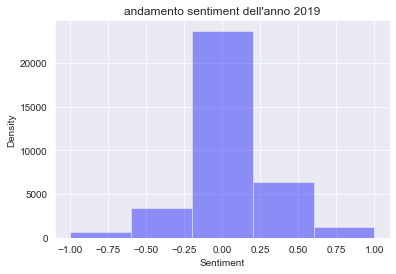

In [16]:
#2019
sns.set_style('darkgrid')
plt.xlabel('Sentiment')
plt.ylabel('Density')
plt.title("andamento sentiment dell'anno "+anno) 
sns.distplot(polarità, kde=False, color='blue', bins=5)

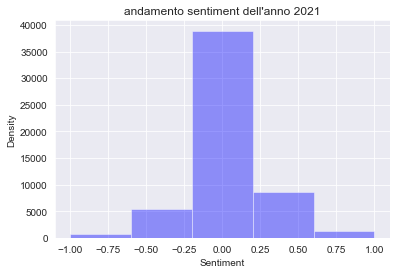

In [9]:
#2021
sns.set_style('darkgrid')
plt.xlabel('Sentiment')
plt.ylabel('Density')
plt.title("andamento sentiment dell'anno "+anno) 
sns.distplot(polarità, kde=False, color='blue', bins=5)